# Tesis MLSG
## Detección de Ciberataques en hogares inteligentes mediante Complejidad usando Entropía de Wavelet
### Elaborado por Miguel Luis Salinas González
### Prof. Guía: Dr. Max Chacón Pacheco
### Prof. Co-guía: Mg. Juan Iturbe Araya

#### Importación de módulos necesarios para el desarrollo

In [614]:
# Se importa pandas para el uso de dataframes.
import pandas as pd
# Se importa numpy para el uso de arrays, además de funciones matemáticas como cos, pi, etc
import numpy as np
# Se importa pywavelets para hacer las transformadas de Wavelet
import pywt
# Se importa MinMaxScaler para normalizar la señal y hacer búsqueda por fuerza bruta
from sklearn.preprocessing import MinMaxScaler
# Se importa NMSE para realizar la búsqueda por fuerza bruta
from sklearn.metrics import mean_squared_error
# Se importan diferentes submódulos para análisis 
from scipy.stats import norm, entropy, shapiro, wilcoxon, mannwhitneyu
# Se importa matplotlib para la generación de gráficos
import matplotlib.pyplot as plt
# Se importa LogisticRegression para realizar la regresión logística de complejidad y entropía
from sklearn.linear_model import LogisticRegression
# Se importan los submódulos necesarios para realizar las curvas ROC y otras métricas
from sklearn.metrics import roc_curve, roc_auc_score, f1_score, precision_recall_curve, confusion_matrix
# Se importan el módulo necesario para calcular el porcentaje de uso de CPU
import psutil
import time


In [98]:
# Objetivo: Acumular la cantidad de paquetes TCP en ventanas de tiempo de 1 segundo.
# Entrada: La ruta del archivo a acumular como string.
# Salida: No retorna nada, pero escribe un archivo con la señal resultante.
def process_signal(file_path):
    # Cargar el archivo CSV
    df = pd.read_csv(file_path)
    
    # Asegurarnos de que la columna de Timestamp sea de tipo datetime
    df['Timestamp'] = pd.to_datetime(df['Timestamp'])
    
    # Crear un DataFrame para almacenar los resultados
    start_time = df['Timestamp'].min().floor('S')
    end_time = df['Timestamp'].max().ceil('S')
    time_range = pd.date_range(start=start_time, end=end_time, freq='S')
    
    result_df = pd.DataFrame(index=time_range, columns=['Packet Count', 'Total Length'])
    result_df['Packet Count'] = 0
    result_df['Total Length'] = 0
    
    # Agrupar los datos por ventanas de 1 segundo y calcular el conteo y la suma del tamaño de los paquetes
    for name, group in df.groupby(pd.Grouper(key='Timestamp', freq='S')):
        packet_count = len(group)
        total_length = group['Packet Len'].sum()
        result_df.at[name, 'Packet Count'] = packet_count
        result_df.at[name, 'Total Length'] = total_length
    
    # Rellenar NaN con 0
    result_df = result_df.fillna(0)
    
    # Guardar el DataFrame resultante en un archivo CSV
    file_path = file_path.split(".")
    file_path = file_path[0] + "_proc.csv"
    result_df.to_csv(file_path)
    return None

In [100]:
# Se procesan por acumulación de paquetes TCP archivos de conexiones no ataque del 11 al 28
for i in range(11,29):
        process_signal("/Users/miguelsalinasgonzalez/Downloads/propio/Sujetos/Benignos/procesado/details_benigno_"+str(i)+".csv")


In [101]:
for i in range(5,7):
        process_signal("/Users/miguelsalinasgonzalez/Downloads/propio/Sujetos/Benignos/procesado/details_benigno_"+str(i)+".csv")


In [112]:
for i in range(11,13):
        process_signal("/Users/miguelsalinasgonzalez/Downloads/propio/Sujetos/Malignos/procesado/details_maligno_"+str(i)+".csv")

In [364]:
# Objetivo: Dividir una señal en la mayor cantidad de tramos (por defecto de 1024) posible.
# Entrada: data, con los valores de los puntos de la señal y de manera opcional tramo_size para definir tramos
# de distinta longitud.
# Salida: Retorna un arreglo de arreglos donde cada sub-arreglo contiene los valores de los puntos de la señal
# en cada tramo respectivamente.
def dividir_en_tramos(data, tramo_size=1024):
    # Recortar el excedente si la longitud no es múltiplo de tramo_size
    data = data[:(len(data) // tramo_size) * tramo_size]
    # Dividir los datos en tramos de tramo_size
    return np.array(np.split(data, len(data) // tramo_size))


# Se crea una lisa vacía para almacenar la cantidad de tramos por cada señal original.
reps = []

# Se recorren las 12 señales originales.
for i in range(1,13):
    
    csv_file = "/Users/miguelsalinasgonzalez/Downloads/propio/Sujetos/Malignos/procesado/details_maligno_"+str(i)+"_proc.csv"
    df = pd.read_csv(csv_file)

    # Extraer las columnas necesarias
    packet_count = df['Packet Count'].values
    total_length = df['Total Length'].values

    # Dividir las señales en tramos de 1024 puntos
    tramo_size = 1024
    packet_count_tramos = dividir_en_tramos(packet_count, tramo_size)
    h=1
    for j in packet_count_tramos:
        df_tramo = pd.DataFrame(j, columns=['Packet Count'])
        df_tramo.to_csv(csv_file.split('_proc')[0]+"_"+str(h)+"_proc.csv", index=False)
        h=h+1
    reps.append(h-1)



    

In [370]:
# Objetivo: Truncar un arreglo y/o lista en un largo fijo de 1024 elementos,
# Entrada: Un arreglo o lista que tenga al menos 1024 elementos.
# Salida: Un arreglo con 1024 elementos.
def truncate_to_1024(array):
    return array[:1024]

# Objetivo: Calcular el nmse entre dos señales
# Entrada: Dos arreglos/listas que representes los valores de una señal.
# Salida: Retorna el valor del Error cuadrático medio normalizado entre ambas señales ingresadas.
def calculate_nmse(y_true, y_pred):
    mse = mean_squared_error(y_true, y_pred)
    nmse = mse / np.mean(np.square(y_true))
    return nmse

# Objetivo: Procesar los archivos, calculando la transforma de Wavelet con cada sub-familia, posteriormente 
# reconstruir la señal con la respectiva anti-transformada, para así calcular el nmse entre la señal original
# y la reconstruida para finalmente rankear las sub-familias según el nmse promedio de menor a mayor.
# Entrada: Una lista de strings que contiene los archivos a procesar.
# Salida: Un arreglo que contiene las sub-familias según nmse promedio de menor a mayor.
def process_files(file_paths):
    wavelet_families = ['bior', 'coif', 'db', 'dmey', 'haar', 'rbio', 'sym']
    wavelets = {wavelet: family for family in wavelet_families for wavelet in pywt.wavelist(family)}
    nmse_results = {wavelet: [] for wavelet in wavelets}
    
    for file_path in file_paths:
        # Cargar el archivo CSV
        df = pd.read_csv(file_path)
        
        # Convertir la columna 'Packet Count' en un numpy array y normalizarlo
        packet_count_array = df['Packet Count'].to_numpy()
        packet_count_array = truncate_to_1024(packet_count_array)
        
        scaler = MinMaxScaler()
        normalized_packet_count_array = scaler.fit_transform(packet_count_array.reshape(-1, 1)).flatten()
        
        # Procesar cada wavelet
        for wavelet in wavelets:
            try:
                # Transformada wavelet
                coeffs = pywt.wavedec(normalized_packet_count_array, wavelet)
                # Transformada inversa wavelet
                reconstructed_signal = pywt.waverec(coeffs, wavelet)
                
                # Truncar la señal reconstruida a la misma longitud que la señal original truncada
                reconstructed_signal = reconstructed_signal[:len(normalized_packet_count_array)]
                
                # Normalizar la señal reconstruida
                reconstructed_signal_normalized = scaler.fit_transform(reconstructed_signal.reshape(-1, 1)).flatten()
                
                # Calcular NMSE
                
                nmse = calculate_nmse(normalized_packet_count_array, reconstructed_signal_normalized)
                nmse_results[wavelet].append(nmse)
                
            except Exception as e:
                print(f"Error processing wavelet {wavelet}: {e}")
    
    # Promediar los resultados de NMSE para cada wavelet a lo largo de todos los archivos
    averaged_nmse_results = {wavelet: np.mean(nmses) for wavelet, nmses in nmse_results.items() if nmses}
    
    # Rankear las wavelets de menor NMSE a mayor
    ranked_results = sorted(averaged_nmse_results.items(), key=lambda x: x[1])
    
    return ranked_results



 ### Se realiza búsqueda por fuerza bruta de las mejores sub-familias Wavelet.
 Con el fin de reducir la combinatoria del problema, se toman las señales originales y se transforman cada una con cada  sub-familia de Wavelet posteriormente se aplica la antitransformada para reconstruir la señal y así calcular el nmse entre la señal reconstruida y la original. Finalmente se rankean los nmse promedio de cada sub-familia de menor a mayor.

Búsqueda por fuerza bruta para comienzo de cada ataque y conexiones normales.

In [531]:
# Lista de rutas de archivos predefinidos
file_paths = []
# MALIGNOS
for i in range(1,13):
    file_paths.append("/Users/miguelsalinasgonzalez/Downloads/propio/Sujetos/Malignos/procesado/details_maligno_"+str(i)+"_proc.csv")
# BENIGNOS
for i in range(1,29):
        file_paths.append("/Users/miguelsalinasgonzalez/Downloads/propio/Sujetos/Benignos/procesado/details_benigno_"+str(i)+"_proc.csv")

# Procesar los archivos y obtener los resultados rankeados
ranked_wavelets = process_files(file_paths)
#print(file_paths)
# Mostrar los resultados rankeados
for family, avg_nmse in ranked_wavelets:
    print(f"Wavelet Family: {family}, Average NMSE: {avg_nmse}")

Wavelet Family: bior1.1, Average NMSE: 1.6187690879483138e-31
Wavelet Family: db1, Average NMSE: 1.6187690879483138e-31
Wavelet Family: haar, Average NMSE: 1.6187690879483138e-31
Wavelet Family: rbio1.1, Average NMSE: 1.6187690879483138e-31
Wavelet Family: bior1.3, Average NMSE: 2.3664169935667394e-31
Wavelet Family: bior1.5, Average NMSE: 3.2883221730163067e-31
Wavelet Family: rbio1.3, Average NMSE: 3.5436726486004207e-31
Wavelet Family: bior2.4, Average NMSE: 3.8180731130639764e-31
Wavelet Family: bior2.8, Average NMSE: 4.707370869227803e-31
Wavelet Family: coif2, Average NMSE: 5.281990654514461e-31
Wavelet Family: rbio1.5, Average NMSE: 5.802029932123968e-31
Wavelet Family: db2, Average NMSE: 6.96835235188509e-31
Wavelet Family: bior3.9, Average NMSE: 7.9509791684335e-31
Wavelet Family: db4, Average NMSE: 8.410688422561733e-31
Wavelet Family: rbio2.8, Average NMSE: 8.456662133881094e-31
Wavelet Family: rbio2.6, Average NMSE: 1.0561365900366591e-30
Wavelet Family: bior2.2, Average NM

Búsqueda por fuerza bruta para ataques, sus repeticiones y conexiones benignas.

In [536]:
# Lista de rutas de archivos predefinidos
file_paths = []
# MALIGNOS
for i in range(1,13):
    #file_paths.append("/Users/miguelsalinasgonzalez/Downloads/propio/Sujetos/Malignos/procesado/details_maligno_"+str(i)+"_proc.csv")
    for j in range(reps[i-1]):
        file_paths.append("/Users/miguelsalinasgonzalez/Downloads/propio/Sujetos/Malignos/procesado/details_maligno_"+str(i)+"_"+str(j+1)+"_proc.csv")
# BENIGNOS
for i in range(1,29):
        file_paths.append("/Users/miguelsalinasgonzalez/Downloads/propio/Sujetos/Benignos/procesado/details_benigno_"+str(i)+"_proc.csv")

# Procesar los archivos y obtener los resultados rankeados
ranked_wavelets_wr = process_files(file_paths)
#print(file_paths)
# Mostrar los resultados rankeados
for family, avg_nmse in ranked_wavelets_wr:
    print(f"Wavelet Family: {family}, Average NMSE: {avg_nmse}")

Wavelet Family: bior1.1, Average NMSE: 1.868151830466713e-31
Wavelet Family: db1, Average NMSE: 1.868151830466713e-31
Wavelet Family: haar, Average NMSE: 1.868151830466713e-31
Wavelet Family: rbio1.1, Average NMSE: 1.868151830466713e-31
Wavelet Family: bior2.4, Average NMSE: 2.1410746782995825e-31
Wavelet Family: bior1.3, Average NMSE: 2.195186555315708e-31
Wavelet Family: rbio1.3, Average NMSE: 2.317776859466708e-31
Wavelet Family: bior1.5, Average NMSE: 2.603168987233025e-31
Wavelet Family: bior2.8, Average NMSE: 2.7478288309154387e-31
Wavelet Family: rbio1.5, Average NMSE: 2.9720589927327414e-31
Wavelet Family: db2, Average NMSE: 3.0760486133405458e-31
Wavelet Family: coif2, Average NMSE: 3.611068287982514e-31
Wavelet Family: bior2.2, Average NMSE: 3.8321635312047583e-31
Wavelet Family: db4, Average NMSE: 3.965257855420146e-31
Wavelet Family: bior3.9, Average NMSE: 4.135915241983288e-31
Wavelet Family: rbio2.8, Average NMSE: 4.260495019941807e-31
Wavelet Family: bior2.6, Average NMS

Búsqueda por fuerza bruta para el escenario de clases balanceada 12 ataques y 12 no ataques

In [533]:
# Lista de rutas de archivos predefinidos
file_paths = []
# MALIGNOS
for i in range(1,13):
    file_paths.append("/Users/miguelsalinasgonzalez/Downloads/propio/Sujetos/Malignos/procesado/details_maligno_"+str(i)+"_proc.csv")
# BENIGNOS
for i in range(1,13):
        file_paths.append("/Users/miguelsalinasgonzalez/Downloads/propio/Sujetos/Benignos/procesado/details_benigno_"+str(i)+"_proc.csv")

# Procesar los archivos y obtener los resultados rankeados
ranked_wavelets_b = process_files(file_paths)
#print(file_paths)
# Mostrar los resultados rankeados
for family, avg_nmse in ranked_wavelets_b:
    print(f"Wavelet Family: {family}, Average NMSE: {avg_nmse}")

Wavelet Family: bior1.3, Average NMSE: 1.9401013852669631e-31
Wavelet Family: bior1.1, Average NMSE: 2.1600726212090542e-31
Wavelet Family: db1, Average NMSE: 2.1600726212090542e-31
Wavelet Family: haar, Average NMSE: 2.1600726212090542e-31
Wavelet Family: rbio1.1, Average NMSE: 2.1600726212090542e-31
Wavelet Family: rbio1.3, Average NMSE: 2.182155008814508e-31
Wavelet Family: bior1.5, Average NMSE: 2.5317987734985455e-31
Wavelet Family: bior2.4, Average NMSE: 2.5928461098254553e-31
Wavelet Family: rbio1.5, Average NMSE: 2.9453663216689696e-31
Wavelet Family: db2, Average NMSE: 2.9961888714771593e-31
Wavelet Family: bior2.8, Average NMSE: 3.1584528322969336e-31
Wavelet Family: coif2, Average NMSE: 3.652121530821832e-31
Wavelet Family: bior3.7, Average NMSE: 4.934170635340635e-31
Wavelet Family: rbio2.8, Average NMSE: 5.010253337769879e-31
Wavelet Family: rbio2.6, Average NMSE: 5.489480161282312e-31
Wavelet Family: rbio2.2, Average NMSE: 5.750267670091508e-31
Wavelet Family: db5, Averag

In [529]:
# Objetivo: Calcular la entropía de Wavelet dada una señal y una sub-familia en específico.
# Entrada: Signal como un arreglo que representa la señal, wv_family como un string que representa la sub-familia y
# norm para indicar si entregar la entropía normalizada (por defecto sí) o no.
# Salida: Valor de entropía de la señal, energia de cada coeficiente, energia total y energía relativa de cada coef.
def calculate_wavelet_entropy(signal, wv_family, norm=True):
    
    level = pywt.dwt_max_level(len(signal), wv_family)
    
    # Decompose the signal using discrete wavelet transform
    coeffs = pywt.wavedec(signal, wv_family, level=level)
    
    # Calculate the coefficients of each detail sub-band
    details = coeffs[1:]
    
    # Calculate the energy of each detail sub-band
    energy = [np.sum(np.square(d)) for d in details]
    
    #Total energy
    tot_energy = np.sum(energy)
    
    # Relative wavelet energy
    rwe = energy/tot_energy
    
    # Calculate the entropy
    wav_entropy = -np.sum(rwe*np.log(rwe))
    
    if norm == True:
        max_entropy = -np.log(1/len(energy))
        wav_entropy = wav_entropy / max_entropy        
    
    return wav_entropy, energy, tot_energy, rwe

Para la siguiente función se consideran 2 cálculos de desequilibrio distintos, una mediante distancia de Euclidiana y otro mediante distancia de Wootters. Como la complejidad se define como C = H x Q, donde C es complejidad, H entropía y Q desequilibrio. Es que se tienen también 2 cálculos de complejidad distintos.

In [404]:
# Objetivo: Calcular el desequilibrio y la complejidad por medio de la entropía.
# Entrada: Un arreglo que contiene los nombres de los archivos que contienen la representación de las señales y
# un string que represente la sub-familia Wavelet a utilizar.
# Salida: Un dataframe que en cada fila tiene cada señal y que en las columnas tiene las respectivas, entropías, 
# desequilibrios y complejidades.
def calculate_desequilibrium_and_complexity(signals, wv_family):    
    results=[]
    count = 1
    for i in signals:

        df = pd.read_csv(i)
        packet_count_array = df['Packet Count'].to_numpy()
        packet_count_array = truncate_to_1024(packet_count_array)

        a, b, c, d = calculate_wavelet_entropy(packet_count_array,wv_family)

        # Se crea el arreglo de distribución de probabilidades uniforme.
        normal_dist = [1/len(d)]*len(d)


        # Distancia Euclidiana
        distancia_euclidiana = np.linalg.norm(np.array(d) - np.array(normal_dist)) *(len(d)/(len(d)-1))

        # Distancia de Wootters
        inner_product = np.sum(np.sqrt(d * normal_dist))
        DW = np.arccos(inner_product)*(1/np.arccos(np.sqrt(1/len(d))))


        sujeto = [a, distancia_euclidiana, DW]
        results.append(sujeto)
        count = count + 1

    df = pd.DataFrame(results, columns=['Entropía (Wavelet)', 'Desequilibrio (Eucl.)', 'Desequilibrio (Wootters)'],)
    df['Complejidad Eucl.'] = df['Entropía (Wavelet)'] * df['Desequilibrio (Eucl.)']
    df['Complejidad Wootters'] = df['Entropía (Wavelet)'] * df['Desequilibrio (Wootters)']
    return df

In [458]:
# Objetivo: Graficar el plano complejidad-entropía, identificando cada ataque y su evolución en el tiempo.
# Entrada: Un dataframe que contiene los correspondientes valores de entropía y complejidad tanto Euclidiana
# como Wootters.
# Salida: No retorna nada, pero grafica los sujetos en el plano complejidad-entropía.
def plot_complexity_entropy(df, complex_type):
    # Separar los datos en distintos grupos
    # Grupo 1 todos los ataques
    group1 = df.iloc[:sum(reps)]
    # Grupo 2 todas las conexiones normales
    group2 = df.iloc[sum(reps):]
    
    # Se dividen distintos grupos, cada uno contiene un ataque separado en tramos de 1024 puntos.
    ataque1 = df.iloc[0:sum(reps[:1])]
    ataque2 = df.iloc[sum(reps[:1]):sum(reps[:2])]
    ataque3 = df.iloc[sum(reps[:2]):sum(reps[:3])]
    ataque4 = df.iloc[sum(reps[:3]):sum(reps[:4])]
    ataque5 = df.iloc[sum(reps[:4]):sum(reps[:5])]
    ataque6 = df.iloc[sum(reps[:5]):sum(reps[:6])]
    ataque7 = df.iloc[sum(reps[:6]):sum(reps[:7])]
    ataque8 = df.iloc[sum(reps[:7]):sum(reps[:8])]
    ataque9 = df.iloc[sum(reps[:8]):sum(reps[:9])]
    ataque10 = df.iloc[sum(reps[:9]):sum(reps[:10])]
    ataque11 = df.iloc[sum(reps[:10]):sum(reps[:11])]
    ataque12 = df.iloc[sum(reps[:11]):sum(reps[:12])]


    
    
    
    
    
    
    
    # Crear la figura y los ejes para la Complejidad Euclidiana
    fig, ax1 = plt.subplots(figsize=(10, 6))

    # Se grafican cada uno de los ataques marcando el inicio de cada ataque con un color en específico.
    # y la evolución de cada ataque del mismo color, pero con menos saturación
    
    #ax1.scatter(group1['Entropía (Wavelet)'], group1[complex_type], label='Grupo 1', marker='x', color='r')
    ax1.scatter(ataque1['Entropía (Wavelet)'].iloc[0], ataque1[complex_type].iloc[0], label='Ataque 1', marker='x', color='#FF0000')
    ax1.scatter(ataque1['Entropía (Wavelet)'].iloc[1:], ataque1[complex_type].iloc[1:], marker='x', color='#FF000080')
    
    ax1.scatter(ataque2['Entropía (Wavelet)'].iloc[0], ataque2[complex_type].iloc[0], label='Ataque 2', marker='x', color='#00FF00')
    ax1.scatter(ataque2['Entropía (Wavelet)'].iloc[1:], ataque2[complex_type].iloc[1:], marker='x', color='#00FF0080')
    
    ax1.scatter(ataque3['Entropía (Wavelet)'].iloc[0], ataque3[complex_type].iloc[0], label='Ataque 3', marker='x', color='#000080')
    ax1.scatter(ataque3['Entropía (Wavelet)'].iloc[1:], ataque3[complex_type].iloc[1:], marker='x', color='#00008080')
    
    ax1.scatter(ataque4['Entropía (Wavelet)'].iloc[0], ataque4[complex_type].iloc[0], label='Ataque 4', marker='x', color='#FFA500')
    ax1.scatter(ataque4['Entropía (Wavelet)'].iloc[1:], ataque4[complex_type].iloc[1:], marker='x', color='#FFA50080')
    
    ax1.scatter(ataque5['Entropía (Wavelet)'].iloc[0], ataque5[complex_type].iloc[0], label='Ataque 5', marker='x', color='#800080')
    ax1.scatter(ataque5['Entropía (Wavelet)'].iloc[1:], ataque5[complex_type].iloc[1:], marker='x', color='#80008080')
    
    ax1.scatter(ataque6['Entropía (Wavelet)'].iloc[0], ataque6[complex_type].iloc[0], label='Ataque 6', marker='x', color='#FFC0CB')
    ax1.scatter(ataque6['Entropía (Wavelet)'].iloc[1:], ataque6[complex_type].iloc[1:], marker='x', color='#FFC0CB80')
    
    ax1.scatter(ataque7['Entropía (Wavelet)'].iloc[0], ataque7[complex_type].iloc[0], label='Ataque 7', marker='x', color='#FFFF00')
    ax1.scatter(ataque7['Entropía (Wavelet)'].iloc[1:], ataque7[complex_type].iloc[1:], marker='x', color='#FFFF0080')
    
    ax1.scatter(ataque8['Entropía (Wavelet)'].iloc[0], ataque8[complex_type].iloc[0], label='Ataque 8', marker='x', color='#8B4513')
    ax1.scatter(ataque8['Entropía (Wavelet)'].iloc[1:], ataque8[complex_type].iloc[1:], marker='x', color='#8B451380')
    
    ax1.scatter(ataque9['Entropía (Wavelet)'].iloc[0], ataque9[complex_type].iloc[0], label='Ataque 9', marker='x', color='#000000')
    ax1.scatter(ataque9['Entropía (Wavelet)'].iloc[1:], ataque9[complex_type].iloc[1:], marker='x', color='#00000080')
    
    ax1.scatter(ataque10['Entropía (Wavelet)'].iloc[0], ataque10[complex_type].iloc[0], label='Ataque 10', marker='x', color='#A9A9A9')
    ax1.scatter(ataque10['Entropía (Wavelet)'].iloc[1:], ataque10[complex_type].iloc[1:], marker='x', color='#A9A9A980')
    
    ax1.scatter(ataque11['Entropía (Wavelet)'].iloc[0], ataque11[complex_type].iloc[0], label='Ataque 11', marker='x', color='#32CD32')
    ax1.scatter(ataque11['Entropía (Wavelet)'].iloc[1:], ataque11[complex_type].iloc[1:], marker='x', color='#32CD3280')
    
    ax1.scatter(ataque12['Entropía (Wavelet)'].iloc[0], ataque12[complex_type].iloc[0], label='Ataque 12', marker='x', color='#8B0000')
    ax1.scatter(ataque12['Entropía (Wavelet)'].iloc[1:], ataque12[complex_type].iloc[1:], marker='x', color='#8B000080')
    
    
    # Grafica todas las conexiones normales
    ax1.scatter(group2['Entropía (Wavelet)'], group2[complex_type], label='No ataque', marker='o', color='#00ffff')

    # Añadir etiquetas y título
    ax1.set_xlabel('Entropía (Wavelet)')
    ax1.set_ylabel(complex_type)
    ax1.set_title(complex_type + ' vs. Entropía (Wavelet)')
    ax1.legend()
    ax1.set_xlim(0.6, 0.9)
    ax1.set_ylim(0.2, 0.4)


Se calculan entropía, desequilibrio y complejidad para todos sujetos con las 10 mejores sub-familias según NMSE. Por cada uno

## Con repeticiones Wootters

bior1.1
Estadístico: 0.9521172642707825
Valor p: 9.52064074226655e-05
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.792425811290741
Valor p: 7.872208516346291e-05
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 3226.0
Valor p: 4.219299071631756e-08
Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)
---------------------------------------------------------------------------
AUC: 0.9516957862281603
Confusion Matrix:
TN: 23
FP: 5
FN: 0
TP: 139
Accuracy: 0.9700598802395209
Precision: 0.9652777777777778
Recall: 1.0
F1-Score: 0.9823321554770319
Tiempo entrenamiento: 0.030668020248413086
Tiempo predicción: 0.0034737586975097656


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


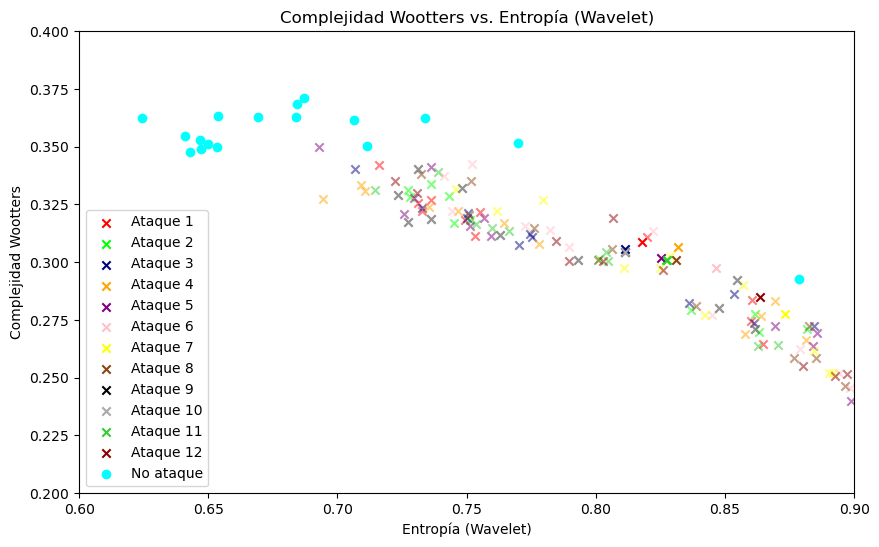

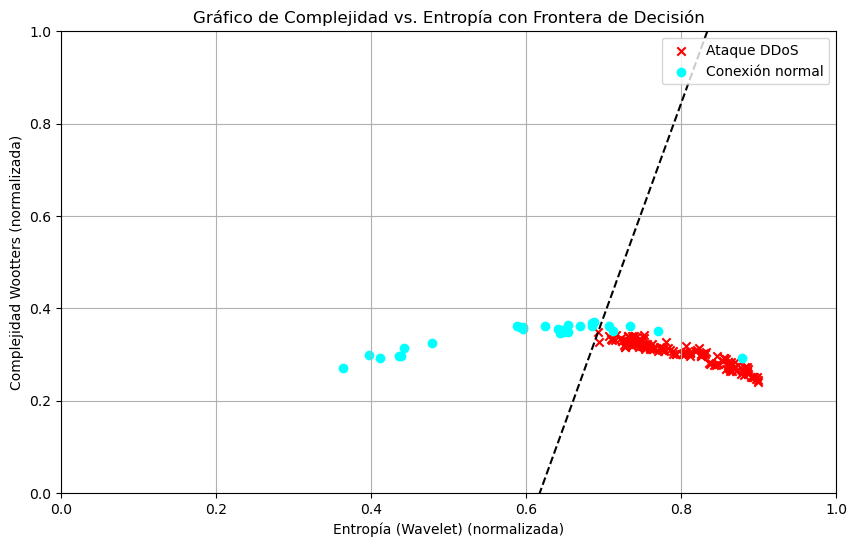

AUC: 0.9516957862281603


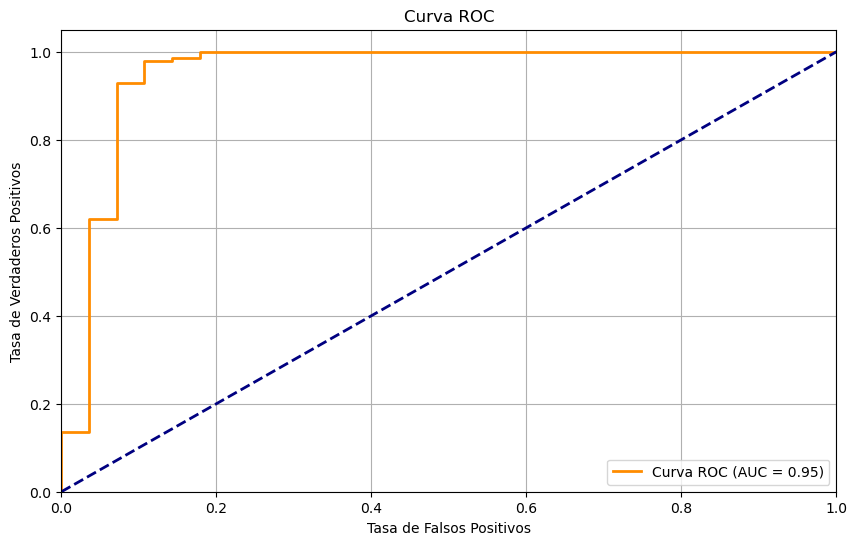

AUC: 0.17112024665981498


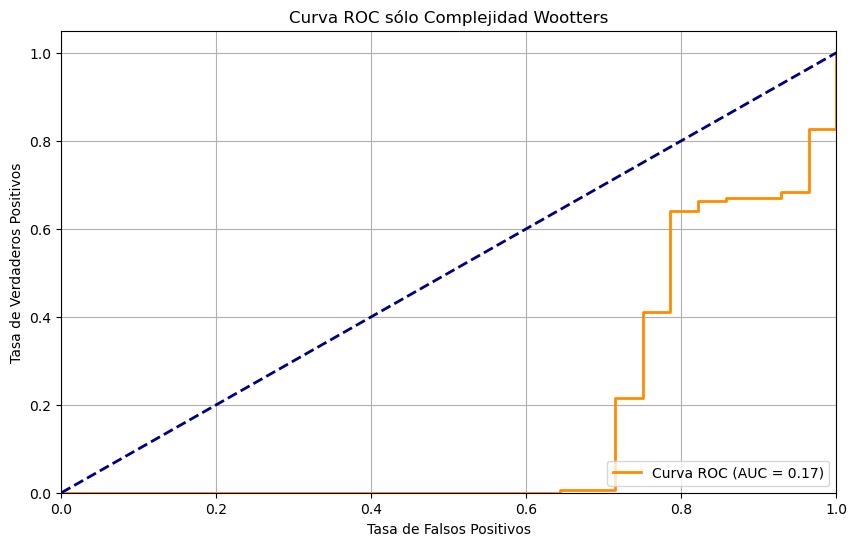

AUC: 0.9465570400822199


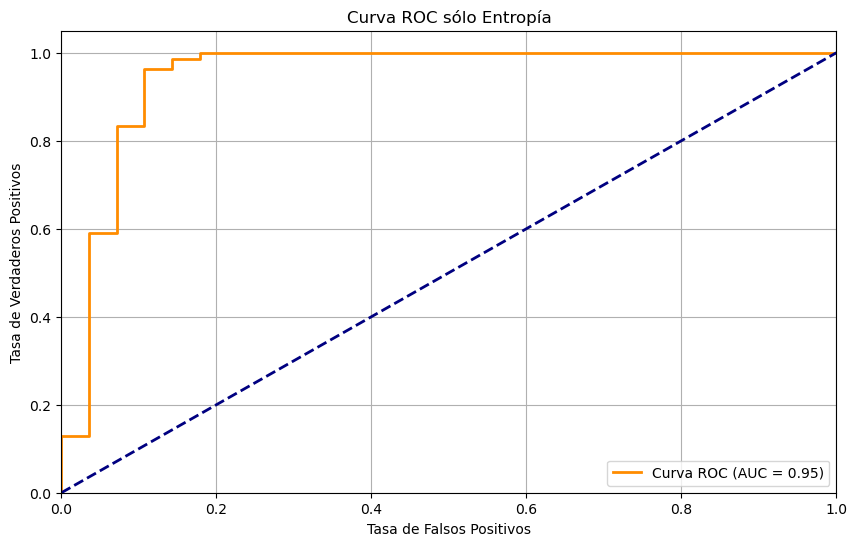

db1
Estadístico: 0.9521172642707825
Valor p: 9.52064074226655e-05
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.792425811290741
Valor p: 7.872208516346291e-05
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 3226.0
Valor p: 4.219299071631756e-08
Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)
---------------------------------------------------------------------------
AUC: 0.9516957862281603
Confusion Matrix:
TN: 23
FP: 5
FN: 0
TP: 139
Accuracy: 0.9700598802395209
Precision: 0.9652777777777778
Recall: 1.0
F1-Score: 0.9823321554770319
Tiempo entrenamiento: 0.0019240379333496094
Tiempo predicción: 0.000476837158203125


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


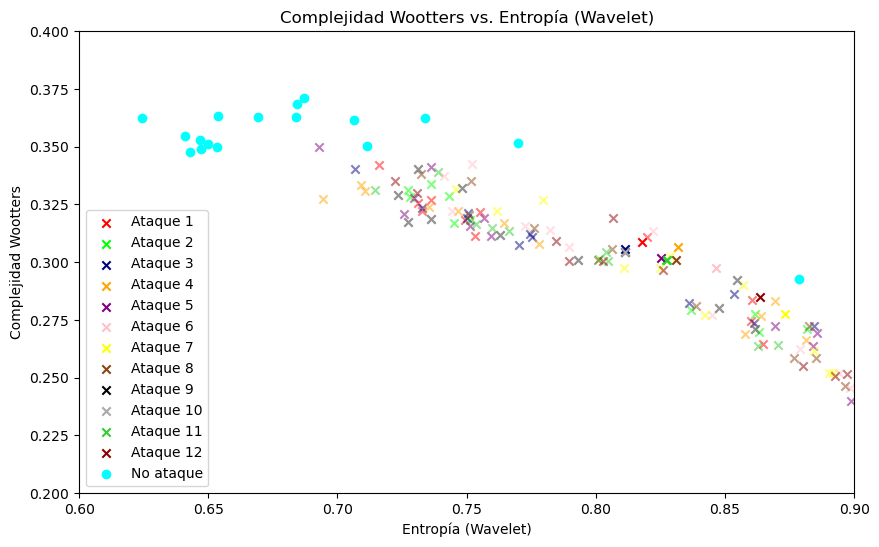

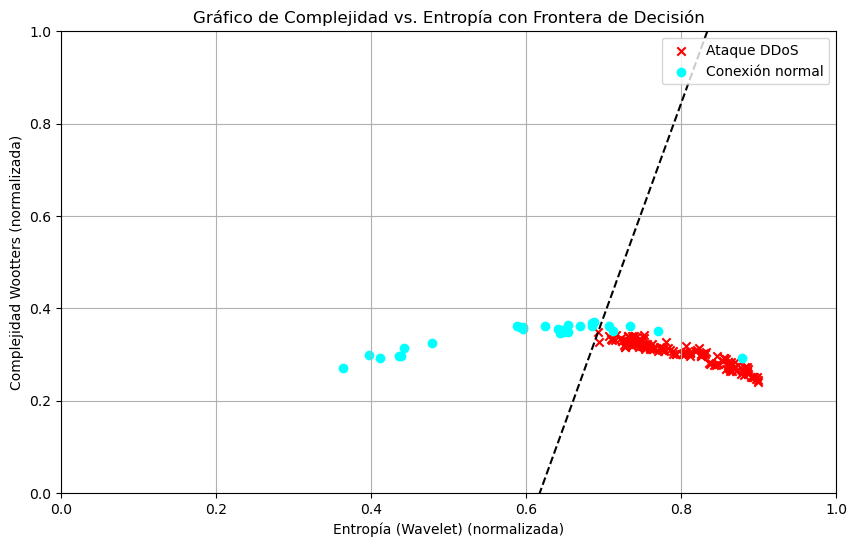

AUC: 0.9516957862281603


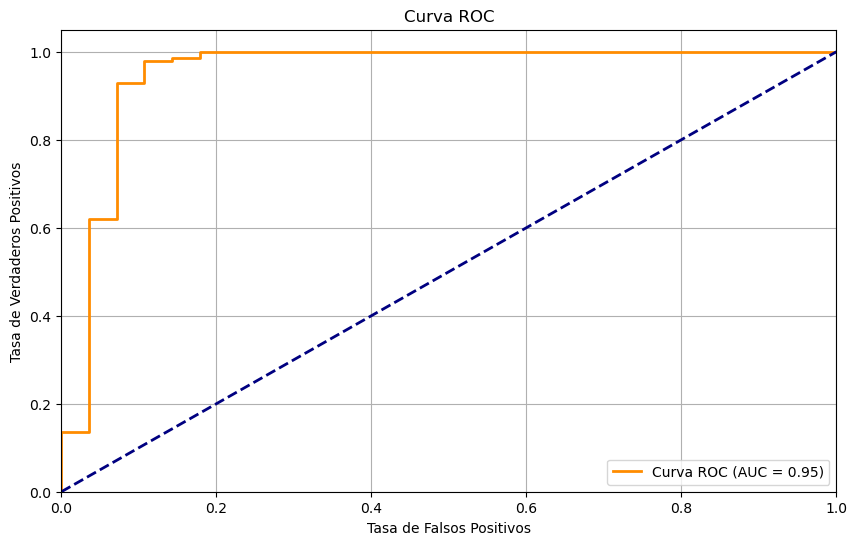

AUC: 0.17112024665981498


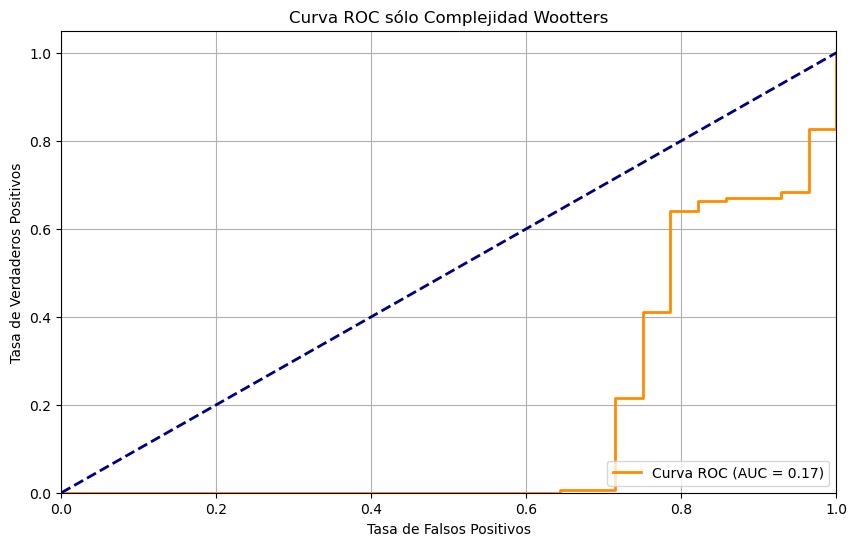

AUC: 0.9465570400822199


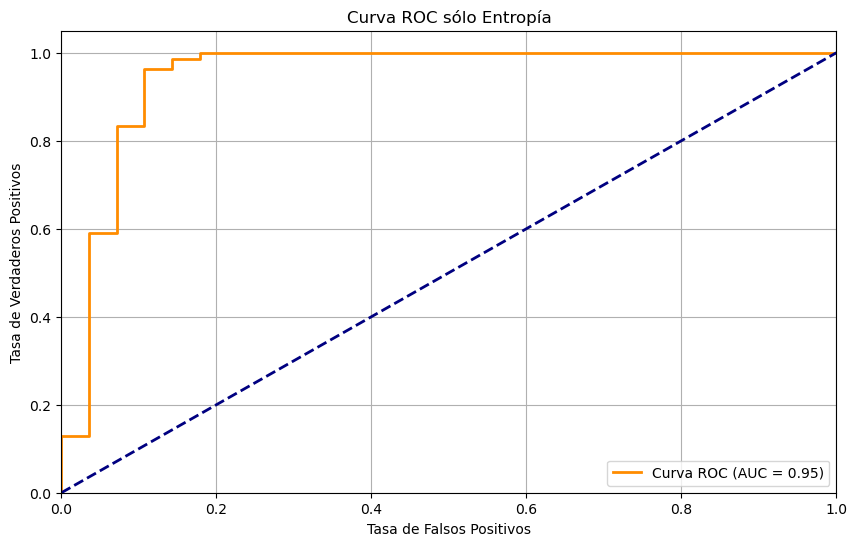

haar
Estadístico: 0.9521172642707825
Valor p: 9.52064074226655e-05
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.792425811290741
Valor p: 7.872208516346291e-05
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 3226.0
Valor p: 4.219299071631756e-08
Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)
---------------------------------------------------------------------------
AUC: 0.9516957862281603
Confusion Matrix:
TN: 23
FP: 5
FN: 0
TP: 139
Accuracy: 0.9700598802395209
Precision: 0.9652777777777778
Recall: 1.0
F1-Score: 0.9823321554770319
Tiempo entrenamiento: 0.0018858909606933594
Tiempo predicción: 0.00047087669372558594


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


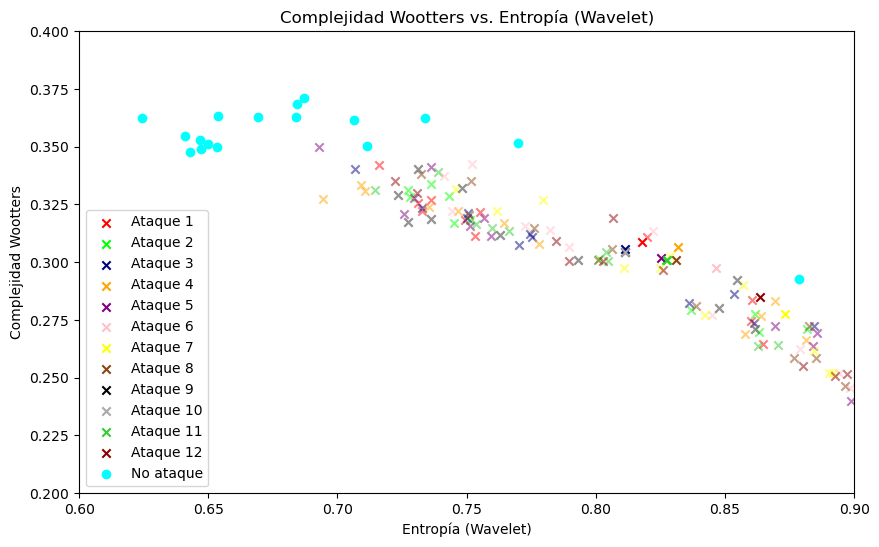

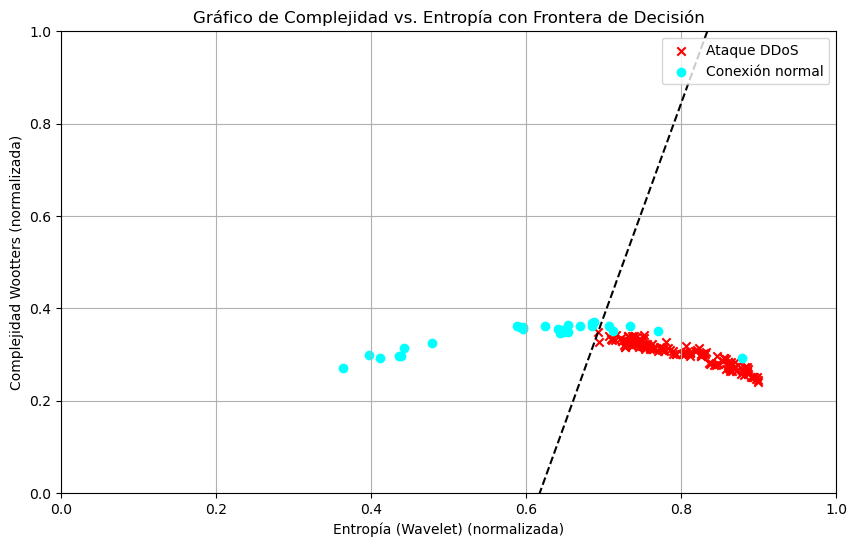

AUC: 0.9516957862281603


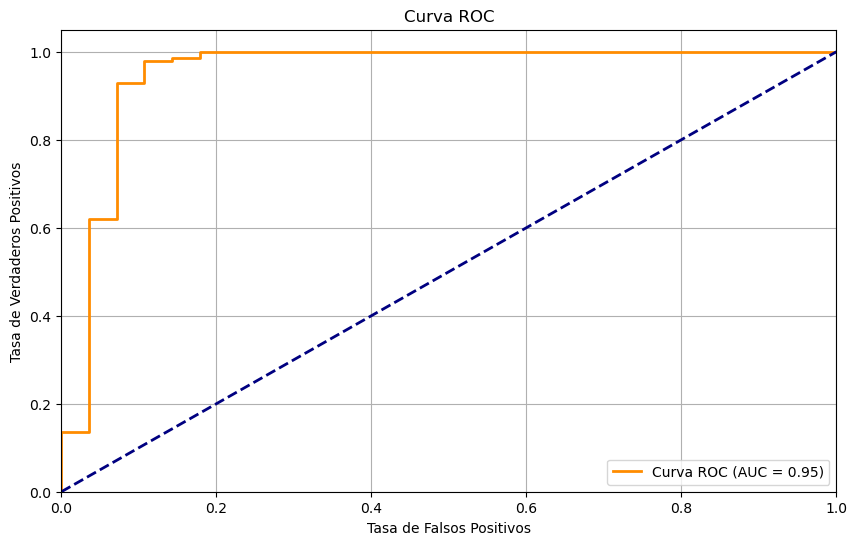

AUC: 0.17112024665981498


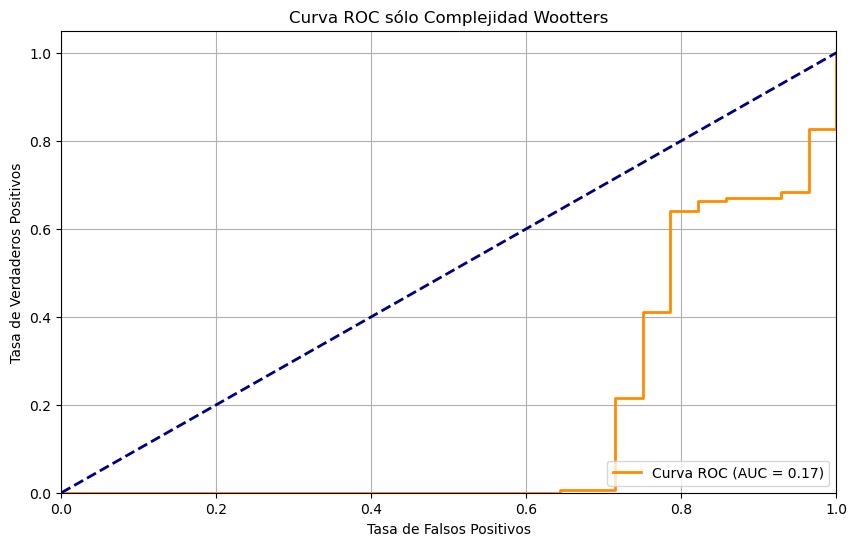

AUC: 0.9465570400822199


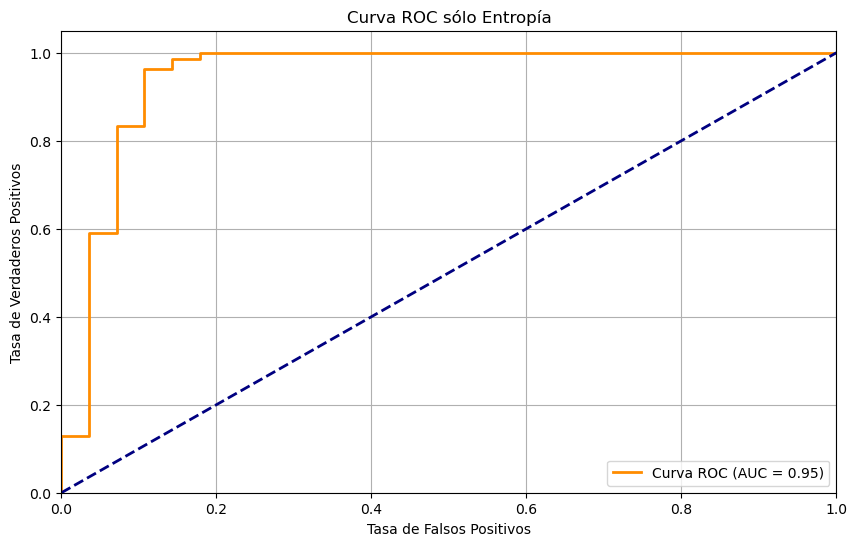

rbio1.1
Estadístico: 0.9521172642707825
Valor p: 9.52064074226655e-05
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.792425811290741
Valor p: 7.872208516346291e-05
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 3226.0
Valor p: 4.219299071631756e-08
Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)
---------------------------------------------------------------------------
AUC: 0.9516957862281603
Confusion Matrix:
TN: 23
FP: 5
FN: 0
TP: 139
Accuracy: 0.9700598802395209
Precision: 0.9652777777777778
Recall: 1.0
F1-Score: 0.9823321554770319
Tiempo entrenamiento: 0.0018651485443115234
Tiempo predicción: 0.0004699230194091797


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


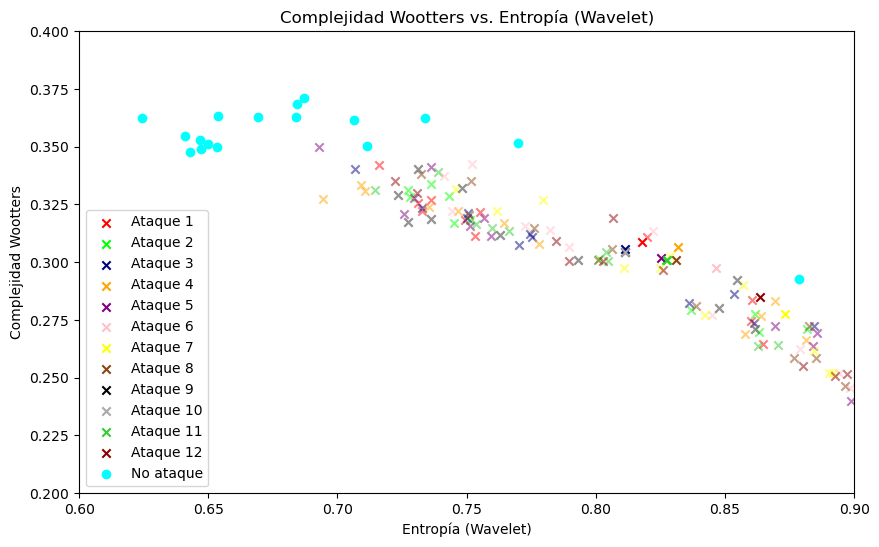

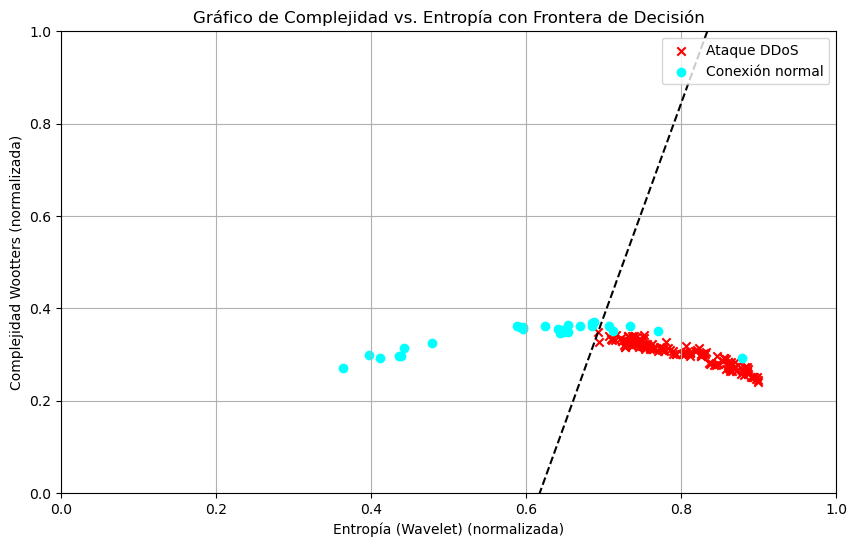

AUC: 0.9516957862281603


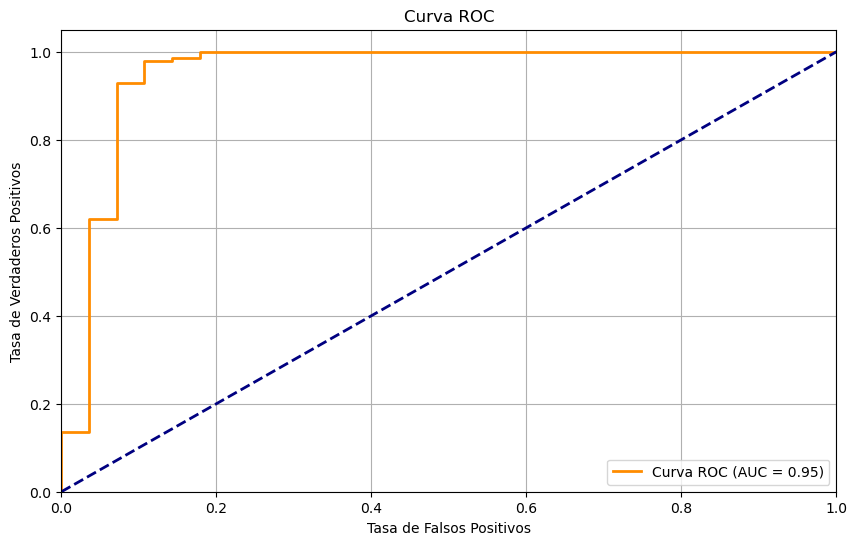

AUC: 0.17112024665981498


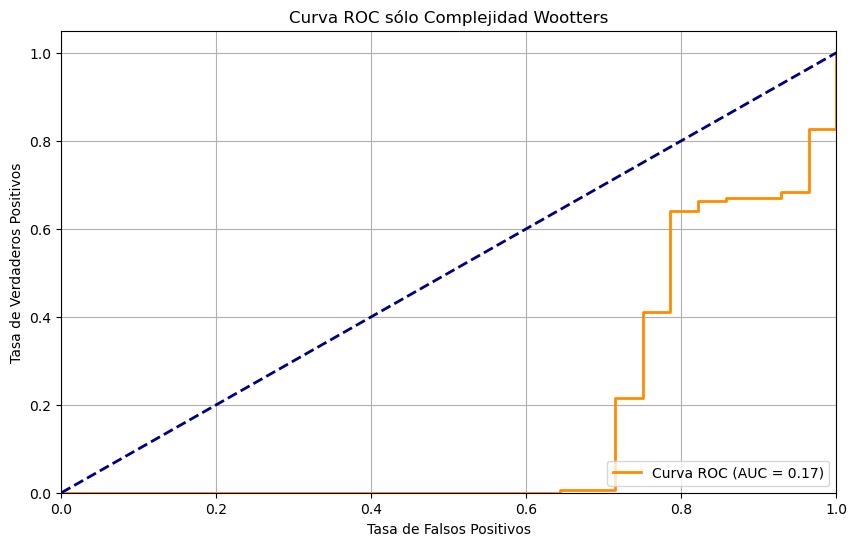

AUC: 0.9465570400822199


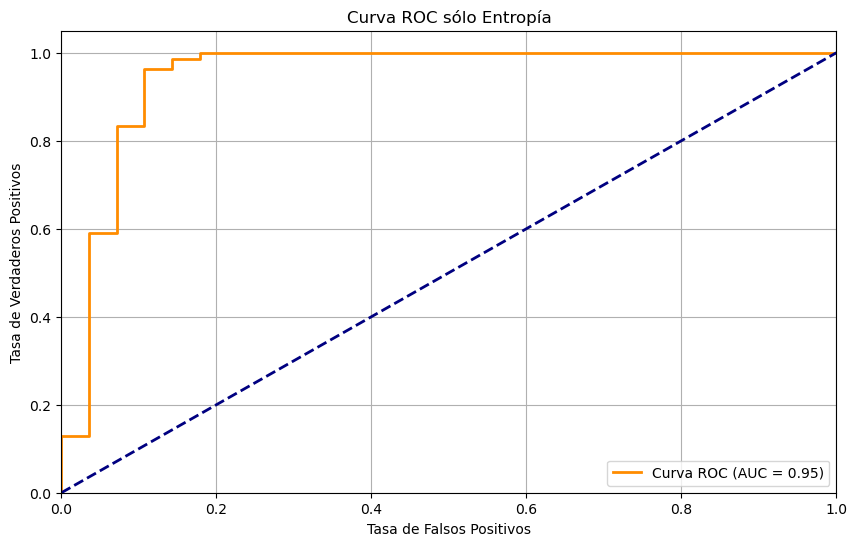

bior2.4
Estadístico: 0.8640633225440979
Valor p: 5.73498026845698e-10
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.8674654960632324
Valor p: 0.0021496049594134092
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 3460.0
Valor p: 8.939244290401967e-11
Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)
---------------------------------------------------------------------------
AUC: 0.8959403905447072
Confusion Matrix:
TN: 21
FP: 7
FN: 1
TP: 138
Accuracy: 0.9520958083832335
Precision: 0.9517241379310345
Recall: 0.9928057553956835
F1-Score: 0.9718309859154929
Tiempo entrenamiento: 0.0020487308502197266
Tiempo predicción: 0.0005021095275878906


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


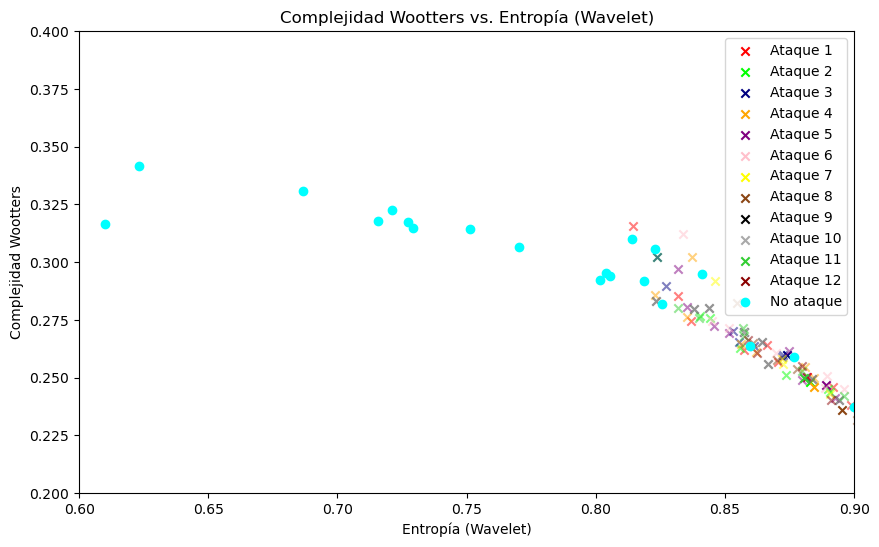

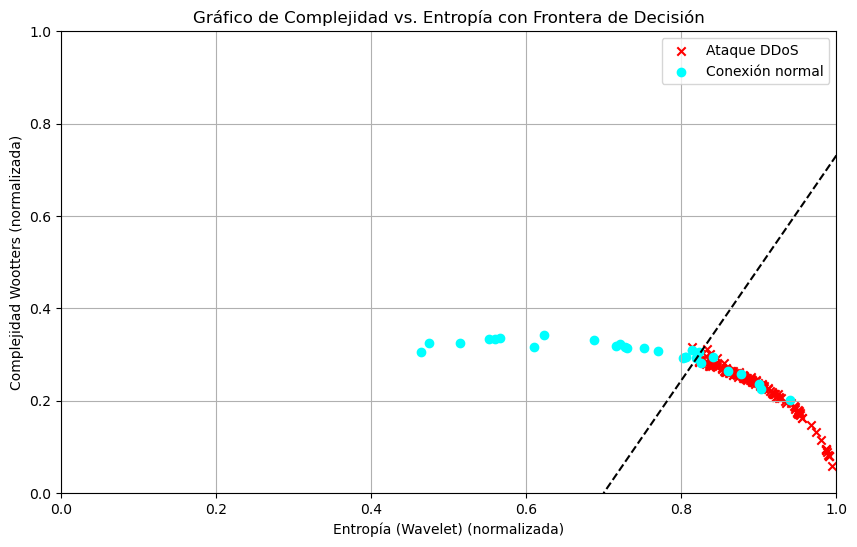

AUC: 0.8959403905447072


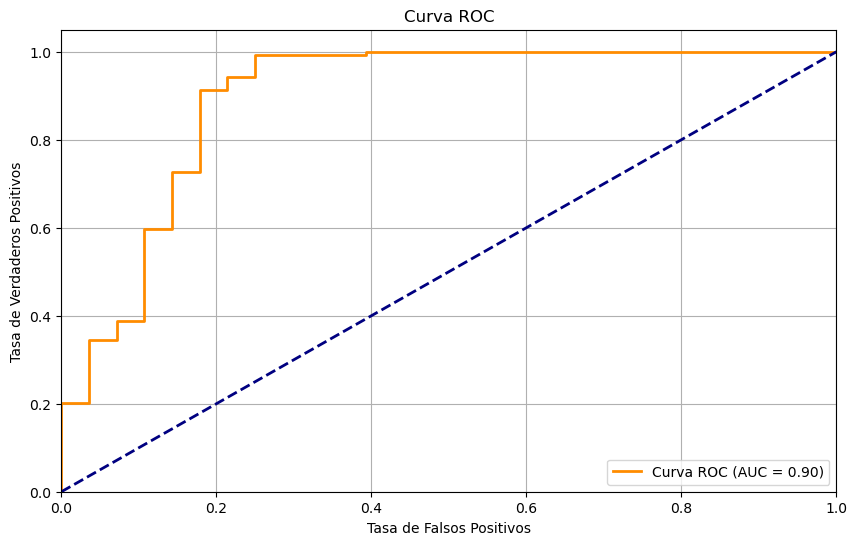

AUC: 0.11099691675231242


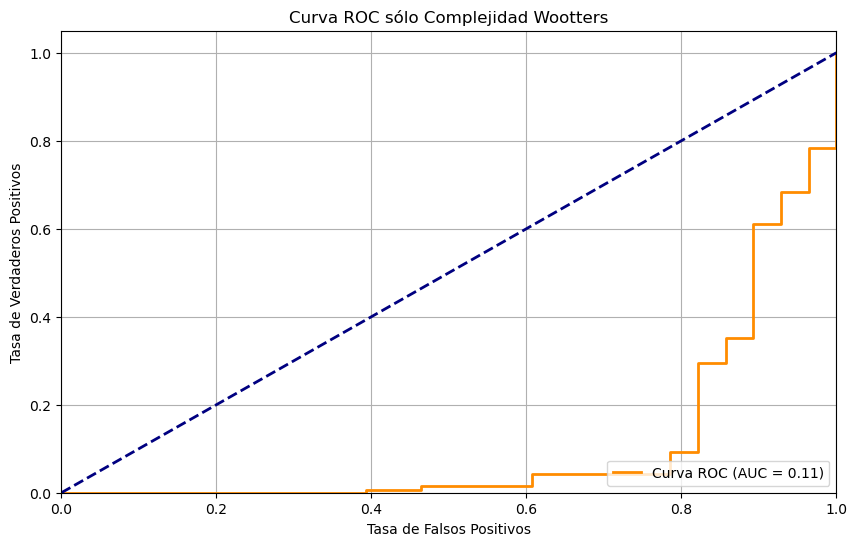

AUC: 0.8956834532374102


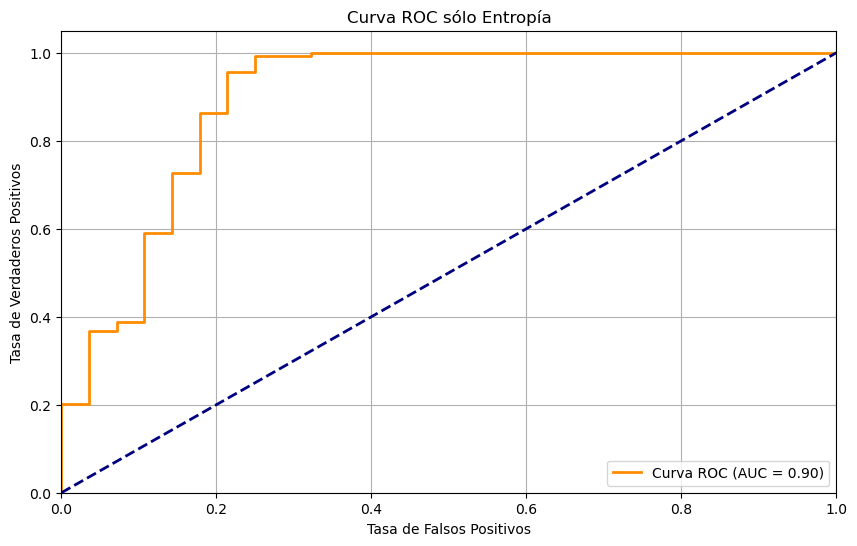

bior1.3
Estadístico: 0.9251146912574768
Valor p: 1.0623180060065351e-06
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.8851500749588013
Valor p: 0.005226558074355125
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 1834.0
Valor p: 0.6328854564150257
No hay diferencias significativas entre las muestras (no se rechaza la hipótesis nula)
---------------------------------------------------------------------------
AUC: 0.9450154162384379
Confusion Matrix:
TN: 25
FP: 3
FN: 0
TP: 139
Accuracy: 0.9820359281437125
Precision: 0.9788732394366197
Recall: 1.0
F1-Score: 0.9893238434163701
Tiempo entrenamiento: 0.0017349720001220703
Tiempo predicción: 0.00047206878662109375


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


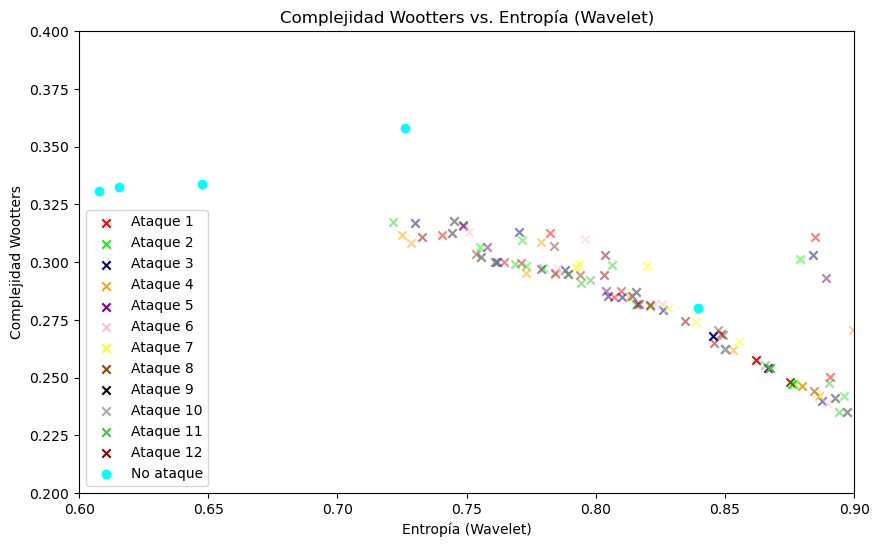

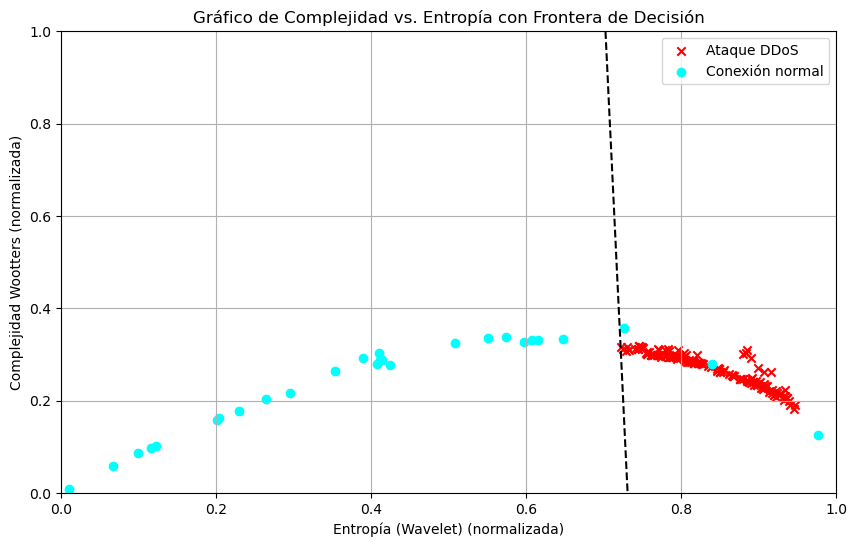

AUC: 0.9450154162384379


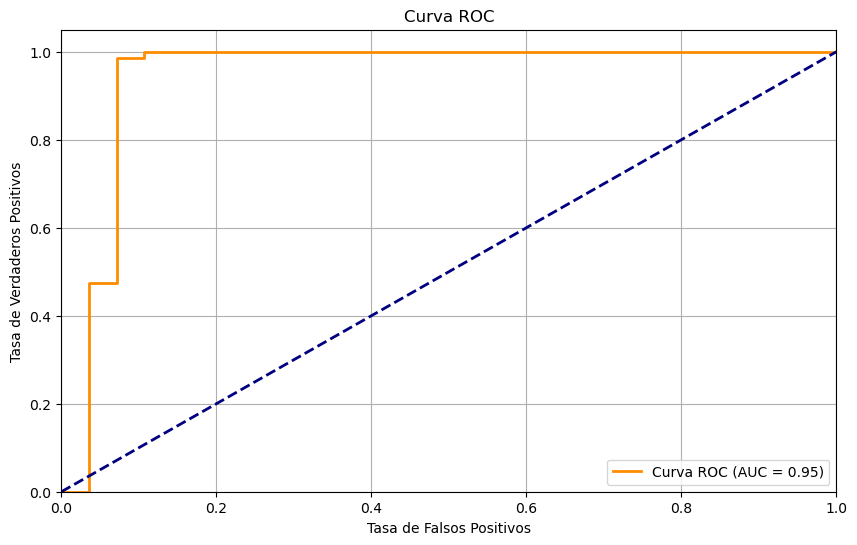

AUC: 0.5287769784172662


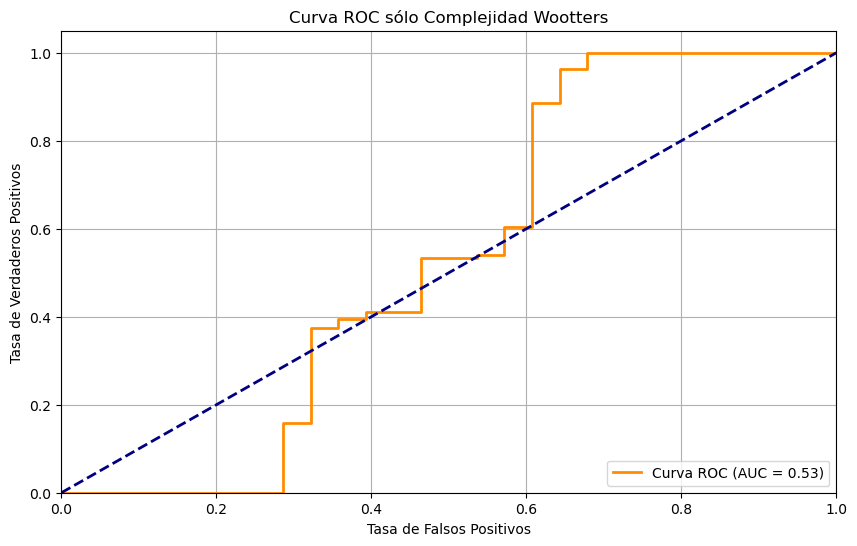

AUC: 0.9450154162384379


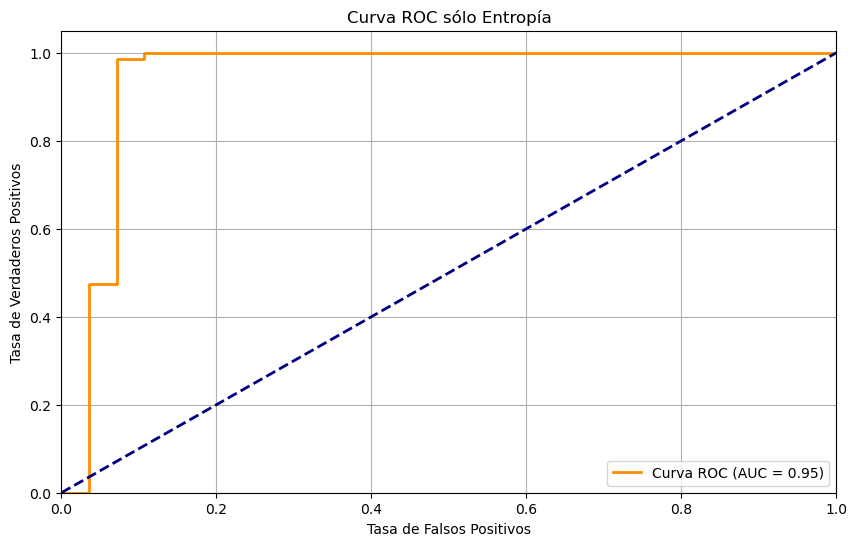

rbio1.3
Estadístico: 0.8349979519844055
Valor p: 3.3997610282554547e-11
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.6545604467391968
Valor p: 6.907513352416572e-07
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 2891.0
Valor p: 5.204073055042945e-05
Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)
---------------------------------------------------------------------------
AUC: 0.6112538540596095
Confusion Matrix:
TN: 7
FP: 21
FN: 0
TP: 139
Accuracy: 0.874251497005988
Precision: 0.86875
Recall: 1.0
F1-Score: 0.9297658862876255
Tiempo entrenamiento: 0.003303050994873047
Tiempo predicción: 0.0006289482116699219


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


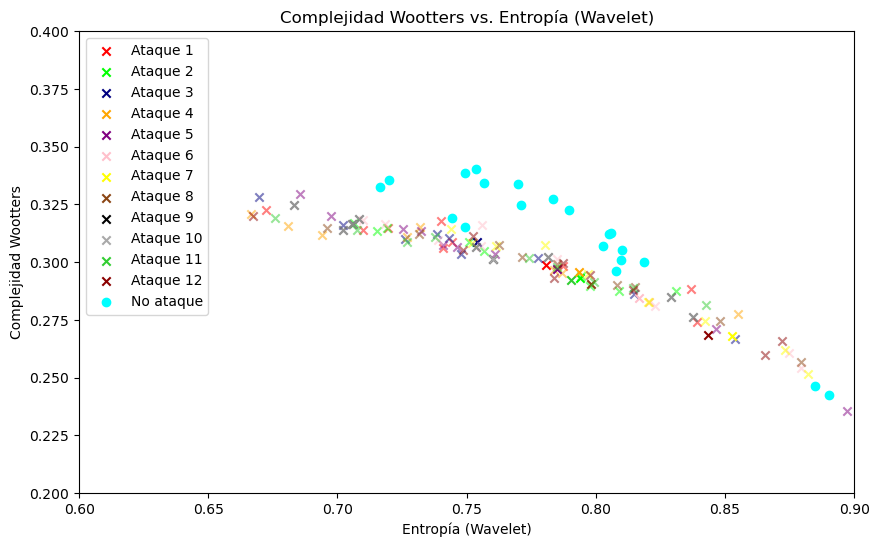

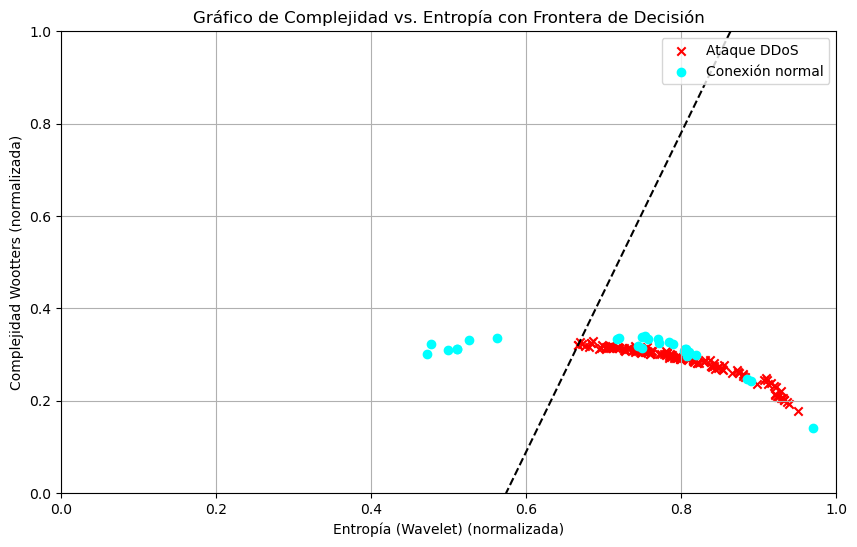

AUC: 0.6112538540596095


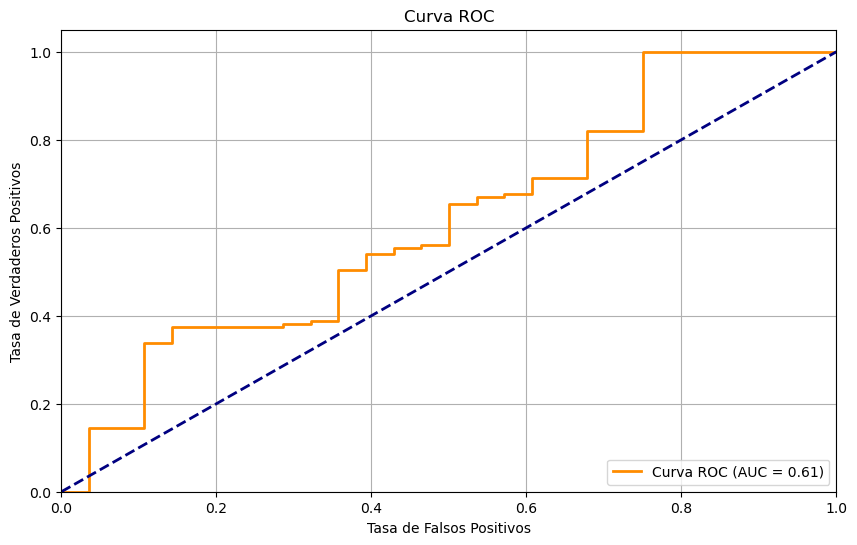

AUC: 0.2571942446043165


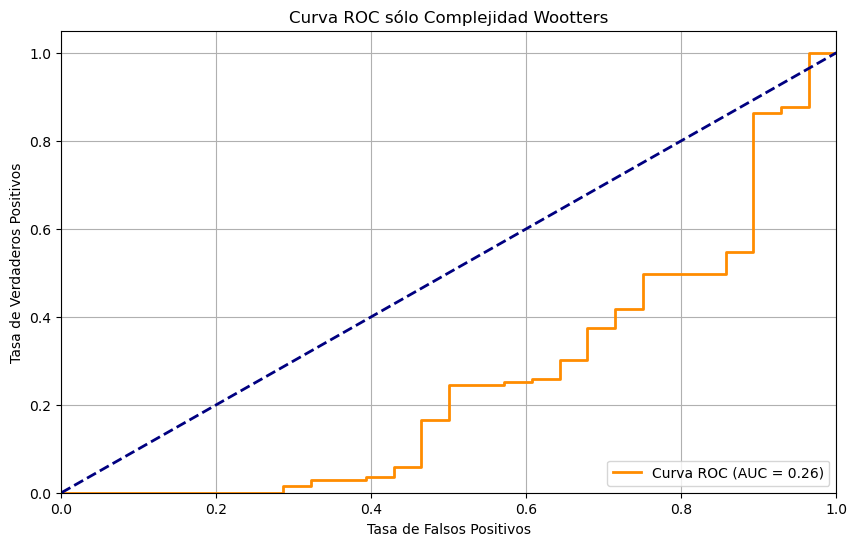

AUC: 0.5960945529290853


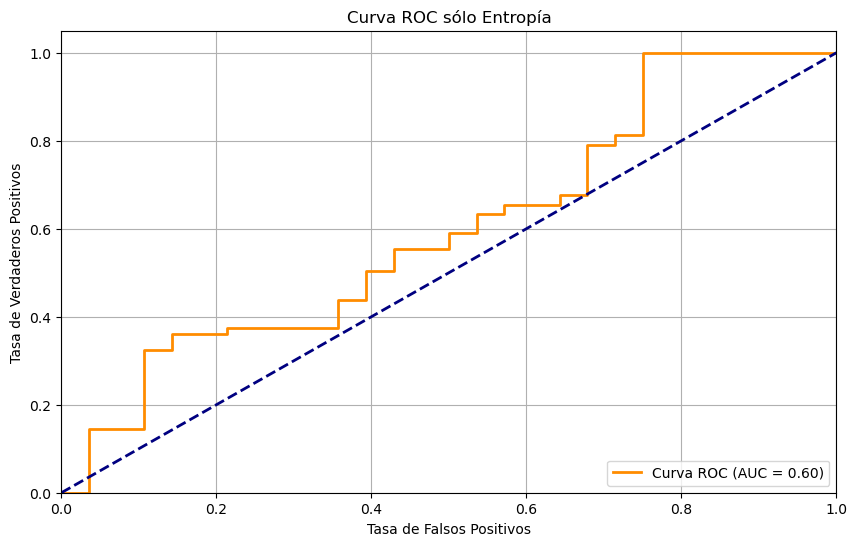

bior1.5
Estadístico: 0.8114715218544006
Valor p: 4.366189701454637e-12
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.7282229661941528
Valor p: 7.325553724513156e-06
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 3059.0
Valor p: 1.8793332174316663e-06
Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)
---------------------------------------------------------------------------
AUC: 0.9373072970195273
Confusion Matrix:
TN: 25
FP: 3
FN: 0
TP: 139
Accuracy: 0.9820359281437125
Precision: 0.9788732394366197
Recall: 1.0
F1-Score: 0.9893238434163701
Tiempo entrenamiento: 0.0018360614776611328
Tiempo predicción: 0.0004730224609375


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


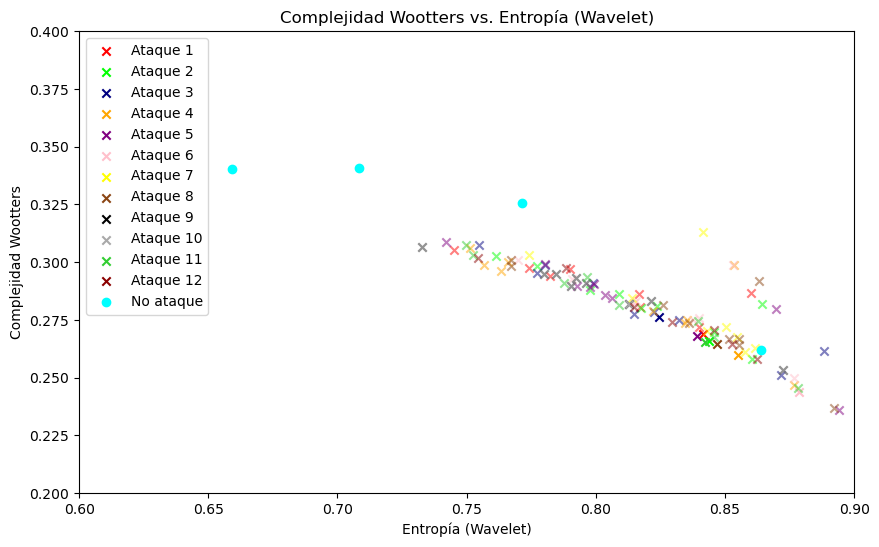

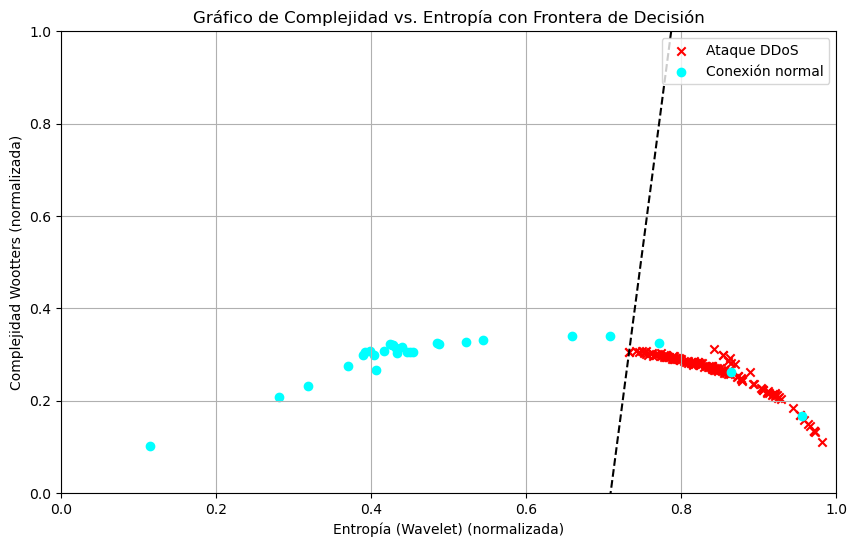

AUC: 0.9373072970195273


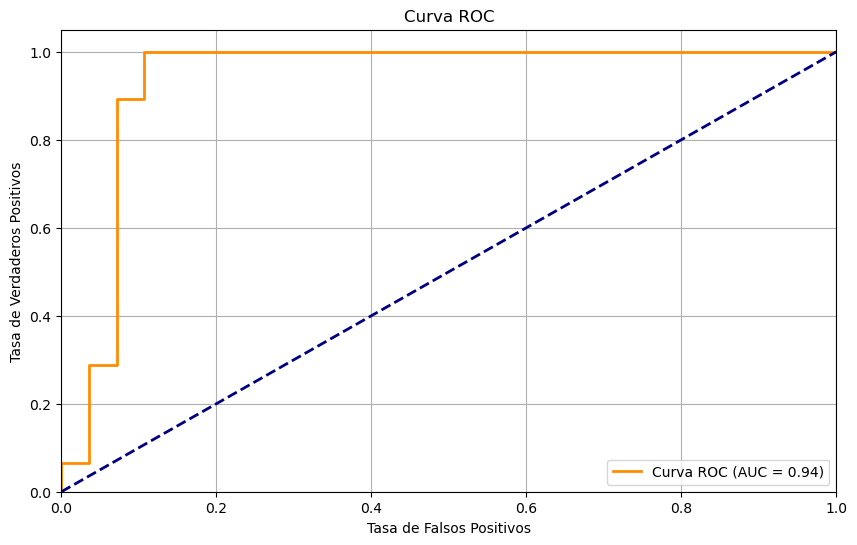

AUC: 0.21402877697841727


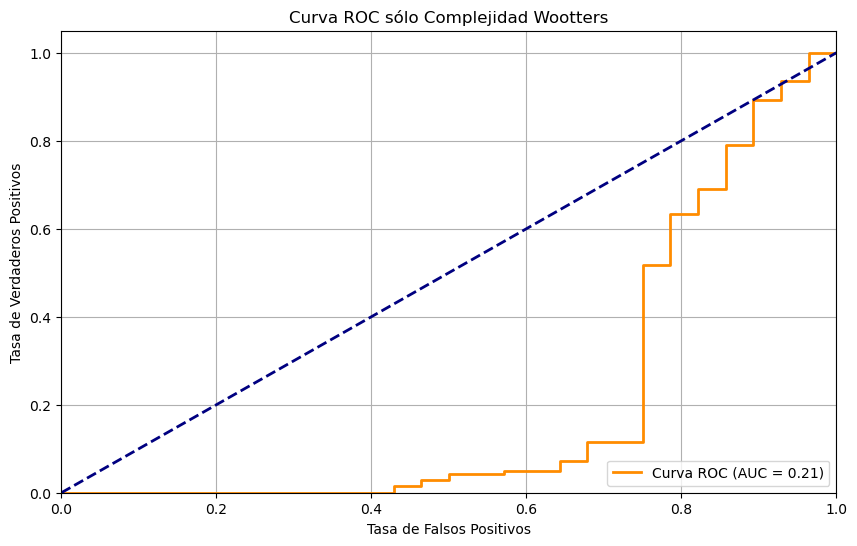

AUC: 0.9373072970195273


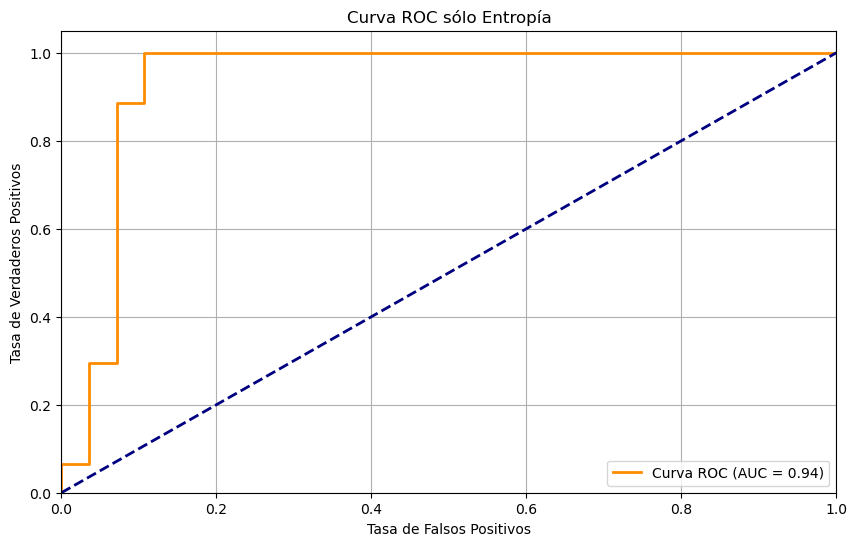

bior2.8
Estadístico: 0.8357437252998352
Valor p: 3.639685428047379e-11
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.7703582048416138
Valor p: 3.345237564644776e-05
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 3619.0
Valor p: 7.776243251399863e-13
Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)
---------------------------------------------------------------------------
AUC: 0.920349434737924
Confusion Matrix:
TN: 23
FP: 5
FN: 0
TP: 139
Accuracy: 0.9700598802395209
Precision: 0.9652777777777778
Recall: 1.0
F1-Score: 0.9823321554770319
Tiempo entrenamiento: 0.001993894577026367
Tiempo predicción: 0.00048613548278808594


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


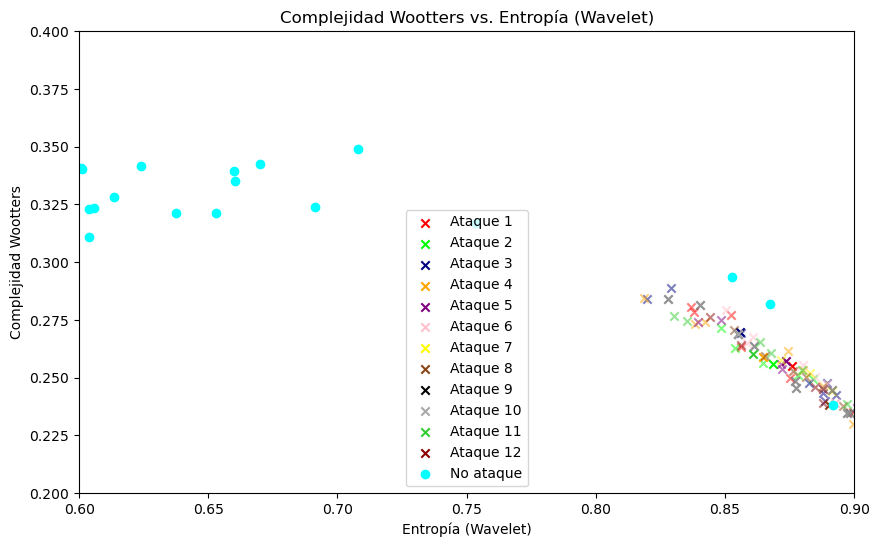

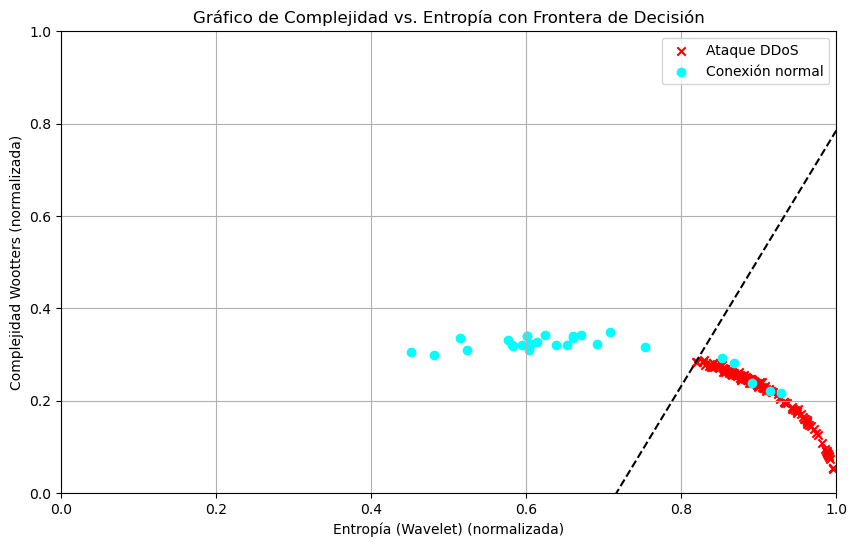

AUC: 0.920349434737924


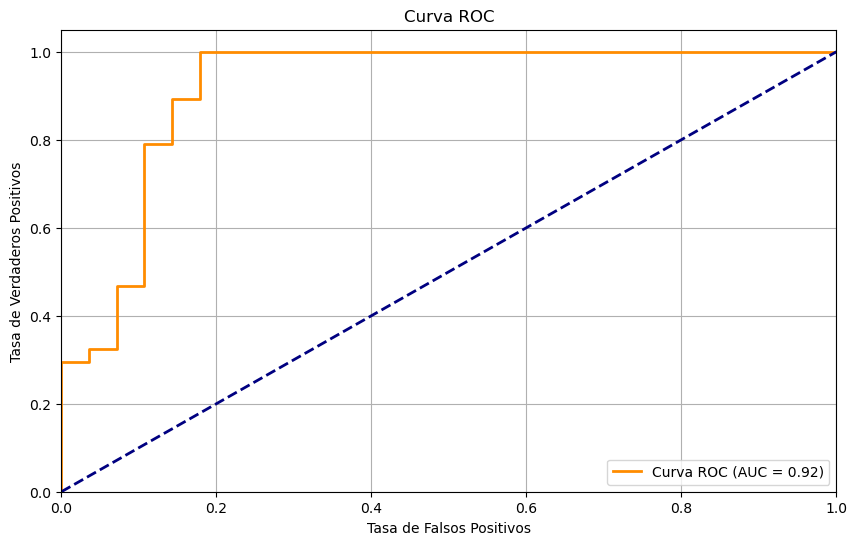

AUC: 0.07014388489208631


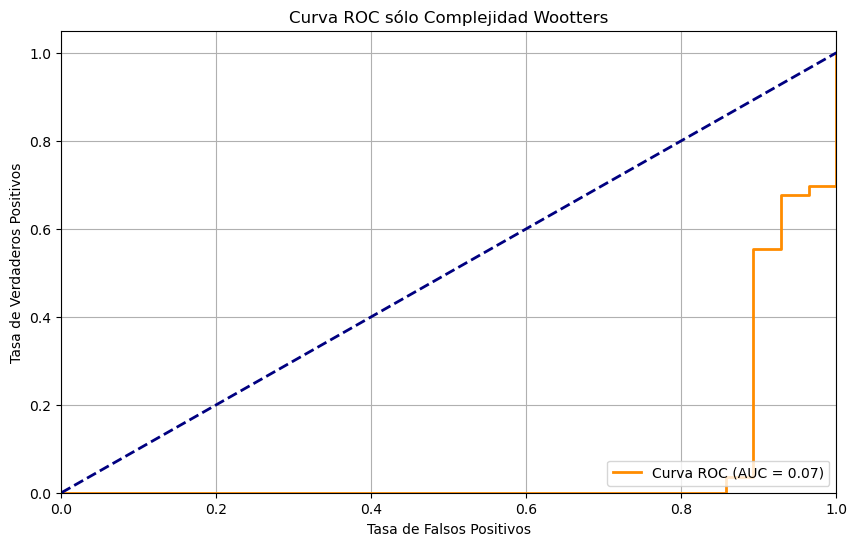

AUC: 0.9172661870503596


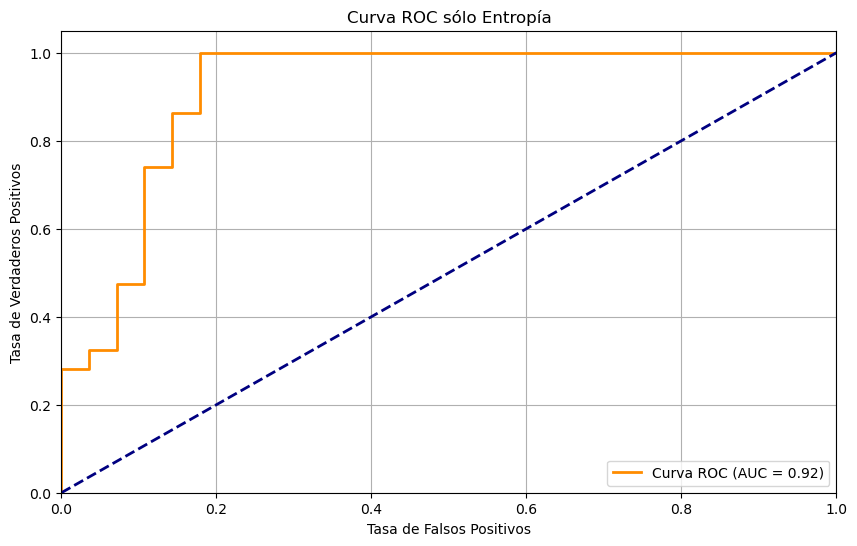

rbio1.5
Estadístico: 0.6932905912399292
Valor p: 1.142153413879565e-15
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.7339037656784058
Valor p: 8.918439561966807e-06
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 2420.0
Valor p: 0.042510379134940234
Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)
---------------------------------------------------------------------------
AUC: 0.5056526207605344
Confusion Matrix:
TN: 7
FP: 21
FN: 0
TP: 139
Accuracy: 0.874251497005988
Precision: 0.86875
Recall: 1.0
F1-Score: 0.9297658862876255
Tiempo entrenamiento: 0.0019178390502929688
Tiempo predicción: 0.0004837512969970703


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


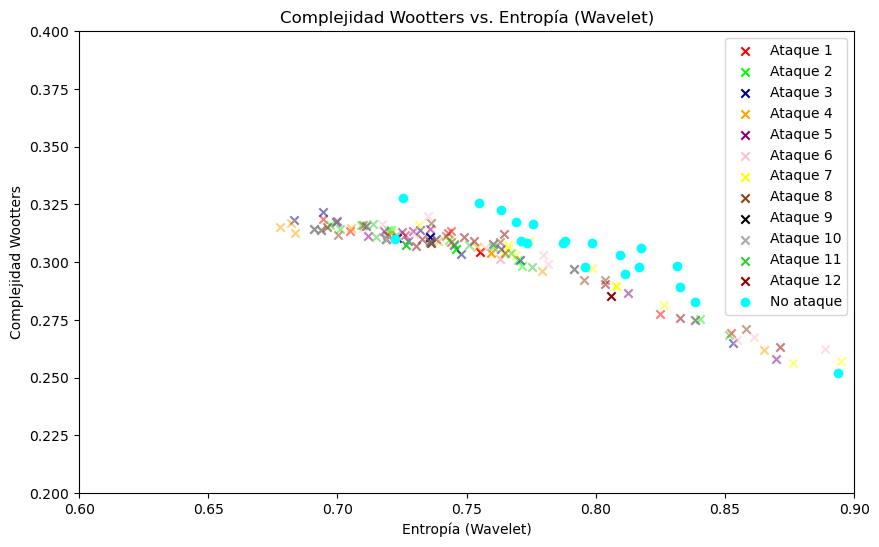

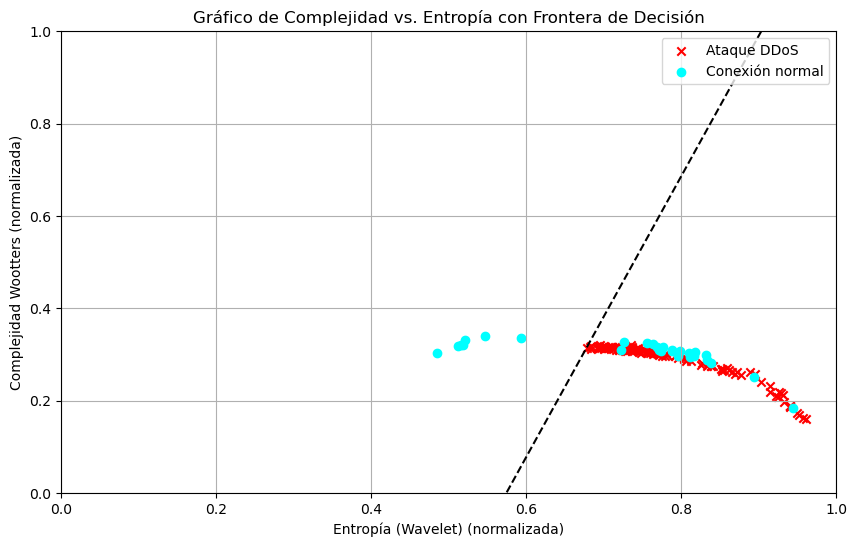

AUC: 0.5056526207605344


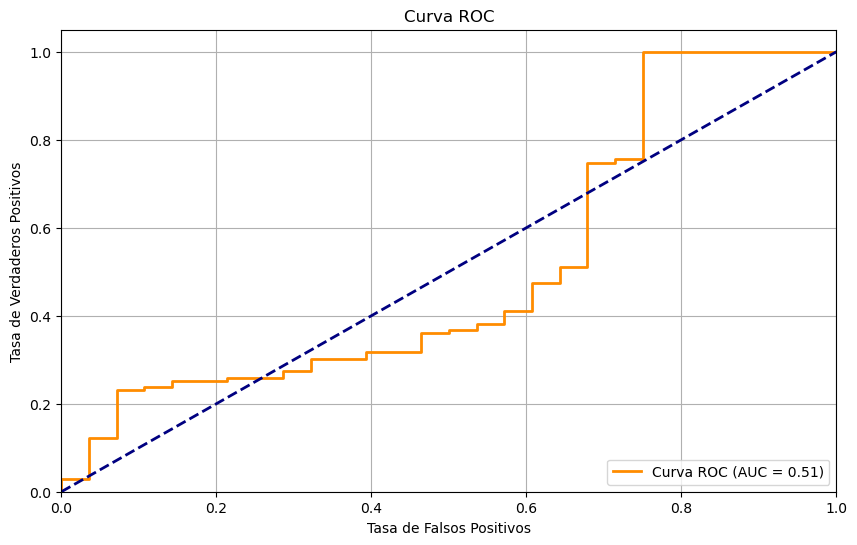

AUC: 0.37821171634121276


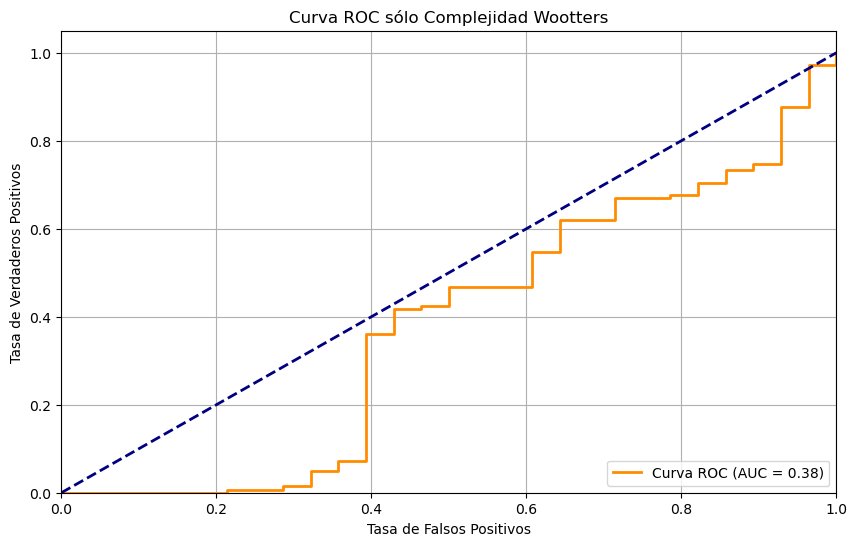

AUC: 0.4961459403905447


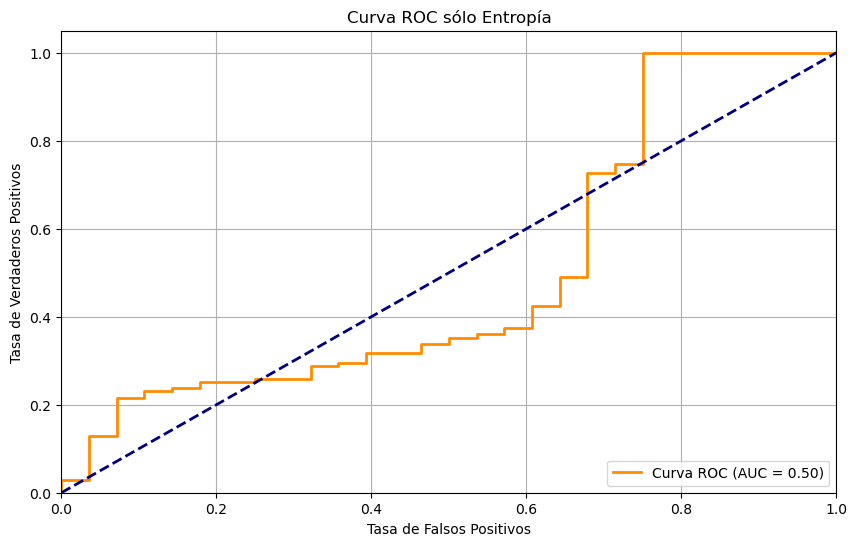

          0         1         2         3
0    family   auc_c-h     auc_c     auc_h
1   bior1.1  0.951696   0.17112  0.946557
2       db1  0.951696   0.17112  0.946557
3      haar  0.951696   0.17112  0.946557
4   rbio1.1  0.951696   0.17112  0.946557
5   bior2.4   0.89594  0.110997  0.895683
6   bior1.3  0.945015  0.528777  0.945015
7   rbio1.3  0.611254  0.257194  0.596095
8   bior1.5  0.937307  0.214029  0.937307
9   bior2.8  0.920349  0.070144  0.917266
10  rbio1.5  0.505653  0.378212  0.496146


In [617]:
wootters_reps = []
wootters_reps.append(["family","auc_c-h","auc_c","auc_h"])
for i in range(10):
    fila = []
    print(ranked_wavelets_wr[i][0])
    fila.append(ranked_wavelets_wr[i][0])
    df = calculate_desequilibrium_and_complexity(file_paths,ranked_wavelets_wr[i][0])
    plot_complexity_entropy(df,'Complejidad Wootters')
        # Realizar la prueba de Shapiro-Wilk
    stat, p_value = shapiro(df['Complejidad Wootters'][:sum(reps)])

    # Imprimir los resultados
    print('Estadístico:', stat)
    print('Valor p:', p_value)

    # Evaluar la normalidad
    alpha = 0.05
    if p_value > alpha:
        print('La muestra parece provenir de una distribución normal (no se rechaza la hipótesis nula)')
    else:
        print('La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)')

    # Realizar la prueba de Shapiro-Wilk
    stat, p_value = shapiro(df['Complejidad Wootters'][sum(reps):])

    print('Estadístico:', stat)
    print('Valor p:', p_value)

    # Evaluar la normalidad
    alpha = 0.05
    if p_value > alpha:
        print('La muestra parece provenir de una distribución normal (no se rechaza la hipótesis nula)')
    else:
        print('La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)')

    stat, p_value = mannwhitneyu(df['Complejidad Wootters'][sum(reps):], df['Complejidad Wootters'][:sum(reps)])

    # Imprimir los resultados
    print('Estadístico:', stat)
    print('Valor p:', p_value)

    # Evaluar la significancia
    alpha = 0.05
    if p_value > alpha:
        print('No hay diferencias significativas entre las muestras (no se rechaza la hipótesis nula)')
    else:
        print('Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)')
    print("---------------------------------------------------------------------------")
    df['Clasificación'] = [1]*sum(reps)+[0]*(len(df)-sum(reps))
    # Separar características y etiquetas
    X = df[['Entropía (Wavelet)', 'Complejidad Wootters']]  
    y = df['Clasificación']

    # Entrenar el modelo de regresión logística
    model = LogisticRegression()
    start_cpu_train = psutil.cpu_percent(interval=None)
    start_train = time.time()
    model.fit(X, y)
    end_train = time.time()
    end_cpu_train = psutil.cpu_percent(interval=None)
    cpu_usage_train = end_cpu_train - start_cpu_train
    training_time = end_train - start_train
    """
    # Generar una malla de puntos para graficar la frontera de decisión
    xx, yy = np.mgrid[0:1:.01, 0:1:.01]
    grid = np.c_[xx.ravel(), yy.ravel()]
    probs = model.predict_proba(grid)[:, 1].reshape(xx.shape)
    """
    # Definir x_min, x_max, y_min, y_max en base a los datos normalizados
    x_min, x_max = X['Entropía (Wavelet)'].min() - 0.1, X['Entropía (Wavelet)'].max() + 0.1
    y_min, y_max = X['Complejidad Wootters'].min() - 0.1, X['Complejidad Wootters'].max() + 0.1

    # Asegurarse de que los límites estén dentro del rango 0-1
    x_min, x_max = max(0, x_min), min(1, x_max)
    y_min, y_max = max(0, y_min), min(1, y_max)

    xx, yy = np.meshgrid(np.linspace(0, 1, 100), np.linspace(0, 1, 100))
    start_cpu = psutil.cpu_percent(interval=None)
    start_pred = time.time()
    y_pred_prob = model.predict_proba(X)[:, 1]
    end_pred = time.time()
    end_cpu = psutil.cpu_percent(interval=None)
    cpu_usage = end_cpu - start_cpu
    prediction_time = end_pred - start_pred
    #print(y_pred_prob)

    # Calcular la curva ROC y el AUC
    fpr, tpr, thresholds = roc_curve(y, y_pred_prob)
    roc_auc = roc_auc_score(y, y_pred_prob)
    print("AUC:",roc_auc)
    fila.append(roc_auc)

    f1_scores = [f1_score(y, (y_pred_prob >= thresh).astype(int)) for thresh in thresholds]

    # Encontrar el umbral que maximiza el F1-Score
    optimal_threshold = thresholds[np.argmax(f1_scores)]
    

    # Predecir con el modelo
    
    Z = model.predict_proba(np.c_[xx.ravel(), yy.ravel()])[:, 1]
    Z = Z.reshape(xx.shape)
    
    # Predecir etiquetas binarias usando el umbral óptimo
    y_pred_optimal = (y_pred_prob >= optimal_threshold).astype(int)

    # Calcular la matriz de confusión
    tn, fp, fn, tp = confusion_matrix(y, y_pred_optimal).ravel()

    print("Confusion Matrix:")
    print("TN:", tn)
    print("FP:", fp)
    print("FN:", fn)
    print("TP:", tp)

    # Opcional: Calcular otras métricas de evaluación
    accuracy = (tp + tn) / (tp + tn + fp + fn)
    precision = tp / (tp + fp)
    recall = tp / (tp + fn)
    f1 = 2 * (precision * recall) / (precision + recall)

    print("Accuracy:", accuracy)
    print("Precision:", precision)
    print("Recall:", recall)
    print("F1-Score:", f1)
    print("Tiempo entrenamiento:",training_time)
    print("Tiempo predicción:",prediction_time)
    #print("% uso CPU entrenamiento:",cpu_usage_train)
    #print("% uso CPU predicción:",cpu_usage)
    
    

    # Graficar los puntos y la frontera de decisión
    
    
    # Graficar los puntos y la frontera de decisión
    plt.figure(figsize=(10, 6))
    plt.scatter(X[y == 1]['Entropía (Wavelet)'], X[y == 1]['Complejidad Wootters'], marker='x', label='Ataque DDoS', c="Red")
    plt.scatter(X[y == 0]['Entropía (Wavelet)'], X[y == 0]['Complejidad Wootters'], marker='o', label='Conexión normal', c="Cyan")

    # Contorno de la frontera de decisión
    #plt.contour(xx, yy, probs, levels=[0.5], cmap="Greys", vmin=0, vmax=1)
    #plt.contourf(xx, yy, Z, alpha=0.8, cmap='coolwarm')
    plt.contour(xx, yy, Z, levels=[optimal_threshold], colors='black', linestyles='--')
    plt.xlabel('Entropía (Wavelet) (normalizada)')
    plt.ylabel('Complejidad Wootters (normalizada)')
    plt.title('Gráfico de Complejidad vs. Entropía con Frontera de Decisión')
    plt.legend()
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.0])
    plt.grid(True)
    plt.show()
    
    # Predecir las probabilidades de la clase positiva
    y_pred_prob = model.predict_proba(X)[:, 1]
    #print(y_pred_prob)

    # Calcular la curva ROC y el AUC
    fpr, tpr, thresholds = roc_curve(y, y_pred_prob)

    roc_auc = roc_auc_score(y, y_pred_prob)
    print("AUC:",roc_auc)
    


    # Graficar la curva ROC
    plt.figure(figsize=(10, 6))
    plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'Curva ROC (AUC = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('Tasa de Falsos Positivos')
    plt.ylabel('Tasa de Verdaderos Positivos')
    plt.title('Curva ROC')
    plt.legend(loc="lower right")
    plt.grid(True)
    plt.show()
    
    # Calcular la curva ROC y el AUC para sólo complejidad
    fpr, tpr, thresholds = roc_curve(y, X["Complejidad Wootters"])
    roc_auc = roc_auc_score(y, X["Complejidad Wootters"])
    print("AUC:",roc_auc)
    fila.append(roc_auc)


    # Graficar la curva ROC
    plt.figure(figsize=(10, 6))
    plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'Curva ROC (AUC = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('Tasa de Falsos Positivos')
    plt.ylabel('Tasa de Verdaderos Positivos')
    plt.title('Curva ROC sólo Complejidad Wootters')
    plt.legend(loc="lower right")
    plt.grid(True)
    plt.show()
    
    # Calcular la curva ROC y el AUC para sólo complejidad
    fpr, tpr, thresholds = roc_curve(y, X['Entropía (Wavelet)'])
    roc_auc = roc_auc_score(y, X['Entropía (Wavelet)'])
    print("AUC:",roc_auc)
    fila.append(roc_auc)


    # Graficar la curva ROC
    plt.figure(figsize=(10, 6))
    plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'Curva ROC (AUC = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('Tasa de Falsos Positivos')
    plt.ylabel('Tasa de Verdaderos Positivos')
    plt.title('Curva ROC sólo Entropía')
    plt.legend(loc="lower right")
    plt.grid(True)
    plt.show()
    wootters_reps.append(fila)
    
print(pd.DataFrame(wootters_reps))

## Con repeticiones Eucl.

bior1.1
Estadístico: 0.900310754776001
Valor p: 3.578058738185064e-08
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.8431389331817627
Valor p: 0.0006817179382778704
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 1723.0
Valor p: 0.3404902748657779
No hay diferencias significativas entre las muestras (no se rechaza la hipótesis nula)
---------------------------------------------------------------------------
AUC: 0.947584789311408
Confusion Matrix:
TN: 23
FP: 5
FN: 0
TP: 139
Accuracy: 0.9700598802395209
Precision: 0.9652777777777778
Recall: 1.0
F1-Score: 0.9823321554770319
Tiempo entrenamiento: 0.0035779476165771484
Tiempo predicción: 0.0004837512969970703


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


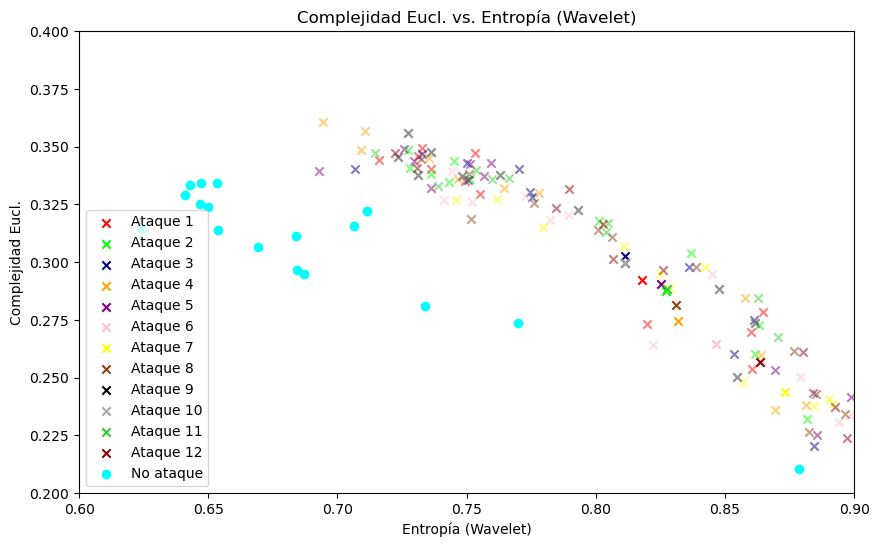

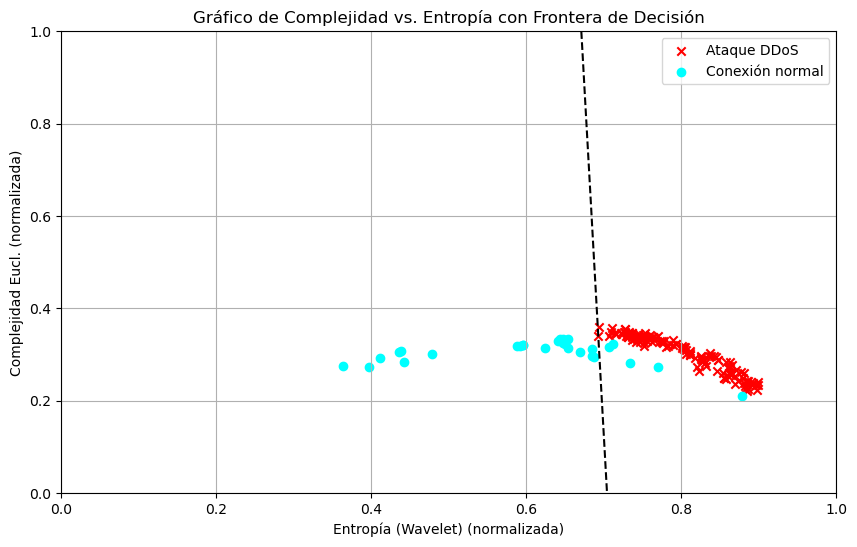

AUC: 0.947584789311408


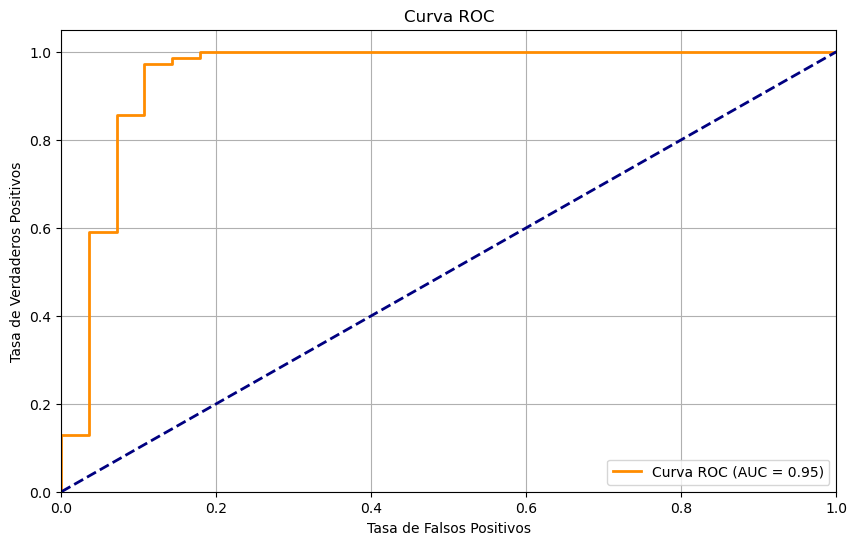

AUC: 0.5572970195272354


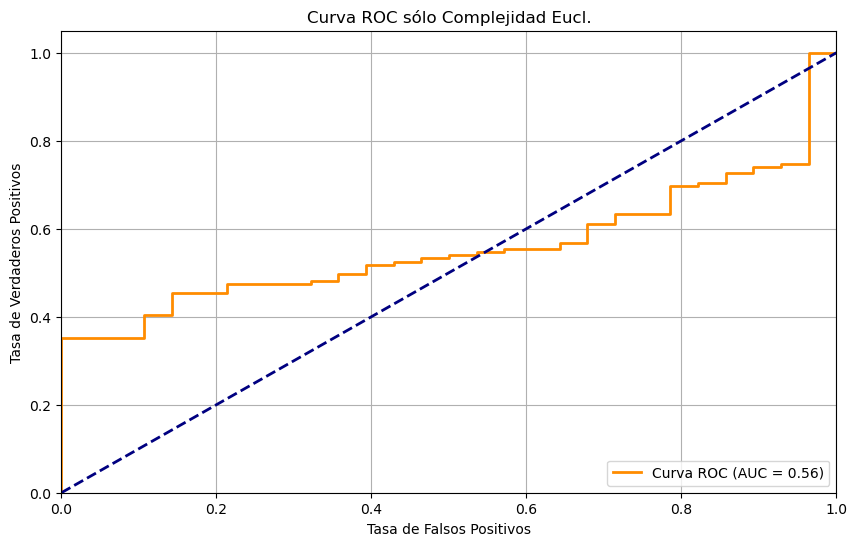

AUC: 0.9465570400822199


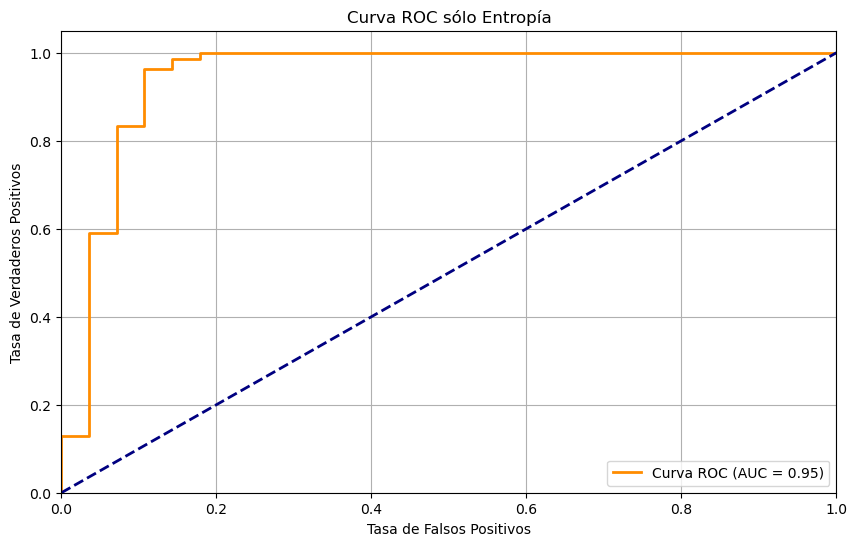

db1
Estadístico: 0.900310754776001
Valor p: 3.578058738185064e-08
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.8431389331817627
Valor p: 0.0006817179382778704
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 1723.0
Valor p: 0.3404902748657779
No hay diferencias significativas entre las muestras (no se rechaza la hipótesis nula)
---------------------------------------------------------------------------
AUC: 0.947584789311408
Confusion Matrix:
TN: 23
FP: 5
FN: 0
TP: 139
Accuracy: 0.9700598802395209
Precision: 0.9652777777777778
Recall: 1.0
F1-Score: 0.9823321554770319
Tiempo entrenamiento: 0.0019311904907226562
Tiempo predicción: 0.0008831024169921875


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


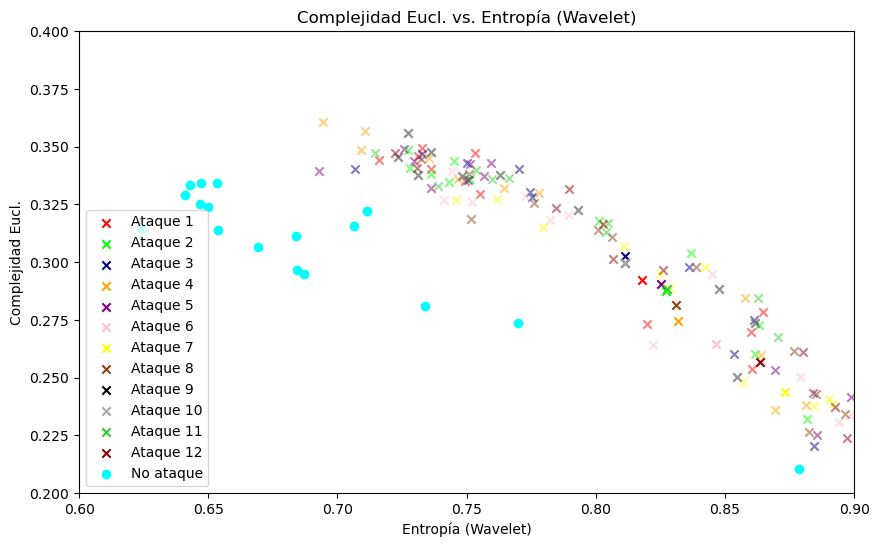

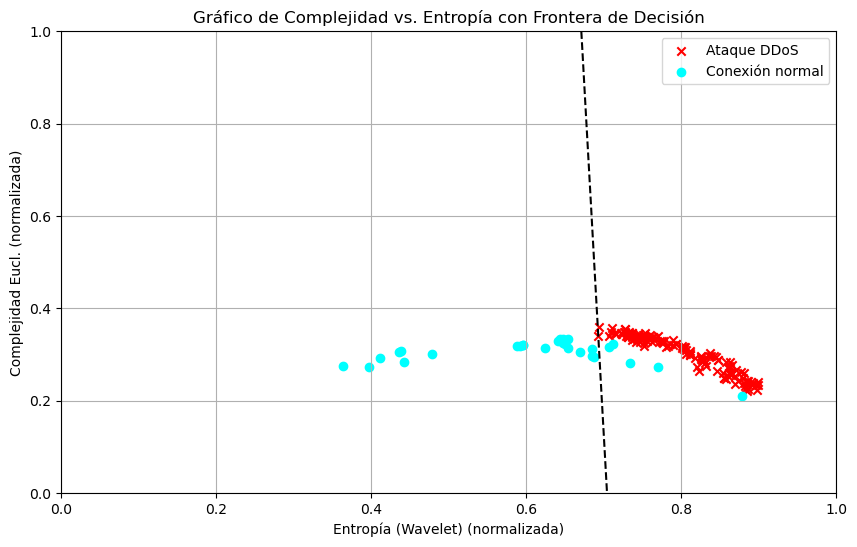

AUC: 0.947584789311408


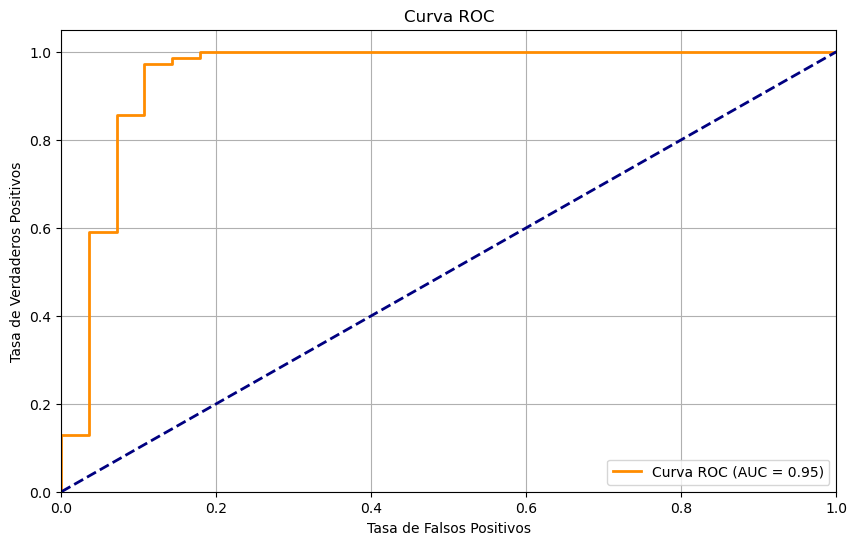

AUC: 0.5572970195272354


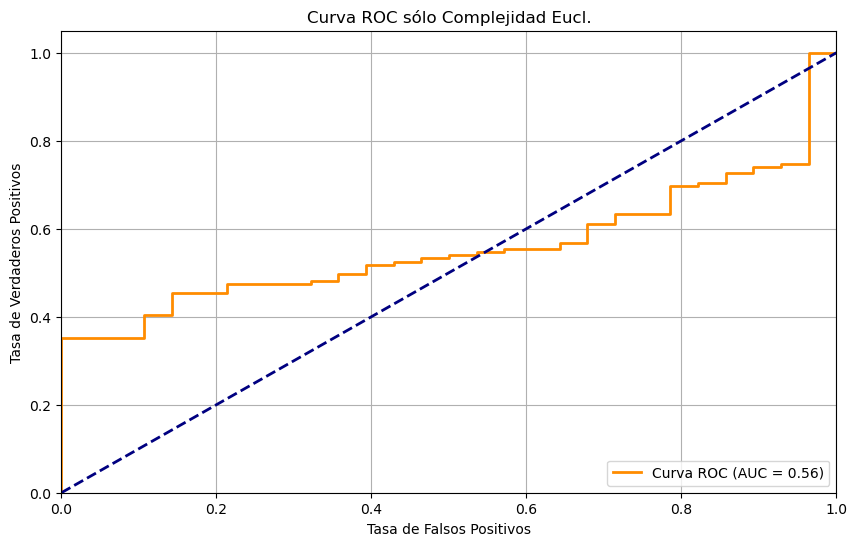

AUC: 0.9465570400822199


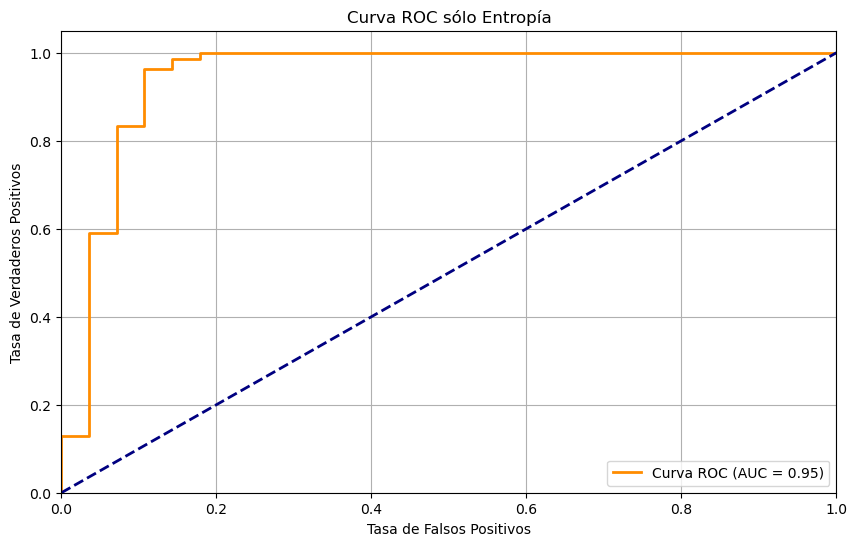

haar
Estadístico: 0.900310754776001
Valor p: 3.578058738185064e-08
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.8431389331817627
Valor p: 0.0006817179382778704
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 1723.0
Valor p: 0.3404902748657779
No hay diferencias significativas entre las muestras (no se rechaza la hipótesis nula)
---------------------------------------------------------------------------
AUC: 0.947584789311408
Confusion Matrix:
TN: 23
FP: 5
FN: 0
TP: 139
Accuracy: 0.9700598802395209
Precision: 0.9652777777777778
Recall: 1.0
F1-Score: 0.9823321554770319
Tiempo entrenamiento: 0.0023238658905029297
Tiempo predicción: 0.001081705093383789


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


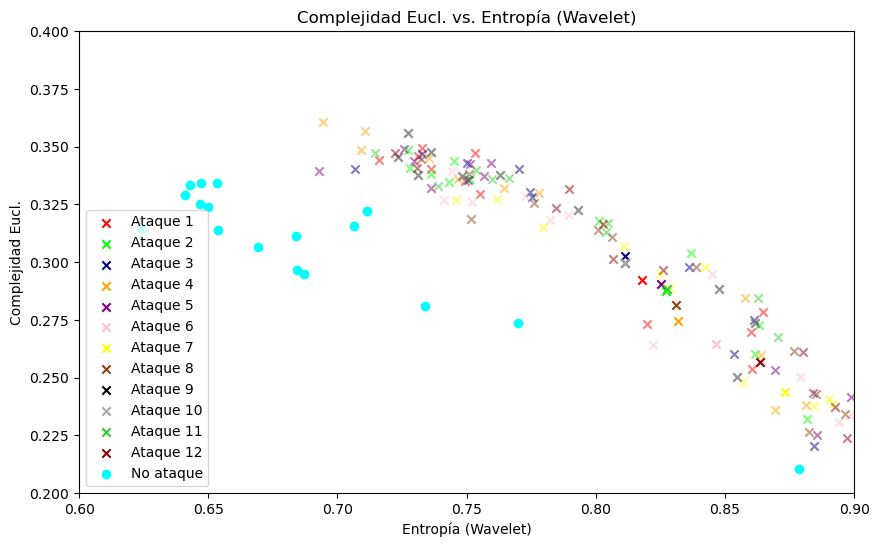

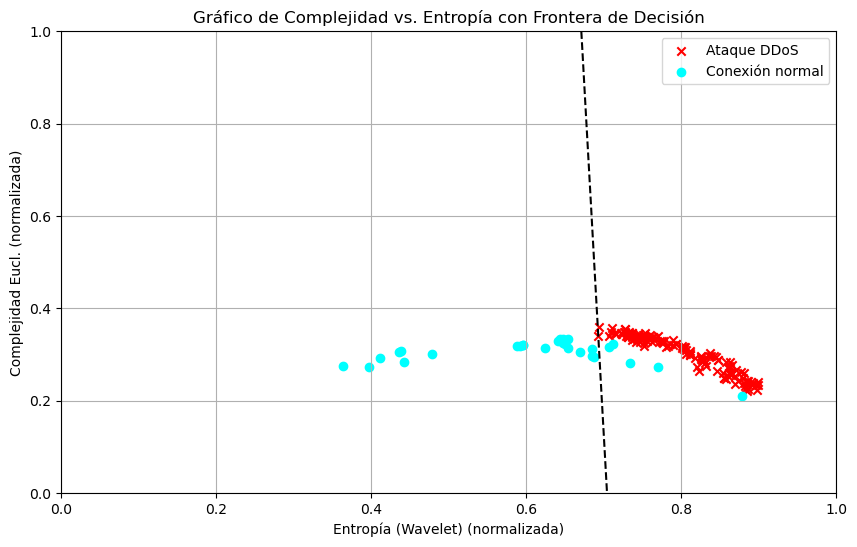

AUC: 0.947584789311408


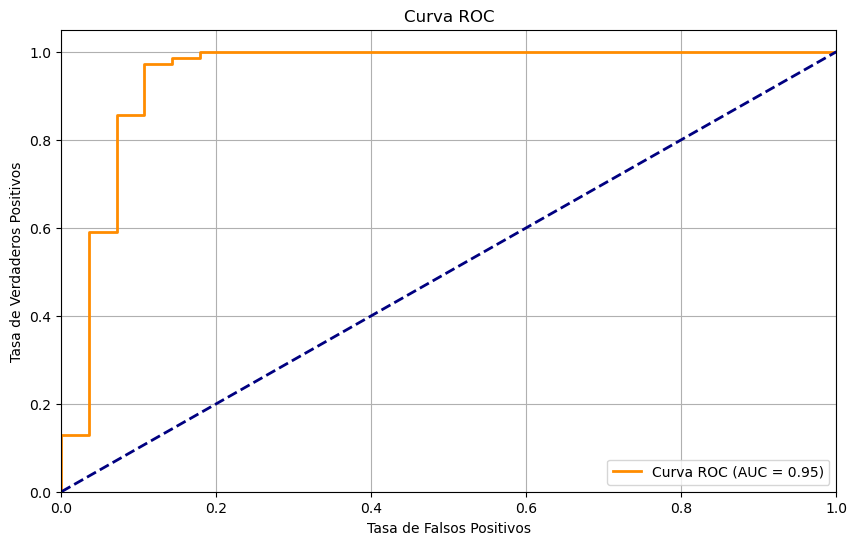

AUC: 0.5572970195272354


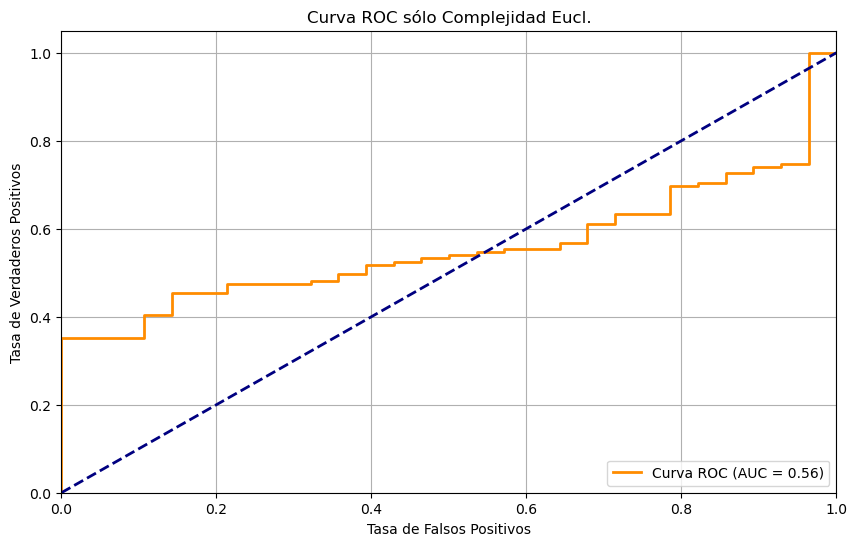

AUC: 0.9465570400822199


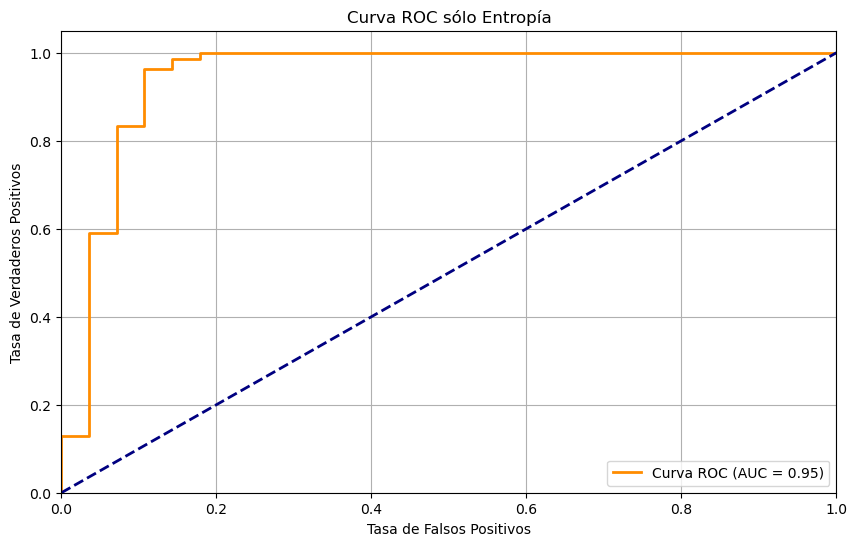

rbio1.1
Estadístico: 0.900310754776001
Valor p: 3.578058738185064e-08
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.8431389331817627
Valor p: 0.0006817179382778704
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 1723.0
Valor p: 0.3404902748657779
No hay diferencias significativas entre las muestras (no se rechaza la hipótesis nula)
---------------------------------------------------------------------------
AUC: 0.947584789311408
Confusion Matrix:
TN: 23
FP: 5
FN: 0
TP: 139
Accuracy: 0.9700598802395209
Precision: 0.9652777777777778
Recall: 1.0
F1-Score: 0.9823321554770319
Tiempo entrenamiento: 0.0019009113311767578
Tiempo predicción: 0.0007600784301757812


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


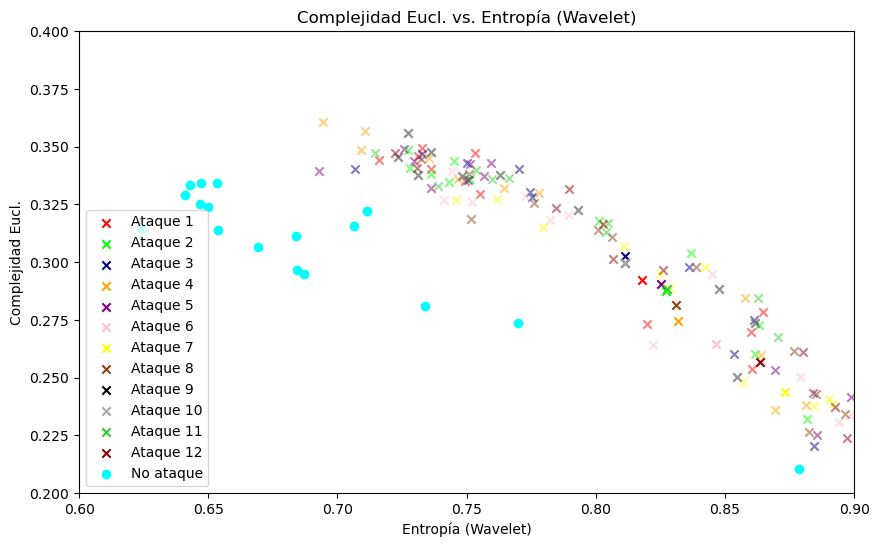

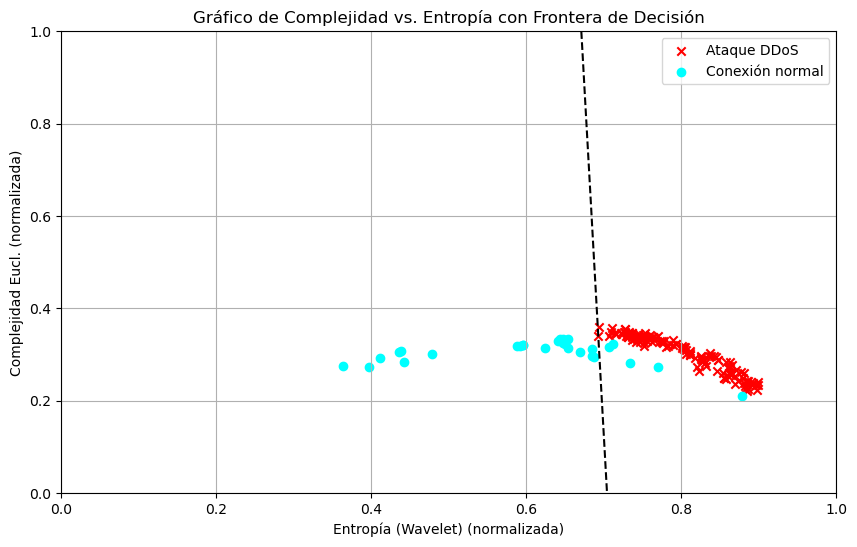

AUC: 0.947584789311408


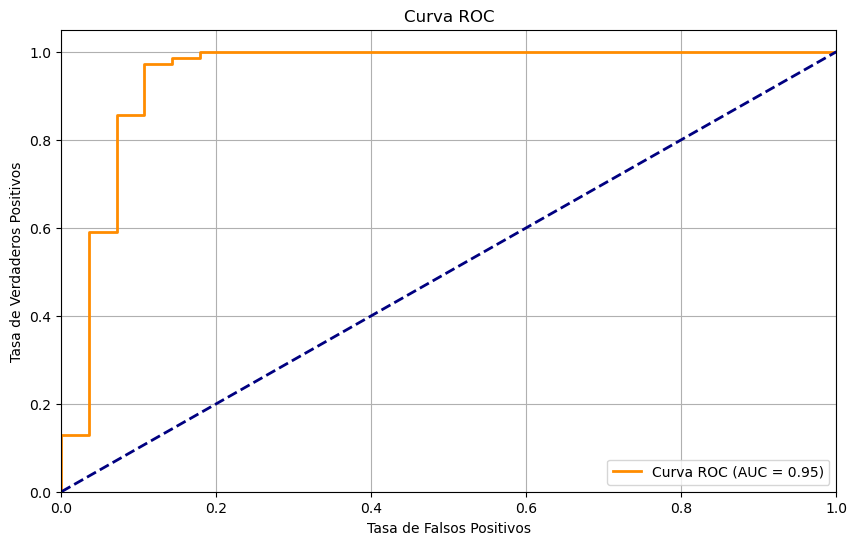

AUC: 0.5572970195272354


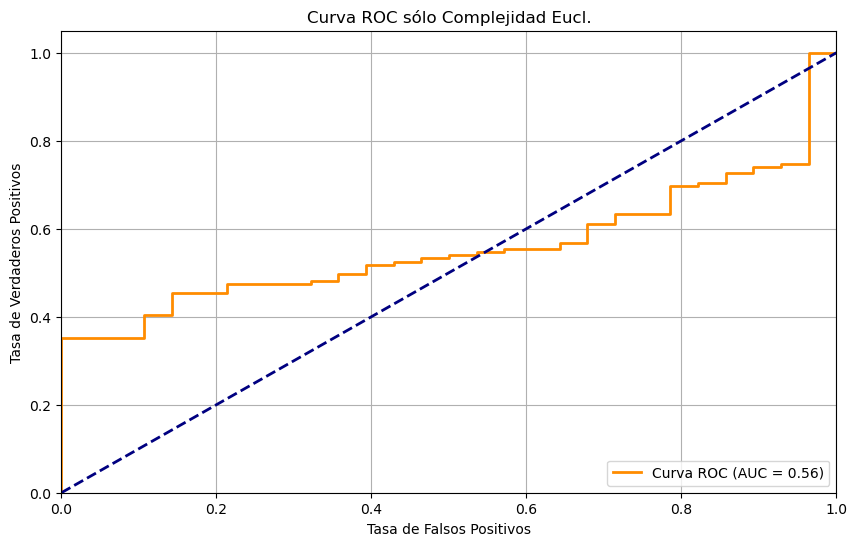

AUC: 0.9465570400822199


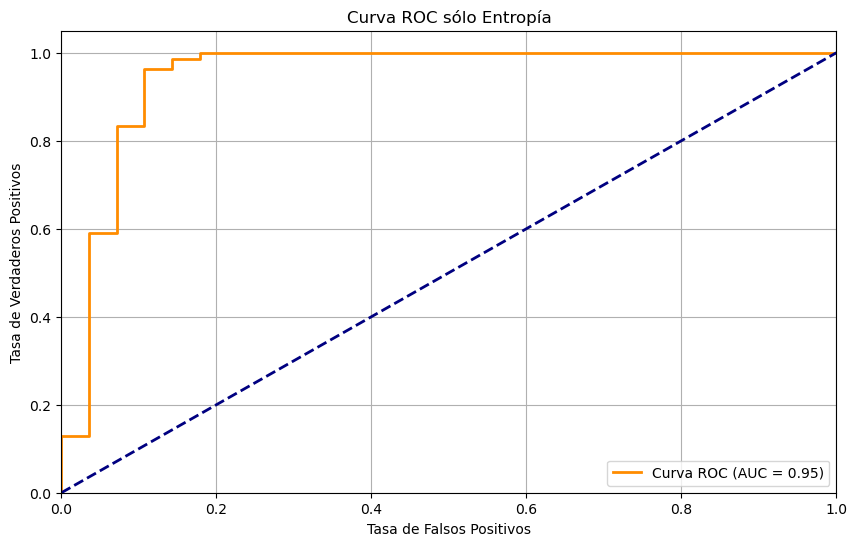

bior2.4
Estadístico: 0.8507259488105774
Valor p: 1.499590729370226e-10
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.9214876294136047
Valor p: 0.037755947560071945
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 3361.0
Valor p: 1.3632277562861584e-09
Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)
---------------------------------------------------------------------------
AUC: 0.8941418293936279
Confusion Matrix:
TN: 18
FP: 10
FN: 0
TP: 139
Accuracy: 0.9401197604790419
Precision: 0.9328859060402684
Recall: 1.0
F1-Score: 0.9652777777777778
Tiempo entrenamiento: 0.0019550323486328125
Tiempo predicción: 0.0009400844573974609


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


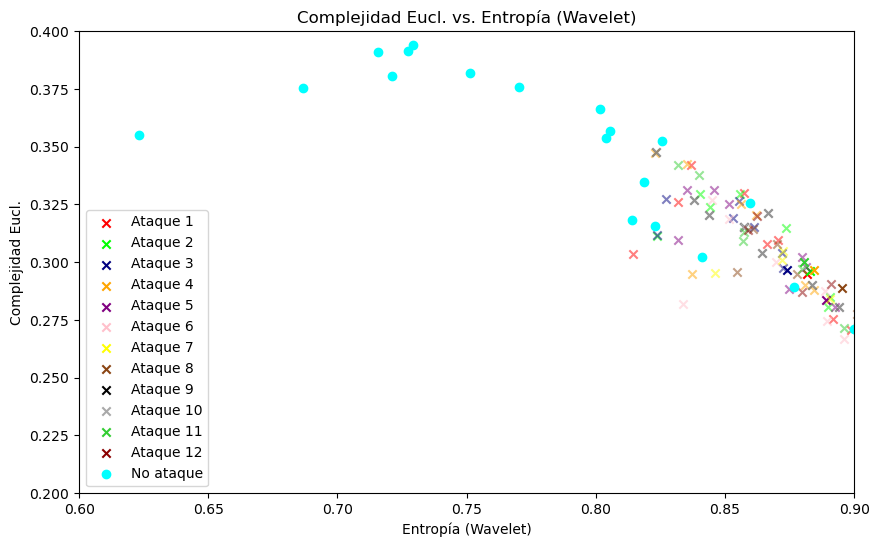

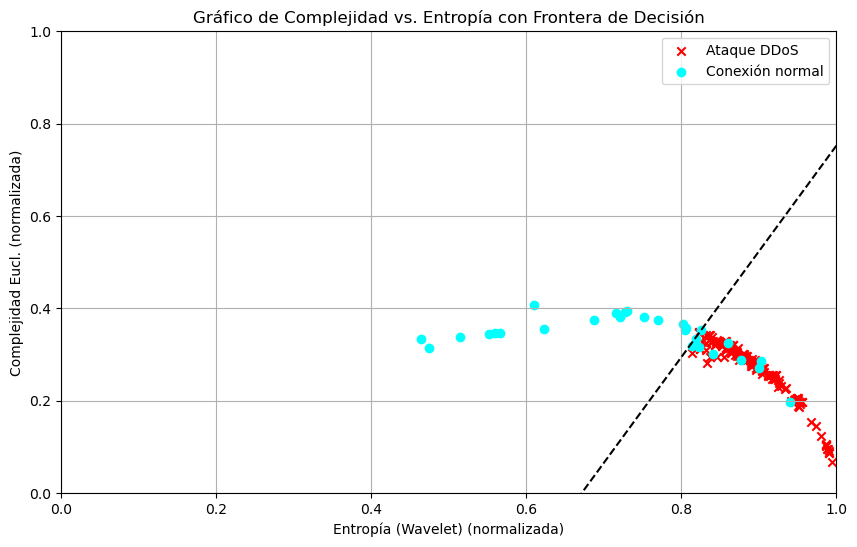

AUC: 0.8941418293936279


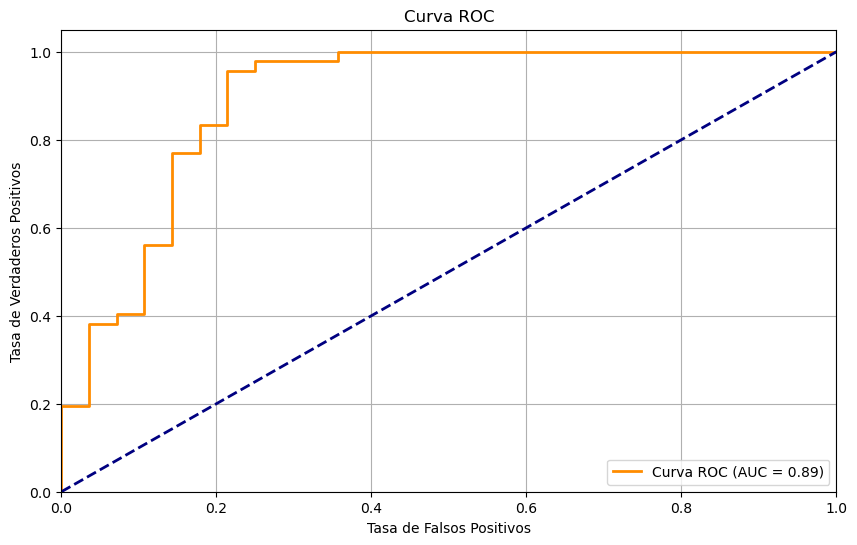

AUC: 0.13643371017471737


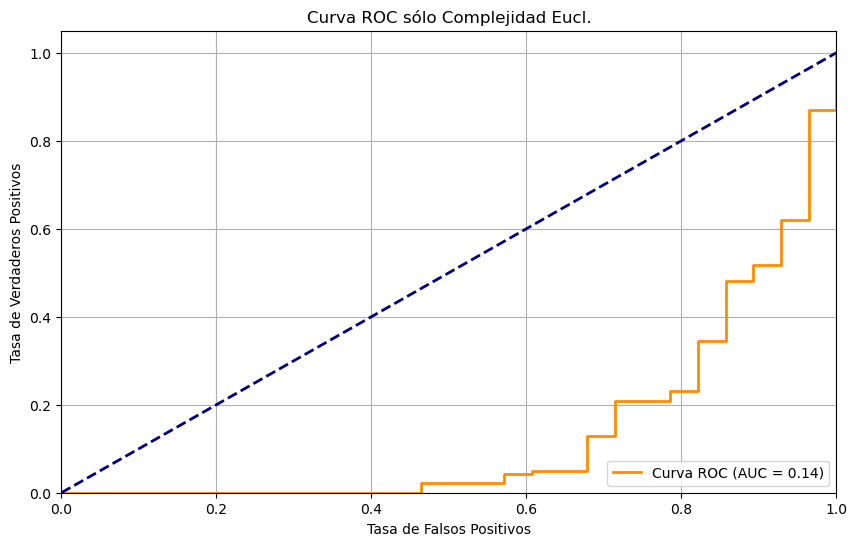

AUC: 0.8956834532374102


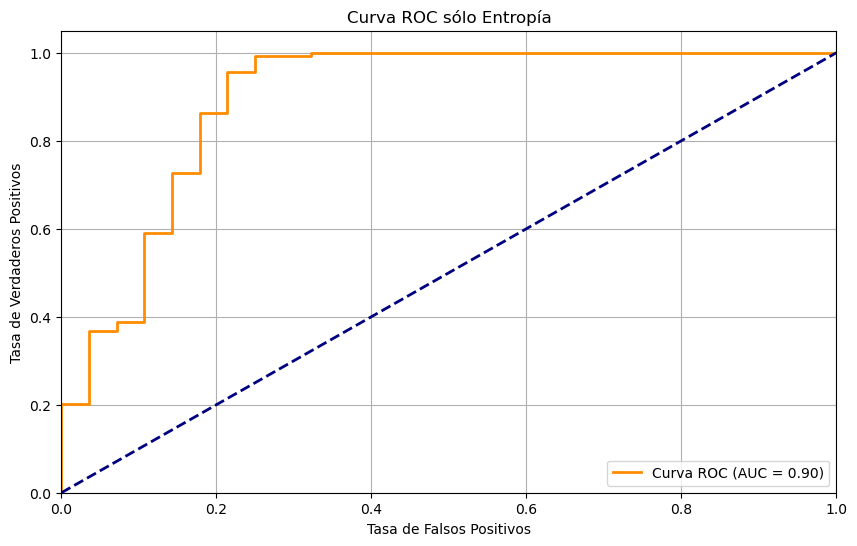

bior1.3
Estadístico: 0.8916435241699219
Valor p: 1.2344341548953253e-08
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.8932107090950012
Valor p: 0.007962102070450783
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 1337.0
Valor p: 0.00913838920138635
Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)
---------------------------------------------------------------------------
AUC: 0.9457862281603289
Confusion Matrix:
TN: 26
FP: 2
FN: 0
TP: 139
Accuracy: 0.9880239520958084
Precision: 0.9858156028368794
Recall: 1.0
F1-Score: 0.9928571428571429
Tiempo entrenamiento: 0.0019009113311767578
Tiempo predicción: 0.0011010169982910156


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


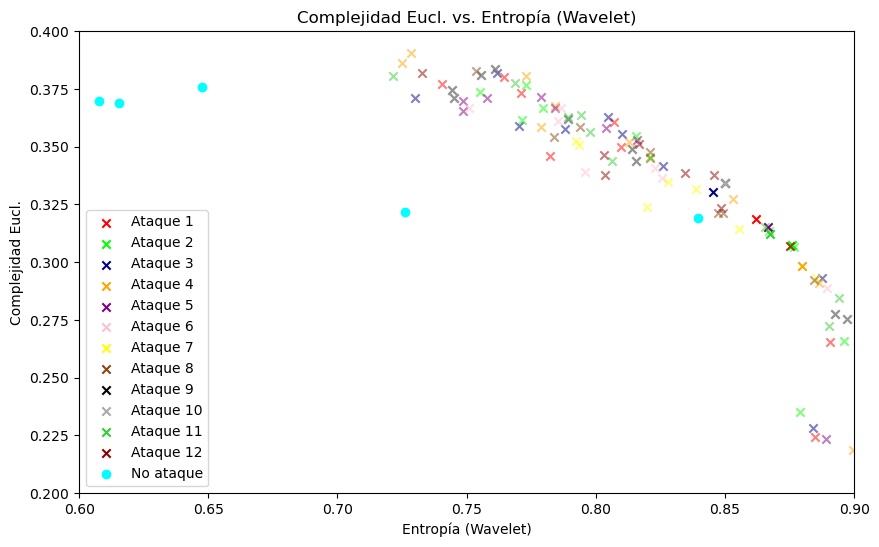

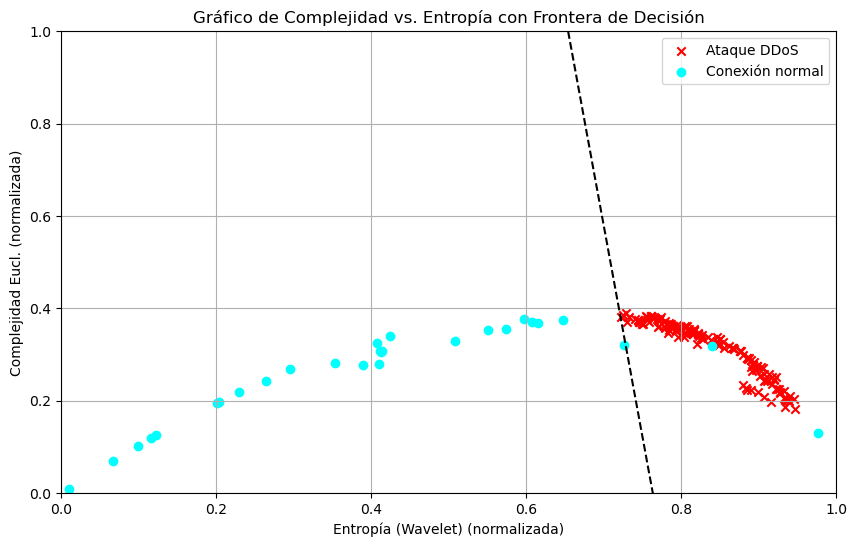

AUC: 0.9457862281603289


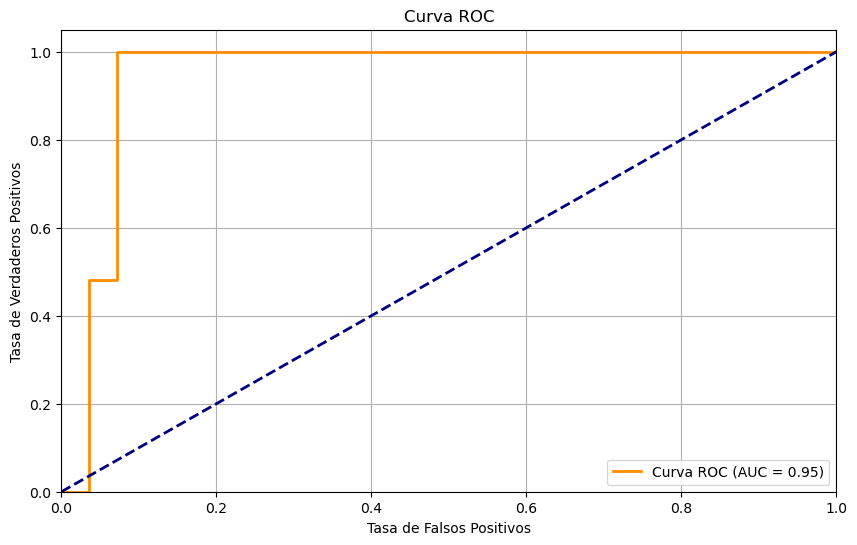

AUC: 0.6564748201438849


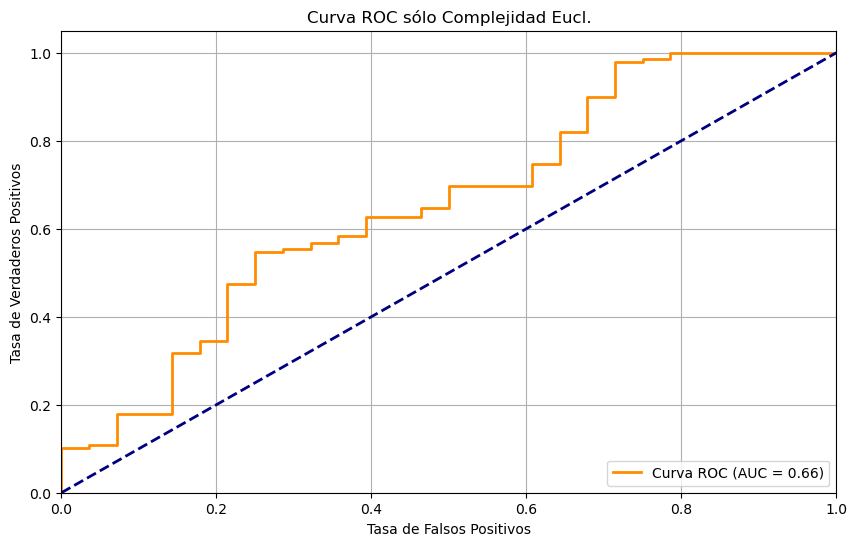

AUC: 0.9450154162384379


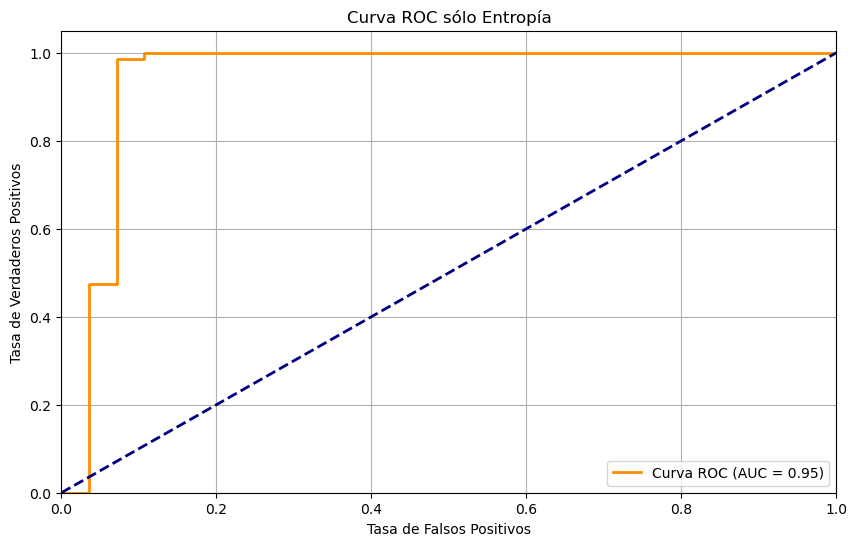

rbio1.3
Estadístico: 0.7928112745285034
Valor p: 9.674427058070645e-13
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.6839526891708374
Valor p: 1.7039245676642167e-06
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 1060.0
Valor p: 0.0001485327721301402
Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)
---------------------------------------------------------------------------
AUC: 0.6472250770811923
Confusion Matrix:
TN: 7
FP: 21
FN: 0
TP: 139
Accuracy: 0.874251497005988
Precision: 0.86875
Recall: 1.0
F1-Score: 0.9297658862876255
Tiempo entrenamiento: 0.0019268989562988281
Tiempo predicción: 0.0013661384582519531


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


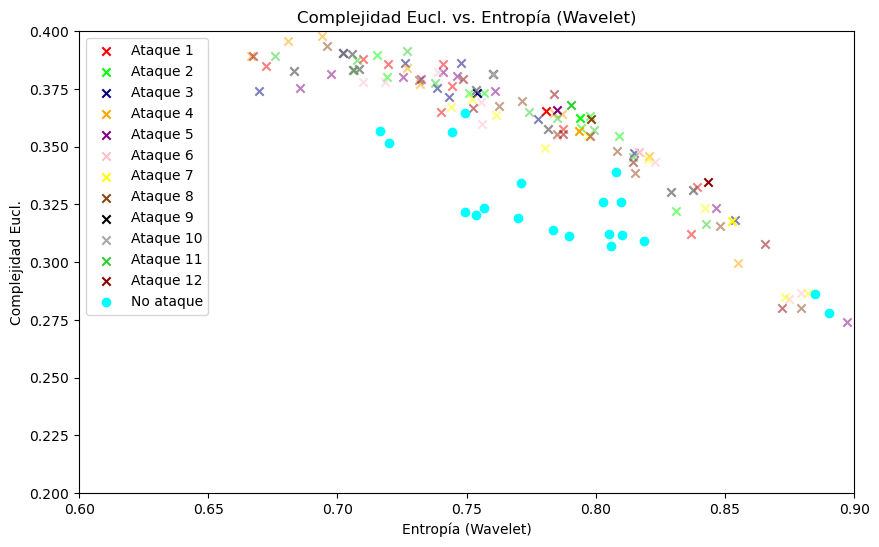

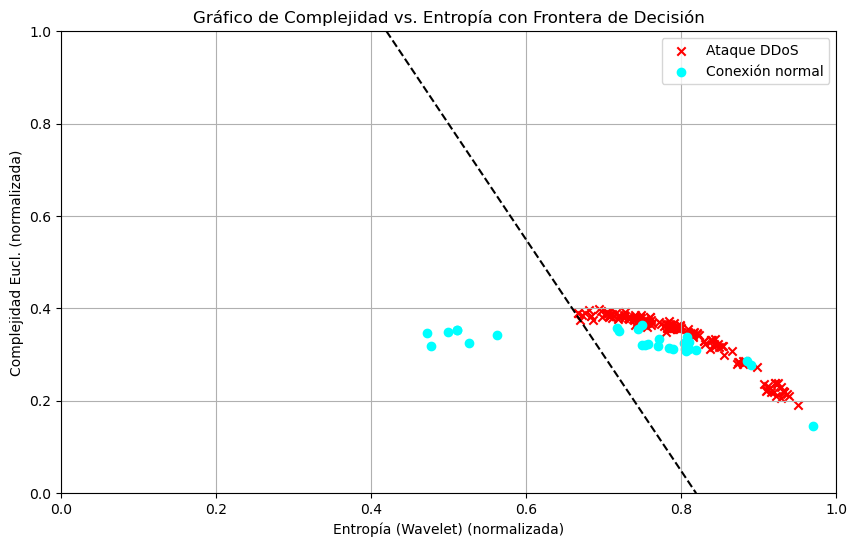

AUC: 0.6472250770811923


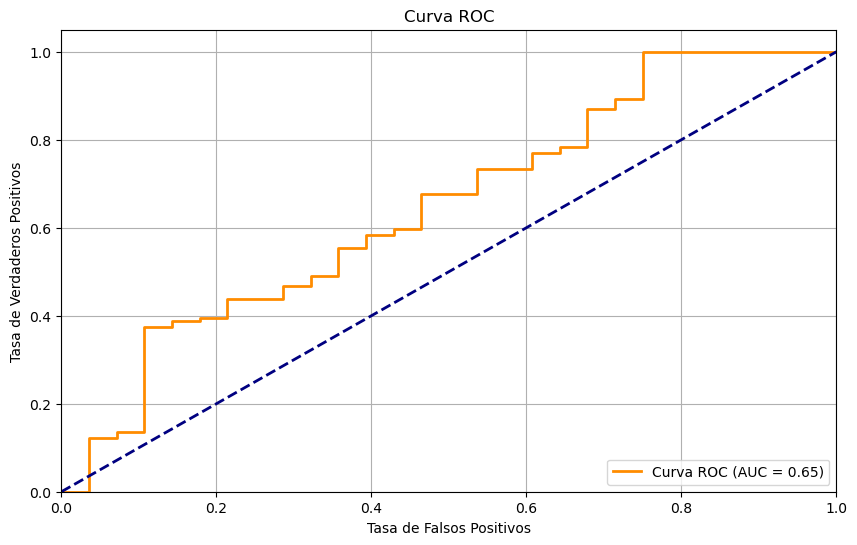

AUC: 0.7276464542651593


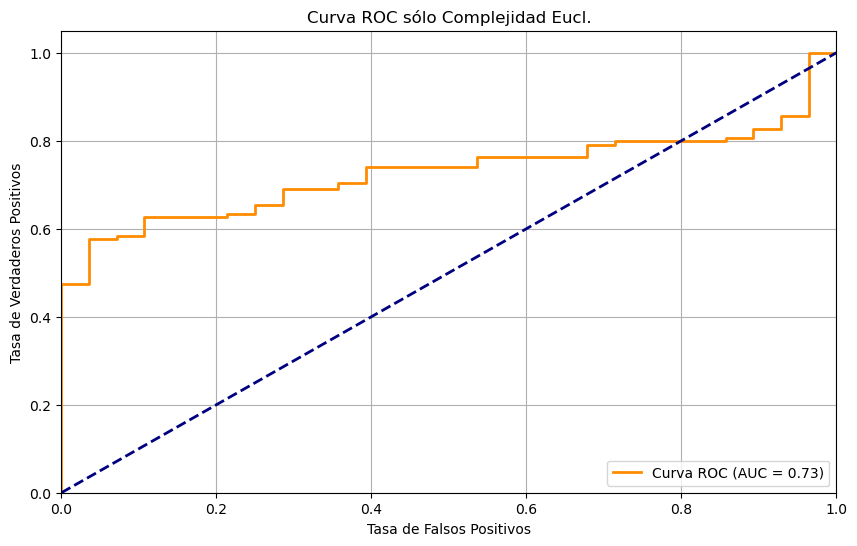

AUC: 0.5960945529290853


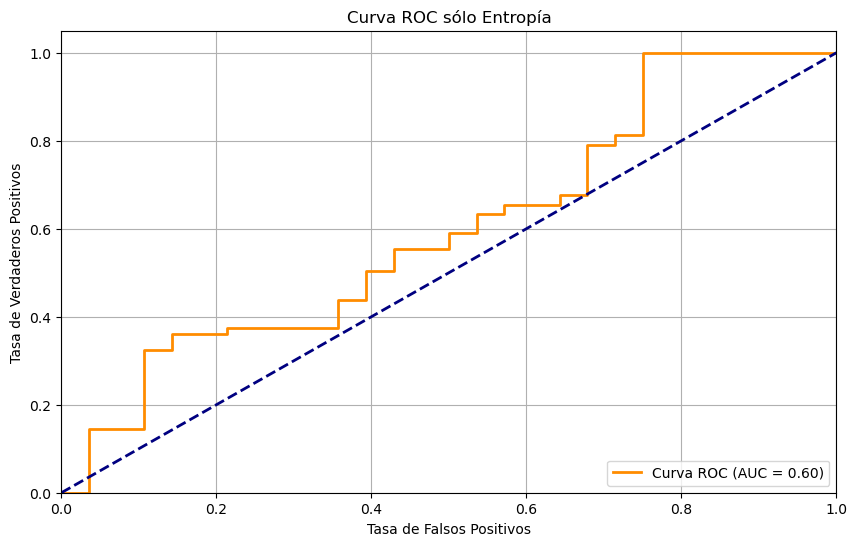

bior1.5
Estadístico: 0.8619557023048401
Valor p: 4.613898985095233e-10
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.7690434455871582
Valor p: 3.1833980756346136e-05
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 1239.0
Valor p: 0.0024726523328604936
Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)
---------------------------------------------------------------------------
AUC: 0.9378211716341214
Confusion Matrix:
TN: 25
FP: 3
FN: 0
TP: 139
Accuracy: 0.9820359281437125
Precision: 0.9788732394366197
Recall: 1.0
F1-Score: 0.9893238434163701
Tiempo entrenamiento: 0.0017960071563720703
Tiempo predicción: 0.0009179115295410156


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


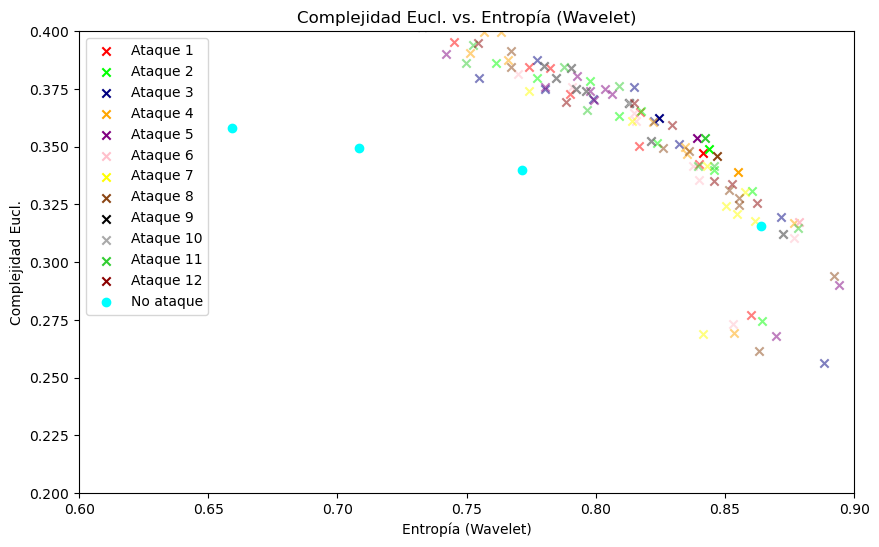

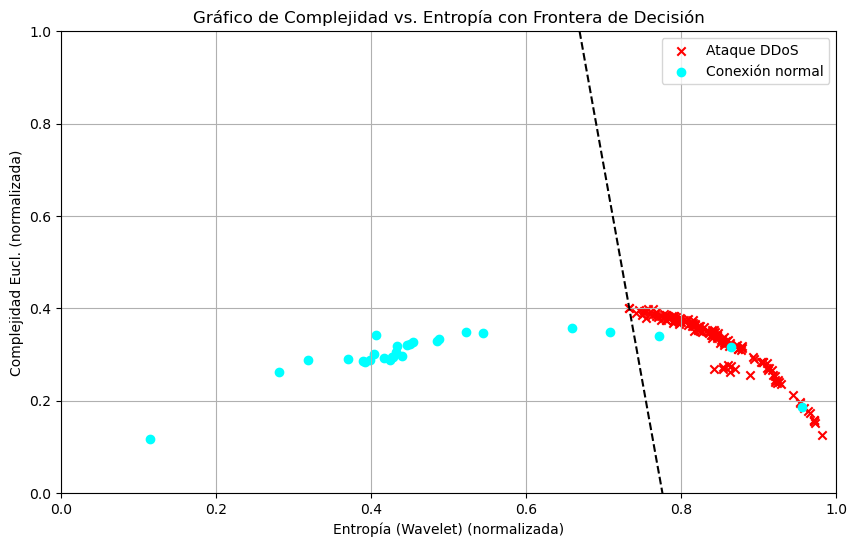

AUC: 0.9378211716341214


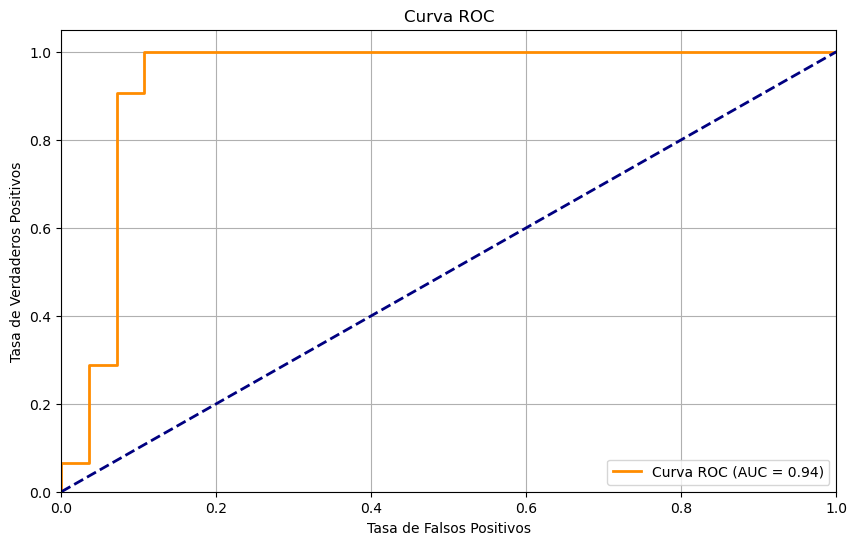

AUC: 0.6816546762589928


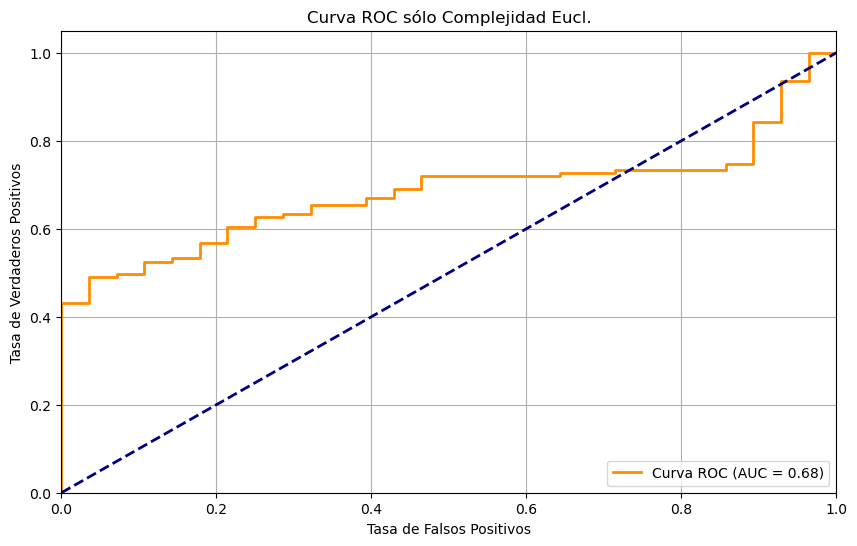

AUC: 0.9373072970195273


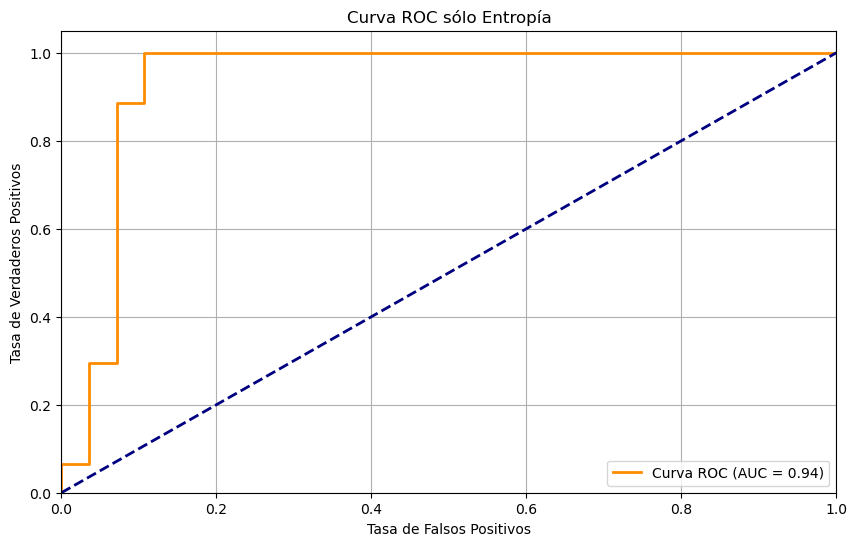

bior2.8
Estadístico: 0.8616382479667664
Valor p: 4.4660430909004845e-10
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.8867455720901489
Valor p: 0.005676099099218845
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 3446.0
Valor p: 1.3282206194414207e-10
Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)
---------------------------------------------------------------------------
AUC: 0.9116135662898253
Confusion Matrix:
TN: 23
FP: 5
FN: 0
TP: 139
Accuracy: 0.9700598802395209
Precision: 0.9652777777777778
Recall: 1.0
F1-Score: 0.9823321554770319
Tiempo entrenamiento: 0.002377033233642578
Tiempo predicción: 0.0006709098815917969


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


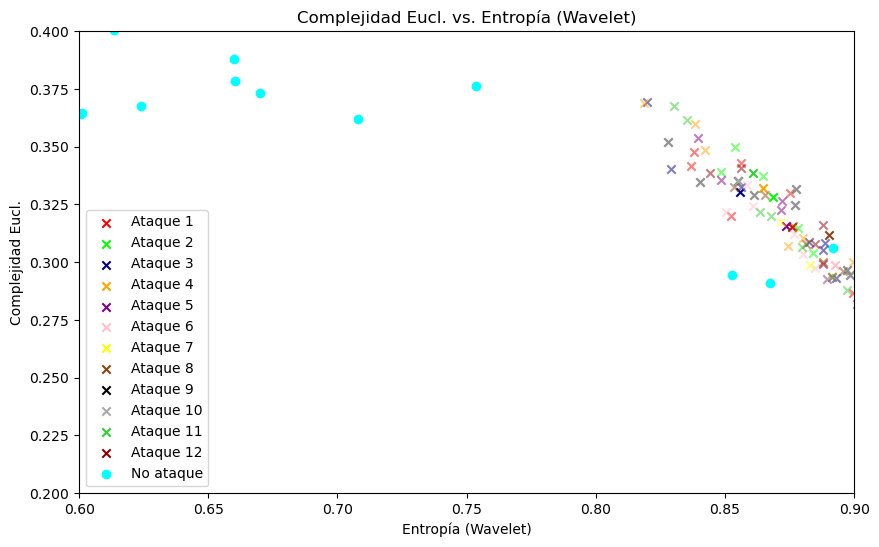

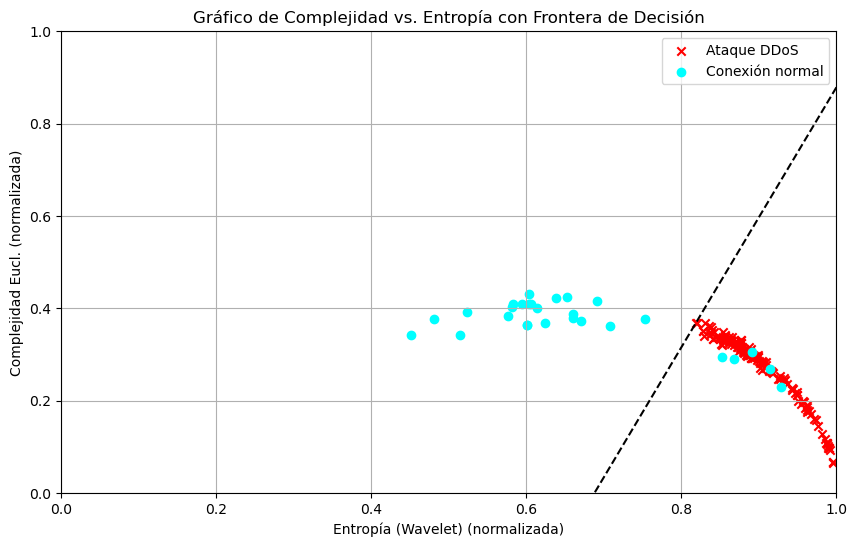

AUC: 0.9116135662898253


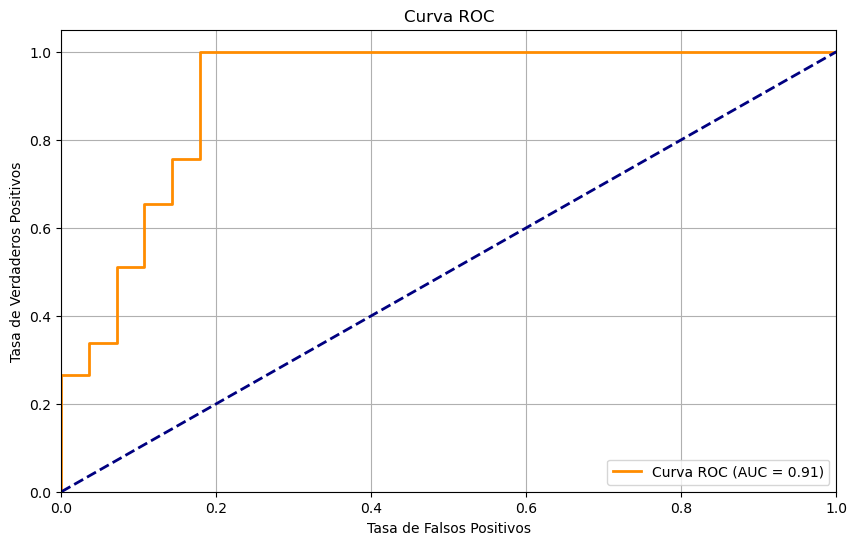

AUC: 0.11459403905447071


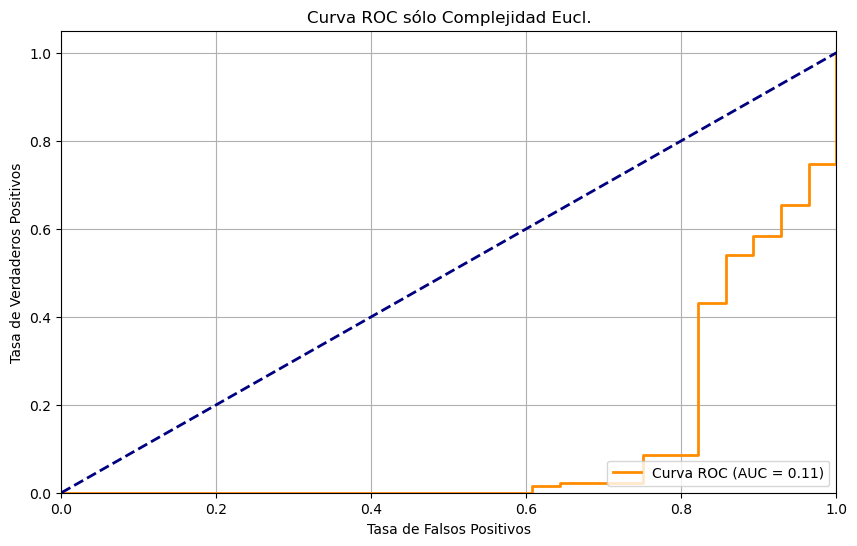

AUC: 0.9172661870503596


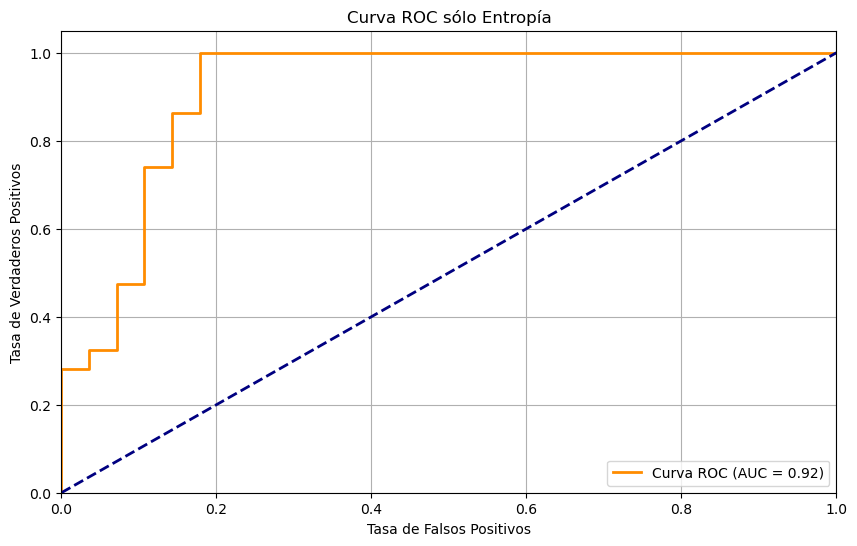

rbio1.5
Estadístico: 0.7243418097496033
Valor p: 7.720175918630914e-15
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.7769733667373657
Valor p: 4.303211244405247e-05
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 947.0
Valor p: 1.889145710368476e-05
Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)
---------------------------------------------------------------------------
AUC: 0.5542137718396711
Confusion Matrix:
TN: 7
FP: 21
FN: 0
TP: 139
Accuracy: 0.874251497005988
Precision: 0.86875
Recall: 1.0
F1-Score: 0.9297658862876255
Tiempo entrenamiento: 0.002502918243408203
Tiempo predicción: 0.0007660388946533203


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


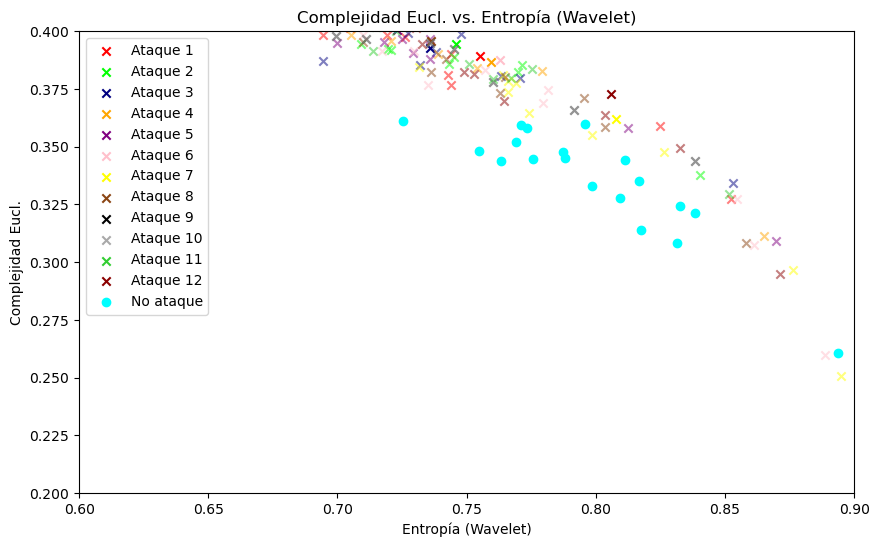

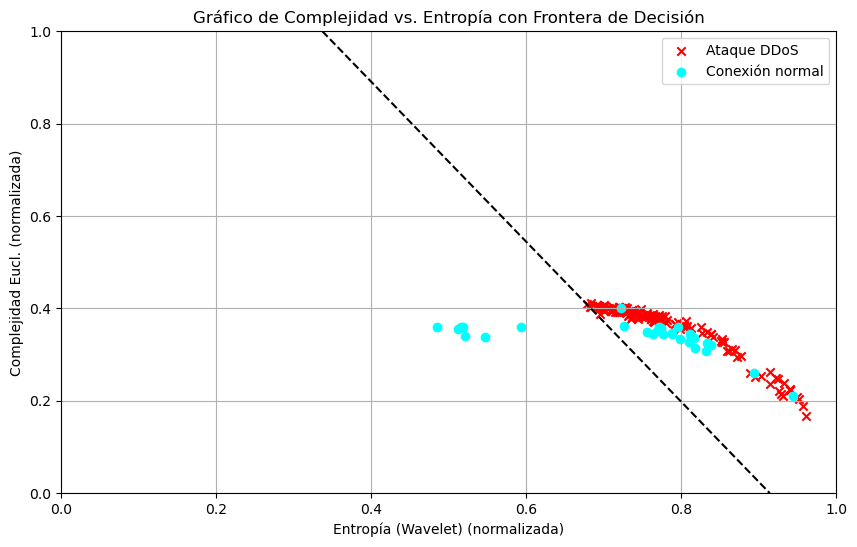

AUC: 0.5542137718396711


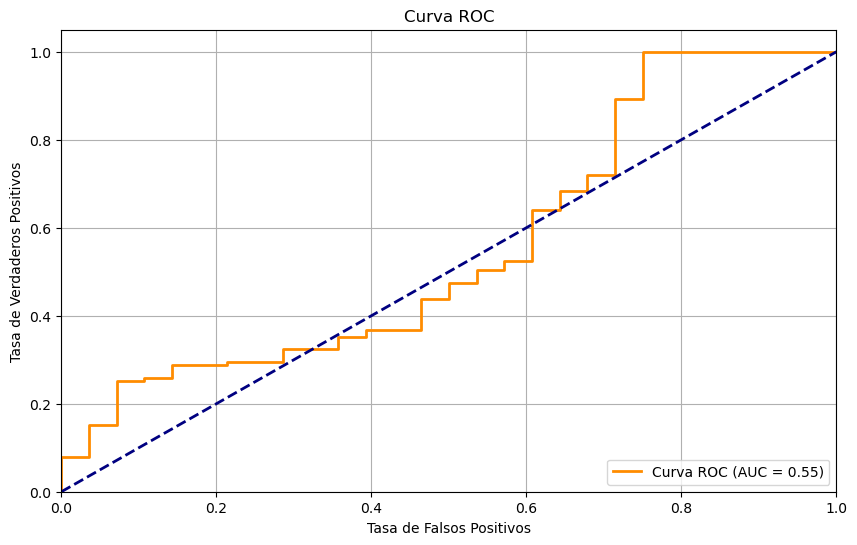

AUC: 0.7566803699897225


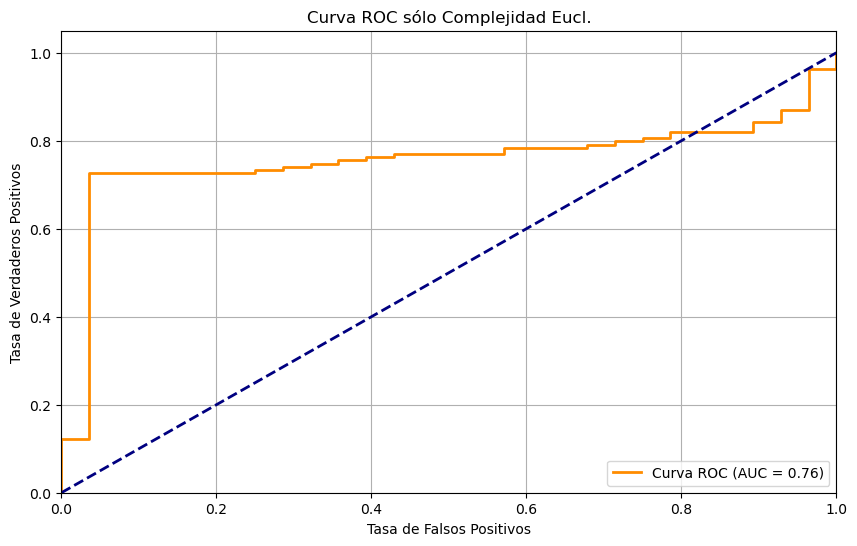

AUC: 0.4961459403905447


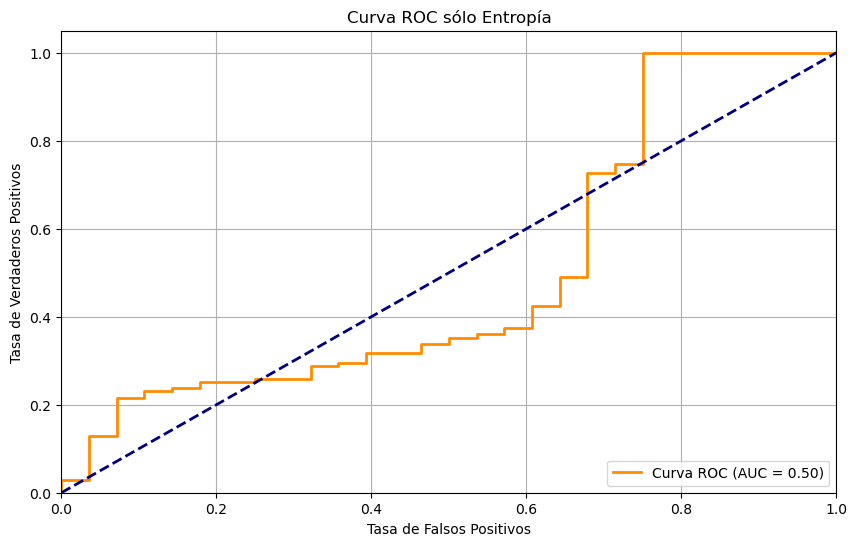

          0         1         2         3
0    family   auc_c-h     auc_c     auc_h
1   bior1.1  0.947585  0.557297  0.946557
2       db1  0.947585  0.557297  0.946557
3      haar  0.947585  0.557297  0.946557
4   rbio1.1  0.947585  0.557297  0.946557
5   bior2.4  0.894142  0.136434  0.895683
6   bior1.3  0.945786  0.656475  0.945015
7   rbio1.3  0.647225  0.727646  0.596095
8   bior1.5  0.937821  0.681655  0.937307
9   bior2.8  0.911614  0.114594  0.917266
10  rbio1.5  0.554214   0.75668  0.496146


In [618]:
eucl_reps = []
eucl_reps.append(["family","auc_c-h","auc_c","auc_h"])
for i in range(10):
    fila = []
    print(ranked_wavelets_wr[i][0])
    fila.append(ranked_wavelets_wr[i][0])
    df = calculate_desequilibrium_and_complexity(file_paths,ranked_wavelets_wr[i][0])
    plot_complexity_entropy(df,'Complejidad Eucl.')
        # Realizar la prueba de Shapiro-Wilk
    stat, p_value = shapiro(df['Complejidad Eucl.'][:sum(reps)])

    # Imprimir los resultados
    print('Estadístico:', stat)
    print('Valor p:', p_value)

    # Evaluar la normalidad
    alpha = 0.05
    if p_value > alpha:
        print('La muestra parece provenir de una distribución normal (no se rechaza la hipótesis nula)')
    else:
        print('La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)')

    # Realizar la prueba de Shapiro-Wilk
    stat, p_value = shapiro(df['Complejidad Eucl.'][sum(reps):])

    print('Estadístico:', stat)
    print('Valor p:', p_value)

    # Evaluar la normalidad
    alpha = 0.05
    if p_value > alpha:
        print('La muestra parece provenir de una distribución normal (no se rechaza la hipótesis nula)')
    else:
        print('La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)')

    stat, p_value = mannwhitneyu(df['Complejidad Eucl.'][sum(reps):], df['Complejidad Eucl.'][:sum(reps)])

    # Imprimir los resultados
    print('Estadístico:', stat)
    print('Valor p:', p_value)

    # Evaluar la significancia
    alpha = 0.05
    if p_value > alpha:
        print('No hay diferencias significativas entre las muestras (no se rechaza la hipótesis nula)')
    else:
        print('Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)')
    print("---------------------------------------------------------------------------")
    df['Clasificación'] = [1]*sum(reps)+[0]*(len(df)-sum(reps))
    # Separar características y etiquetas
    X = df[['Entropía (Wavelet)', 'Complejidad Eucl.']]  
    y = df['Clasificación']

    # Entrenar el modelo de regresión logística
    model = LogisticRegression()
    start_cpu_train = psutil.cpu_percent(interval=None)
    start_train = time.time()
    model.fit(X, y)
    end_train = time.time()
    end_cpu_train = psutil.cpu_percent(interval=None)
    cpu_usage_train = end_cpu_train - start_cpu_train
    training_time = end_train - start_train
    """
    # Generar una malla de puntos para graficar la frontera de decisión
    xx, yy = np.mgrid[0:1:.01, 0:1:.01]
    grid = np.c_[xx.ravel(), yy.ravel()]
    probs = model.predict_proba(grid)[:, 1].reshape(xx.shape)
    """
    # Definir x_min, x_max, y_min, y_max en base a los datos normalizados
    x_min, x_max = X['Entropía (Wavelet)'].min() - 0.1, X['Entropía (Wavelet)'].max() + 0.1
    y_min, y_max = X['Complejidad Eucl.'].min() - 0.1, X['Complejidad Eucl.'].max() + 0.1

    # Asegurarse de que los límites estén dentro del rango 0-1
    x_min, x_max = max(0, x_min), min(1, x_max)
    y_min, y_max = max(0, y_min), min(1, y_max)

    xx, yy = np.meshgrid(np.linspace(0, 1, 100), np.linspace(0, 1, 100))
    y_pred_prob = model.predict_proba(X)[:, 1]
    #print(y_pred_prob)

    # Calcular la curva ROC y el AUC
    fpr, tpr, thresholds = roc_curve(y, y_pred_prob)
    roc_auc = roc_auc_score(y, y_pred_prob)
    print("AUC:",roc_auc)
    fila.append(roc_auc)

    f1_scores = [f1_score(y, (y_pred_prob >= thresh).astype(int)) for thresh in thresholds]

    # Encontrar el umbral que maximiza el F1-Score
    optimal_threshold = thresholds[np.argmax(f1_scores)]
    

    # Predecir con el modelo
    Z = model.predict_proba(np.c_[xx.ravel(), yy.ravel()])[:, 1]
    Z = Z.reshape(xx.shape)
    
    # Predecir etiquetas binarias usando el umbral óptimo
    y_pred_optimal = (y_pred_prob >= optimal_threshold).astype(int)

    # Calcular la matriz de confusión
    tn, fp, fn, tp = confusion_matrix(y, y_pred_optimal).ravel()

    print("Confusion Matrix:")
    print("TN:", tn)
    print("FP:", fp)
    print("FN:", fn)
    print("TP:", tp)

    # Opcional: Calcular otras métricas de evaluación
    accuracy = (tp + tn) / (tp + tn + fp + fn)
    precision = tp / (tp + fp)
    recall = tp / (tp + fn)
    f1 = 2 * (precision * recall) / (precision + recall)

    print("Accuracy:", accuracy)
    print("Precision:", precision)
    print("Recall:", recall)
    print("F1-Score:", f1)
    print("Tiempo entrenamiento:",training_time)
    print("Tiempo predicción:",prediction_time)
    #print("% uso CPU entrenamiento:",cpu_usage_train)
    #print("% uso CPU predicción:",cpu_usage)
    
    

    # Graficar los puntos y la frontera de decisión
    
    
    # Graficar los puntos y la frontera de decisión
    plt.figure(figsize=(10, 6))
    plt.scatter(X[y == 1]['Entropía (Wavelet)'], X[y == 1]['Complejidad Eucl.'], marker='x', label='Ataque DDoS', c="Red")
    plt.scatter(X[y == 0]['Entropía (Wavelet)'], X[y == 0]['Complejidad Eucl.'], marker='o', label='Conexión normal', c="Cyan")

    # Contorno de la frontera de decisión
    #plt.contour(xx, yy, probs, levels=[0.5], cmap="Greys", vmin=0, vmax=1)
    #plt.contourf(xx, yy, Z, alpha=0.8, cmap='coolwarm')
    plt.contour(xx, yy, Z, levels=[optimal_threshold], colors='black', linestyles='--')
    plt.xlabel('Entropía (Wavelet) (normalizada)')
    plt.ylabel('Complejidad Eucl. (normalizada)')
    plt.title('Gráfico de Complejidad vs. Entropía con Frontera de Decisión')
    plt.legend()
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.0])
    plt.grid(True)
    plt.show()
    


    # Predecir las probabilidades de la clase positiva
    start_cpu = psutil.cpu_percent(interval=None)
    start_pred = time.time()
    y_pred_prob = model.predict_proba(X)[:, 1]
    end_pred = time.time()
    end_cpu = psutil.cpu_percent(interval=None)
    cpu_usage = end_cpu - start_cpu
    #print(y_pred_prob)
    prediction_time = end_pred - start_pred

    # Calcular la curva ROC y el AUC
    fpr, tpr, thresholds = roc_curve(y, y_pred_prob)

    roc_auc = roc_auc_score(y, y_pred_prob)
    print("AUC:",roc_auc)
    


    # Graficar la curva ROC
    plt.figure(figsize=(10, 6))
    plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'Curva ROC (AUC = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('Tasa de Falsos Positivos')
    plt.ylabel('Tasa de Verdaderos Positivos')
    plt.title('Curva ROC')
    plt.legend(loc="lower right")
    plt.grid(True)
    plt.show()
    
    # Calcular la curva ROC y el AUC para sólo complejidad
    fpr, tpr, thresholds = roc_curve(y, X["Complejidad Eucl."])
    roc_auc = roc_auc_score(y, X["Complejidad Eucl."])
    print("AUC:",roc_auc)
    fila.append(roc_auc)


    # Graficar la curva ROC
    plt.figure(figsize=(10, 6))
    plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'Curva ROC (AUC = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('Tasa de Falsos Positivos')
    plt.ylabel('Tasa de Verdaderos Positivos')
    plt.title('Curva ROC sólo Complejidad Eucl.')
    plt.legend(loc="lower right")
    plt.grid(True)
    plt.show()
    
    # Calcular la curva ROC y el AUC para sólo complejidad
    fpr, tpr, thresholds = roc_curve(y, X['Entropía (Wavelet)'])
    roc_auc = roc_auc_score(y, X['Entropía (Wavelet)'])
    print("AUC:",roc_auc)
    fila.append(roc_auc)


    # Graficar la curva ROC
    plt.figure(figsize=(10, 6))
    plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'Curva ROC (AUC = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('Tasa de Falsos Positivos')
    plt.ylabel('Tasa de Verdaderos Positivos')
    plt.title('Curva ROC sólo Entropía')
    plt.legend(loc="lower right")
    plt.grid(True)
    plt.show()
    eucl_reps.append(fila)
    
print(pd.DataFrame(eucl_reps))

coif2
Estadístico: 0.7495081424713135
Valor p: 4.081717941612807e-14
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.8216912746429443
Valor p: 0.00026399854687042534
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 764.0
Valor p: 4.1578948349719613e-07
Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)
---------------------------------------------------------------------------
AUC: 0.7037512846865366
Confusion Matrix:
TN: 7
FP: 21
FN: 0
TP: 139
Accuracy: 0.874251497005988
Precision: 0.86875
Recall: 1.0
F1-Score: 0.9297658862876255


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


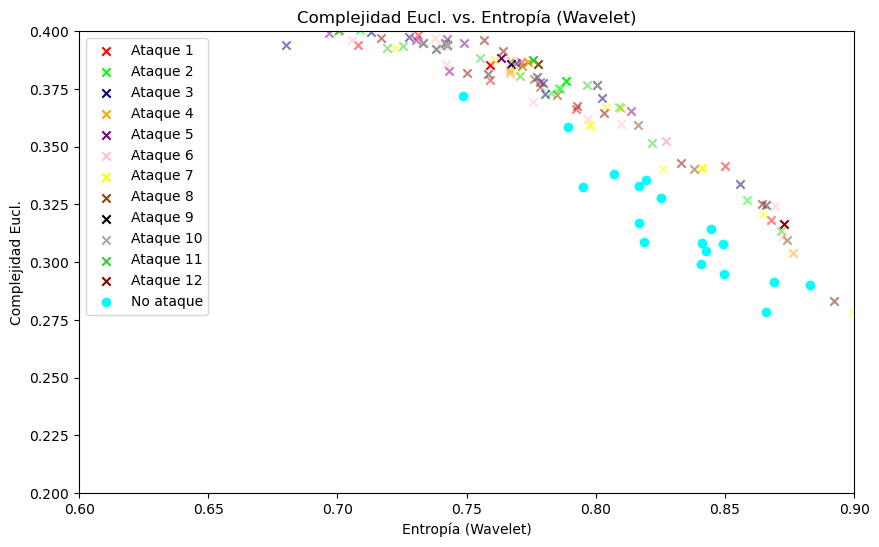

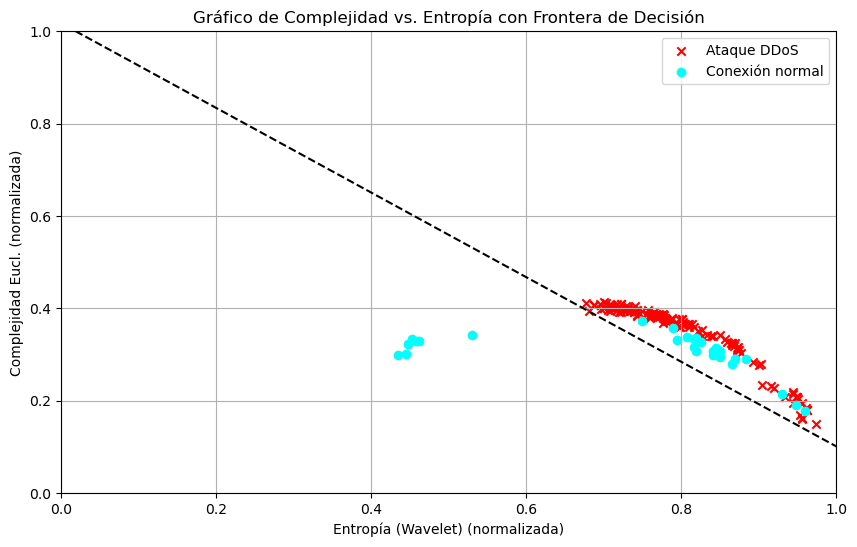

AUC: 0.7037512846865366


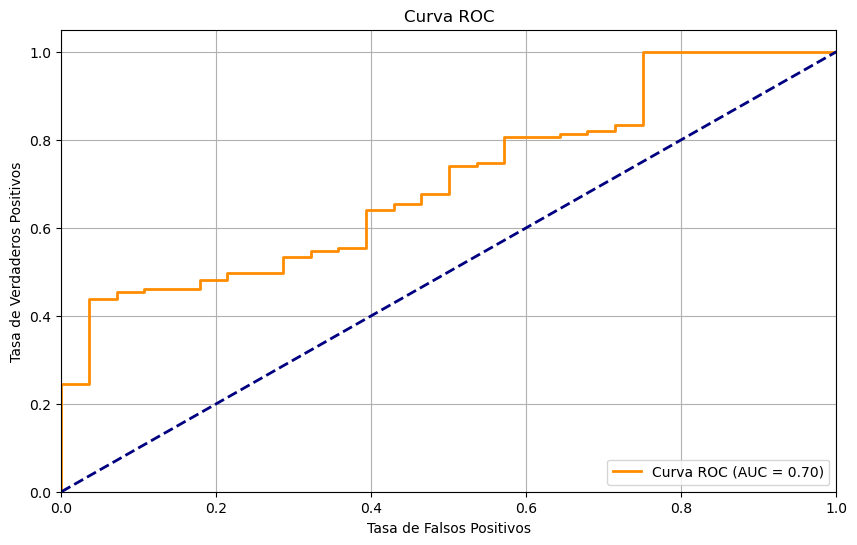

AUC: 0.8036998972250771


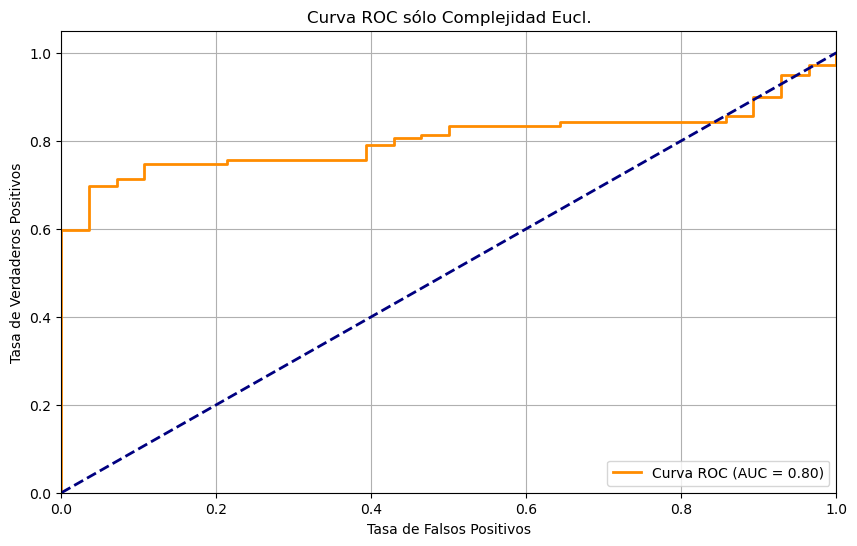

AUC: 0.4540082219938335


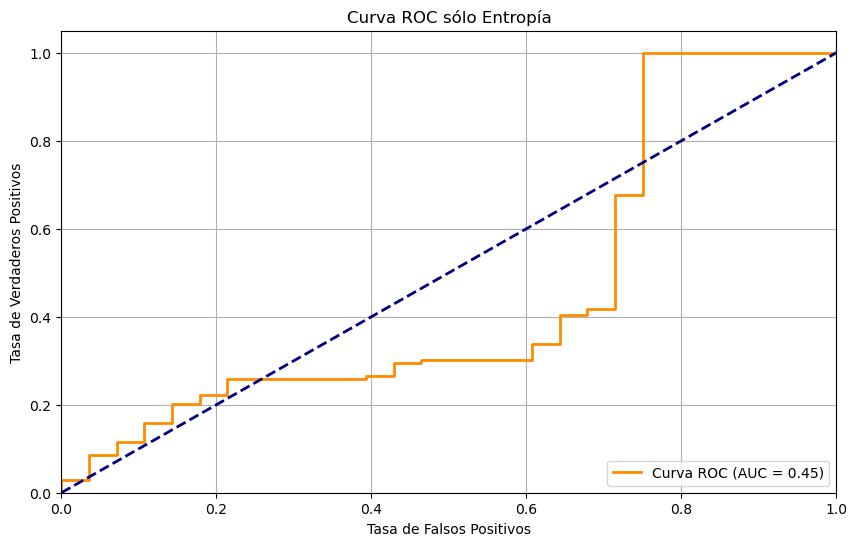

        0         1       2         3
0  family   auc_c-h   auc_c     auc_h
1   coif2  0.703751  0.8037  0.454008


In [603]:
eucl_reps = []
eucl_reps.append(["family","auc_c-h","auc_c","auc_h"])

fila = []
print("coif2")
fila.append("coif2")
df = calculate_desequilibrium_and_complexity(file_paths,"coif2")
plot_complexity_entropy(df,'Complejidad Eucl.')
    # Realizar la prueba de Shapiro-Wilk
stat, p_value = shapiro(df['Complejidad Eucl.'][:sum(reps)])

# Imprimir los resultados
print('Estadístico:', stat)
print('Valor p:', p_value)

# Evaluar la normalidad
alpha = 0.05
if p_value > alpha:
    print('La muestra parece provenir de una distribución normal (no se rechaza la hipótesis nula)')
else:
    print('La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)')

# Realizar la prueba de Shapiro-Wilk
stat, p_value = shapiro(df['Complejidad Eucl.'][sum(reps):])

print('Estadístico:', stat)
print('Valor p:', p_value)

# Evaluar la normalidad
alpha = 0.05
if p_value > alpha:
    print('La muestra parece provenir de una distribución normal (no se rechaza la hipótesis nula)')
else:
    print('La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)')

stat, p_value = mannwhitneyu(df['Complejidad Eucl.'][sum(reps):], df['Complejidad Eucl.'][:sum(reps)])

# Imprimir los resultados
print('Estadístico:', stat)
print('Valor p:', p_value)

# Evaluar la significancia
alpha = 0.05
if p_value > alpha:
    print('No hay diferencias significativas entre las muestras (no se rechaza la hipótesis nula)')
else:
    print('Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)')
print("---------------------------------------------------------------------------")
df['Clasificación'] = [1]*sum(reps)+[0]*(len(df)-sum(reps))
# Separar características y etiquetas
X = df[['Entropía (Wavelet)', 'Complejidad Eucl.']]  
y = df['Clasificación']

# Entrenar el modelo de regresión logística
model = LogisticRegression()
model.fit(X, y)
"""
# Generar una malla de puntos para graficar la frontera de decisión
xx, yy = np.mgrid[0:1:.01, 0:1:.01]
grid = np.c_[xx.ravel(), yy.ravel()]
probs = model.predict_proba(grid)[:, 1].reshape(xx.shape)
"""
# Definir x_min, x_max, y_min, y_max en base a los datos normalizados
x_min, x_max = X['Entropía (Wavelet)'].min() - 0.1, X['Entropía (Wavelet)'].max() + 0.1
y_min, y_max = X['Complejidad Eucl.'].min() - 0.1, X['Complejidad Eucl.'].max() + 0.1

# Asegurarse de que los límites estén dentro del rango 0-1
x_min, x_max = max(0, x_min), min(1, x_max)
y_min, y_max = max(0, y_min), min(1, y_max)

xx, yy = np.meshgrid(np.linspace(0, 1, 100), np.linspace(0, 1, 100))
y_pred_prob = model.predict_proba(X)[:, 1]
#print(y_pred_prob)

# Calcular la curva ROC y el AUC
fpr, tpr, thresholds = roc_curve(y, y_pred_prob)
roc_auc = roc_auc_score(y, y_pred_prob)
print("AUC:",roc_auc)
fila.append(roc_auc)

f1_scores = [f1_score(y, (y_pred_prob >= thresh).astype(int)) for thresh in thresholds]

# Encontrar el umbral que maximiza el F1-Score
optimal_threshold = thresholds[np.argmax(f1_scores)]


# Predecir con el modelo
Z = model.predict_proba(np.c_[xx.ravel(), yy.ravel()])[:, 1]
Z = Z.reshape(xx.shape)

# Predecir etiquetas binarias usando el umbral óptimo
y_pred_optimal = (y_pred_prob >= optimal_threshold).astype(int)

# Calcular la matriz de confusión
tn, fp, fn, tp = confusion_matrix(y, y_pred_optimal).ravel()

print("Confusion Matrix:")
print("TN:", tn)
print("FP:", fp)
print("FN:", fn)
print("TP:", tp)

# Opcional: Calcular otras métricas de evaluación
accuracy = (tp + tn) / (tp + tn + fp + fn)
precision = tp / (tp + fp)
recall = tp / (tp + fn)
f1 = 2 * (precision * recall) / (precision + recall)

print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1-Score:", f1)


# Graficar los puntos y la frontera de decisión


# Graficar los puntos y la frontera de decisión
plt.figure(figsize=(10, 6))
plt.scatter(X[y == 1]['Entropía (Wavelet)'], X[y == 1]['Complejidad Eucl.'], marker='x', label='Ataque DDoS', c="Red")
plt.scatter(X[y == 0]['Entropía (Wavelet)'], X[y == 0]['Complejidad Eucl.'], marker='o', label='Conexión normal', c="Cyan")

# Contorno de la frontera de decisión
#plt.contour(xx, yy, probs, levels=[0.5], cmap="Greys", vmin=0, vmax=1)
#plt.contourf(xx, yy, Z, alpha=0.8, cmap='coolwarm')
plt.contour(xx, yy, Z, levels=[optimal_threshold], colors='black', linestyles='--')
plt.xlabel('Entropía (Wavelet) (normalizada)')
plt.ylabel('Complejidad Eucl. (normalizada)')
plt.title('Gráfico de Complejidad vs. Entropía con Frontera de Decisión')
plt.legend()
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.grid(True)
plt.show()

# Predecir las probabilidades de la clase positiva
y_pred_prob = model.predict_proba(X)[:, 1]
#print(y_pred_prob)

# Calcular la curva ROC y el AUC
fpr, tpr, thresholds = roc_curve(y, y_pred_prob)

roc_auc = roc_auc_score(y, y_pred_prob)
print("AUC:",roc_auc)



# Graficar la curva ROC
plt.figure(figsize=(10, 6))
plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'Curva ROC (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('Tasa de Falsos Positivos')
plt.ylabel('Tasa de Verdaderos Positivos')
plt.title('Curva ROC')
plt.legend(loc="lower right")
plt.grid(True)
plt.show()

# Calcular la curva ROC y el AUC para sólo complejidad
fpr, tpr, thresholds = roc_curve(y, X["Complejidad Eucl."])
roc_auc = roc_auc_score(y, X["Complejidad Eucl."])
print("AUC:",roc_auc)
fila.append(roc_auc)


# Graficar la curva ROC
plt.figure(figsize=(10, 6))
plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'Curva ROC (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('Tasa de Falsos Positivos')
plt.ylabel('Tasa de Verdaderos Positivos')
plt.title('Curva ROC sólo Complejidad Eucl.')
plt.legend(loc="lower right")
plt.grid(True)
plt.show()

# Calcular la curva ROC y el AUC para sólo complejidad
fpr, tpr, thresholds = roc_curve(y, X['Entropía (Wavelet)'])
roc_auc = roc_auc_score(y, X['Entropía (Wavelet)'])
print("AUC:",roc_auc)
fila.append(roc_auc)


# Graficar la curva ROC
plt.figure(figsize=(10, 6))
plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'Curva ROC (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('Tasa de Falsos Positivos')
plt.ylabel('Tasa de Verdaderos Positivos')
plt.title('Curva ROC sólo Entropía')
plt.legend(loc="lower right")
plt.grid(True)
plt.show()
eucl_reps.append(fila)
    
print(pd.DataFrame(eucl_reps))

Distribuciones de probabilidades para la mejor combinación

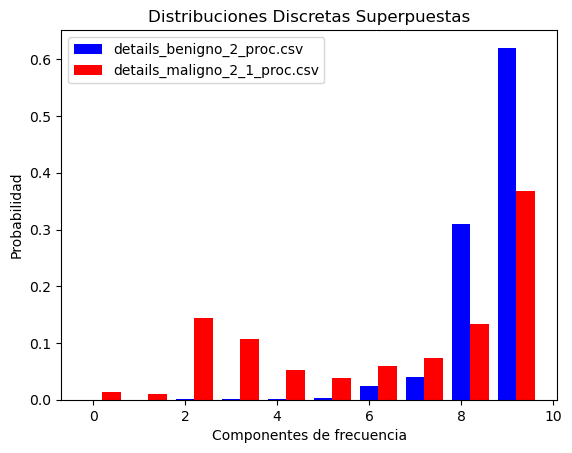

[['details_maligno_1_1_proc.csv', array([0.00522483, 0.01545747, 0.14178866, 0.09507985, 0.05671124,
       0.04279596, 0.05407805, 0.07510137, 0.13770695, 0.37605563])], ['details_maligno_1_2_proc.csv', array([0.04862443, 0.03774713, 0.04217743, 0.10786288, 0.08328026,
       0.03108192, 0.06235303, 0.08582558, 0.14525785, 0.35578949])], ['details_maligno_1_3_proc.csv', array([6.47158714e-07, 5.11934901e-02, 5.86286966e-02, 1.18481817e-02,
       4.30386431e-02, 4.78483267e-02, 4.48972830e-02, 8.10967528e-02,
       1.73707753e-01, 4.87740225e-01])], ['details_maligno_1_4_proc.csv', array([0.01848509, 0.02354781, 0.02166814, 0.05215989, 0.05647474,
       0.05817976, 0.05153205, 0.0906058 , 0.14930261, 0.4780441 ])], ['details_maligno_1_5_proc.csv', array([0.0022475 , 0.07282295, 0.0359762 , 0.03100209, 0.06253926,
       0.03957882, 0.03991113, 0.0578334 , 0.1758658 , 0.48222285])], ['details_maligno_1_6_proc.csv', array([0.01894566, 0.03978509, 0.05397113, 0.005587  , 0.04994679,
  

In [644]:
j = 0 
todo = []
for i in file_paths:
    sujeto = pd.read_csv(i)
    archivo = i.split("/")
    archivo = archivo[len(archivo)-1]
    #print(archivo)
    usar = sujeto["Packet Count"]
    if len(usar)>1024:
        usar = truncate_to_1024(sujeto["Packet Count"])
    #print(len(usar))
    a,b,c,d = calculate_wavelet_entropy(usar,"bior1.1")
    #print(d)
    j=j+1
    todo.append([archivo,d])
#print(todo[139])


indices = np.arange(len(todo[0][1]))
ancho = 0.4

# Graficar la primera distribución
plt.bar(indices, todo[140][1] , width=ancho, color='blue', label=todo[140][0])

# Graficar la segunda distribución, desplazada ligeramente
plt.bar(indices + ancho, todo[12][1], width=ancho, color='red', label=todo[12][0])

# Añadir etiquetas y título
plt.xlabel('Componentes de frecuencia')
plt.ylabel('Probabilidad')
plt.title('Distribuciones Discretas Superpuestas')

# Añadir etiquetas a los ejes x
#plt.xticks(indices + ancho / 2, resultados)

# Mostrar la leyenda
plt.legend()

# Mostrar el gráfico
plt.show()
    
print(todo)
    

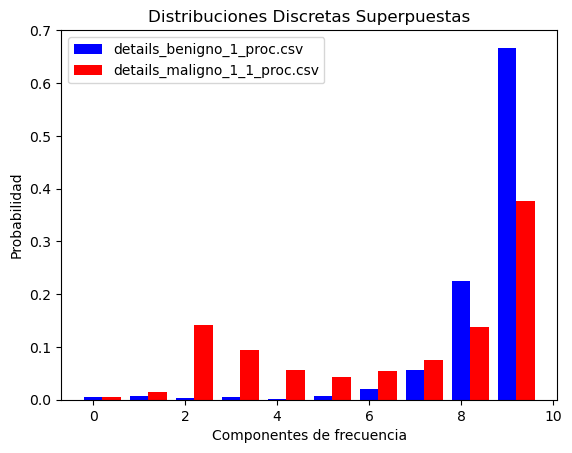

In [567]:
# Graficar la primera distribución
plt.bar(indices, todo[139][1] , width=ancho, color='blue', label=todo[139][0])

# Graficar la segunda distribución, desplazada ligeramente
plt.bar(indices + ancho, todo[0][1], width=ancho, color='red', label=todo[0][0])

# Añadir etiquetas y título
plt.xlabel('Componentes de frecuencia')
plt.ylabel('Probabilidad')
plt.title('Distribuciones Discretas Superpuestas')

# Añadir etiquetas a los ejes x
#plt.xticks(indices + ancho / 2, resultados)

# Mostrar la leyenda
plt.legend()

# Mostrar el gráfico
plt.show()

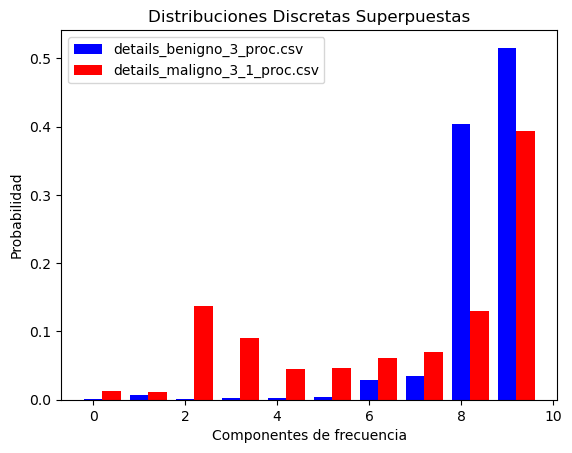

In [568]:
# Graficar la primera distribución
plt.bar(indices, todo[141][1] , width=ancho, color='blue', label=todo[141][0])

# Graficar la segunda distribución, desplazada ligeramente
plt.bar(indices + ancho, todo[24][1], width=ancho, color='red', label=todo[24][0])

# Añadir etiquetas y título
plt.xlabel('Componentes de frecuencia')
plt.ylabel('Probabilidad')
plt.title('Distribuciones Discretas Superpuestas')

# Añadir etiquetas a los ejes x
#plt.xticks(indices + ancho / 2, resultados)

# Mostrar la leyenda
plt.legend()

# Mostrar el gráfico
plt.show()

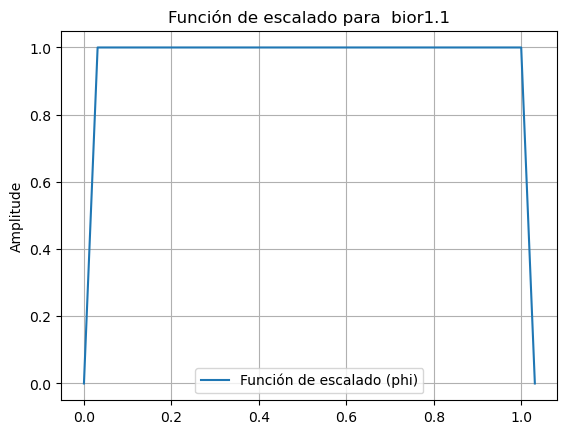

In [583]:


# Crear la wavelet bior1.1
wavelet = pywt.Wavelet('bior1.1')

# Obtener los coeficientes de la función de escalamiento
functions = wavelet.wavefun(level=5)
phi, psi, x = functions[0], functions[1], functions[-1]

# Graficar la función de escalamiento
plt.plot(x, phi, label='Función de escalado (phi)')
plt.title('Función de escalado para  bior1.1')
#plt.xlabel()
plt.ylabel('Amplitude')
plt.grid(True)
plt.legend()
plt.show()

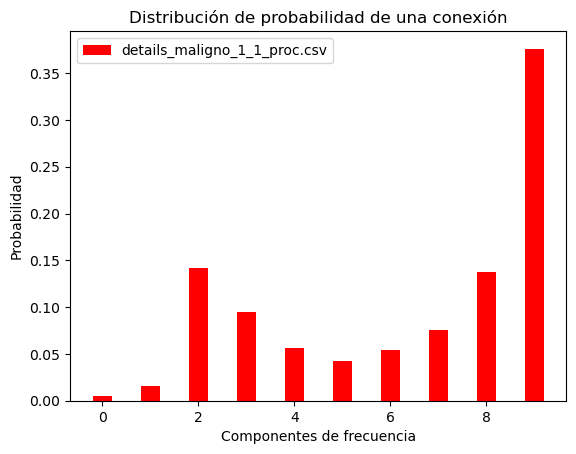

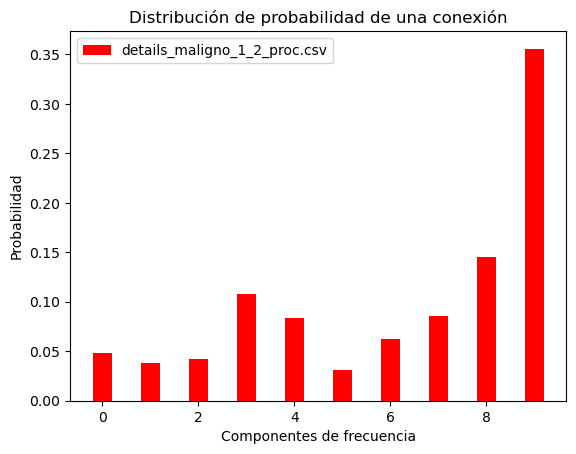

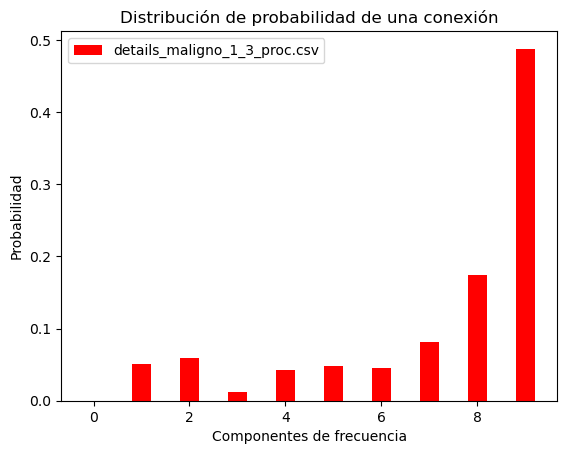

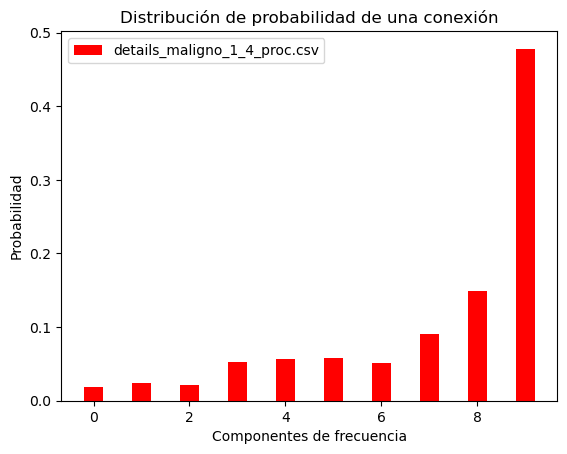

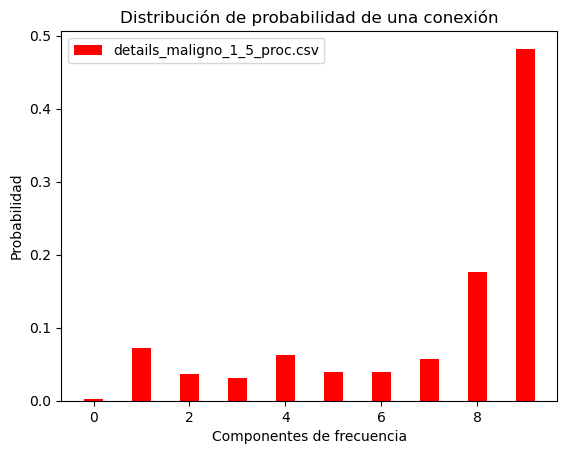

...

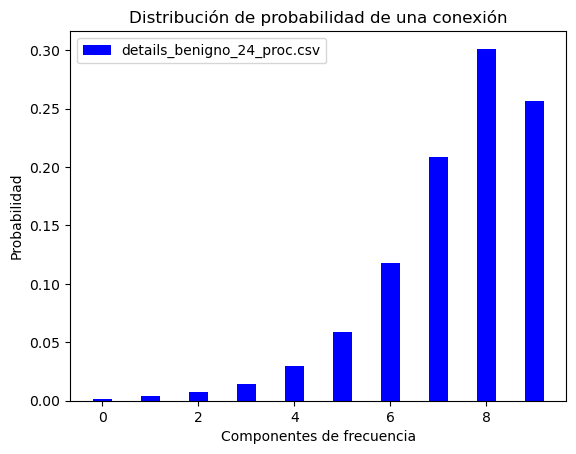

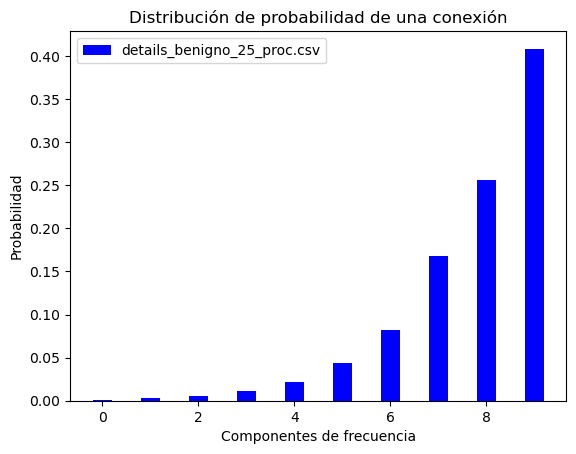

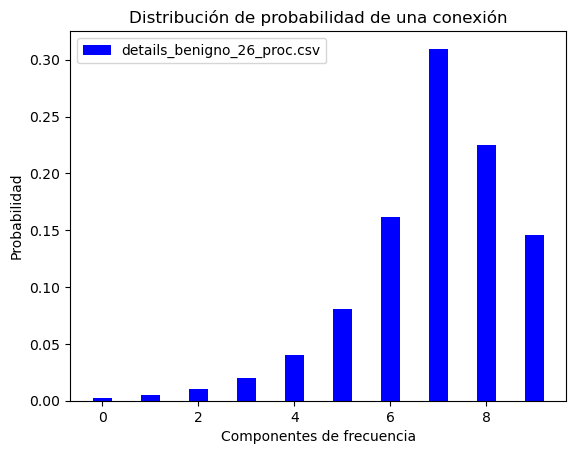

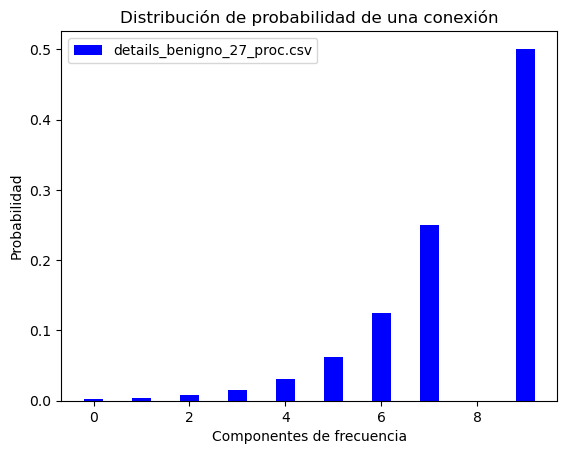

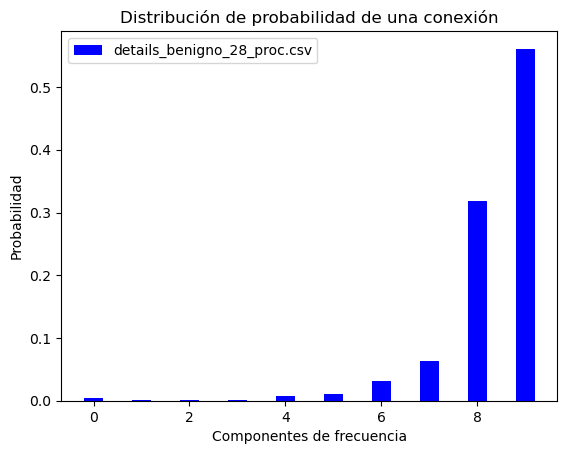

In [643]:
for i in todo[:139]:
    indices = np.arange(len(todo[0][1]))
    ancho = 0.4

    # Graficar la primera distribución
    plt.bar(indices, i[1] , width=ancho, color='red', label=i[0])


    # Añadir etiquetas y título
    plt.xlabel('Componentes de frecuencia')
    plt.ylabel('Probabilidad')
    plt.title('Distribución de probabilidad de una conexión')

    # Añadir etiquetas a los ejes x
    #plt.xticks(indices + ancho / 2, resultados)

    # Mostrar la leyenda
    plt.legend()

    # Mostrar el gráfico
    plt.show()

for i in todo[139:]:
    indices = np.arange(len(todo[0][1]))
    ancho = 0.4

    # Graficar la primera distribución
    plt.bar(indices, i[1] , width=ancho, color='blue', label=i[0])


    # Añadir etiquetas y título
    plt.xlabel('Componentes de frecuencia')
    plt.ylabel('Probabilidad')
    plt.title('Distribución de probabilidad de una conexión')

    # Añadir etiquetas a los ejes x
    #plt.xticks(indices + ancho / 2, resultados)

    # Mostrar la leyenda
    plt.legend()

    # Mostrar el gráfico
    plt.show()

In [629]:
df_bior11 = calculate_desequilibrium_and_complexity(file_paths, "bior1.1")
sujetos = []
k = 1
for i in reps:
    for j in range(1,i+1):
        sujetos.append(f"details_maligno_{k}_{j}")
    k = k + 1
for i in range(1,29):
    sujetos.append(f"details_benigno_{i}")
df_bior11["Conexión"] = sujetos
print(df_bior11)
df_bior11.to_csv('bior11_detalle.csv', index=False)

     Entropía (Wavelet)  Desequilibrio (Eucl.)  Desequilibrio (Wootters)  \
0              0.817873               0.357294                  0.377375   
1              0.864684               0.322115                  0.306237   
2              0.716215               0.480480                  0.477607   
3              0.753092               0.461269                  0.413567   
4              0.731234               0.473295                  0.445076   
..                  ...                    ...                       ...   
162            0.733860               0.382721                  0.493810   
163            0.669165               0.458043                  0.542470   
164            0.769817               0.355313                  0.456511   
165            0.595909               0.538216                  0.601953   
166            0.478716               0.630014                  0.677442   

     Complejidad Eucl.  Complejidad Wootters             Conexión  
0             0.292

In [591]:
print("ATAQUES")
print(df_bior11[:139].describe())
print("NORMALES")
print(df_bior11[139:].describe())

ATAQUES
       Entropía (Wavelet)  Desequilibrio (Eucl.)  Desequilibrio (Wootters)  \
count          139.000000             139.000000                139.000000   
mean             0.798888               0.386457                  0.382670   
std              0.059350               0.076325                  0.059961   
min              0.692746               0.249404                  0.266879   
25%              0.746241               0.317703                  0.329289   
50%              0.793228               0.404540                  0.380581   
75%              0.857432               0.451218                  0.434621   
max              0.898925               0.519522                  0.505186   

       Complejidad Eucl.  Complejidad Wootters  
count         139.000000            139.000000  
mean            0.304298              0.302225  
std             0.039766              0.026518  
min             0.220609              0.239904  
25%             0.273046              0.2797

## Sin repeticiones Desequilibrado Wootters

In [512]:
print(reps)
inicio_ataques = [0]
for i in reps:
    inicio_ataques.append(inicio_ataques[len(inicio_ataques)-1]+i)
inicio_ataques.pop()
print(inicio_ataques)

[12, 12, 12, 12, 12, 12, 12, 12, 11, 11, 10, 11]
[0, 12, 24, 36, 48, 60, 72, 84, 96, 107, 118, 128]


bior1.1
Estadístico: 0.7865631580352783
Valor p: 0.006617142353206873
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.792425811290741
Valor p: 7.872208516346291e-05
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 275.0
Valor p: 0.0016699999979822716
Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)
---------------------------------------------------------------------------
Confusion Matrix:
TN: 27
FP: 1
FN: 0
TP: 12
Accuracy: 0.975
Precision: 0.9230769230769231
Recall: 1.0
F1-Score: 0.9600000000000001
Tiempo entrenamiento: 0.0018417835235595703
Tiempo predicción: 0.0004982948303222656


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


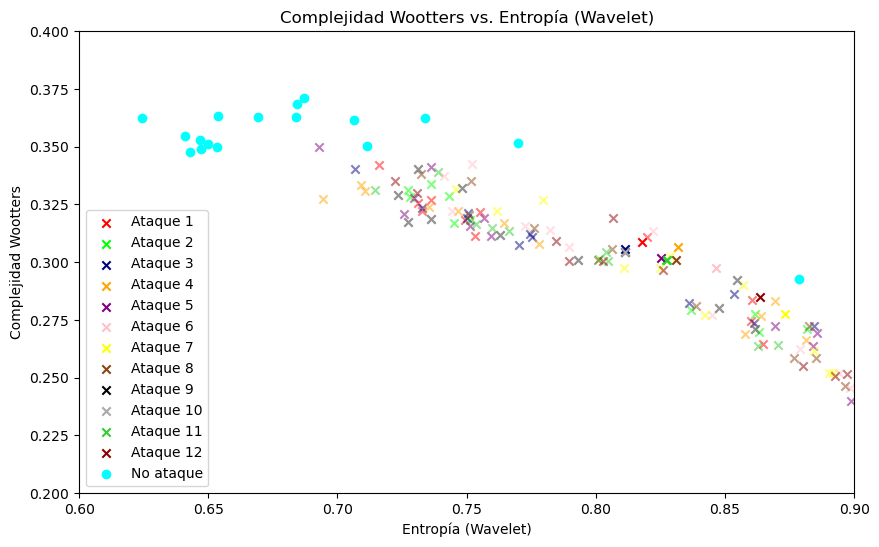

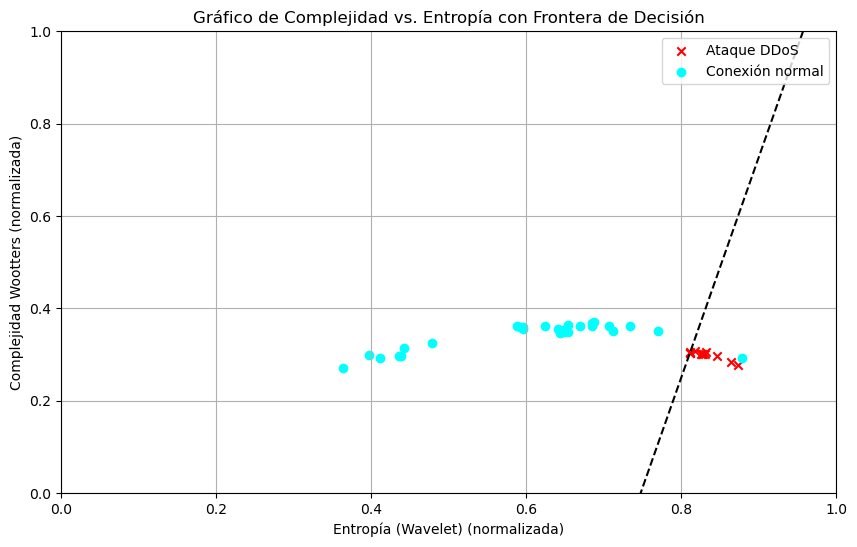

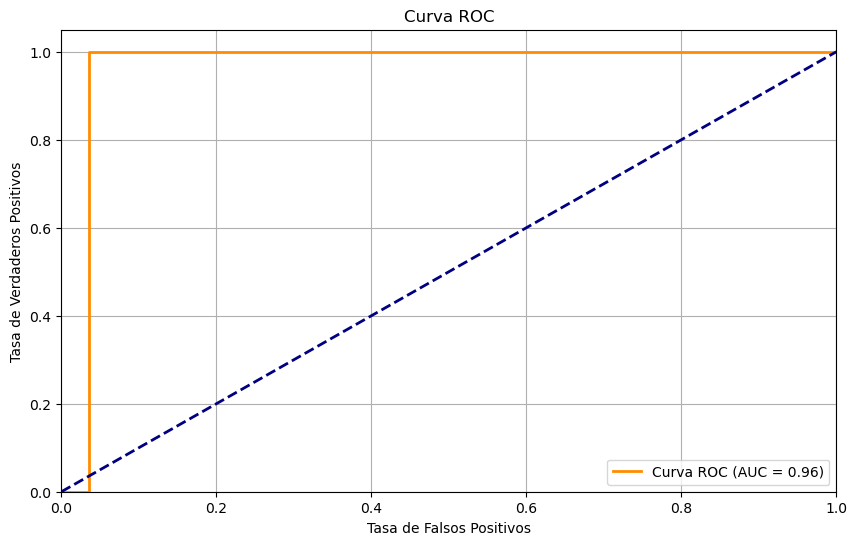

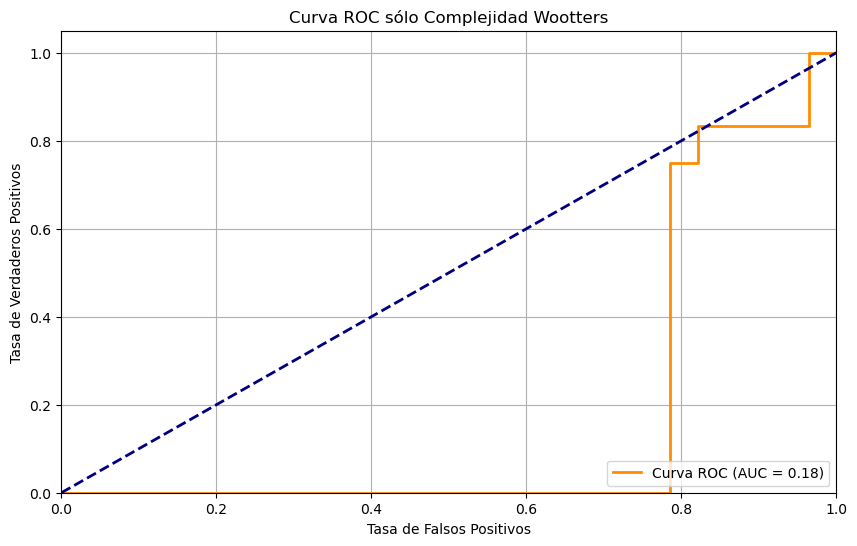

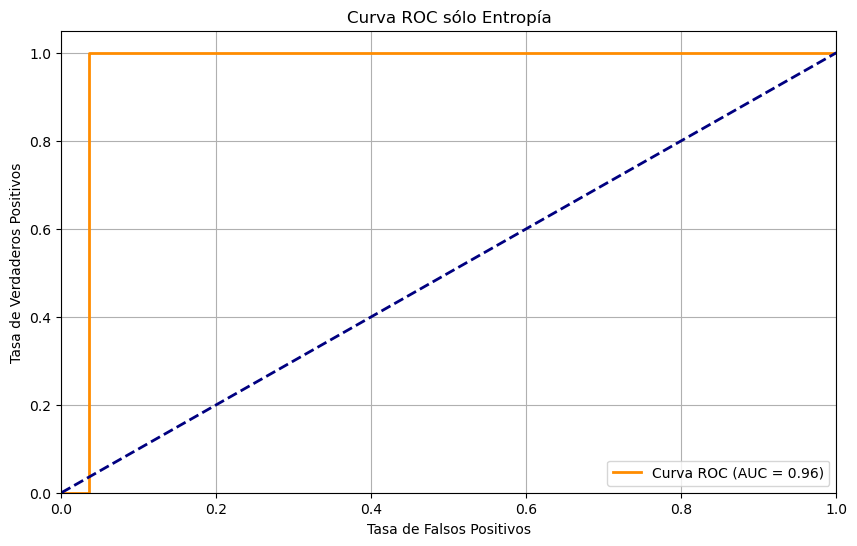

db1
Estadístico: 0.7865631580352783
Valor p: 0.006617142353206873
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.792425811290741
Valor p: 7.872208516346291e-05
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 275.0
Valor p: 0.0016699999979822716
Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)
---------------------------------------------------------------------------
Confusion Matrix:
TN: 27
FP: 1
FN: 0
TP: 12
Accuracy: 0.975
Precision: 0.9230769230769231
Recall: 1.0
F1-Score: 0.9600000000000001
Tiempo entrenamiento: 0.0028557777404785156
Tiempo predicción: 0.0005929470062255859


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


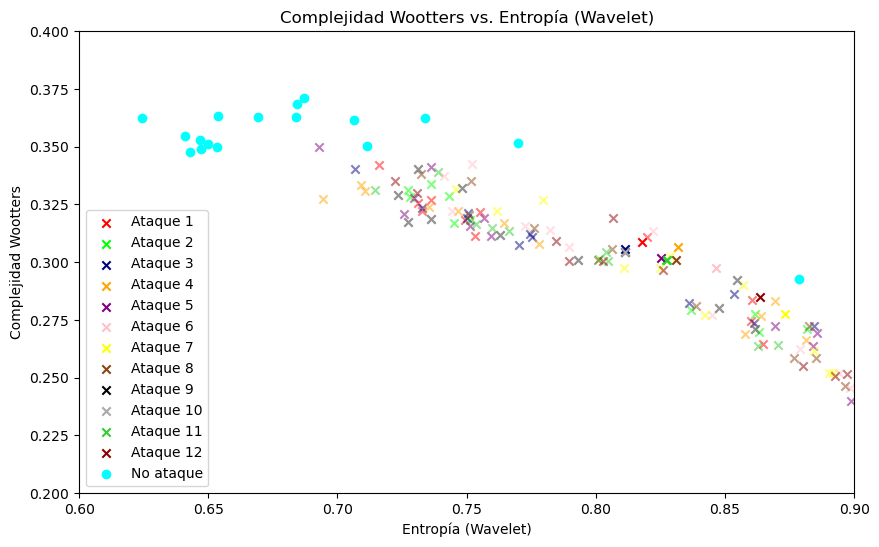

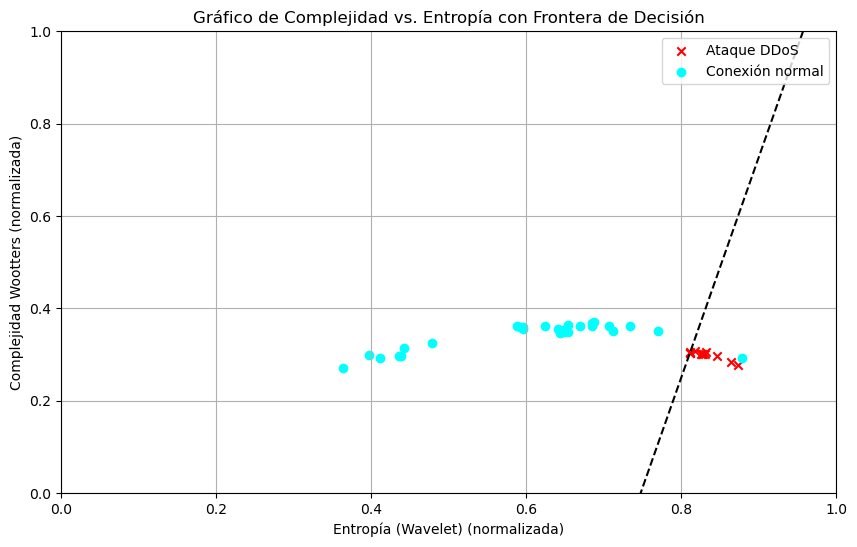

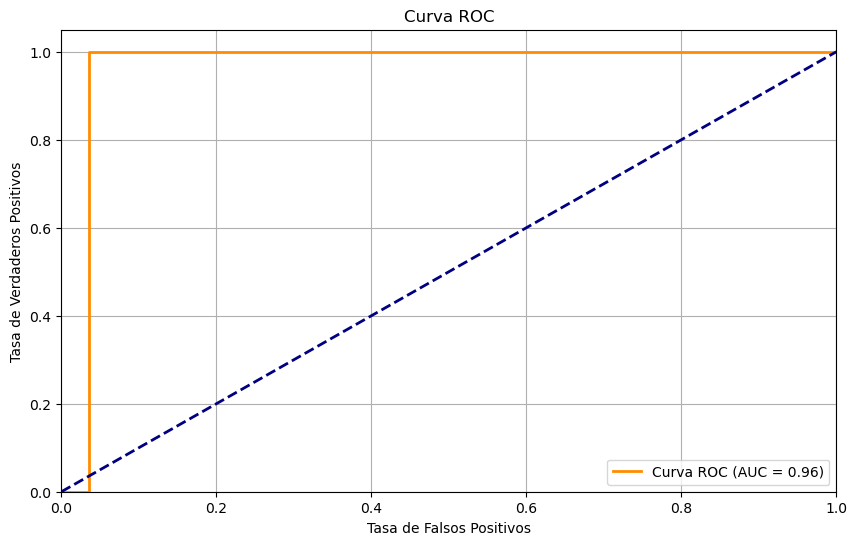

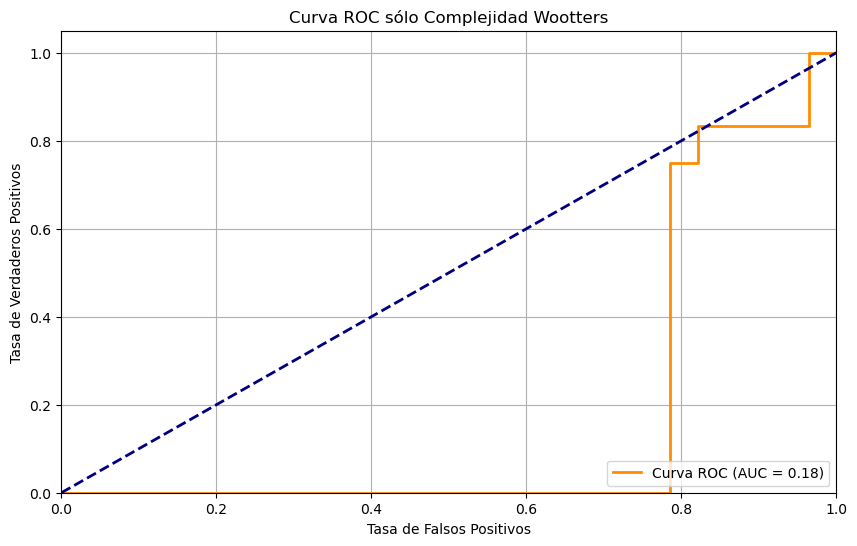

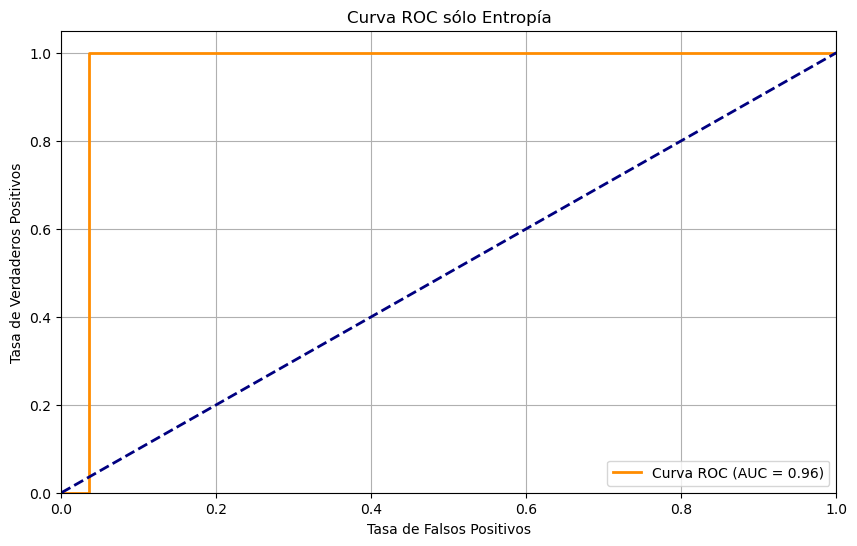

haar
Estadístico: 0.7865631580352783
Valor p: 0.006617142353206873
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.792425811290741
Valor p: 7.872208516346291e-05
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 275.0
Valor p: 0.0016699999979822716
Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)
---------------------------------------------------------------------------
Confusion Matrix:
TN: 27
FP: 1
FN: 0
TP: 12
Accuracy: 0.975
Precision: 0.9230769230769231
Recall: 1.0
F1-Score: 0.9600000000000001
Tiempo entrenamiento: 0.002801179885864258
Tiempo predicción: 0.0005235671997070312


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


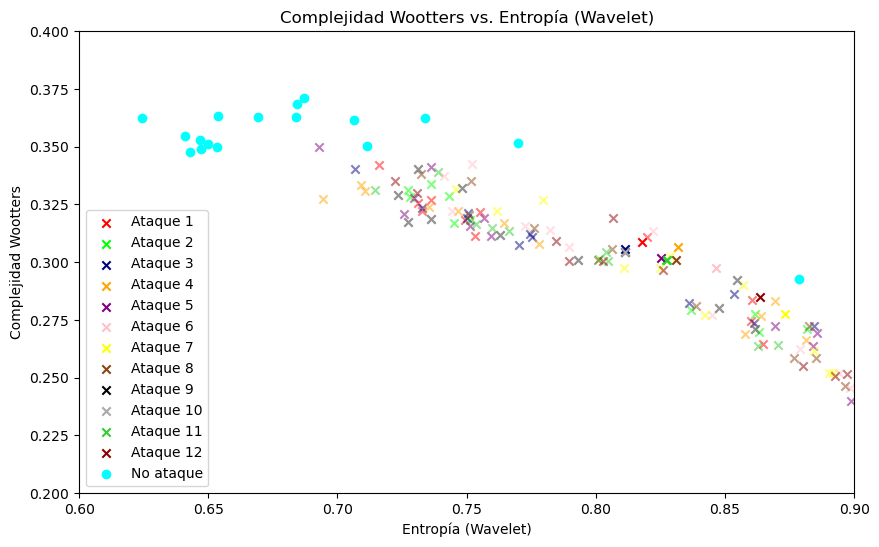

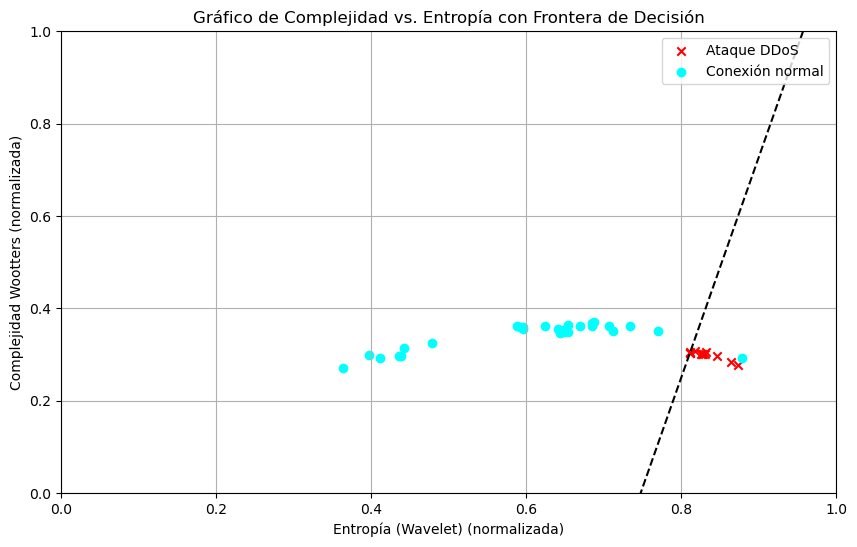

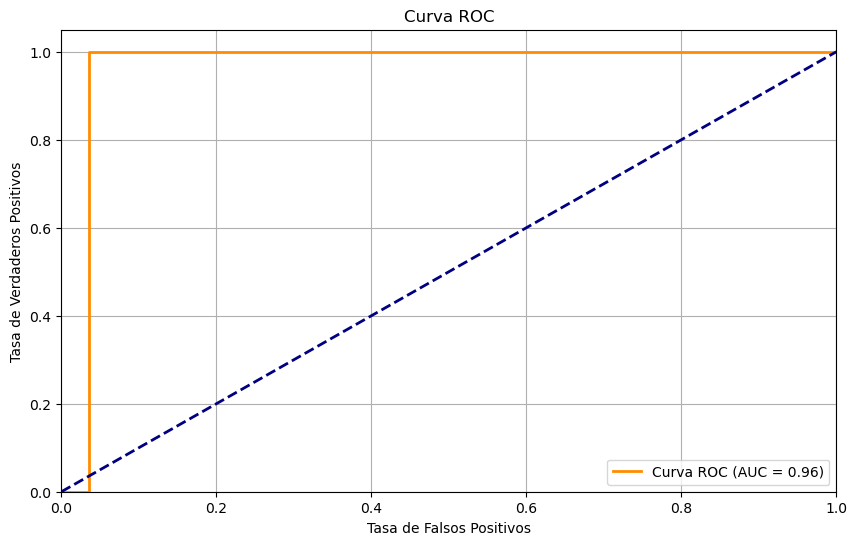

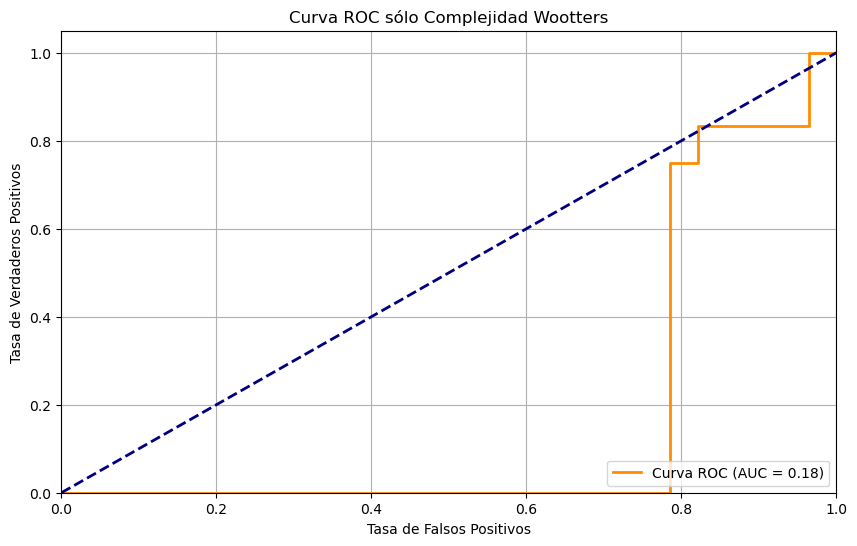

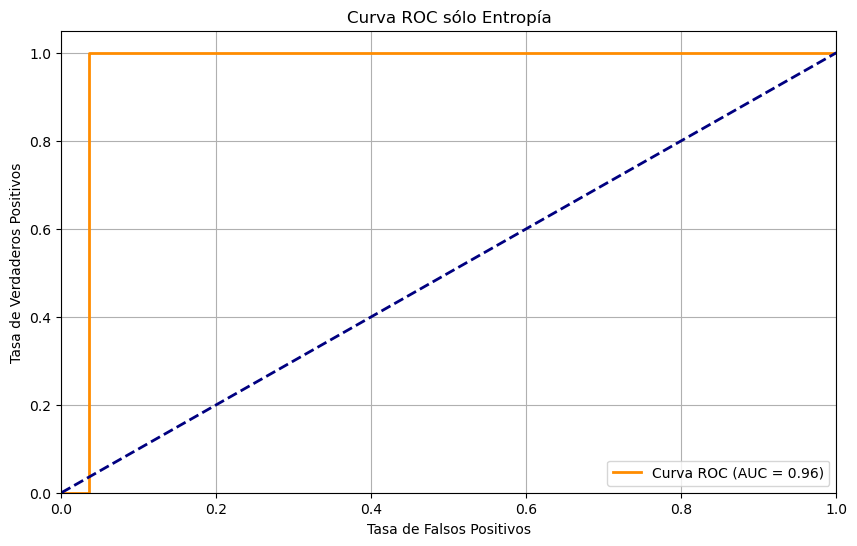

rbio1.1
Estadístico: 0.7865631580352783
Valor p: 0.006617142353206873
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.792425811290741
Valor p: 7.872208516346291e-05
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 275.0
Valor p: 0.0016699999979822716
Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)
---------------------------------------------------------------------------
Confusion Matrix:
TN: 27
FP: 1
FN: 0
TP: 12
Accuracy: 0.975
Precision: 0.9230769230769231
Recall: 1.0
F1-Score: 0.9600000000000001
Tiempo entrenamiento: 0.0018999576568603516
Tiempo predicción: 0.0005438327789306641


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


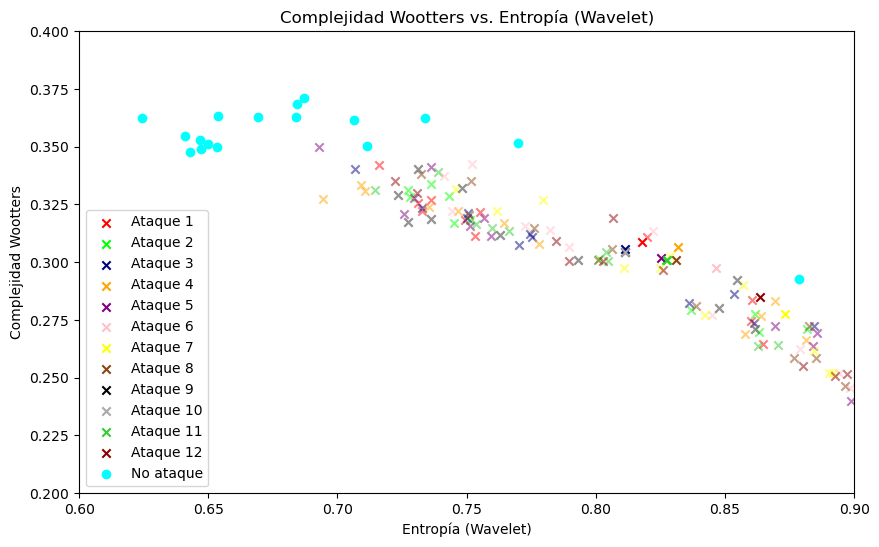

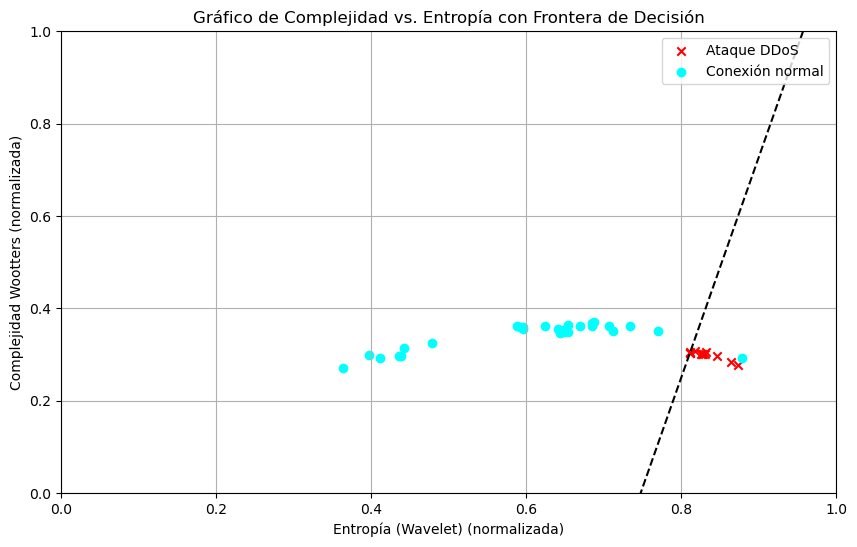

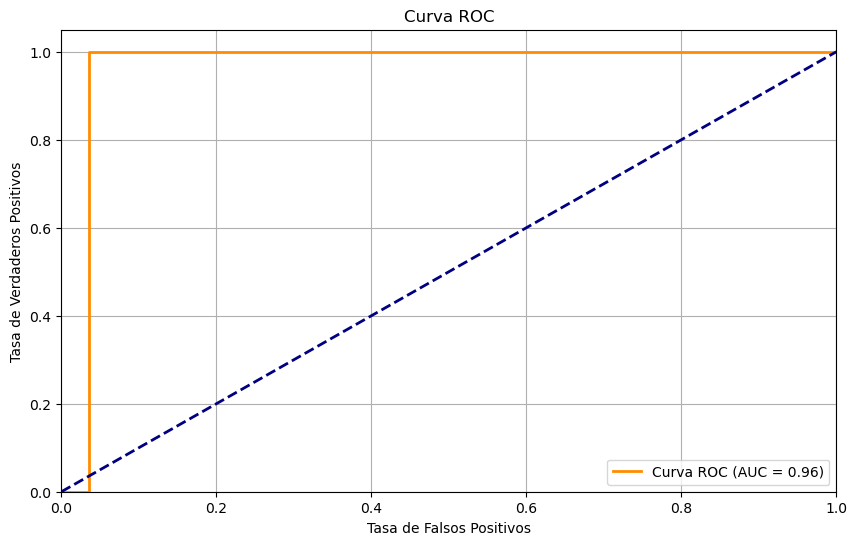

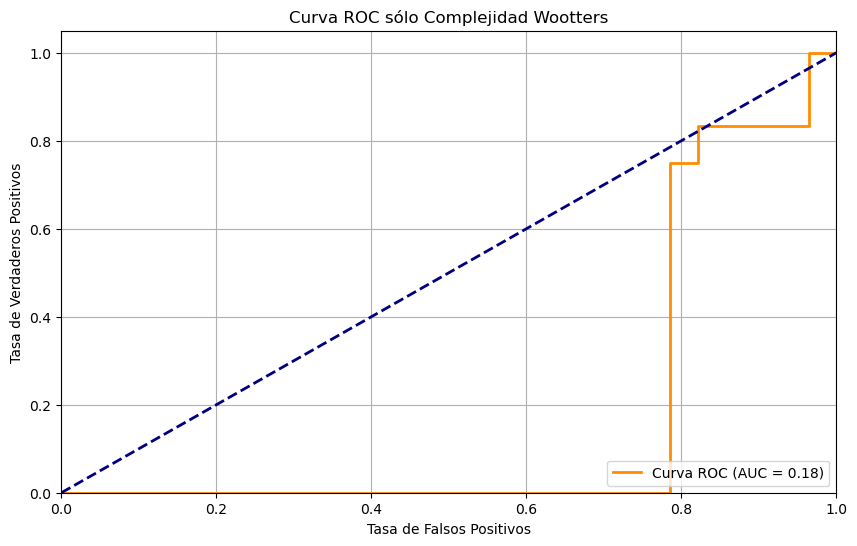

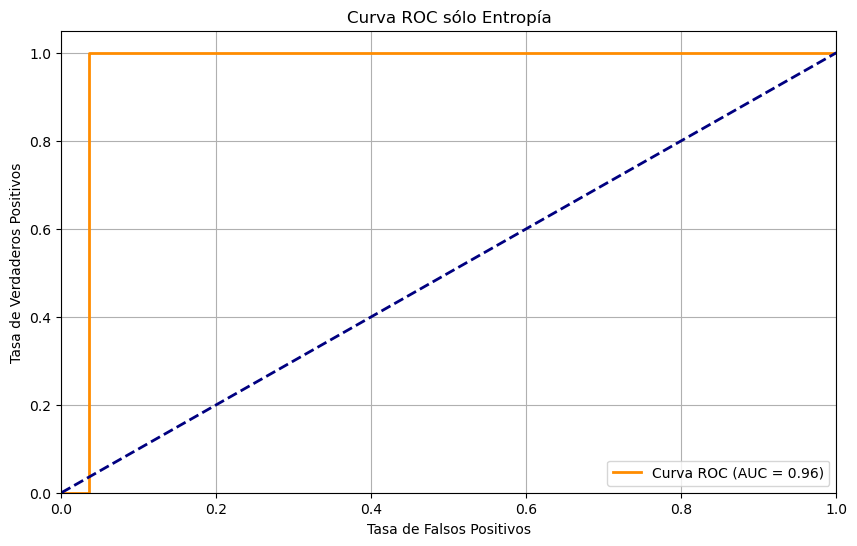

bior1.3
Estadístico: 0.8678178191184998
Valor p: 0.061320144683122635
La muestra parece provenir de una distribución normal (no se rechaza la hipótesis nula)
Estadístico: 0.8851500749588013
Valor p: 0.005226558074355125
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 205.0
Valor p: 0.2813400231629628
No hay diferencias significativas entre las muestras (no se rechaza la hipótesis nula)
---------------------------------------------------------------------------
Confusion Matrix:
TN: 27
FP: 1
FN: 0
TP: 12
Accuracy: 0.975
Precision: 0.9230769230769231
Recall: 1.0
F1-Score: 0.9600000000000001
Tiempo entrenamiento: 0.002022981643676758
Tiempo predicción: 0.0005440711975097656


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


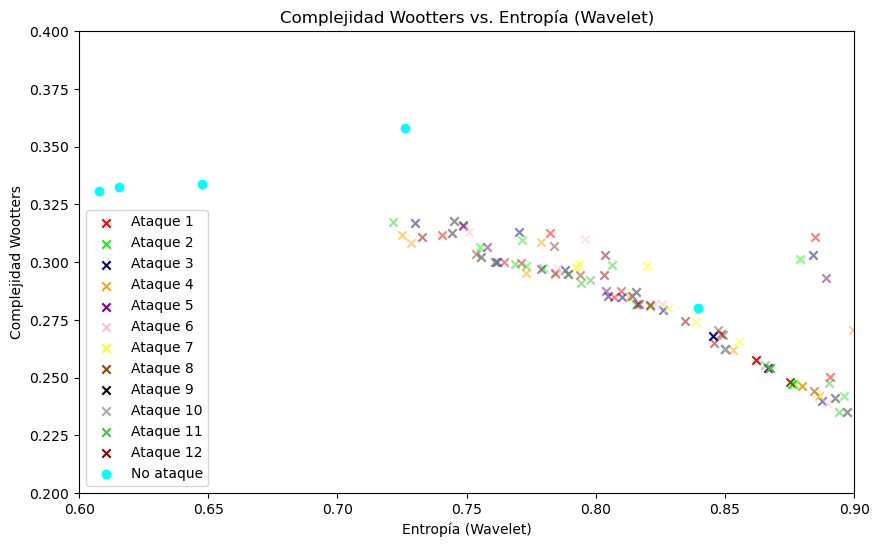

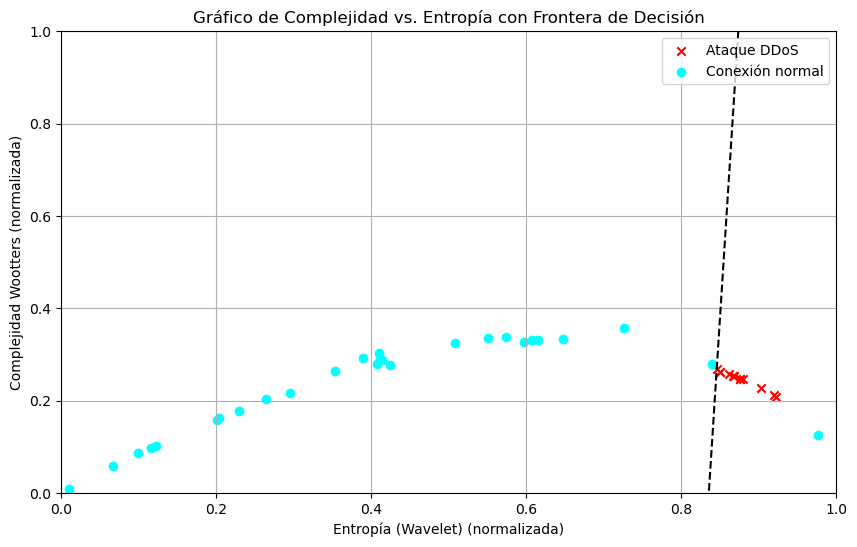

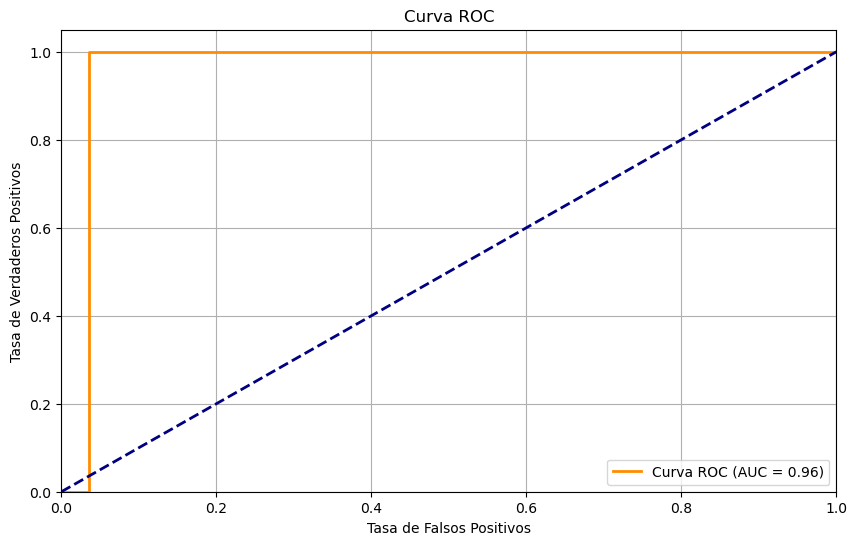

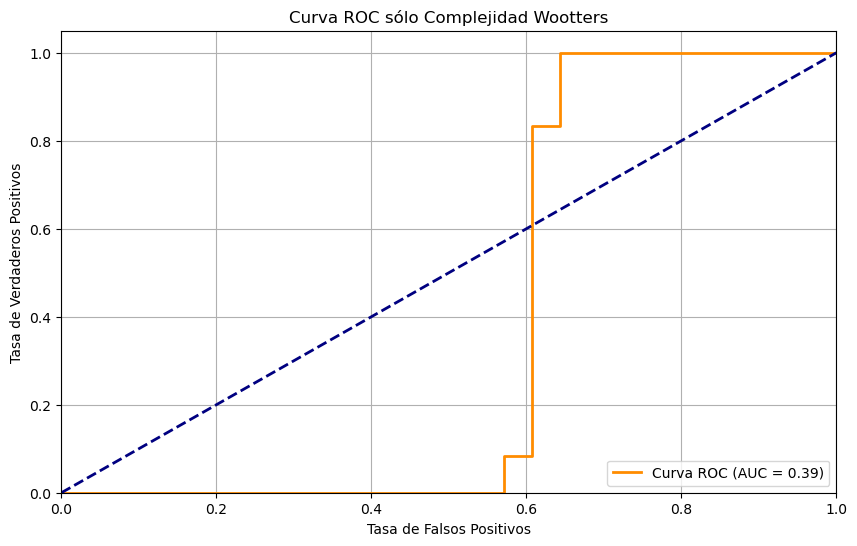

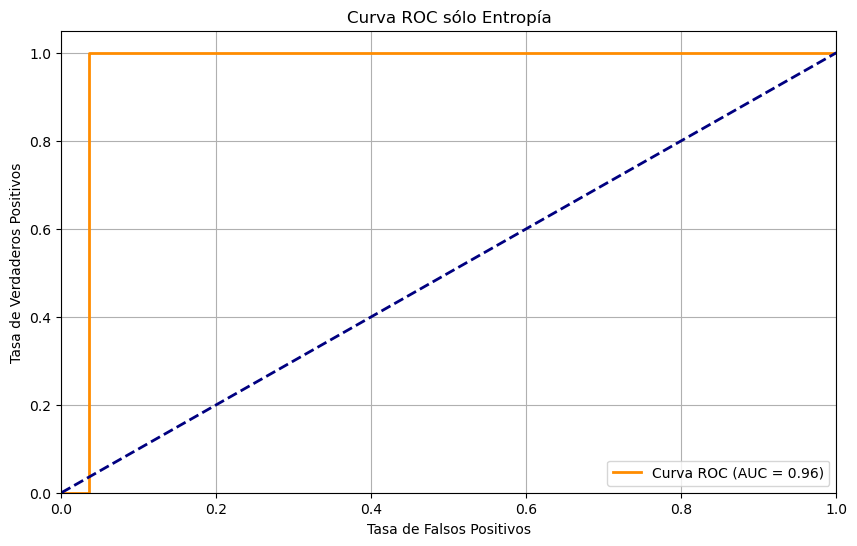

bior1.5
Estadístico: 0.8569383025169373
Valor p: 0.04476355016231537
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.7282229661941528
Valor p: 7.325553724513156e-06
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 274.0
Valor p: 0.0018464450402072203
Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)
---------------------------------------------------------------------------
Confusion Matrix:
TN: 26
FP: 2
FN: 0
TP: 12
Accuracy: 0.95
Precision: 0.8571428571428571
Recall: 1.0
F1-Score: 0.923076923076923
Tiempo entrenamiento: 0.0020759105682373047
Tiempo predicción: 0.0005118846893310547


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


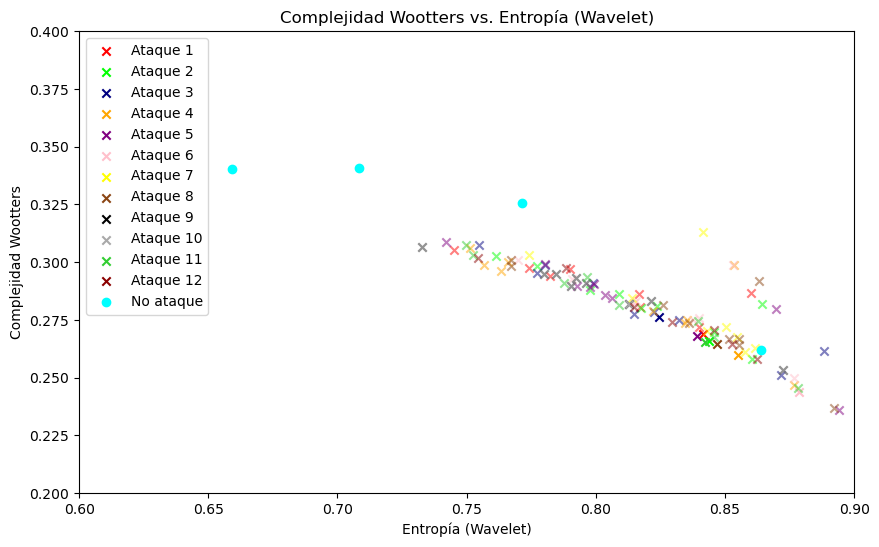

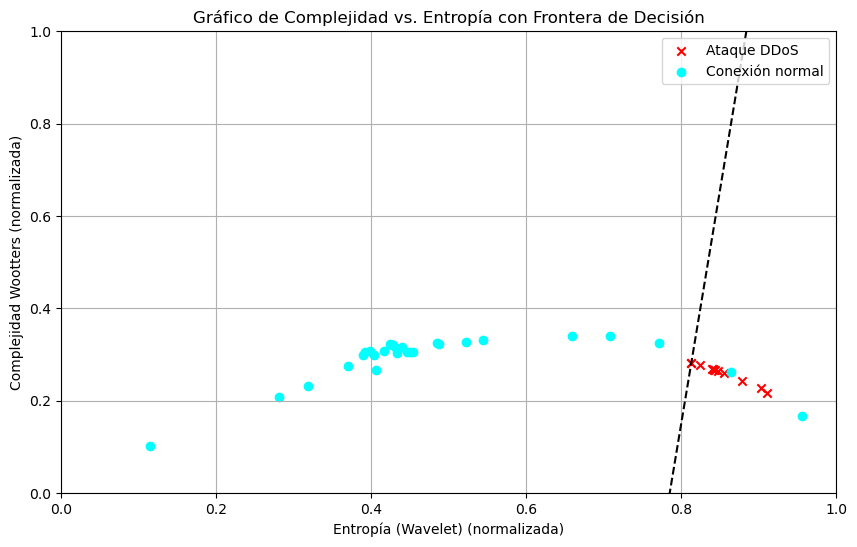

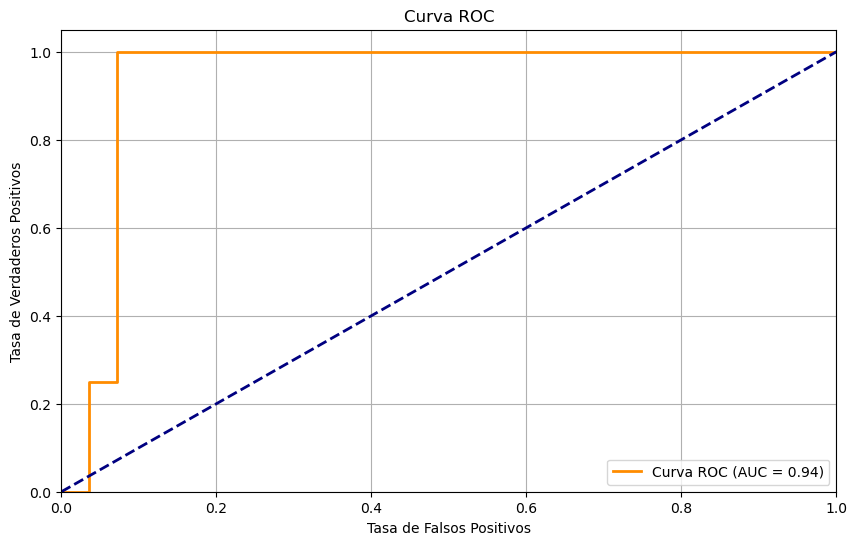

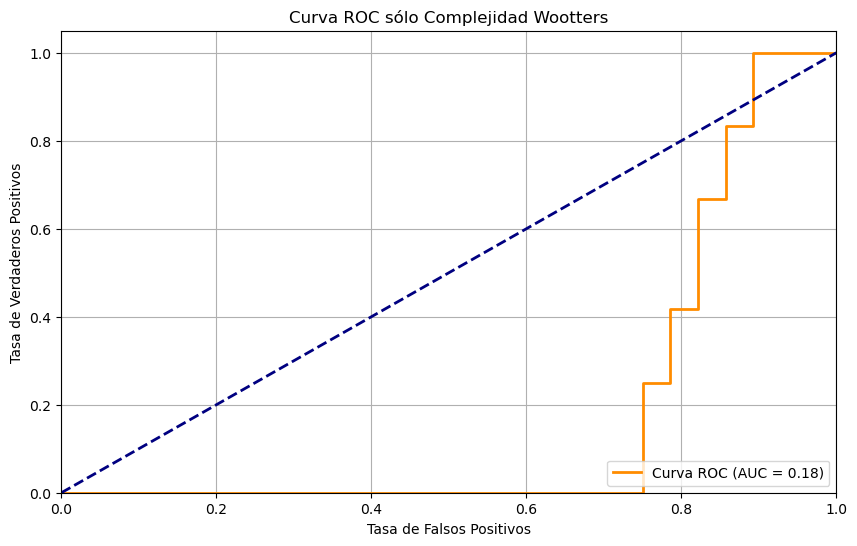

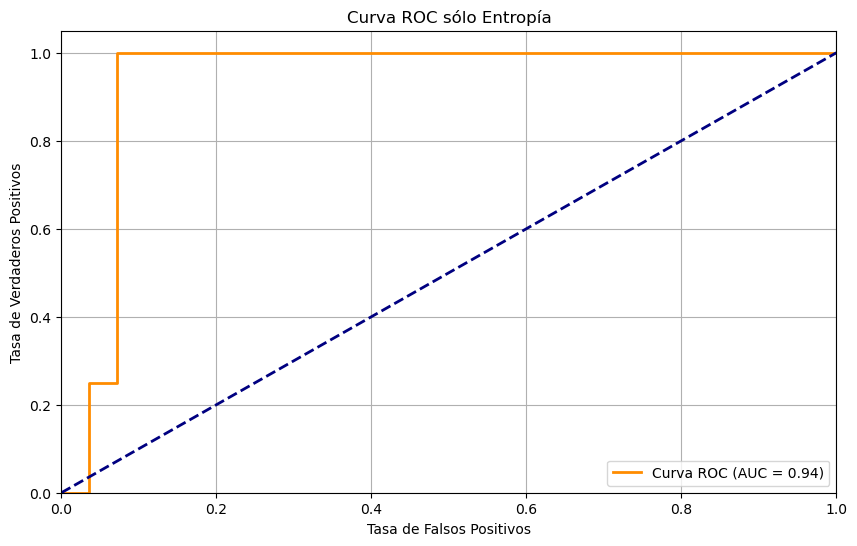

rbio1.3
Estadístico: 0.8802112340927124
Valor p: 0.08819429576396942
La muestra parece provenir de una distribución normal (no se rechaza la hipótesis nula)
Estadístico: 0.6545604467391968
Valor p: 6.907513352416572e-07
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 284.0
Valor p: 0.0006519320620085085
Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)
---------------------------------------------------------------------------
Confusion Matrix:
TN: 14
FP: 14
FN: 0
TP: 12
Accuracy: 0.65
Precision: 0.46153846153846156
Recall: 1.0
F1-Score: 0.631578947368421
Tiempo entrenamiento: 0.001959085464477539
Tiempo predicción: 0.0005109310150146484


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


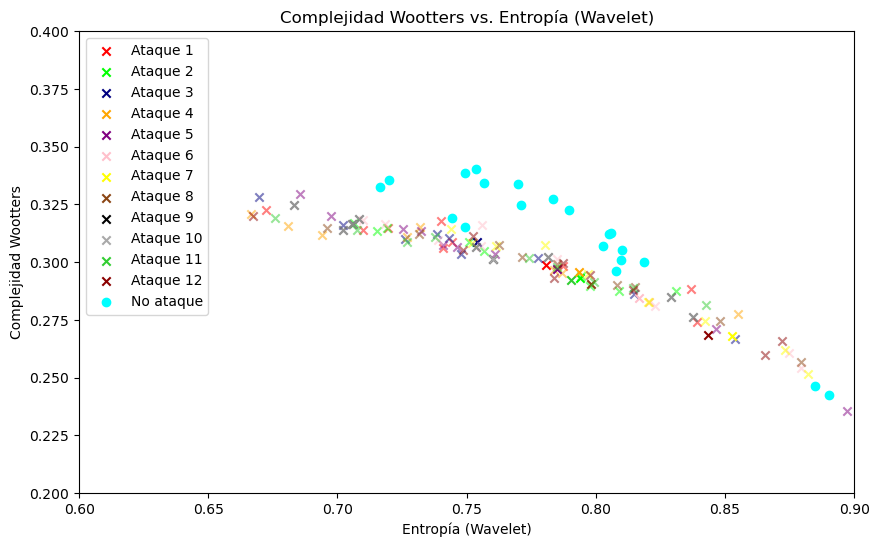

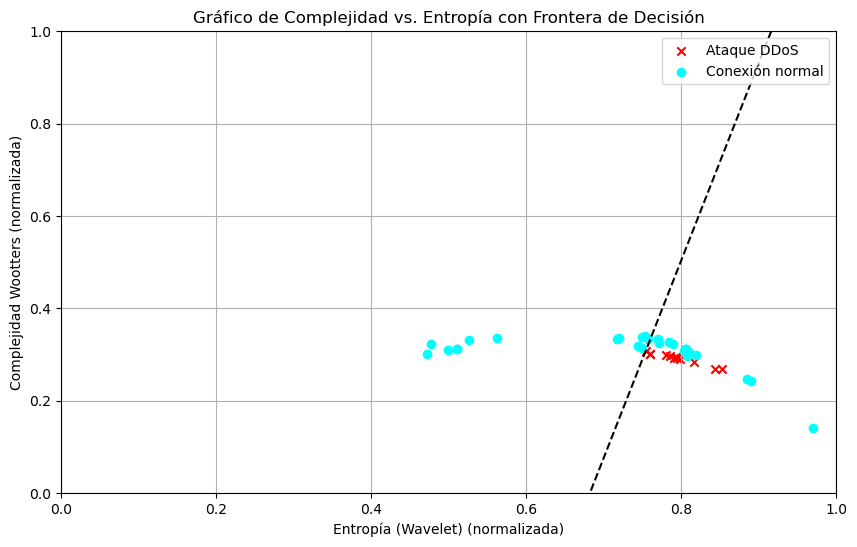

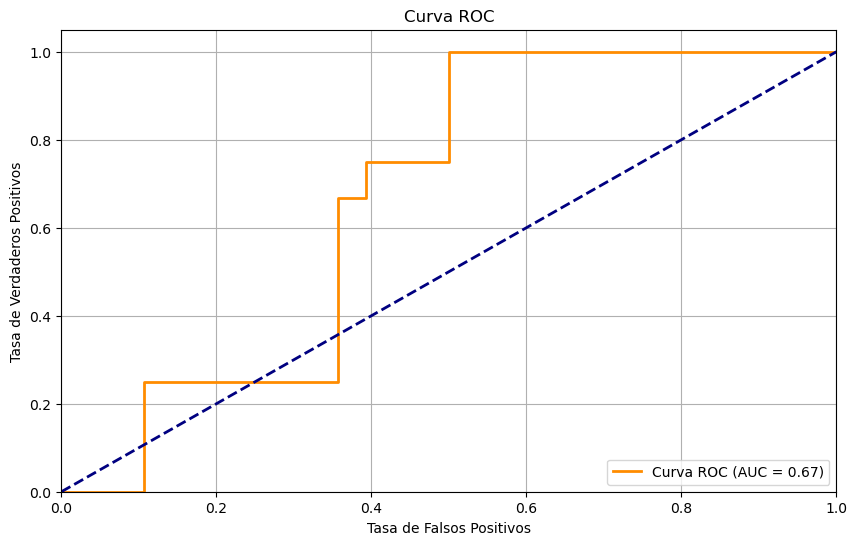

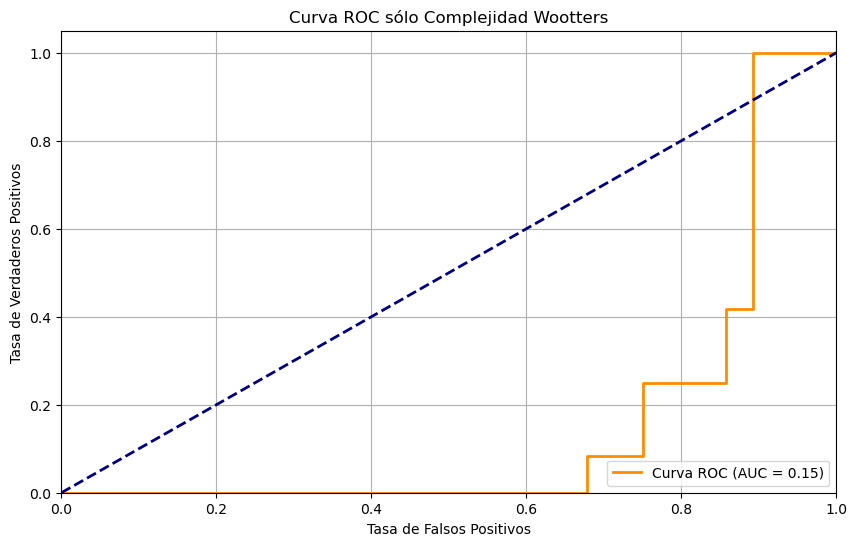

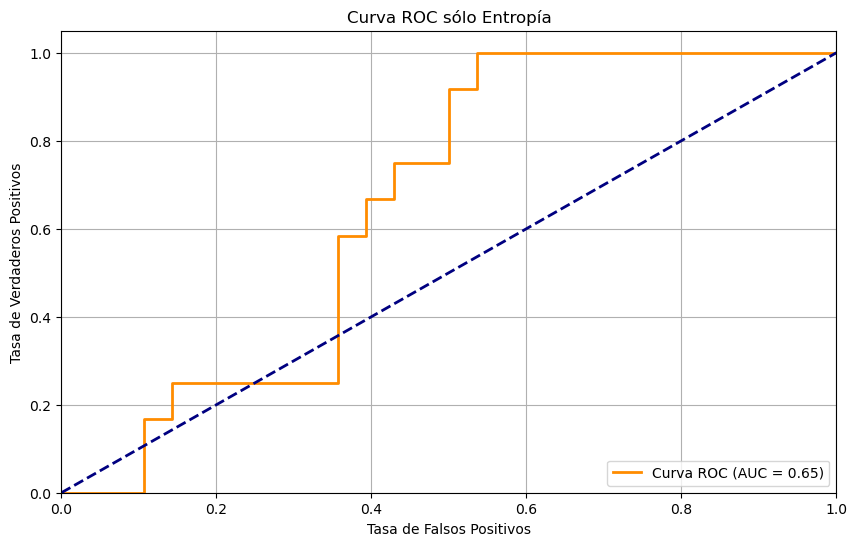

bior2.4
Estadístico: 0.8602786064147949
Valor p: 0.04928108677268028
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.8674654960632324
Valor p: 0.0021496049594134092
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 304.0
Valor p: 6.351839529639437e-05
Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)
---------------------------------------------------------------------------
Confusion Matrix:
TN: 23
FP: 5
FN: 0
TP: 12
Accuracy: 0.875
Precision: 0.7058823529411765
Recall: 1.0
F1-Score: 0.8275862068965517
Tiempo entrenamiento: 0.0017719268798828125
Tiempo predicción: 0.0004851818084716797


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


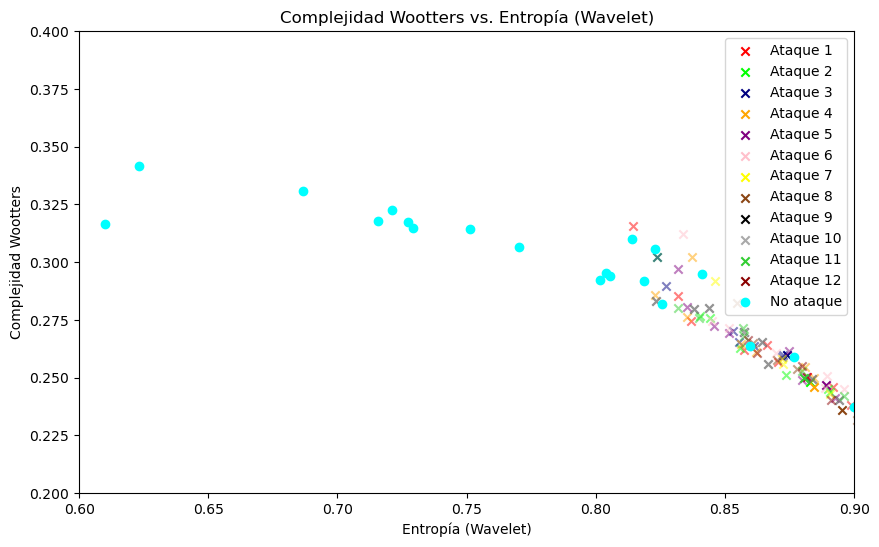

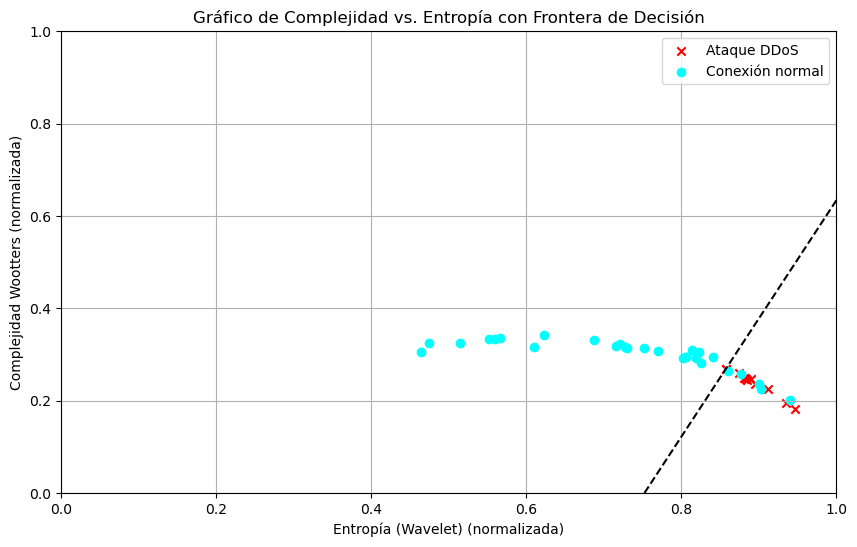

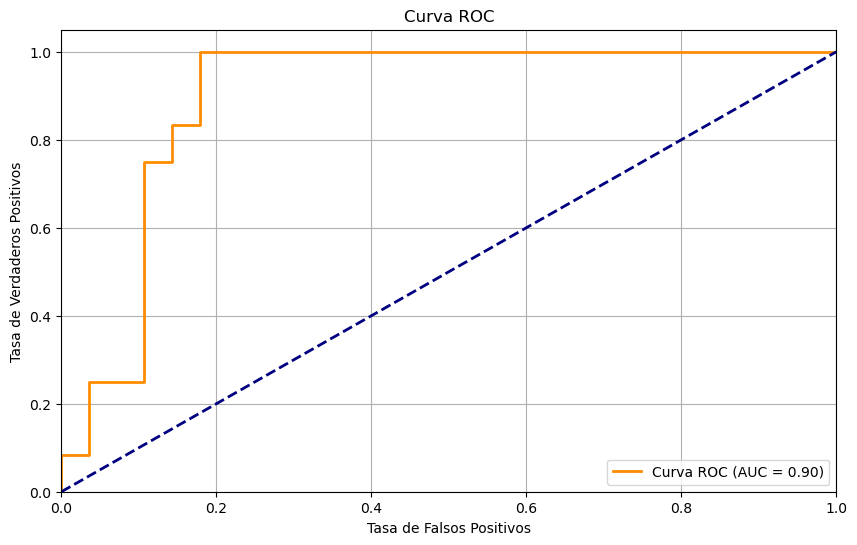

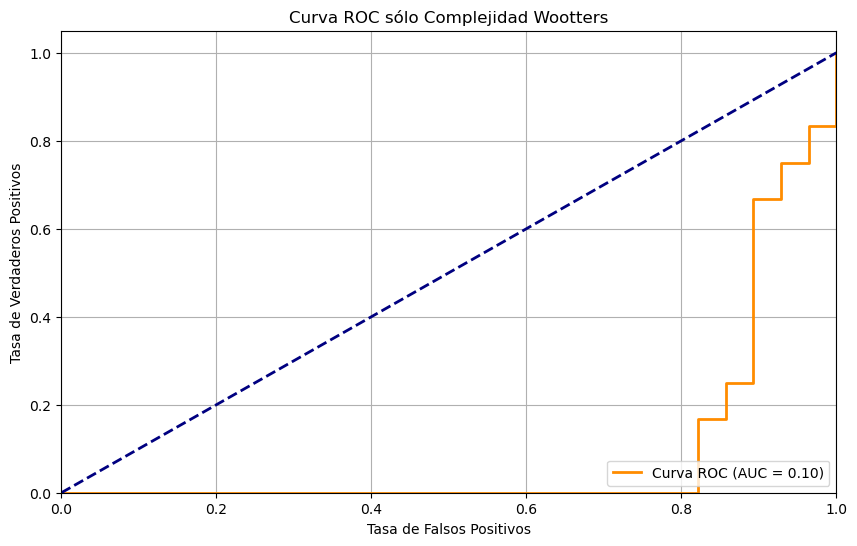

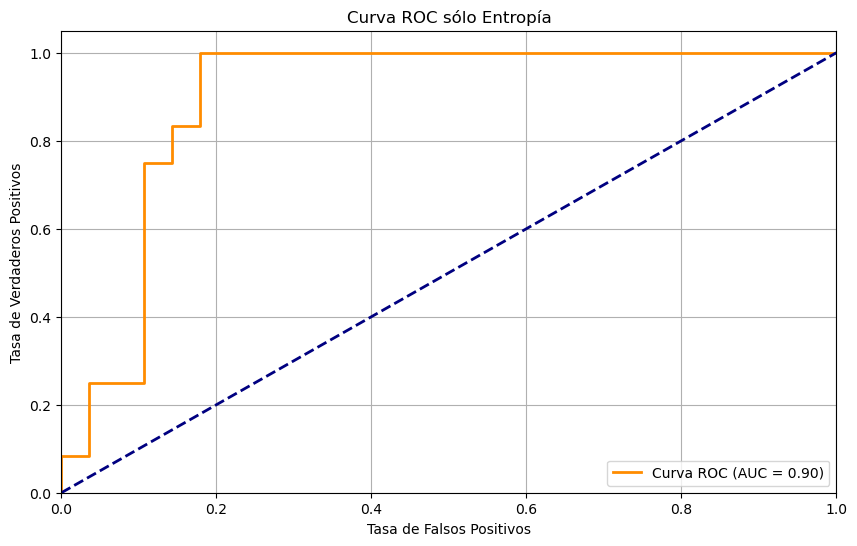

bior2.8
Estadístico: 0.7718780040740967
Valor p: 0.004566292278468609
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.7703582048416138
Valor p: 3.345237564644776e-05
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 307.0
Valor p: 4.353144702027583e-05
Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)
---------------------------------------------------------------------------
Confusion Matrix:
TN: 24
FP: 4
FN: 0
TP: 12
Accuracy: 0.9
Precision: 0.75
Recall: 1.0
F1-Score: 0.8571428571428571
Tiempo entrenamiento: 0.002118825912475586
Tiempo predicción: 0.0006148815155029297


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


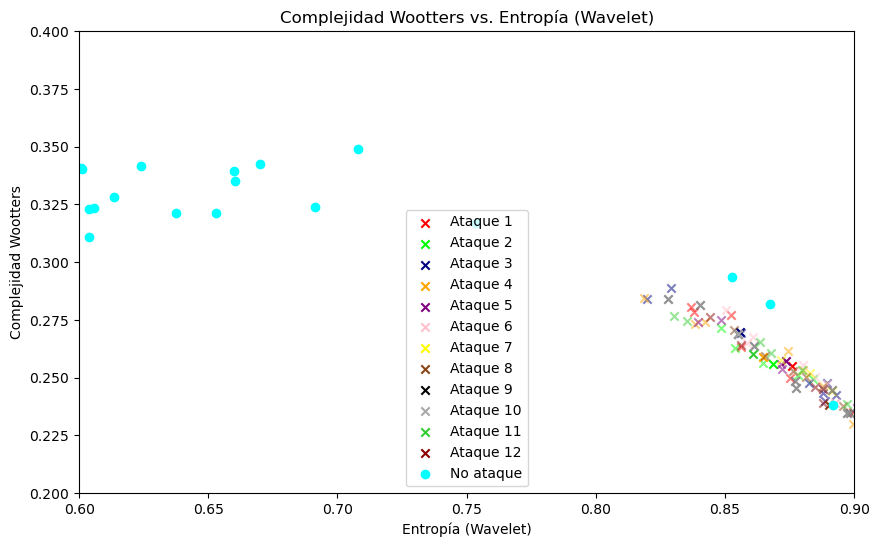

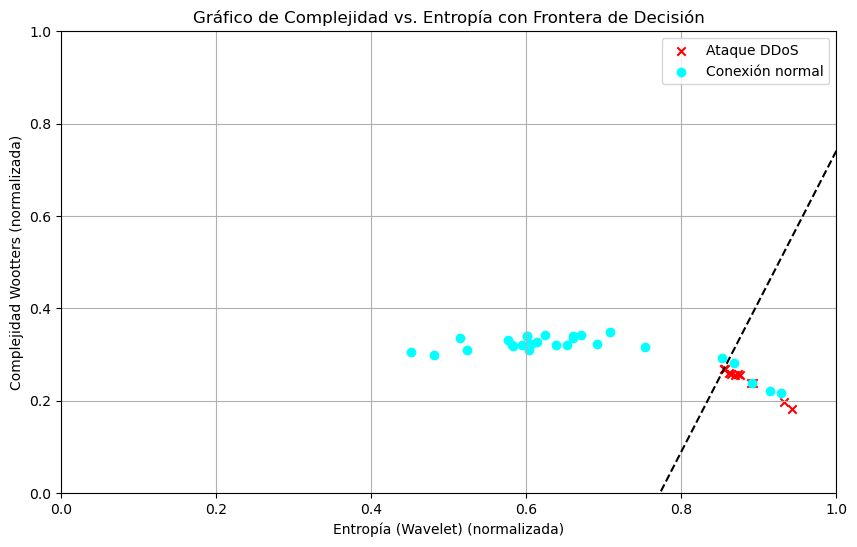

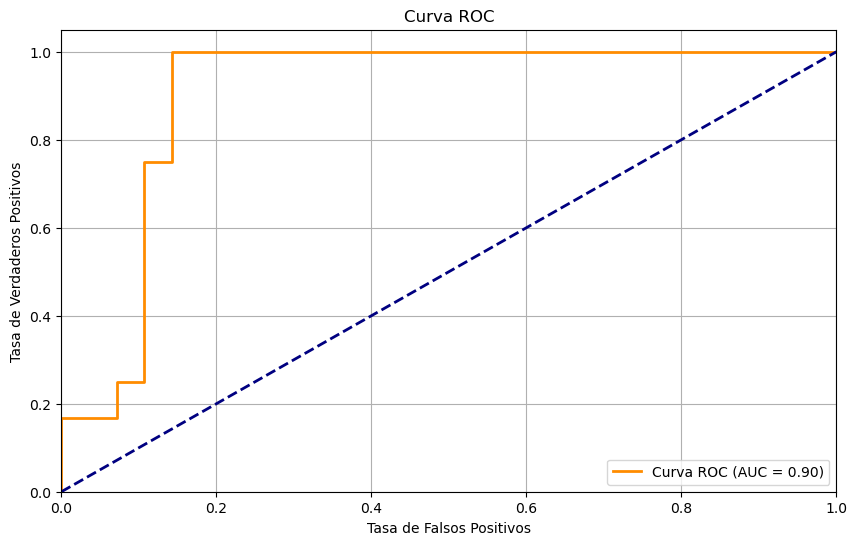

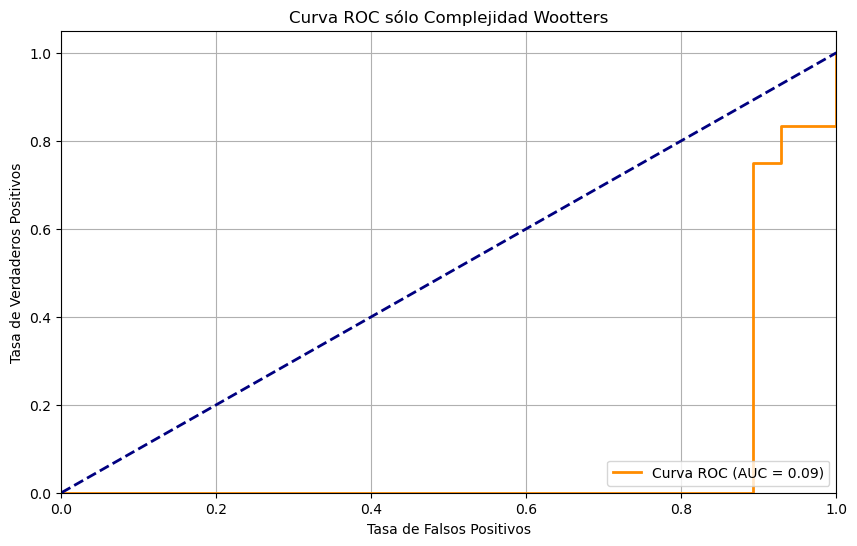

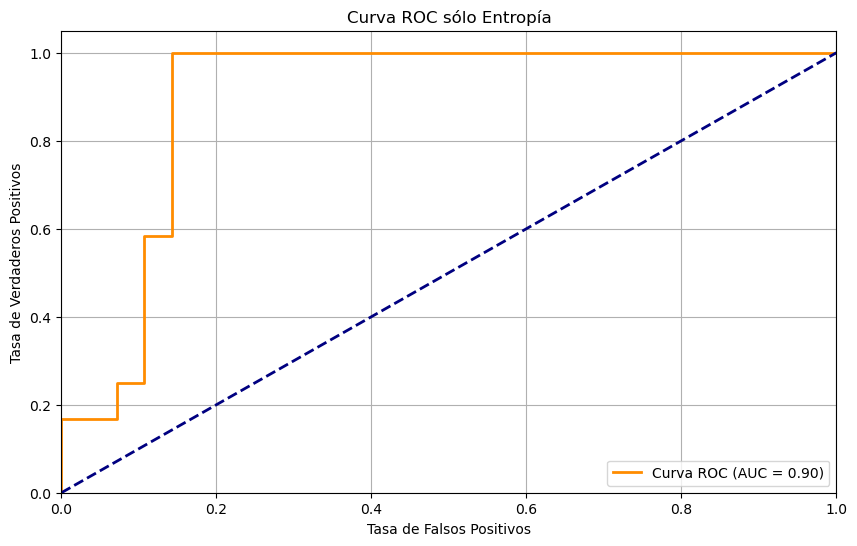

coif2
Estadístico: 0.8098293542861938
Valor p: 0.012144900858402252
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.7468525171279907
Valor p: 1.4091571756580379e-05
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 175.0
Valor p: 0.8478593647867048
No hay diferencias significativas entre las muestras (no se rechaza la hipótesis nula)
---------------------------------------------------------------------------
Confusion Matrix:
TN: 7
FP: 21
FN: 0
TP: 12
Accuracy: 0.475
Precision: 0.36363636363636365
Recall: 1.0
F1-Score: 0.5333333333333333
Tiempo entrenamiento: 0.002213716506958008
Tiempo predicción: 0.0005519390106201172


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


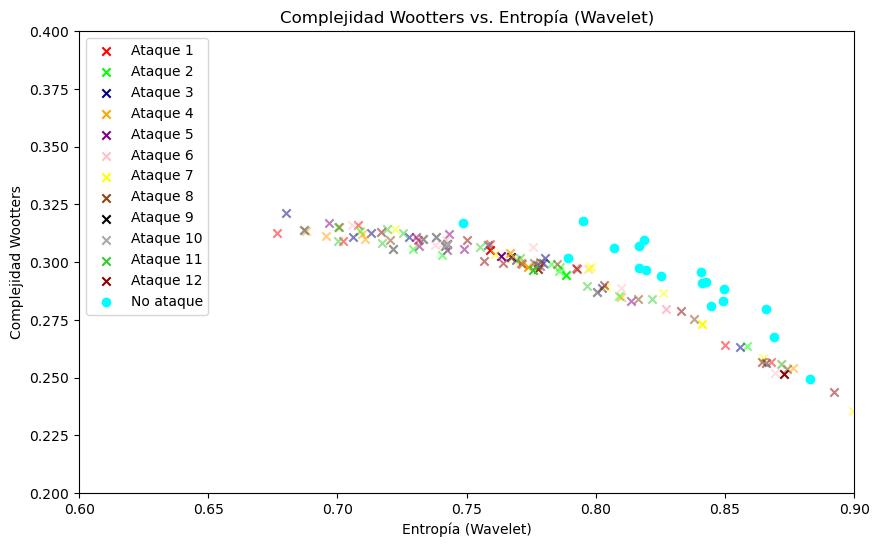

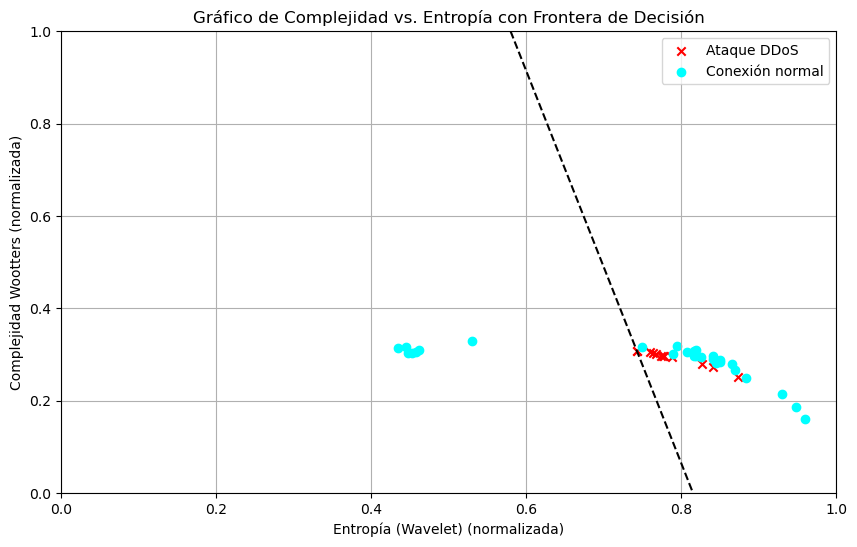

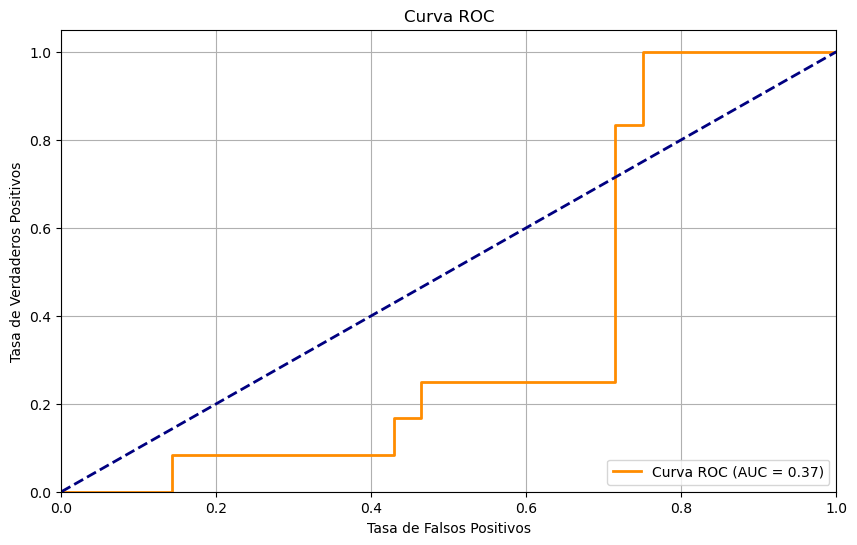

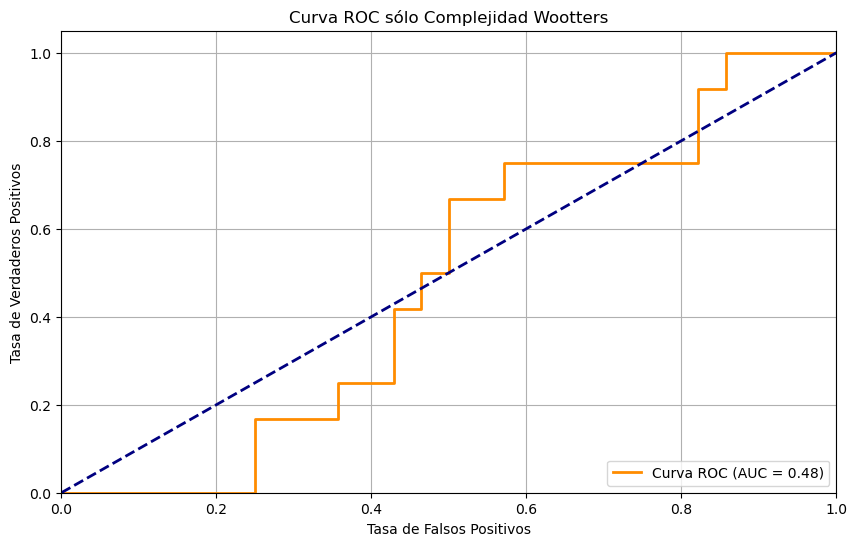

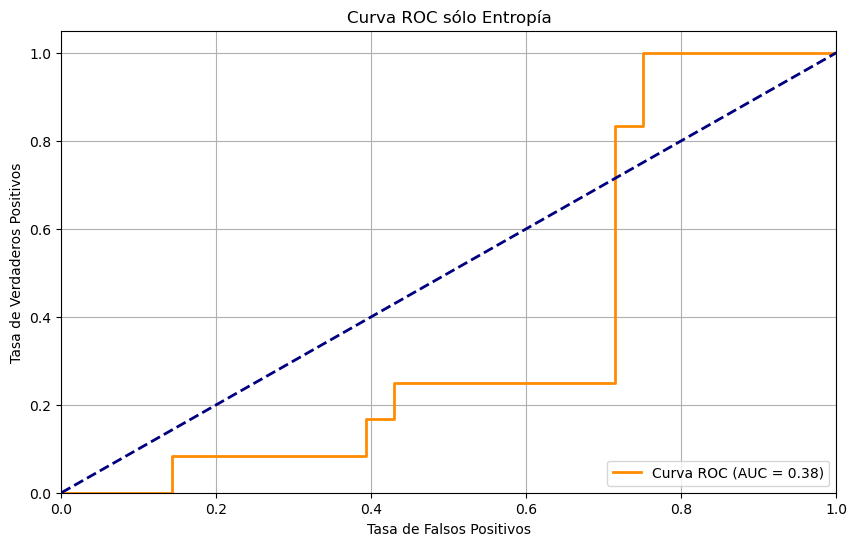

          0         1         2         3
0    family   auc_c_h     auc_c     auc_h
1   bior1.1  0.964286  0.181548  0.964286
2       db1  0.964286  0.181548  0.964286
3      haar  0.964286  0.181548  0.964286
4   rbio1.1  0.964286  0.181548  0.964286
5   bior1.3  0.964286  0.389881  0.964286
6   bior1.5    0.9375  0.184524    0.9375
7   rbio1.3  0.666667  0.154762  0.654762
8   bior2.4   0.89881  0.095238   0.89881
9   bior2.8  0.904762   0.08631   0.89881
10    coif2  0.372024  0.479167  0.377976


In [619]:
wootters_sin_reps = [["family","auc_c_h","auc_c","auc_h"]]
for i in range(10):
    print(ranked_wavelets[i][0])
    fila = []
    fila.append(ranked_wavelets[i][0])
    df = calculate_desequilibrium_and_complexity(file_paths,ranked_wavelets[i][0])

    plot_complexity_entropy(df,'Complejidad Wootters')
    
    # Realizar la prueba de Shapiro-Wilk
    stat, p_value = shapiro(df['Complejidad Wootters'].iloc[inicio_ataques])

    # Imprimir los resultados
    print('Estadístico:', stat)
    print('Valor p:', p_value)

    # Evaluar la normalidad
    alpha = 0.05
    if p_value > alpha:
        print('La muestra parece provenir de una distribución normal (no se rechaza la hipótesis nula)')
    else:
        print('La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)')

    # Realizar la prueba de Shapiro-Wilk
    stat, p_value = shapiro(df['Complejidad Wootters'][sum(reps):])

    print('Estadístico:', stat)
    print('Valor p:', p_value)

    # Evaluar la normalidad
    alpha = 0.05
    if p_value > alpha:
        print('La muestra parece provenir de una distribución normal (no se rechaza la hipótesis nula)')
    else:
        print('La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)')

    stat, p_value = mannwhitneyu(df['Complejidad Wootters'][sum(reps):], df['Complejidad Wootters'].iloc[inicio_ataques])

    # Imprimir los resultados
    print('Estadístico:', stat)
    print('Valor p:', p_value)

    # Evaluar la significancia
    alpha = 0.05
    if p_value > alpha:
        print('No hay diferencias significativas entre las muestras (no se rechaza la hipótesis nula)')
    else:
        print('Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)')
    print("---------------------------------------------------------------------------")
    df['Clasificación'] = [1]*sum(reps)+[0]*(len(df)-sum(reps))
    df2 = df.iloc[inicio_ataques]
    df3 = df.iloc[sum(reps):]
    # Separar características y etiquetas
    X = pd.concat([df2,df3])[['Entropía (Wavelet)', 'Complejidad Wootters']]  
    y = pd.concat([df2,df3])['Clasificación']

    # Entrenar el modelo de regresión logística
    model = LogisticRegression()
    start_cpu_train = psutil.cpu_percent(interval=None)
    start_train = time.time()
    model.fit(X, y)
    end_train = time.time()
    end_cpu_train = psutil.cpu_percent(interval=None)
    cpu_usage_train = end_cpu_train - start_cpu_train
    training_time = end_train - start_train
    """
    # Generar una malla de puntos para graficar la frontera de decisión
    xx, yy = np.mgrid[0:1:.01, 0:1:.01]
    grid = np.c_[xx.ravel(), yy.ravel()]
    probs = model.predict_proba(grid)[:, 1].reshape(xx.shape)
    """
    # Definir x_min, x_max, y_min, y_max en base a los datos normalizados
    x_min, x_max = X['Entropía (Wavelet)'].min() - 0.1, X['Entropía (Wavelet)'].max() + 0.1
    y_min, y_max = X['Complejidad Wootters'].min() - 0.1, X['Complejidad Wootters'].max() + 0.1

    # Asegurarse de que los límites estén dentro del rango 0-1
    x_min, x_max = max(0, x_min), min(1, x_max)
    y_min, y_max = max(0, y_min), min(1, y_max)

    xx, yy = np.meshgrid(np.linspace(0, 1, 100), np.linspace(0, 1, 100))
    start_cpu = psutil.cpu_percent(interval=None)
    start_pred = time.time()
    y_pred_prob = model.predict_proba(X)[:, 1]
    end_pred = time.time()
    end_cpu = psutil.cpu_percent(interval=None)
    cpu_usage = end_cpu - start_cpu
    prediction_time = end_pred - start_pred
    #print(y_pred_prob)

    # Calcular la curva ROC y el AUC
    fpr, tpr, thresholds = roc_curve(y, y_pred_prob)
    roc_auc = roc_auc_score(y, y_pred_prob)
    fila.append(roc_auc)

    f1_scores = [f1_score(y, (y_pred_prob >= thresh).astype(int)) for thresh in thresholds]

    # Encontrar el umbral que maximiza el F1-Score
    optimal_threshold = thresholds[np.argmax(f1_scores)]

    # Predecir con el modelo
    Z = model.predict_proba(np.c_[xx.ravel(), yy.ravel()])[:, 1]
    Z = Z.reshape(xx.shape)

    # Graficar los puntos y la frontera de decisión
        # Predecir etiquetas binarias usando el umbral óptimo
    y_pred_optimal = (y_pred_prob >= optimal_threshold).astype(int)

    # Calcular la matriz de confusión
    tn, fp, fn, tp = confusion_matrix(y, y_pred_optimal).ravel()

    print("Confusion Matrix:")
    print("TN:", tn)
    print("FP:", fp)
    print("FN:", fn)
    print("TP:", tp)

    # Opcional: Calcular otras métricas de evaluación
    accuracy = (tp + tn) / (tp + tn + fp + fn)
    precision = tp / (tp + fp)
    recall = tp / (tp + fn)
    f1 = 2 * (precision * recall) / (precision + recall)

    print("Accuracy:", accuracy)
    print("Precision:", precision)
    print("Recall:", recall)
    print("F1-Score:", f1)
    print("Tiempo entrenamiento:",training_time)
    print("Tiempo predicción:",prediction_time)
    #print("% uso CPU entrenamiento:",cpu_usage_train)
    #print("% uso CPU predicción:",cpu_usage)
    
    
    # Graficar los puntos y la frontera de decisión
    plt.figure(figsize=(10, 6))
    plt.scatter(X[y == 1]['Entropía (Wavelet)'], X[y == 1]['Complejidad Wootters'], marker='x', label='Ataque DDoS', c="Red")
    plt.scatter(X[y == 0]['Entropía (Wavelet)'], X[y == 0]['Complejidad Wootters'], marker='o', label='Conexión normal', c="Cyan")

    # Contorno de la frontera de decisión
    #plt.contour(xx, yy, probs, levels=[0.5], cmap="Greys", vmin=0, vmax=1)

    plt.contour(xx, yy, Z, levels=[optimal_threshold], colors='black', linestyles='--')
    plt.xlabel('Entropía (Wavelet) (normalizada)')
    plt.ylabel('Complejidad Wootters (normalizada)')
    plt.title('Gráfico de Complejidad vs. Entropía con Frontera de Decisión')
    plt.legend()
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.0])
    plt.grid(True)
    plt.show()
    
    # Predecir las probabilidades de la clase positiva
    y_pred_prob = model.predict_proba(X)[:, 1]
    #print(y_pred_prob)

    # Calcular la curva ROC y el AUC
    fpr, tpr, thresholds = roc_curve(y, y_pred_prob)
    roc_auc = roc_auc_score(y, y_pred_prob)


    # Graficar la curva ROC
    plt.figure(figsize=(10, 6))
    plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'Curva ROC (AUC = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('Tasa de Falsos Positivos')
    plt.ylabel('Tasa de Verdaderos Positivos')
    plt.title('Curva ROC')
    plt.legend(loc="lower right")
    plt.grid(True)
    plt.show()
    
    # Calcular la curva ROC y el AUC para sólo complejidad
    fpr, tpr, thresholds = roc_curve(y, X["Complejidad Wootters"])
    roc_auc = roc_auc_score(y, X["Complejidad Wootters"])
    fila.append(roc_auc)


    # Graficar la curva ROC
    plt.figure(figsize=(10, 6))
    plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'Curva ROC (AUC = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('Tasa de Falsos Positivos')
    plt.ylabel('Tasa de Verdaderos Positivos')
    plt.title('Curva ROC sólo Complejidad Wootters')
    plt.legend(loc="lower right")
    plt.grid(True)
    plt.show()
    
    # Calcular la curva ROC y el AUC para sólo Entropía
    fpr, tpr, thresholds = roc_curve(y, X['Entropía (Wavelet)'])
    roc_auc = roc_auc_score(y, X['Entropía (Wavelet)'])
    fila.append(roc_auc)


    # Graficar la curva ROC
    plt.figure(figsize=(10, 6))
    plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'Curva ROC (AUC = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('Tasa de Falsos Positivos')
    plt.ylabel('Tasa de Verdaderos Positivos')
    plt.title('Curva ROC sólo Entropía')
    plt.legend(loc="lower right")
    plt.grid(True)
    plt.show()
    wootters_sin_reps.append(fila)
print(pd.DataFrame(wootters_sin_reps))

## Sin repeticiones Desequilibrado Eucl.

bior1.1
Estadístico: 0.9085087776184082
Valor p: 0.20415277779102325
La muestra parece provenir de una distribución normal (no se rechaza la hipótesis nula)
Estadístico: 0.8431389331817627
Valor p: 0.0006817179382778704
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 272.0
Valor p: 0.0022517370776878806
Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)
---------------------------------------------------------------------------
Confusion Matrix:
TN: 27
FP: 1
FN: 0
TP: 12
Accuracy: 0.975
Precision: 0.9230769230769231
Recall: 1.0
F1-Score: 0.9600000000000001
Tiempo entrenamiento: 0.0033202171325683594
Tiempo predicción: 0.0005660057067871094


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


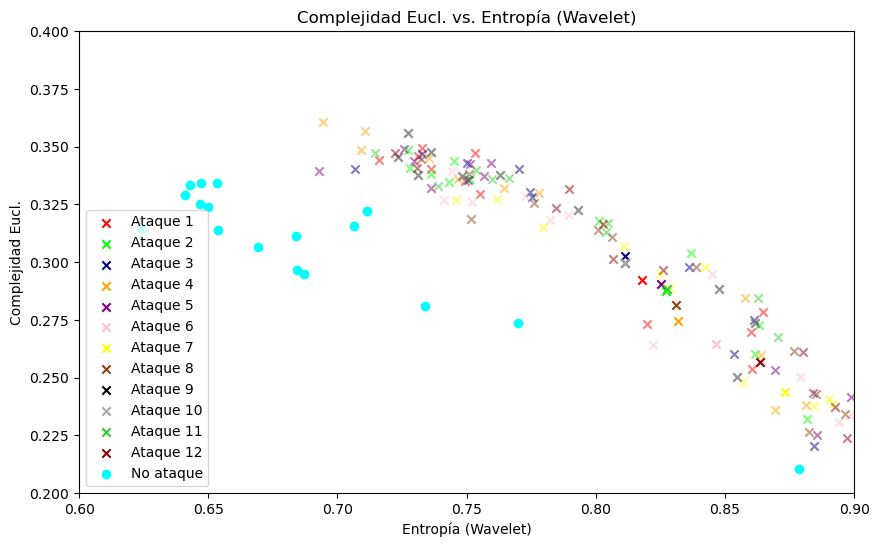

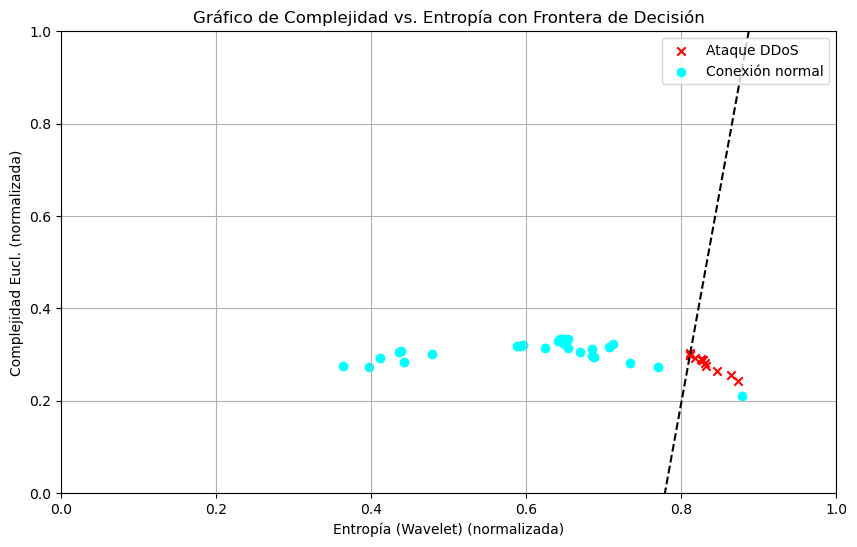

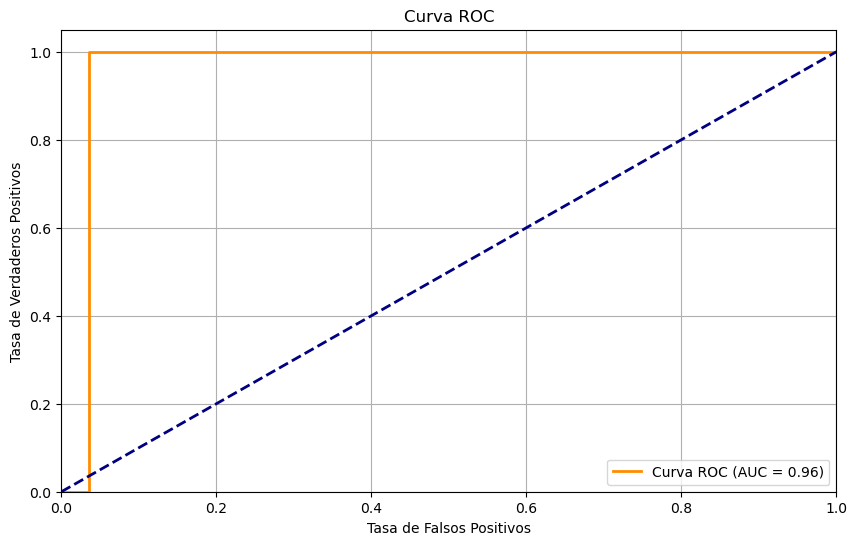

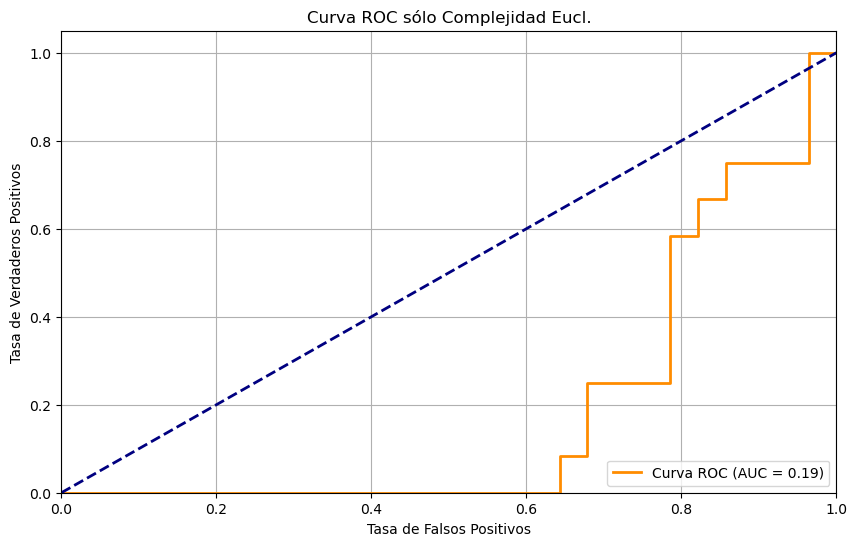

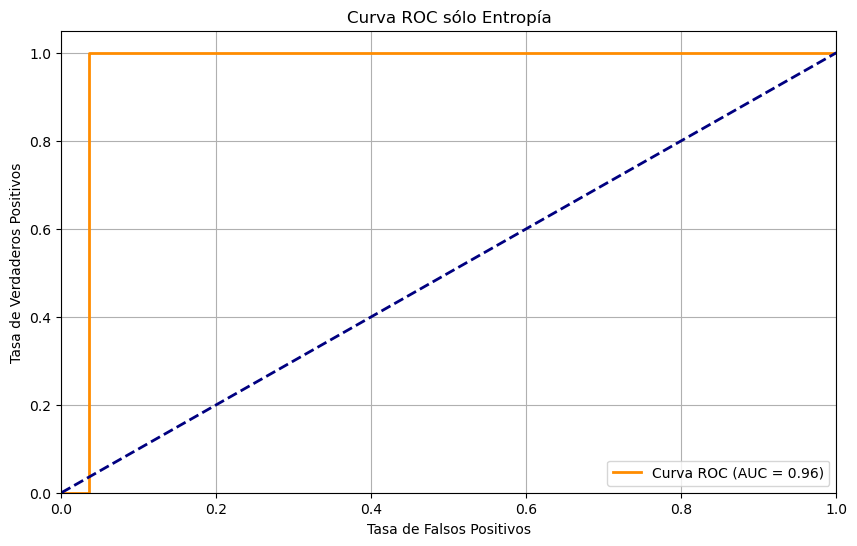

db1
Estadístico: 0.9085087776184082
Valor p: 0.20415277779102325
La muestra parece provenir de una distribución normal (no se rechaza la hipótesis nula)
Estadístico: 0.8431389331817627
Valor p: 0.0006817179382778704
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 272.0
Valor p: 0.0022517370776878806
Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)
---------------------------------------------------------------------------
Confusion Matrix:
TN: 27
FP: 1
FN: 0
TP: 12
Accuracy: 0.975
Precision: 0.9230769230769231
Recall: 1.0
F1-Score: 0.9600000000000001
Tiempo entrenamiento: 0.0016398429870605469
Tiempo predicción: 0.000476837158203125


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


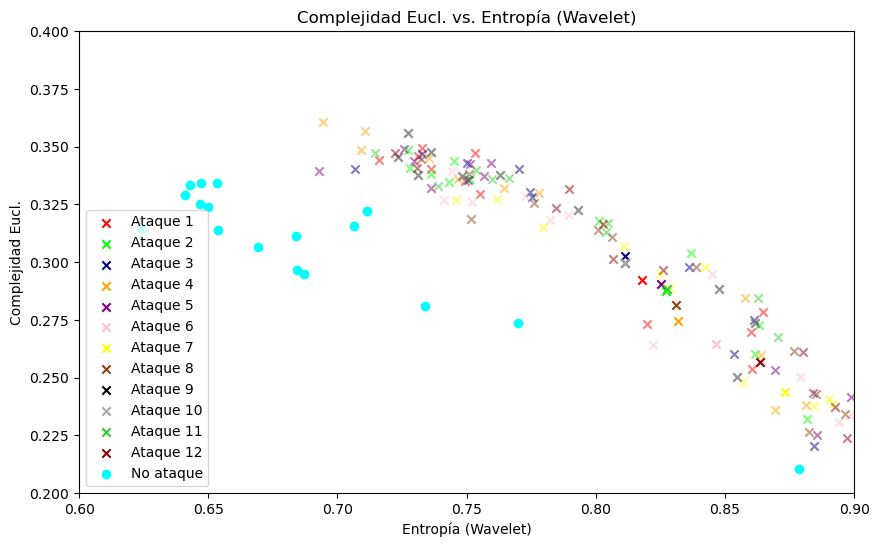

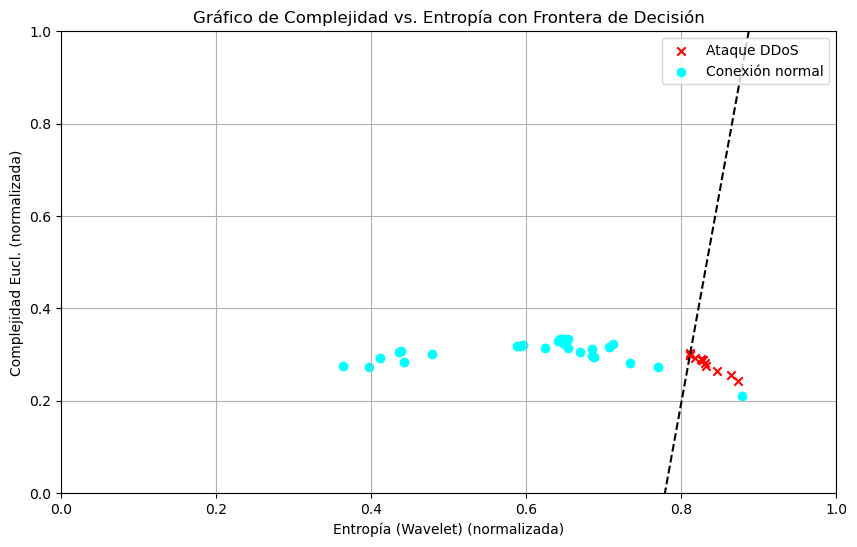

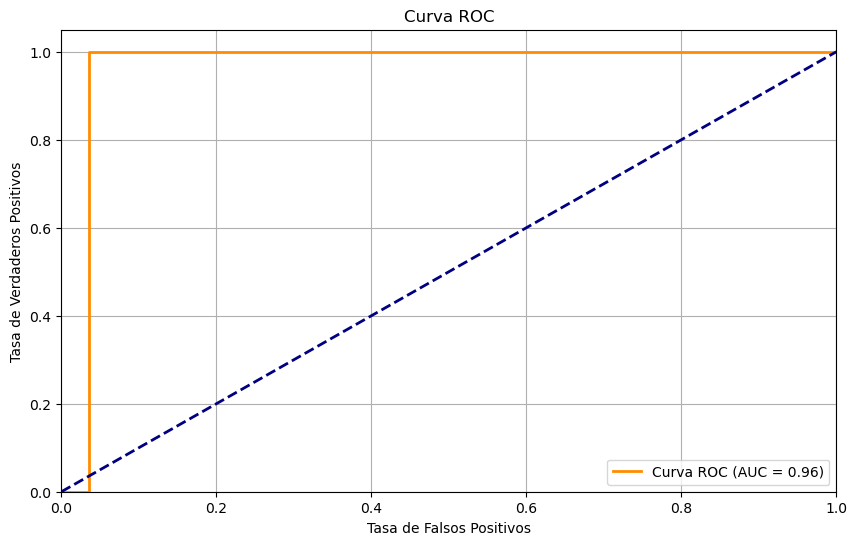

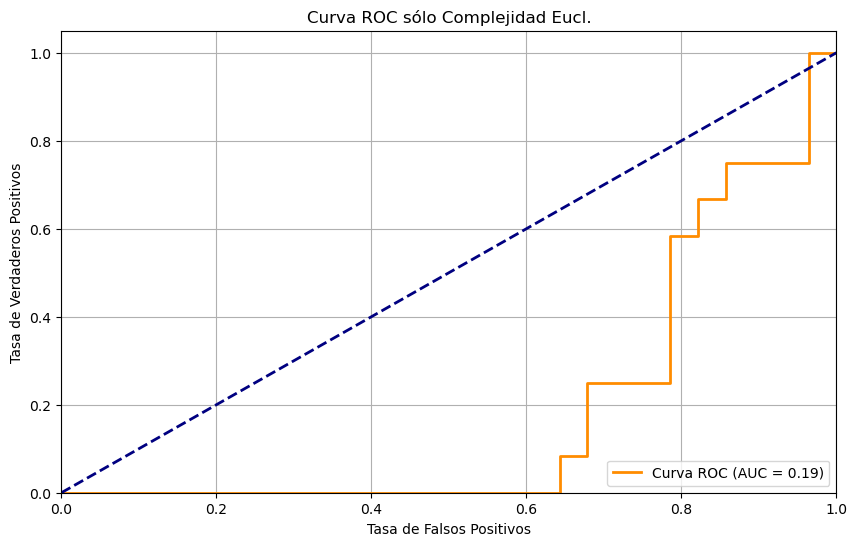

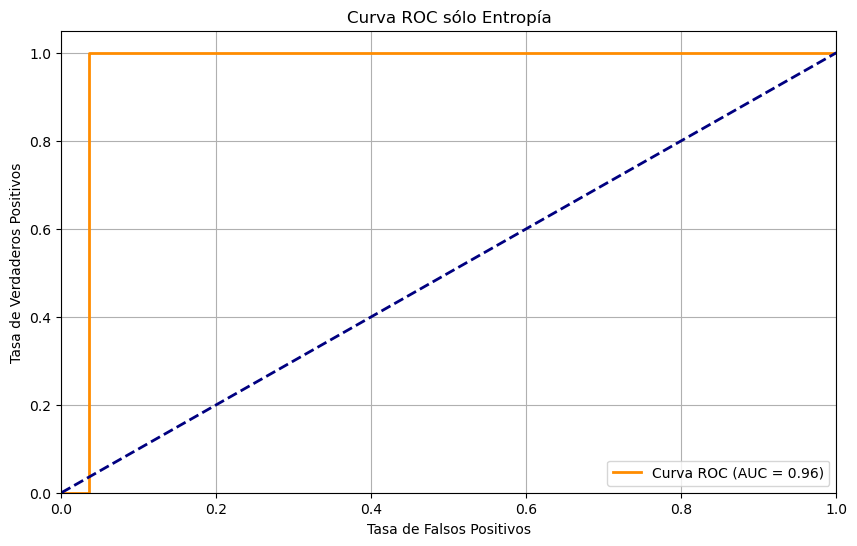

haar
Estadístico: 0.9085087776184082
Valor p: 0.20415277779102325
La muestra parece provenir de una distribución normal (no se rechaza la hipótesis nula)
Estadístico: 0.8431389331817627
Valor p: 0.0006817179382778704
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 272.0
Valor p: 0.0022517370776878806
Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)
---------------------------------------------------------------------------
Confusion Matrix:
TN: 27
FP: 1
FN: 0
TP: 12
Accuracy: 0.975
Precision: 0.9230769230769231
Recall: 1.0
F1-Score: 0.9600000000000001
Tiempo entrenamiento: 0.003393888473510742
Tiempo predicción: 0.0007288455963134766


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


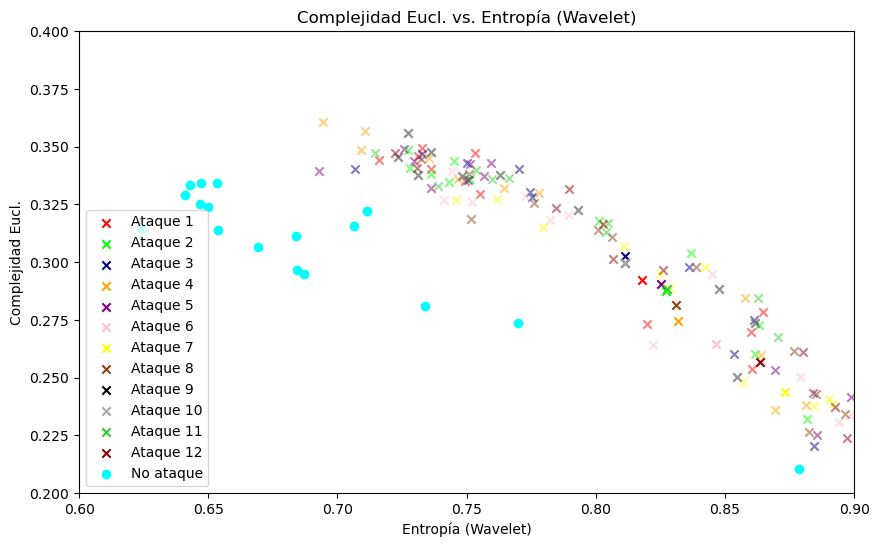

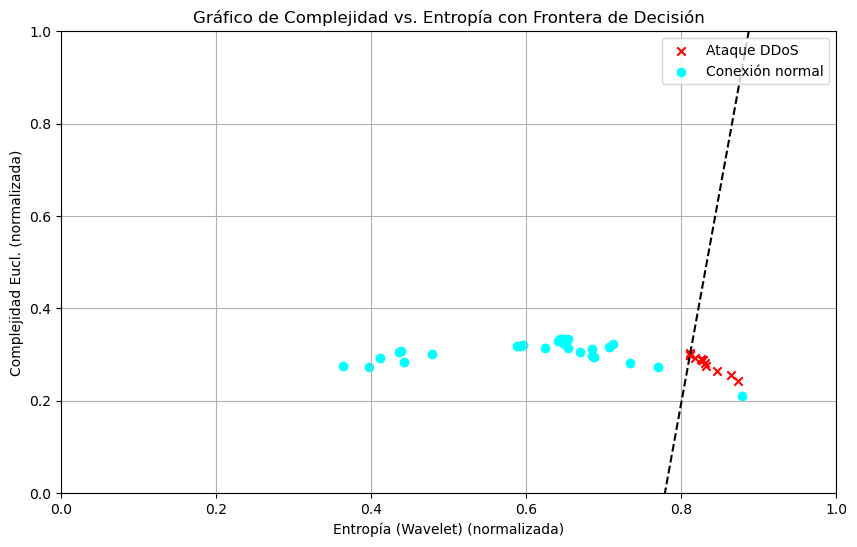

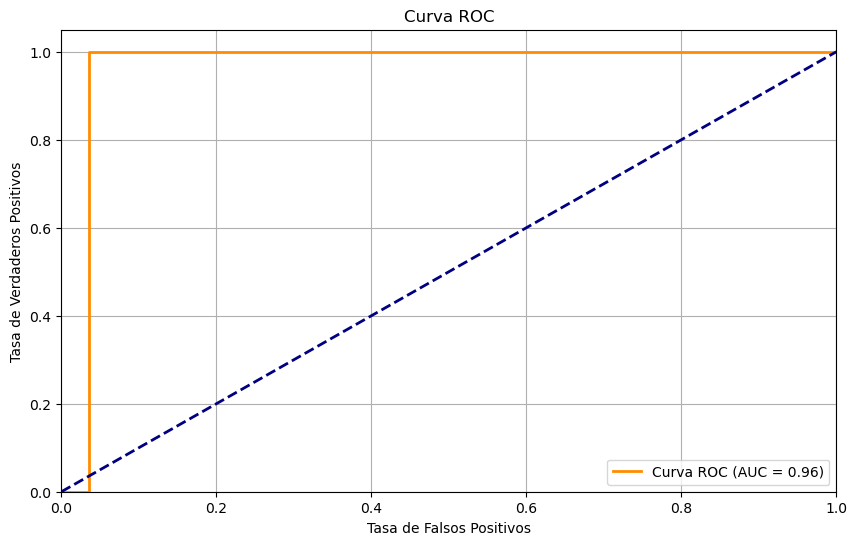

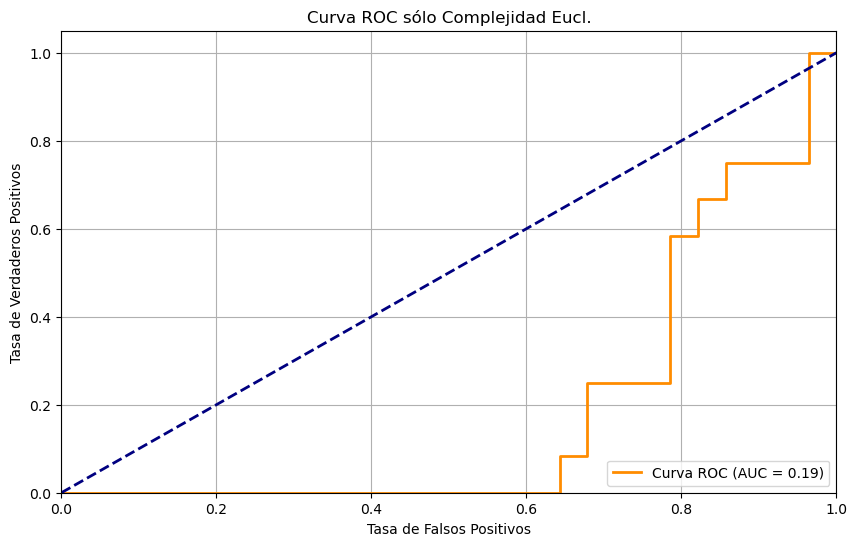

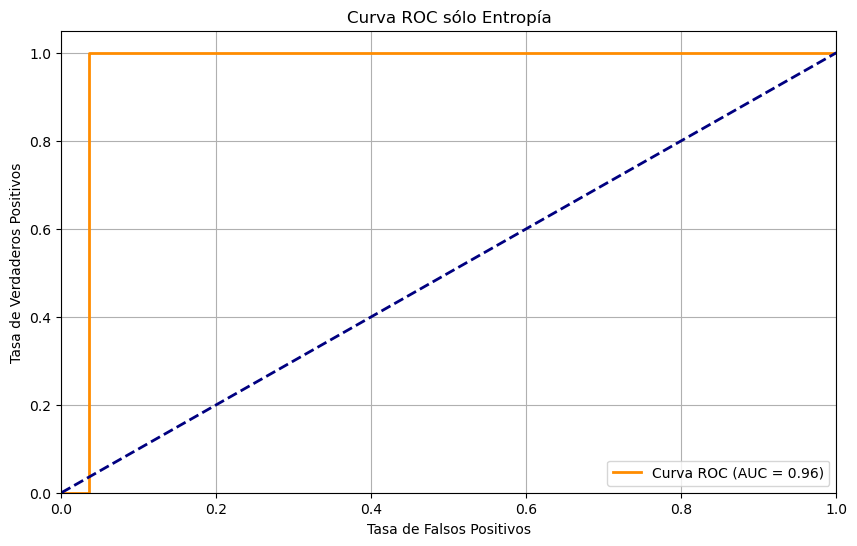

rbio1.1
Estadístico: 0.9085087776184082
Valor p: 0.20415277779102325
La muestra parece provenir de una distribución normal (no se rechaza la hipótesis nula)
Estadístico: 0.8431389331817627
Valor p: 0.0006817179382778704
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 272.0
Valor p: 0.0022517370776878806
Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)
---------------------------------------------------------------------------
Confusion Matrix:
TN: 27
FP: 1
FN: 0
TP: 12
Accuracy: 0.975
Precision: 0.9230769230769231
Recall: 1.0
F1-Score: 0.9600000000000001
Tiempo entrenamiento: 0.002523183822631836
Tiempo predicción: 0.0005931854248046875


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


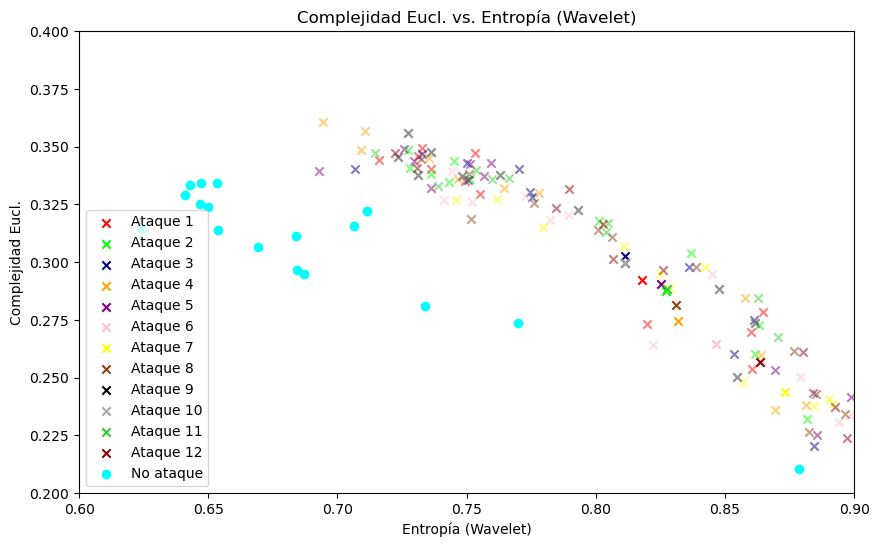

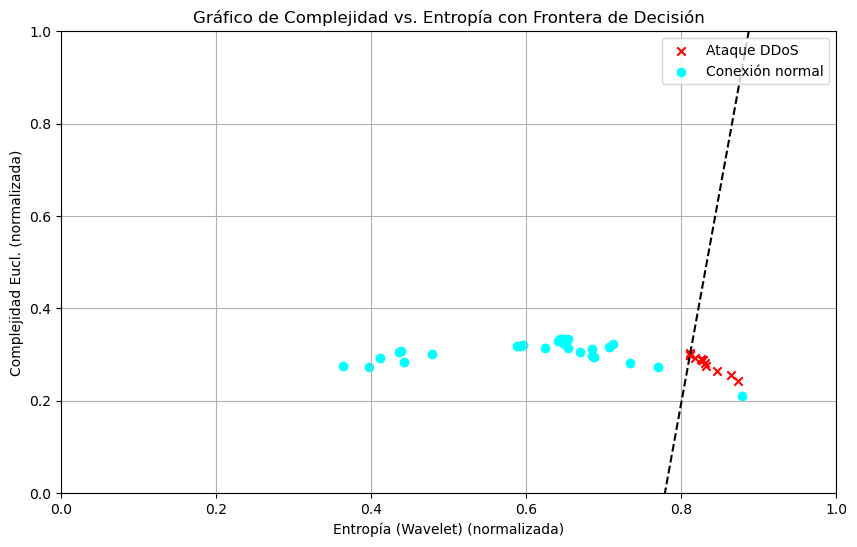

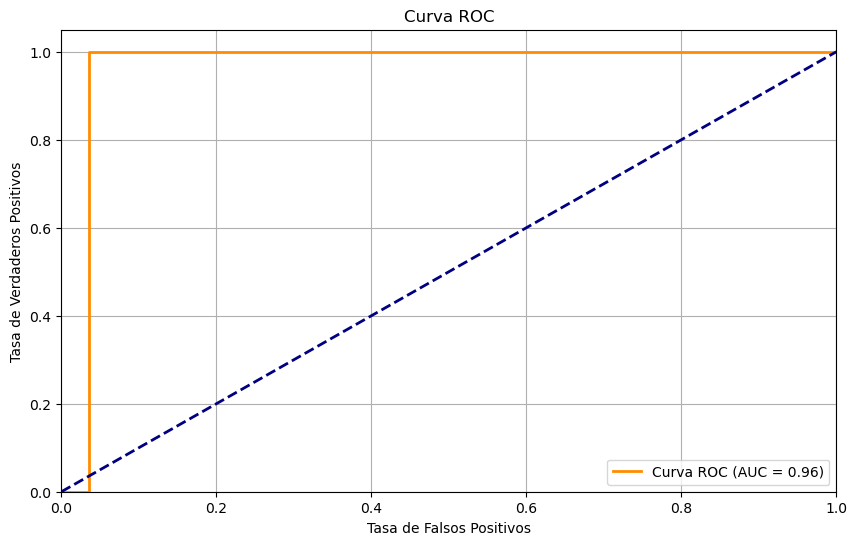

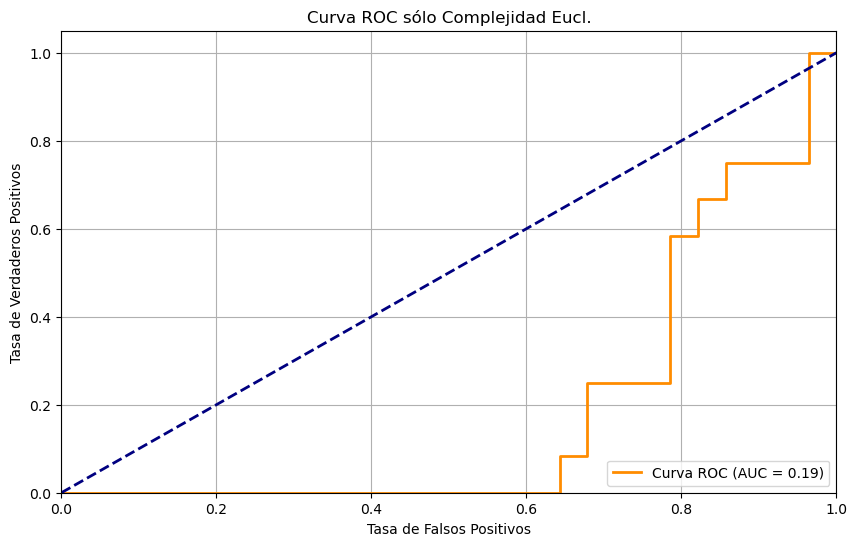

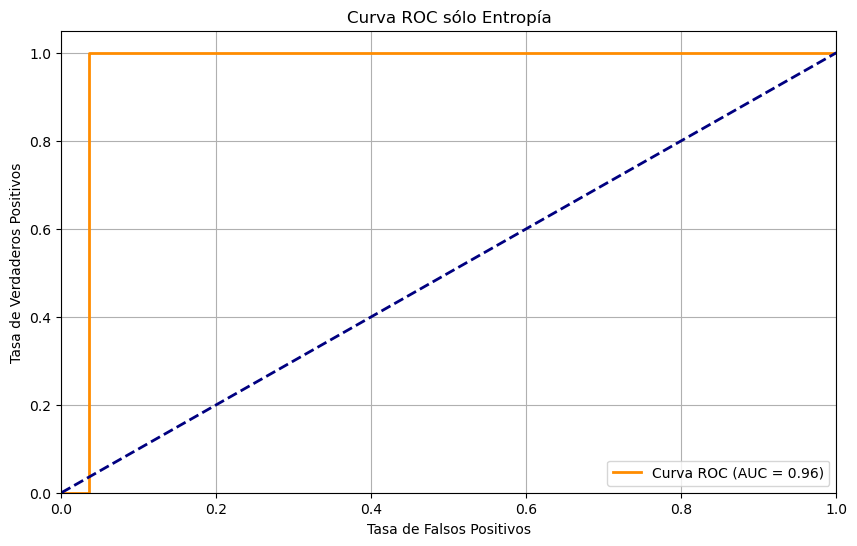

bior1.3
Estadístico: 0.8677985668182373
Valor p: 0.06128581613302231
La muestra parece provenir de una distribución normal (no se rechaza la hipótesis nula)
Estadístico: 0.8932107090950012
Valor p: 0.007962102070450783
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 147.0
Valor p: 0.5451346456478479
No hay diferencias significativas entre las muestras (no se rechaza la hipótesis nula)
---------------------------------------------------------------------------
Confusion Matrix:
TN: 27
FP: 1
FN: 0
TP: 12
Accuracy: 0.975
Precision: 0.9230769230769231
Recall: 1.0
F1-Score: 0.9600000000000001
Tiempo entrenamiento: 0.002471923828125
Tiempo predicción: 0.0005919933319091797


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


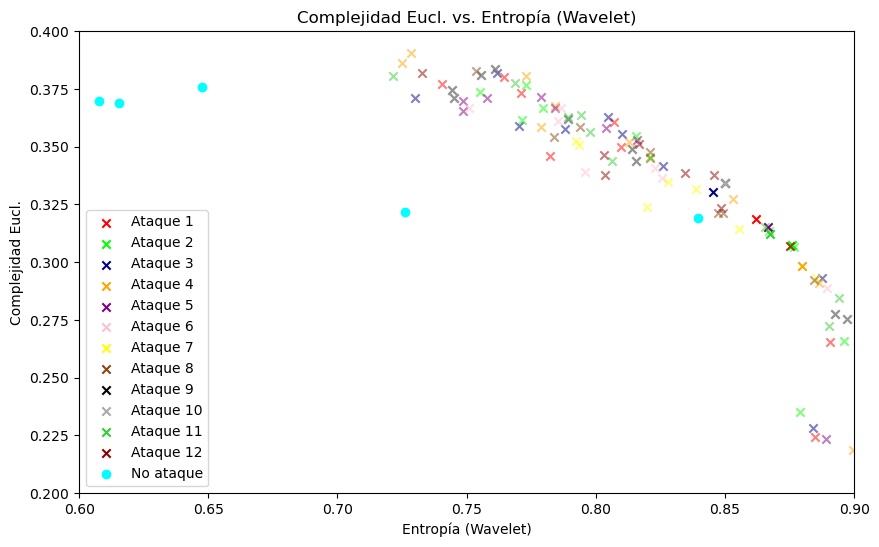

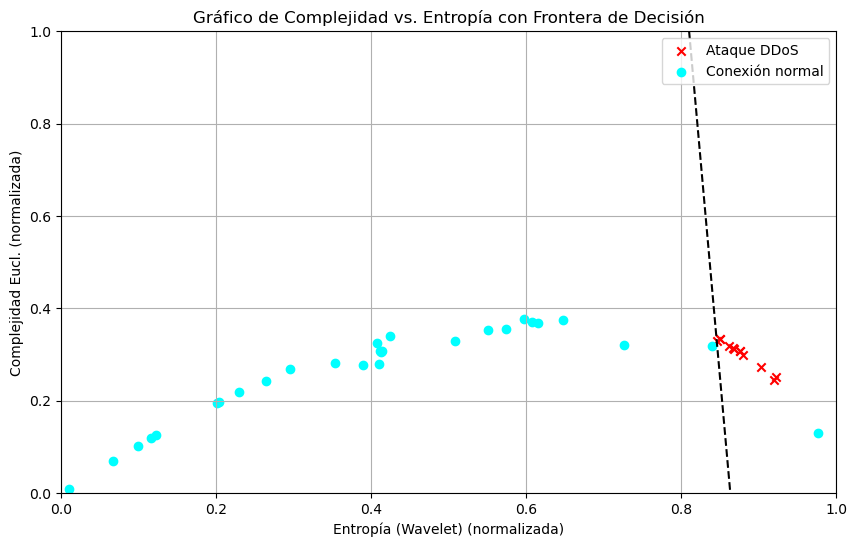

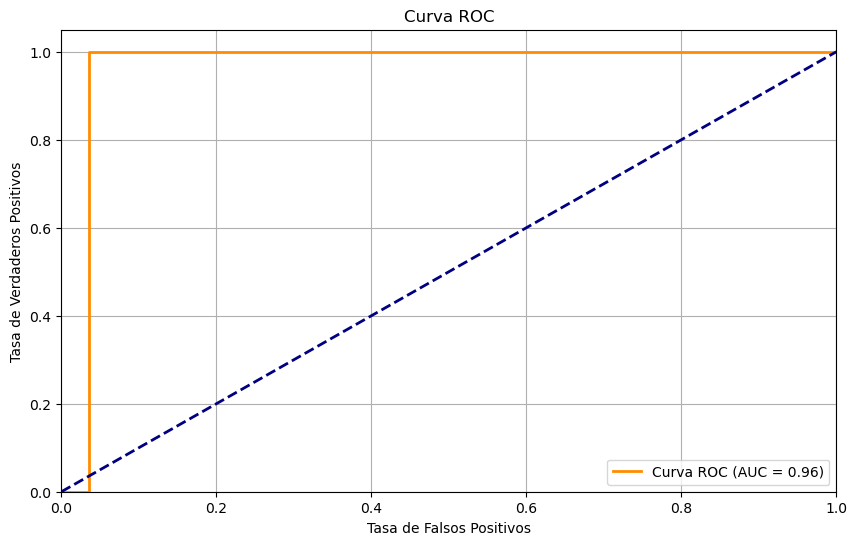

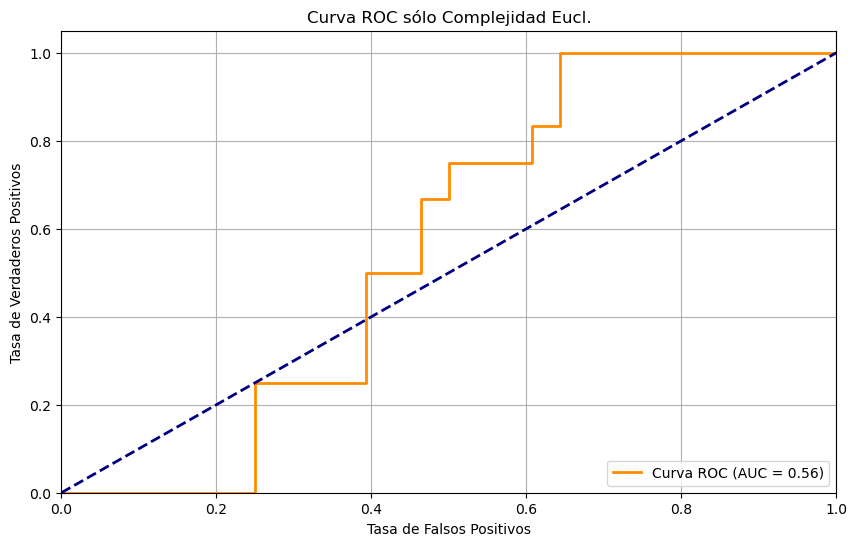

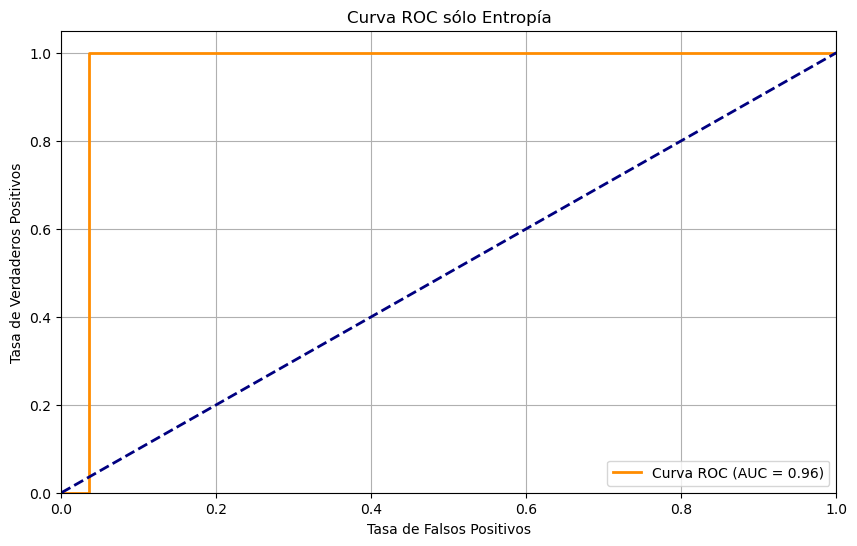

bior1.5
Estadístico: 0.8229656219482422
Valor p: 0.017298316583037376
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.7690434455871582
Valor p: 3.1833980756346136e-05
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 79.0
Valor p: 0.008998333884719358
Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)
---------------------------------------------------------------------------
Confusion Matrix:
TN: 26
FP: 2
FN: 0
TP: 12
Accuracy: 0.95
Precision: 0.8571428571428571
Recall: 1.0
F1-Score: 0.923076923076923
Tiempo entrenamiento: 0.002386808395385742
Tiempo predicción: 0.0005881786346435547


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


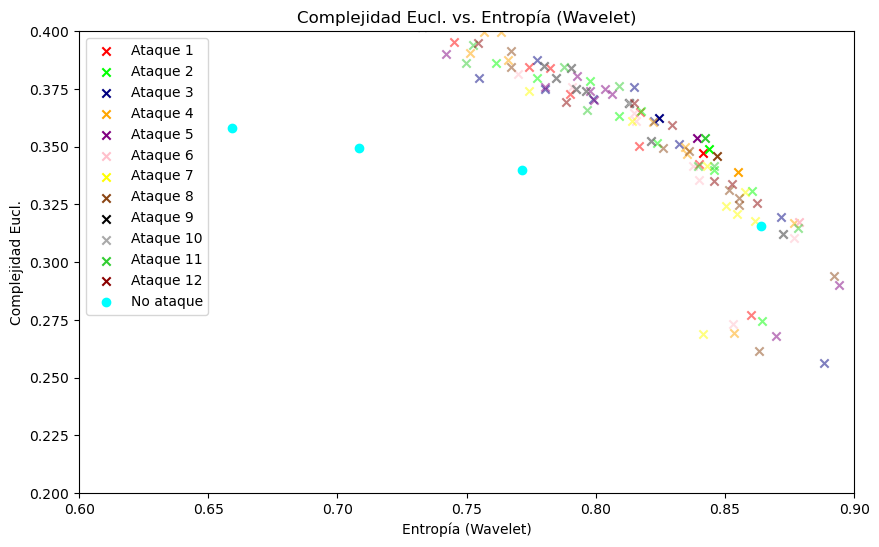

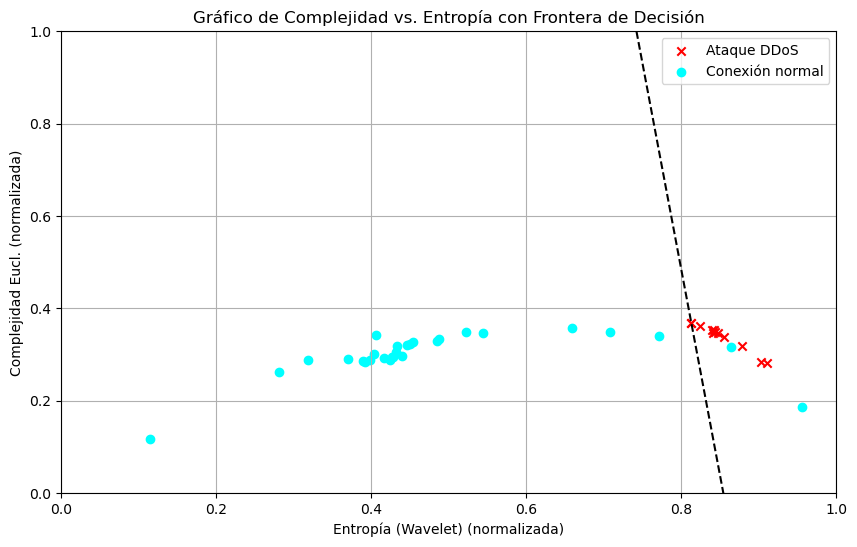

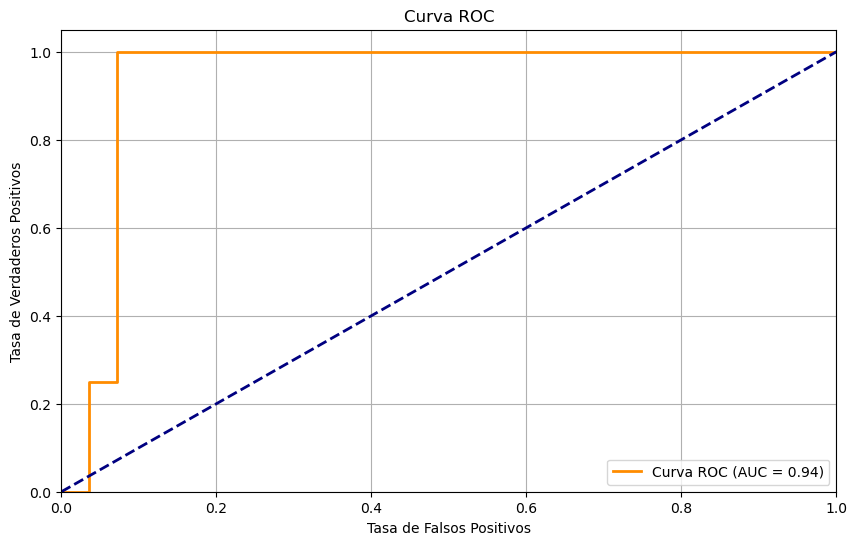

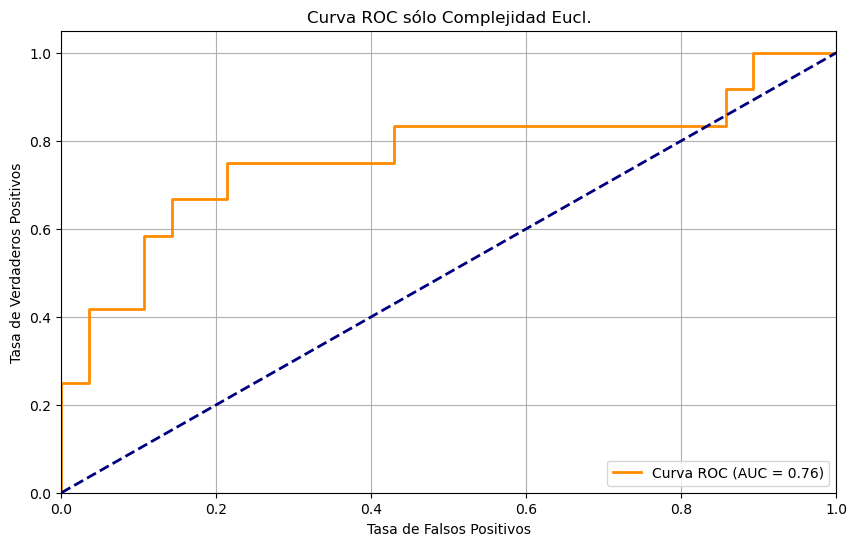

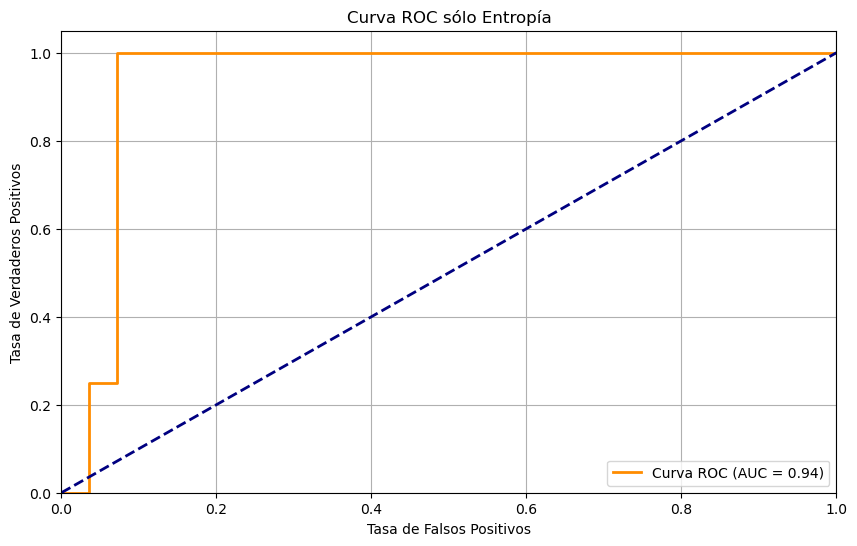

rbio1.3
Estadístico: 0.8990218043327332
Valor p: 0.15407408773899078
La muestra parece provenir de una distribución normal (no se rechaza la hipótesis nula)
Estadístico: 0.6839526891708374
Valor p: 1.7039245676642167e-06
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 40.0
Valor p: 0.00016773949290714113
Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)
---------------------------------------------------------------------------
Confusion Matrix:
TN: 18
FP: 10
FN: 0
TP: 12
Accuracy: 0.75
Precision: 0.5454545454545454
Recall: 1.0
F1-Score: 0.7058823529411764
Tiempo entrenamiento: 0.00410914421081543
Tiempo predicción: 0.001138925552368164


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


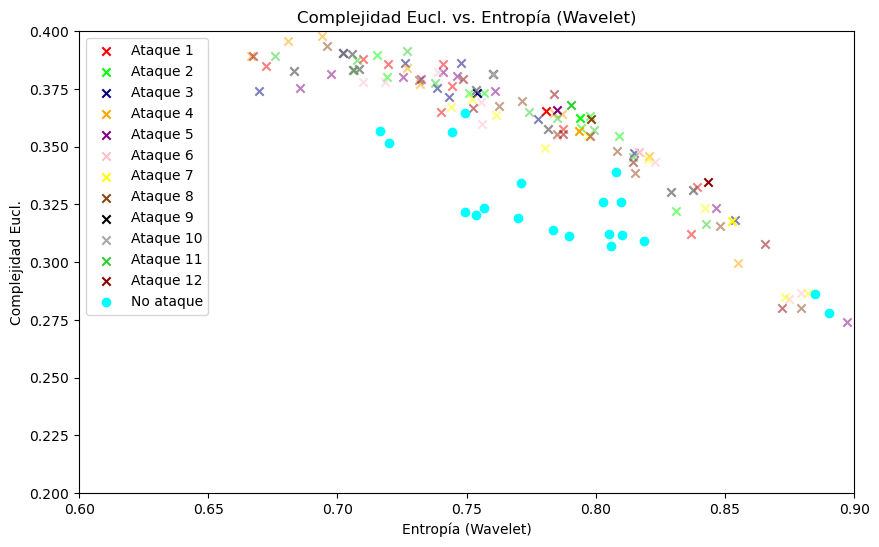

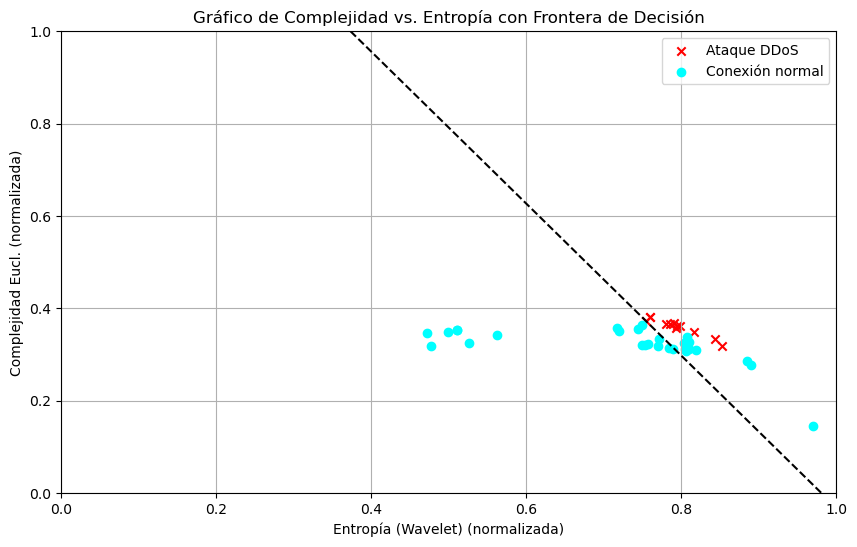

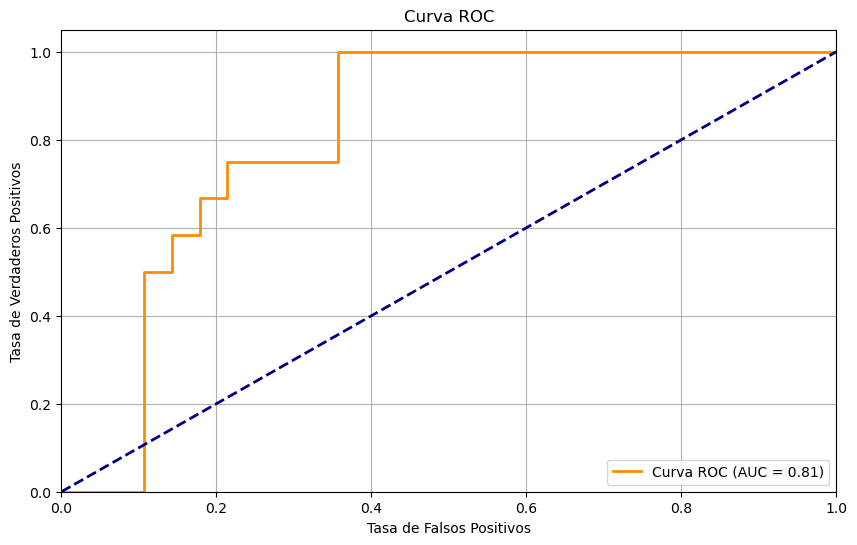

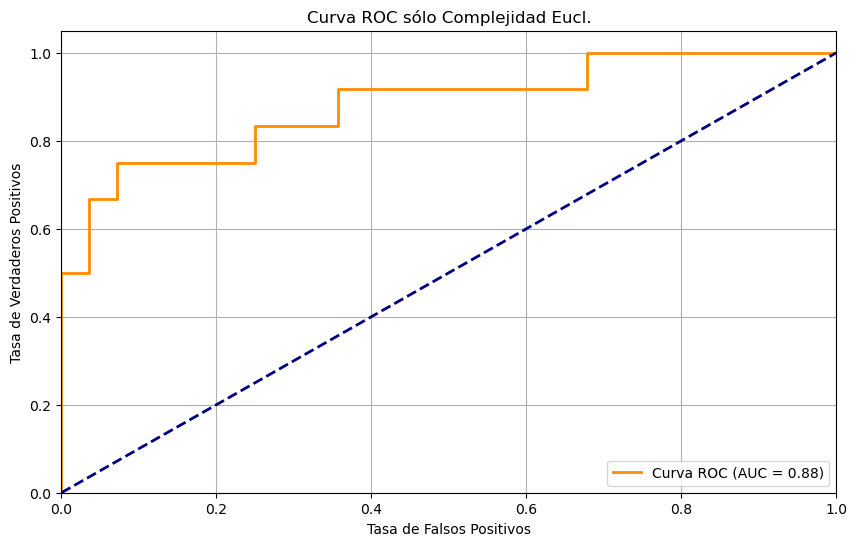

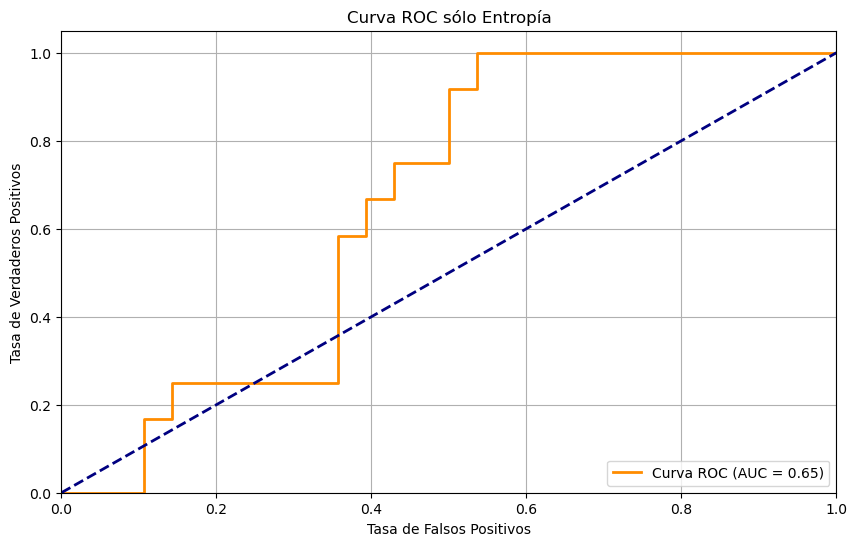

bior2.4
Estadístico: 0.8106884360313416
Valor p: 0.012426107190549374
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.9214876294136047
Valor p: 0.037755947560071945
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 296.0
Valor p: 0.00016773949290714113
Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)
---------------------------------------------------------------------------
Confusion Matrix:
TN: 24
FP: 4
FN: 0
TP: 12
Accuracy: 0.9
Precision: 0.75
Recall: 1.0
F1-Score: 0.8571428571428571
Tiempo entrenamiento: 0.0019500255584716797
Tiempo predicción: 0.0005037784576416016


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


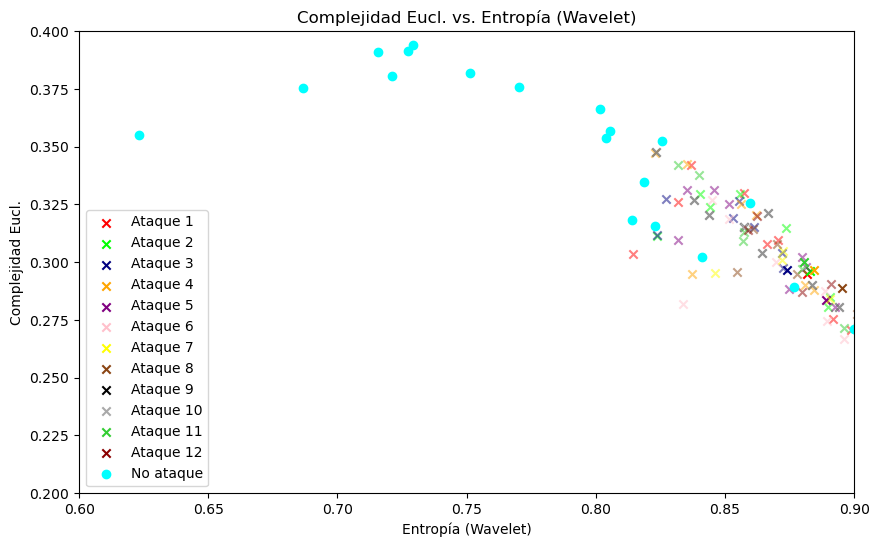

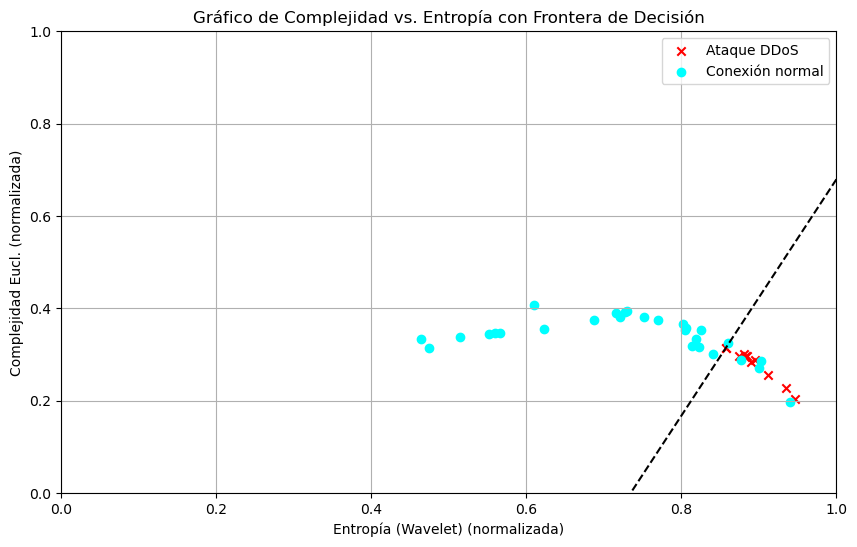

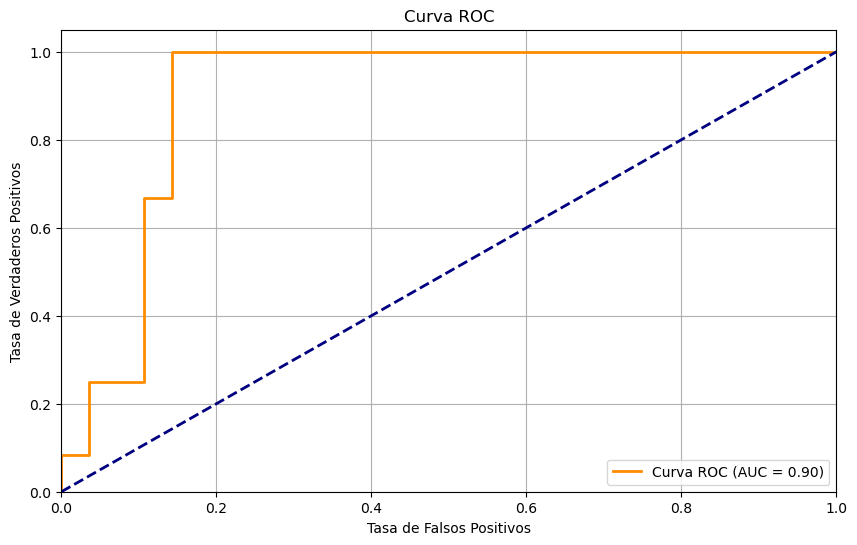

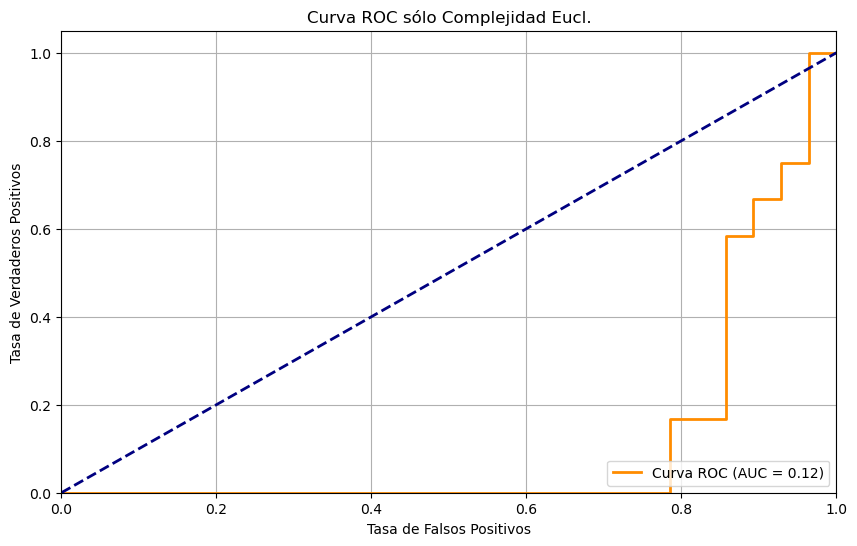

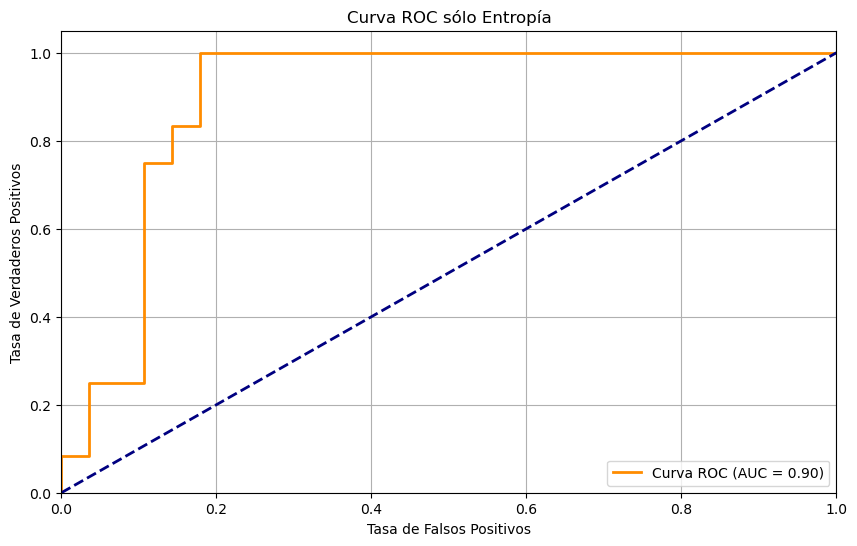

bior2.8
Estadístico: 0.7541038393974304
Valor p: 0.0029504322446882725
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.8867455720901489
Valor p: 0.005676099099218845
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 286.0
Valor p: 0.000524219458292807
Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)
---------------------------------------------------------------------------
Confusion Matrix:
TN: 23
FP: 5
FN: 0
TP: 12
Accuracy: 0.875
Precision: 0.7058823529411765
Recall: 1.0
F1-Score: 0.8275862068965517
Tiempo entrenamiento: 0.0022211074829101562
Tiempo predicción: 0.0006091594696044922


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


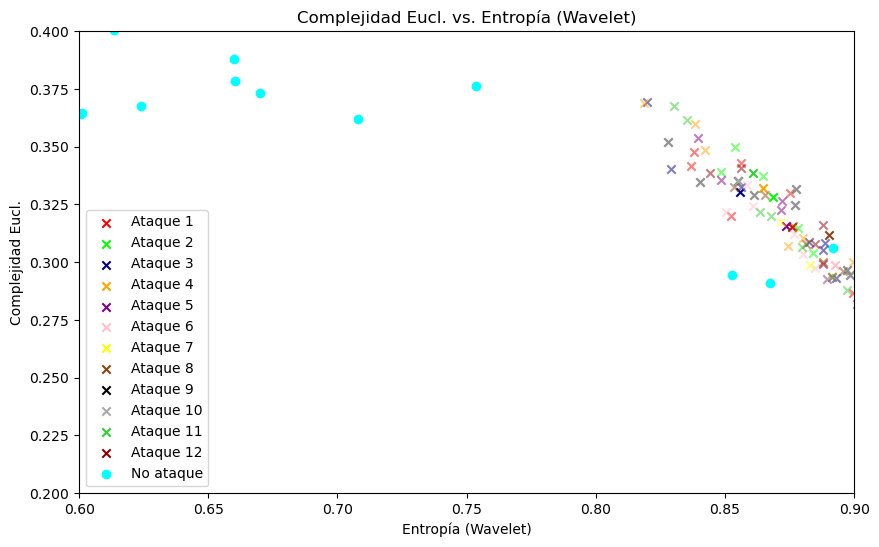

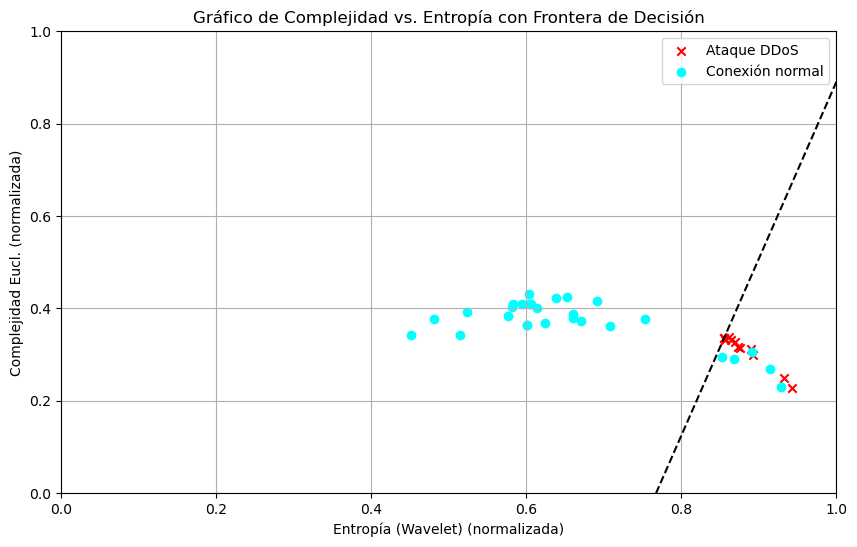

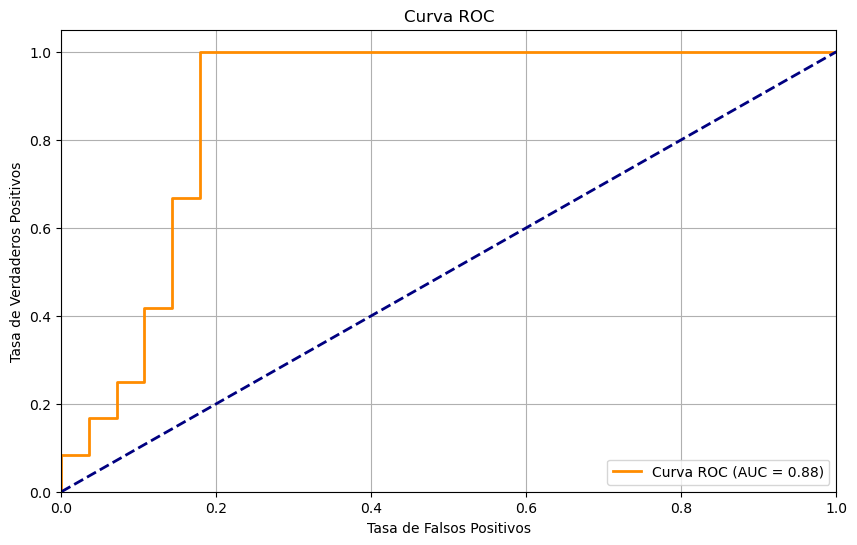

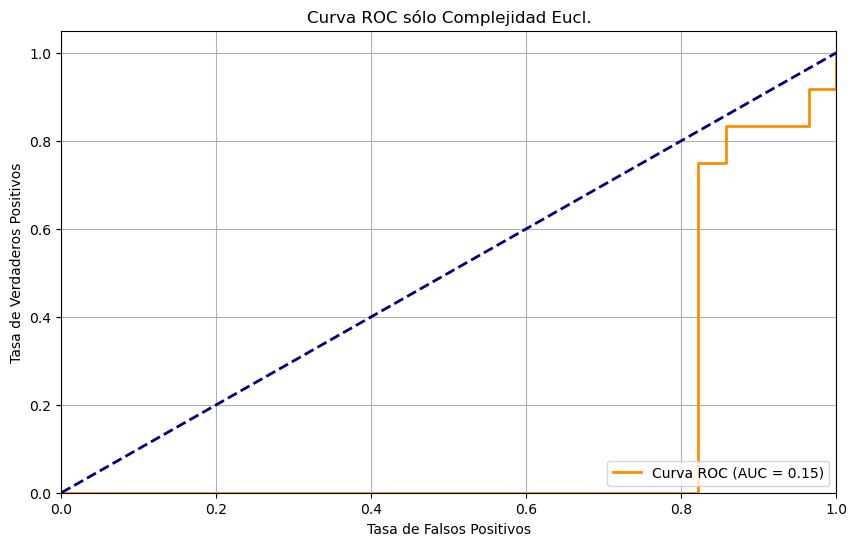

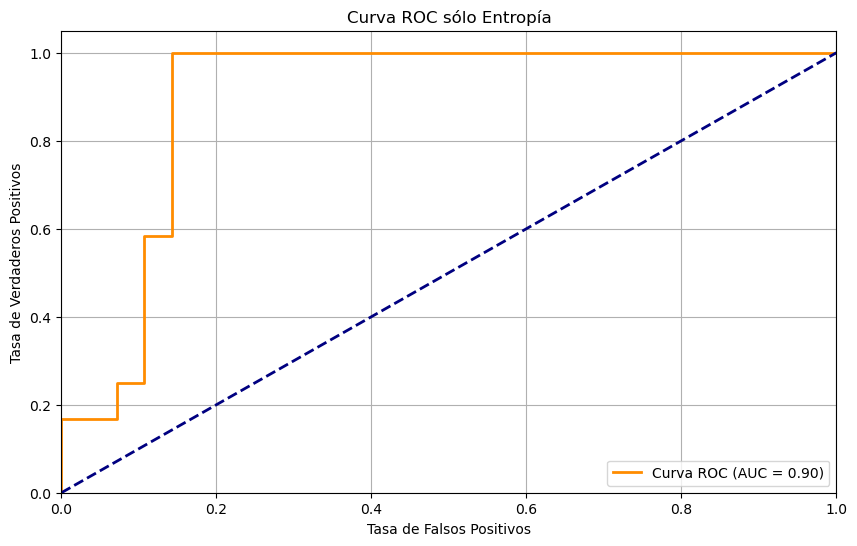

coif2
Estadístico: 0.742284893989563
Valor p: 0.002222589449957013
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.8216912746429443
Valor p: 0.00026399854687042534
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 18.0
Valor p: 1.021554900966436e-05
Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)
---------------------------------------------------------------------------
Confusion Matrix:
TN: 27
FP: 1
FN: 0
TP: 12
Accuracy: 0.975
Precision: 0.9230769230769231
Recall: 1.0
F1-Score: 0.9600000000000001
Tiempo entrenamiento: 0.002131938934326172
Tiempo predicción: 0.0006108283996582031


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


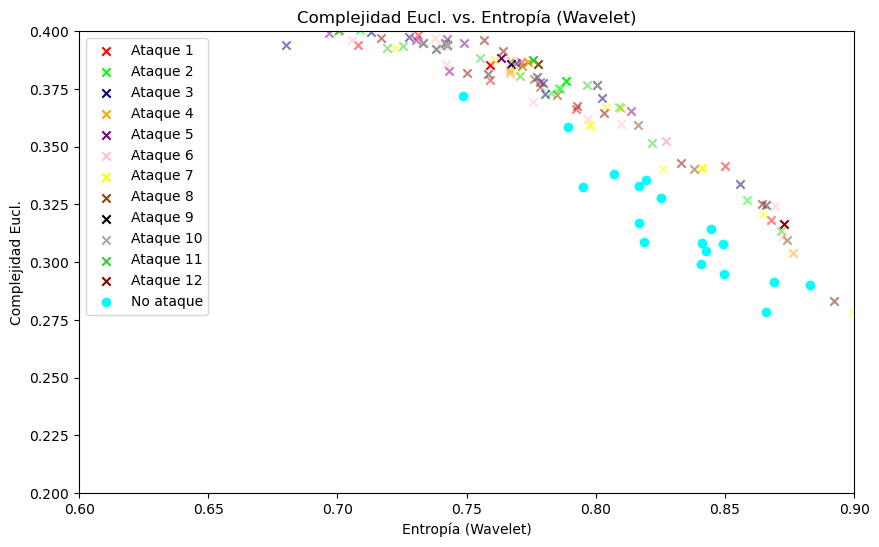

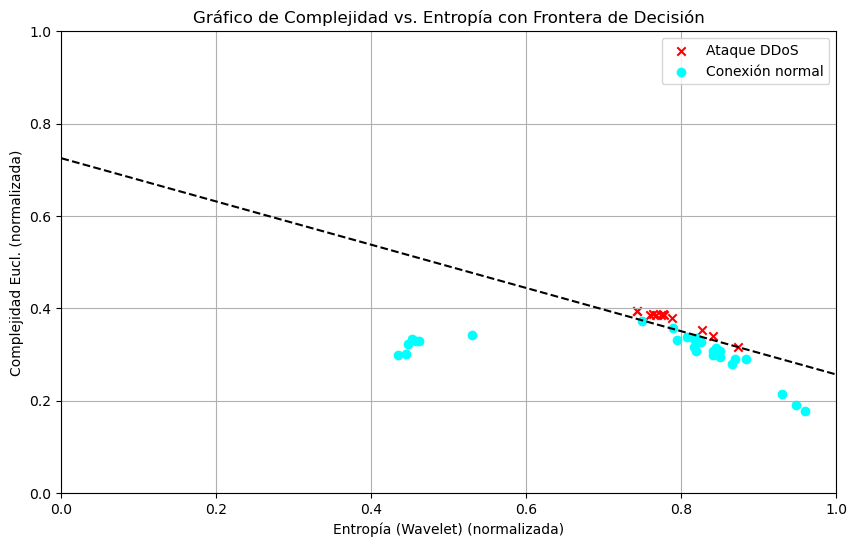

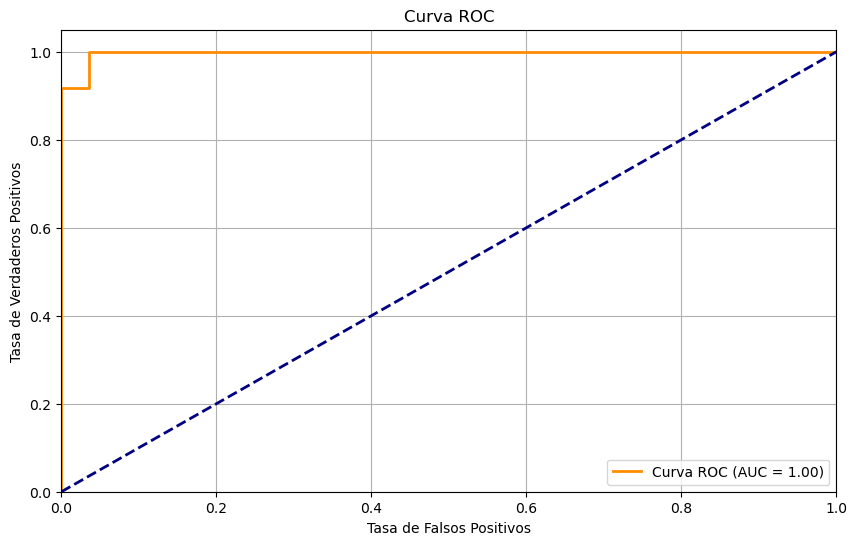

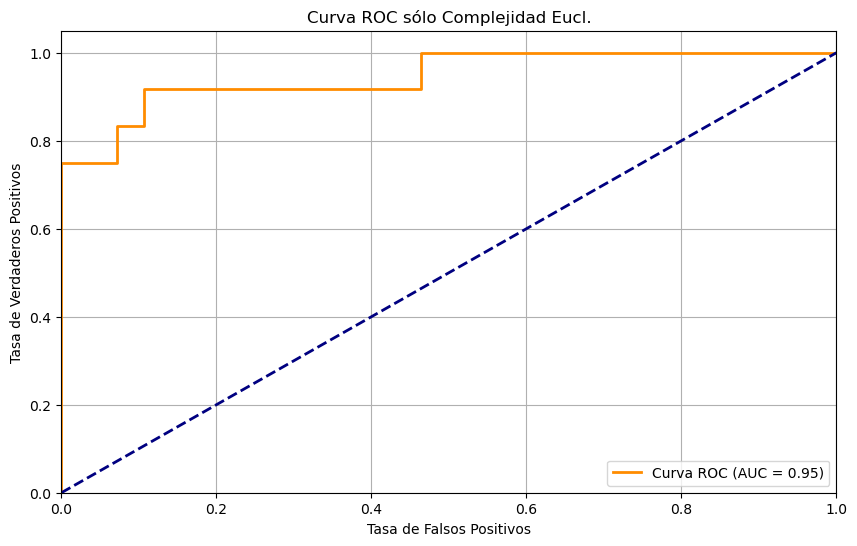

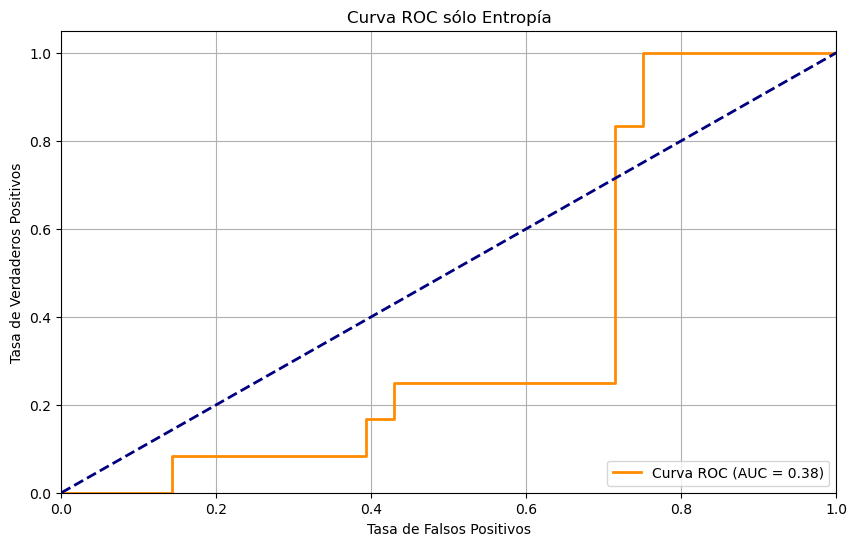

          0         1         2         3
0    family   auc_c_h     auc_c     auc_h
1   bior1.1  0.964286  0.190476  0.964286
2       db1  0.964286  0.190476  0.964286
3      haar  0.964286  0.190476  0.964286
4   rbio1.1  0.964286  0.190476  0.964286
5   bior1.3  0.964286    0.5625  0.964286
6   bior1.5    0.9375  0.764881    0.9375
7   rbio1.3    0.8125  0.880952  0.654762
8   bior2.4  0.901786  0.119048   0.89881
9   bior2.8  0.877976   0.14881   0.89881
10    coif2  0.997024  0.946429  0.377976


In [624]:
eucl_sin_reps = [["family","auc_c_h","auc_c","auc_h"]]
for i in range(10):
    print(ranked_wavelets[i][0])
    fila = []
    fila.append(ranked_wavelets[i][0])
    df = calculate_desequilibrium_and_complexity(file_paths,ranked_wavelets[i][0])

    plot_complexity_entropy(df,'Complejidad Eucl.')
    
    # Realizar la prueba de Shapiro-Wilk
    stat, p_value = shapiro(df['Complejidad Eucl.'].iloc[inicio_ataques])

    # Imprimir los resultados
    print('Estadístico:', stat)
    print('Valor p:', p_value)

    # Evaluar la normalidad
    alpha = 0.05
    if p_value > alpha:
        print('La muestra parece provenir de una distribución normal (no se rechaza la hipótesis nula)')
    else:
        print('La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)')

    # Realizar la prueba de Shapiro-Wilk
    stat, p_value = shapiro(df['Complejidad Eucl.'][sum(reps):])

    print('Estadístico:', stat)
    print('Valor p:', p_value)

    # Evaluar la normalidad
    alpha = 0.05
    if p_value > alpha:
        print('La muestra parece provenir de una distribución normal (no se rechaza la hipótesis nula)')
    else:
        print('La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)')

    stat, p_value = mannwhitneyu(df['Complejidad Eucl.'][sum(reps):], df['Complejidad Eucl.'].iloc[inicio_ataques])

    # Imprimir los resultados
    print('Estadístico:', stat)
    print('Valor p:', p_value)

    # Evaluar la significancia
    alpha = 0.05
    if p_value > alpha:
        print('No hay diferencias significativas entre las muestras (no se rechaza la hipótesis nula)')
    else:
        print('Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)')
    print("---------------------------------------------------------------------------")
    df['Clasificación'] = [1]*sum(reps)+[0]*(len(df)-sum(reps))
    df2 = df.iloc[inicio_ataques]
    df3 = df.iloc[sum(reps):]
    # Separar características y etiquetas
    X = pd.concat([df2,df3])[['Entropía (Wavelet)', 'Complejidad Eucl.']]  
    y = pd.concat([df2,df3])['Clasificación']

    # Entrenar el modelo de regresión logística
    model = LogisticRegression()
    process = psutil.Process()
    start_cpu_train = process.cpu_percent(interval=None)
    start_train = time.time()
    model.fit(X, y)
    end_train = time.time()
    end_cpu_train = process.cpu_percent(interval=None)
    cpu_usage_train = end_cpu_train - start_cpu_train
    training_time = end_train - start_train
    """
    # Generar una malla de puntos para graficar la frontera de decisión
    xx, yy = np.mgrid[0:1:.01, 0:1:.01]
    grid = np.c_[xx.ravel(), yy.ravel()]
    probs = model.predict_proba(grid)[:, 1].reshape(xx.shape)
    """
    # Definir x_min, x_max, y_min, y_max en base a los datos normalizados
    x_min, x_max = X['Entropía (Wavelet)'].min() - 0.1, X['Entropía (Wavelet)'].max() + 0.1
    y_min, y_max = X['Complejidad Eucl.'].min() - 0.1, X['Complejidad Eucl.'].max() + 0.1

    # Asegurarse de que los límites estén dentro del rango 0-1
    x_min, x_max = max(0, x_min), min(1, x_max)
    y_min, y_max = max(0, y_min), min(1, y_max)

    xx, yy = np.meshgrid(np.linspace(0, 1, 100), np.linspace(0, 1, 100))
    start_cpu = process.cpu_percent(interval=None)
    start_pred = time.time()
    y_pred_prob = model.predict_proba(X)[:, 1]
    end_pred = time.time()
    end_cpu = process.cpu_percent(interval=None)
    prediction_time = end_pred - start_pred
    cpu_usage = end_cpu - start_cpu
    
    #print(y_pred_prob)

    # Calcular la curva ROC y el AUC
    fpr, tpr, thresholds = roc_curve(y, y_pred_prob)
    roc_auc = roc_auc_score(y, y_pred_prob)
    fila.append(roc_auc)

    f1_scores = [f1_score(y, (y_pred_prob >= thresh).astype(int)) for thresh in thresholds]

    # Encontrar el umbral que maximiza el F1-Score
    optimal_threshold = thresholds[np.argmax(f1_scores)]

    # Predecir con el modelo
    Z = model.predict_proba(np.c_[xx.ravel(), yy.ravel()])[:, 1]
    Z = Z.reshape(xx.shape)

    # Graficar los puntos y la frontera de decisión
        # Predecir etiquetas binarias usando el umbral óptimo
    y_pred_optimal = (y_pred_prob >= optimal_threshold).astype(int)

    # Calcular la matriz de confusión
    tn, fp, fn, tp = confusion_matrix(y, y_pred_optimal).ravel()

    print("Confusion Matrix:")
    print("TN:", tn)
    print("FP:", fp)
    print("FN:", fn)
    print("TP:", tp)

    # Opcional: Calcular otras métricas de evaluación
    accuracy = (tp + tn) / (tp + tn + fp + fn)
    precision = tp / (tp + fp)
    recall = tp / (tp + fn)
    f1 = 2 * (precision * recall) / (precision + recall)

    print("Accuracy:", accuracy)
    print("Precision:", precision)
    print("Recall:", recall)
    print("F1-Score:", f1)
    print("Tiempo entrenamiento:",training_time)
    print("Tiempo predicción:",prediction_time)
    #print("% uso CPU entrenamiento:",cpu_usage_train)
    #print("% uso CPU predicción:",cpu_usage)
    
    
    # Graficar los puntos y la frontera de decisión
    plt.figure(figsize=(10, 6))
    plt.scatter(X[y == 1]['Entropía (Wavelet)'], X[y == 1]['Complejidad Eucl.'], marker='x', label='Ataque DDoS', c="Red")
    plt.scatter(X[y == 0]['Entropía (Wavelet)'], X[y == 0]['Complejidad Eucl.'], marker='o', label='Conexión normal', c="Cyan")

    # Contorno de la frontera de decisión
    #plt.contour(xx, yy, probs, levels=[0.5], cmap="Greys", vmin=0, vmax=1)

    plt.contour(xx, yy, Z, levels=[optimal_threshold], colors='black', linestyles='--')
    plt.xlabel('Entropía (Wavelet) (normalizada)')
    plt.ylabel('Complejidad Eucl. (normalizada)')
    plt.title('Gráfico de Complejidad vs. Entropía con Frontera de Decisión')
    plt.legend()
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.0])
    plt.grid(True)
    plt.show()
    
    # Predecir las probabilidades de la clase positiva
    y_pred_prob = model.predict_proba(X)[:, 1]
    #print(y_pred_prob)

    # Calcular la curva ROC y el AUC
    fpr, tpr, thresholds = roc_curve(y, y_pred_prob)
    roc_auc = roc_auc_score(y, y_pred_prob)


    # Graficar la curva ROC
    plt.figure(figsize=(10, 6))
    plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'Curva ROC (AUC = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('Tasa de Falsos Positivos')
    plt.ylabel('Tasa de Verdaderos Positivos')
    plt.title('Curva ROC')
    plt.legend(loc="lower right")
    plt.grid(True)
    plt.show()
    
    # Calcular la curva ROC y el AUC para sólo complejidad
    fpr, tpr, thresholds = roc_curve(y, X["Complejidad Eucl."])
    roc_auc = roc_auc_score(y, X["Complejidad Eucl."])
    fila.append(roc_auc)


    # Graficar la curva ROC
    plt.figure(figsize=(10, 6))
    plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'Curva ROC (AUC = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('Tasa de Falsos Positivos')
    plt.ylabel('Tasa de Verdaderos Positivos')
    plt.title('Curva ROC sólo Complejidad Eucl.')
    plt.legend(loc="lower right")
    plt.grid(True)
    plt.show()
    
    # Calcular la curva ROC y el AUC para sólo Entropía
    fpr, tpr, thresholds = roc_curve(y, X['Entropía (Wavelet)'])
    roc_auc = roc_auc_score(y, X['Entropía (Wavelet)'])
    fila.append(roc_auc)


    # Graficar la curva ROC
    plt.figure(figsize=(10, 6))
    plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'Curva ROC (AUC = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('Tasa de Falsos Positivos')
    plt.ylabel('Tasa de Verdaderos Positivos')
    plt.title('Curva ROC sólo Entropía')
    plt.legend(loc="lower right")
    plt.grid(True)
    plt.show()
    eucl_sin_reps.append(fila)
print(pd.DataFrame(eucl_sin_reps))

In [632]:
print("coif2")

df_coif2_sr = calculate_desequilibrium_and_complexity(file_paths,"coif2")

sujetos_ataque = []
sujetos_normales = []
for i in range(1,13):
    sujetos_ataque.append(f"details_maligno_{i}")
for i in range(1,29):
    sujetos_normales.append(f"details_benigno_{i}")
    
normales_coif2_sr = df_coif2_sr[-28:]
normales_coif2_sr["Conexión"] = sujetos_normales
ataques_coif2_sr = df_coif2_sr.iloc[inicio_ataques]
ataques_coif2_sr["Conexión"]= sujetos_ataque


ataques_coif2_sr.to_csv('ataques_coif2.csv', index=False)

print(ataques_coif2_sr)
normales_coif2_sr.to_csv('normales_coif2.csv', index=False)

print(normales_coif2_sr)

print("NORMALES")
print(normales_coif2_sr.describe())

print("ATAQUES")
print(ataques_coif2_sr.describe())


coif2
     Entropía (Wavelet)  Desequilibrio (Eucl.)  Desequilibrio (Wootters)  \
0              0.758971               0.507626                  0.402364   
12             0.788467               0.479885                  0.373606   
24             0.767209               0.502911                  0.393732   
36             0.773753               0.499832                  0.385175   
48             0.763343               0.508571                  0.396486   
60             0.827038               0.426231                  0.338454   
72             0.841135               0.405028                  0.324695   
84             0.777719               0.495987                  0.381858   
96             0.742572               0.530922                  0.414646   
107            0.742572               0.530922                  0.414646   
118            0.775719               0.499570                  0.382302   
128            0.872982               0.362394                  0.288149   

     

/var/folders/t6/_6720_rx5cvf7sc1r110_6f80000gn/T/ipykernel_46436/573884709.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  normales_coif2_sr["Conexión"] = sujetos_normales
/var/folders/t6/_6720_rx5cvf7sc1r110_6f80000gn/T/ipykernel_46436/573884709.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ataques_coif2_sr["Conexión"]= sujetos_ataque


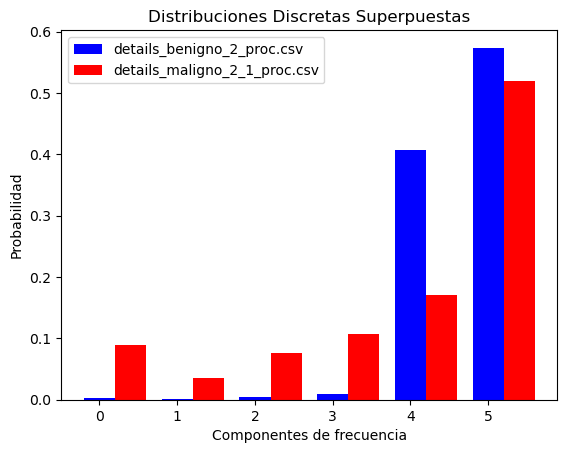

[['details_maligno_1_1_proc.csv', array([0.08552804, 0.03224206, 0.06730068, 0.07807668, 0.20235683,
       0.53449571])], ['details_maligno_1_2_proc.csv', array([0.13110842, 0.06131657, 0.08001716, 0.09984796, 0.16468951,
       0.46302038])], ['details_maligno_1_3_proc.csv', array([0.03767777, 0.04527132, 0.04996204, 0.07616356, 0.22639507,
       0.56453024])], ['details_maligno_1_4_proc.csv', array([0.08456256, 0.03444206, 0.04470398, 0.09092536, 0.17735031,
       0.56801573])], ['details_maligno_1_5_proc.csv', array([0.06438461, 0.04706539, 0.05116512, 0.06714233, 0.16736142,
       0.60288112])], ['details_maligno_1_6_proc.csv', array([0.11398887, 0.04250674, 0.04609817, 0.09355372, 0.20767656,
       0.49617595])], ['details_maligno_1_7_proc.csv', array([0.04277793, 0.04135747, 0.05505682, 0.0718396 , 0.16888372,
       0.62008444])], ['details_maligno_1_8_proc.csv', array([0.08245833, 0.03475733, 0.04716496, 0.09099345, 0.22418868,
       0.52043724])], ['details_maligno_1_9_p

In [645]:
j = 0 
todo = []
for i in file_paths:
    sujeto = pd.read_csv(i)
    archivo = i.split("/")
    archivo = archivo[len(archivo)-1]
    #print(archivo)
    usar = sujeto["Packet Count"]
    if len(usar)>1024:
        usar = truncate_to_1024(sujeto["Packet Count"])
    #print(len(usar))
    a,b,c,d = calculate_wavelet_entropy(usar,"coif2")
    #print(d)
    j=j+1
    todo.append([archivo,d])
#print(todo[139])


indices = np.arange(len(todo[0][1]))
ancho = 0.4

# Graficar la primera distribución
plt.bar(indices, todo[140][1] , width=ancho, color='blue', label=todo[140][0])

# Graficar la segunda distribución, desplazada ligeramente
plt.bar(indices + ancho, todo[12][1], width=ancho, color='red', label=todo[12][0])

# Añadir etiquetas y título
plt.xlabel('Componentes de frecuencia')
plt.ylabel('Probabilidad')
plt.title('Distribuciones Discretas Superpuestas')

# Añadir etiquetas a los ejes x
#plt.xticks(indices + ancho / 2, resultados)

# Mostrar la leyenda
plt.legend()

# Mostrar el gráfico
plt.show()
    
print(todo)

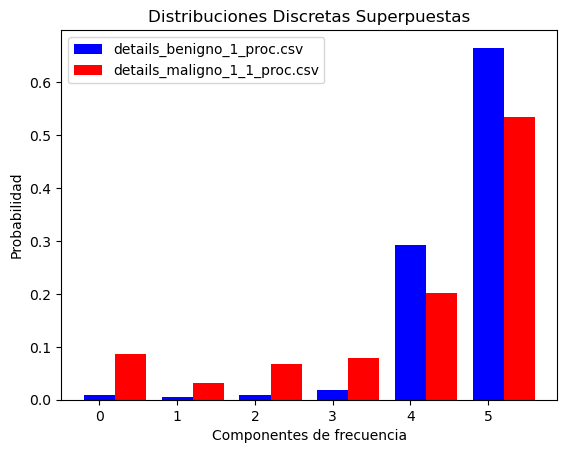

In [596]:
# Graficar la primera distribución
plt.bar(indices, todo[139][1] , width=ancho, color='blue', label=todo[139][0])

# Graficar la segunda distribución, desplazada ligeramente
plt.bar(indices + ancho, todo[0][1], width=ancho, color='red', label=todo[0][0])

# Añadir etiquetas y título
plt.xlabel('Componentes de frecuencia')
plt.ylabel('Probabilidad')
plt.title('Distribuciones Discretas Superpuestas')

# Añadir etiquetas a los ejes x
#plt.xticks(indices + ancho / 2, resultados)

# Mostrar la leyenda
plt.legend()

# Mostrar el gráfico
plt.show()

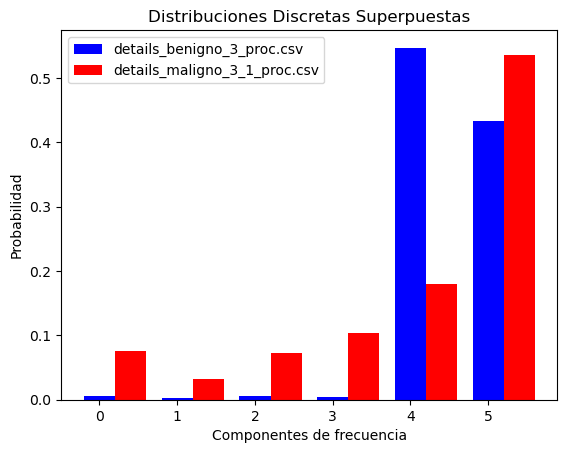

In [601]:
# Graficar la primera distribución
plt.bar(indices, todo[141][1] , width=ancho, color='blue', label=todo[141][0])

# Graficar la segunda distribución, desplazada ligeramente
plt.bar(indices + ancho, todo[24][1], width=ancho, color='red', label=todo[24][0])

# Añadir etiquetas y título
plt.xlabel('Componentes de frecuencia')
plt.ylabel('Probabilidad')
plt.title('Distribuciones Discretas Superpuestas')

# Añadir etiquetas a los ejes x
#plt.xticks(indices + ancho / 2, resultados)

# Mostrar la leyenda
plt.legend()

# Mostrar el gráfico
plt.show()

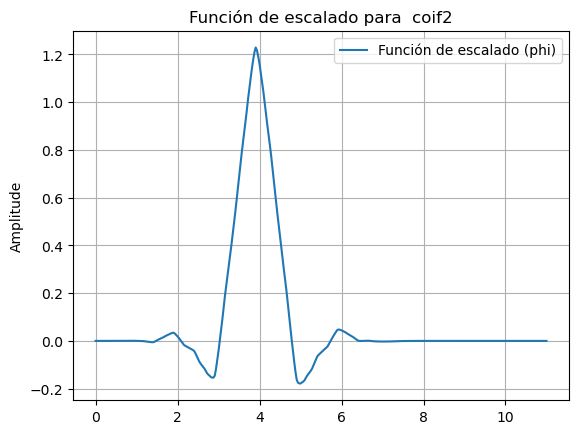

In [602]:
# Crear la wavelet coif2
wavelet = pywt.Wavelet('coif2')

# Obtener los coeficientes de la función de escalamiento
functions = wavelet.wavefun(level=5)
phi, psi, x = functions[0], functions[1], functions[-1]

# Graficar la función de escalamiento
plt.plot(x, phi, label='Función de escalado (phi)')
plt.title('Función de escalado para  coif2')
#plt.xlabel()
plt.ylabel('Amplitude')
plt.grid(True)
plt.legend()
plt.show()

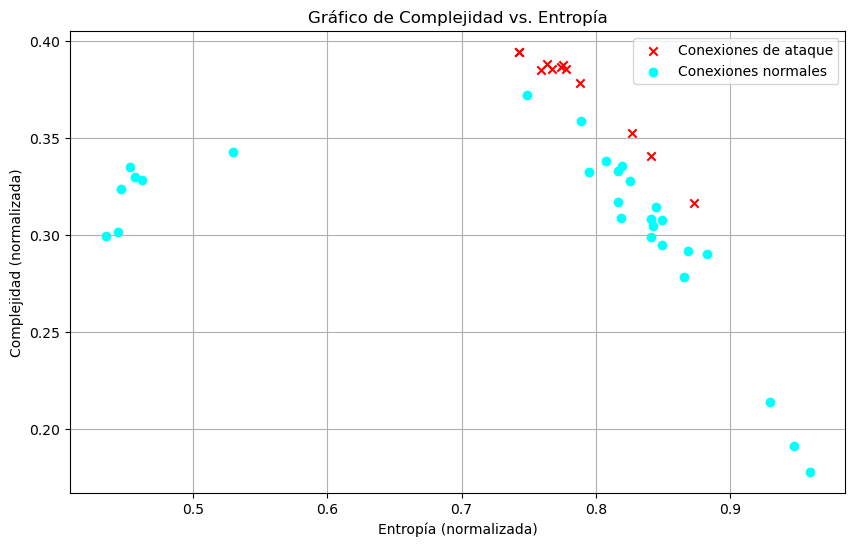

In [612]:
plt.figure(figsize=(10, 6))
plt.scatter(ataques_coif2_sr['Entropía (Wavelet)'], ataques_coif2_sr['Complejidad Eucl.'], marker='x', label='Conexiones de ataque', c="red")
plt.scatter(normales_coif2_sr['Entropía (Wavelet)'], normales_coif2_sr['Complejidad Eucl.'], marker='o', label='Conexiones normales', c="cyan")

plt.xlabel('Entropía (normalizada)')
plt.ylabel('Complejidad (normalizada)')
plt.title('Gráfico de Complejidad vs. Entropía')
plt.legend()
plt.grid(True)
plt.show()

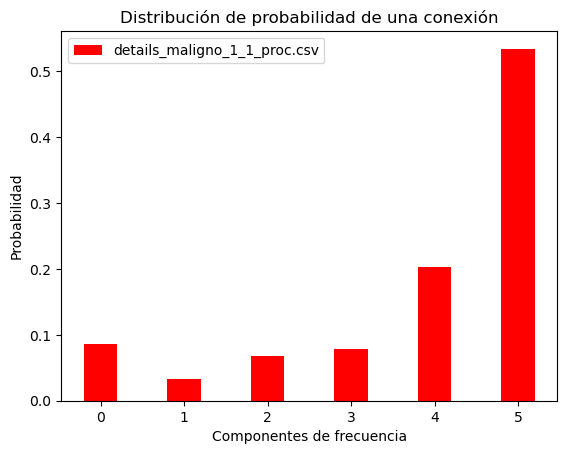

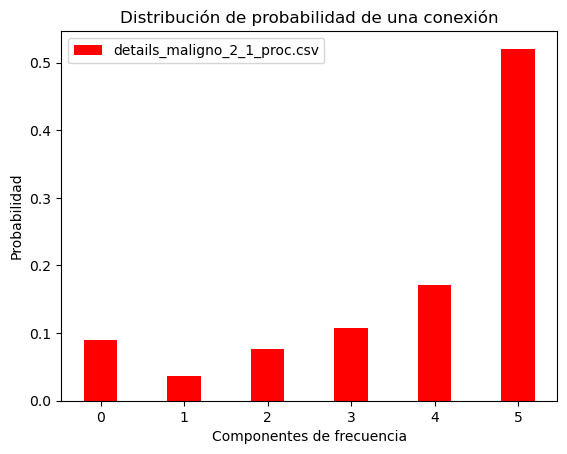

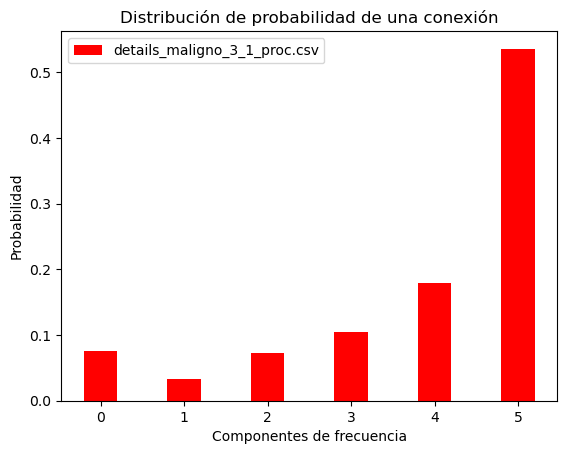

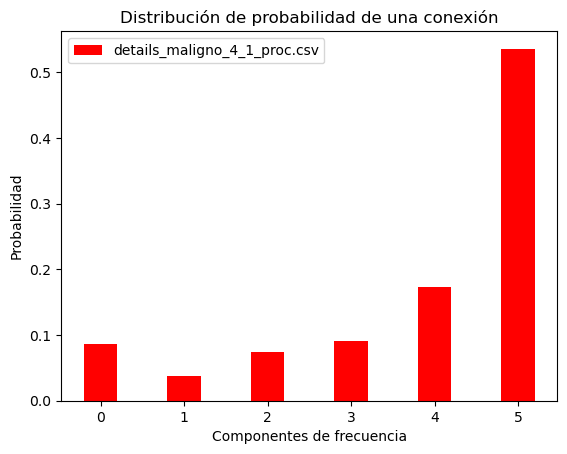

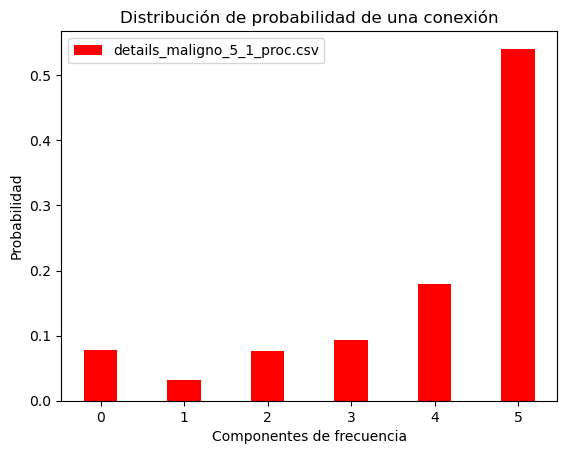

...

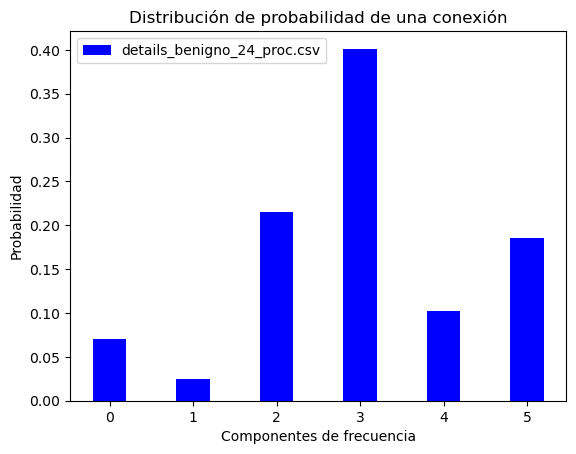

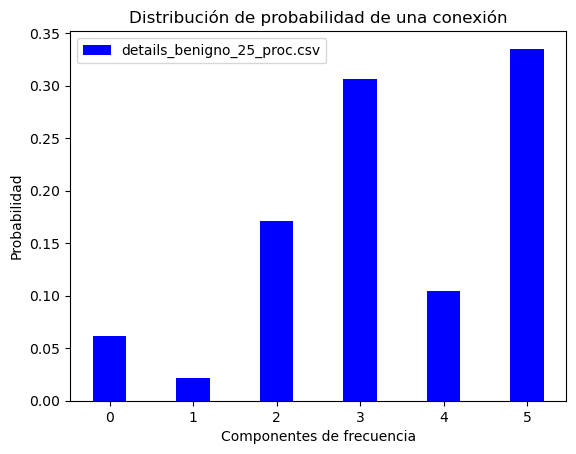

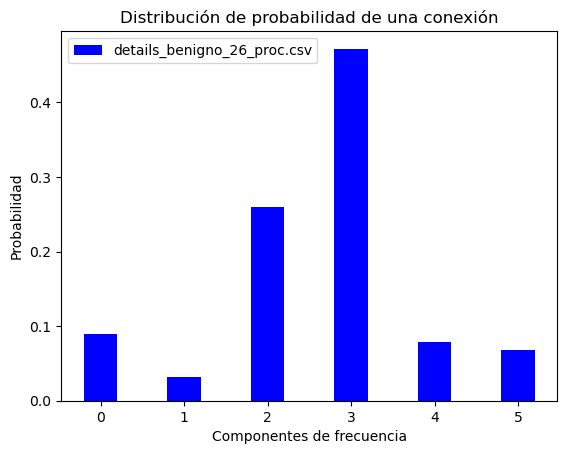

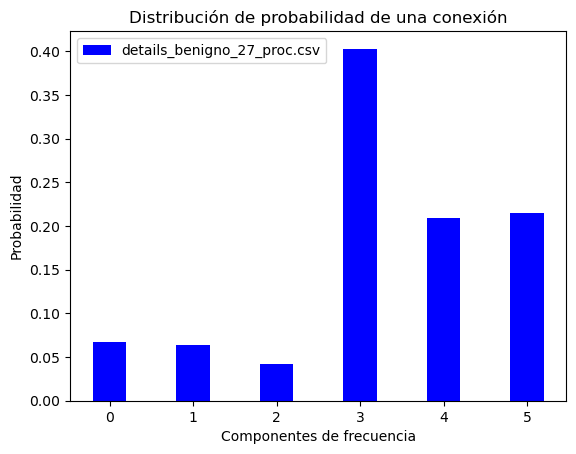

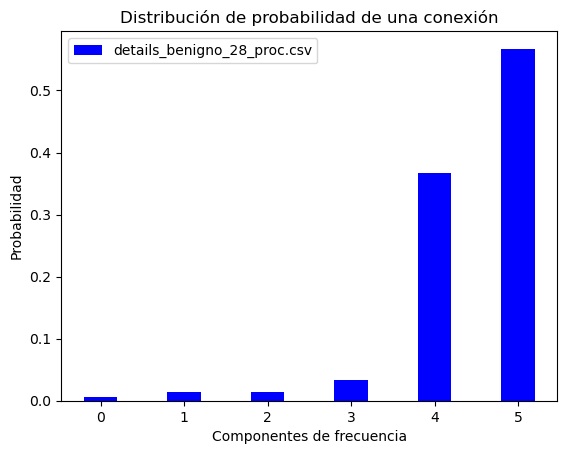

In [641]:
for i in inicio_ataques:
    indices = np.arange(len(todo[0][1]))
    ancho = 0.4

    # Graficar la primera distribución
    plt.bar(indices, todo[i][1] , width=ancho, color='red', label=todo[i][0])


    # Añadir etiquetas y título
    plt.xlabel('Componentes de frecuencia')
    plt.ylabel('Probabilidad')
    plt.title('Distribución de probabilidad de una conexión')

    # Añadir etiquetas a los ejes x
    #plt.xticks(indices + ancho / 2, resultados)

    # Mostrar la leyenda
    plt.legend()

    # Mostrar el gráfico
    plt.show()

for i in todo[139:]:
    indices = np.arange(len(todo[0][1]))
    ancho = 0.4

    # Graficar la primera distribución
    plt.bar(indices, i[1] , width=ancho, color='blue', label=i[0])


    # Añadir etiquetas y título
    plt.xlabel('Componentes de frecuencia')
    plt.ylabel('Probabilidad')
    plt.title('Distribución de probabilidad de una conexión')

    # Añadir etiquetas a los ejes x
    #plt.xticks(indices + ancho / 2, resultados)

    # Mostrar la leyenda
    plt.legend()

    # Mostrar el gráfico
    plt.show()

    
    

## Equilibrado Wootters

bior1.1
Estadístico: 0.7865631580352783
Valor p: 0.006617142353206873
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.8637264370918274
Valor p: 0.05444742739200592
La muestra parece provenir de una distribución normal (no se rechaza la hipótesis nula)
Estadístico: 25.0
Valor p: 0.30126953125
No hay diferencias significativas entre las muestras (no se rechaza la hipótesis nula)
---------------------------------------------------------------------------


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


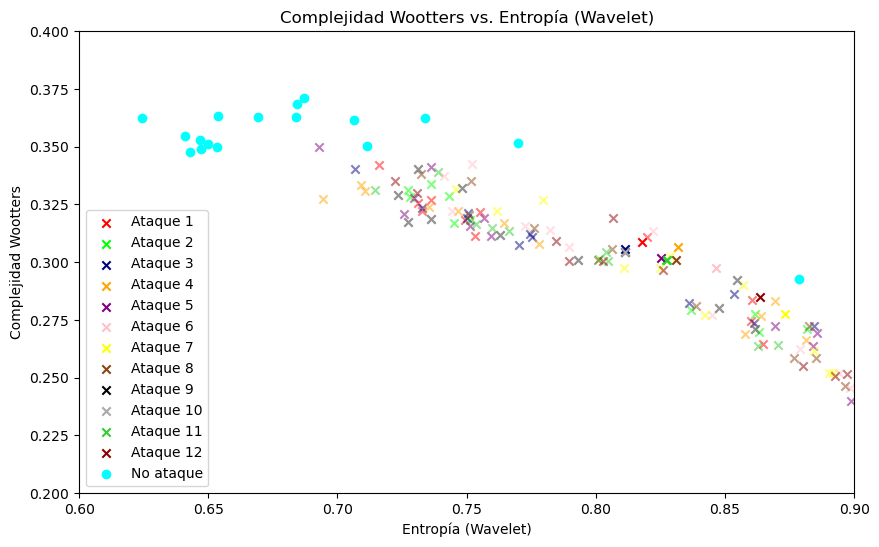

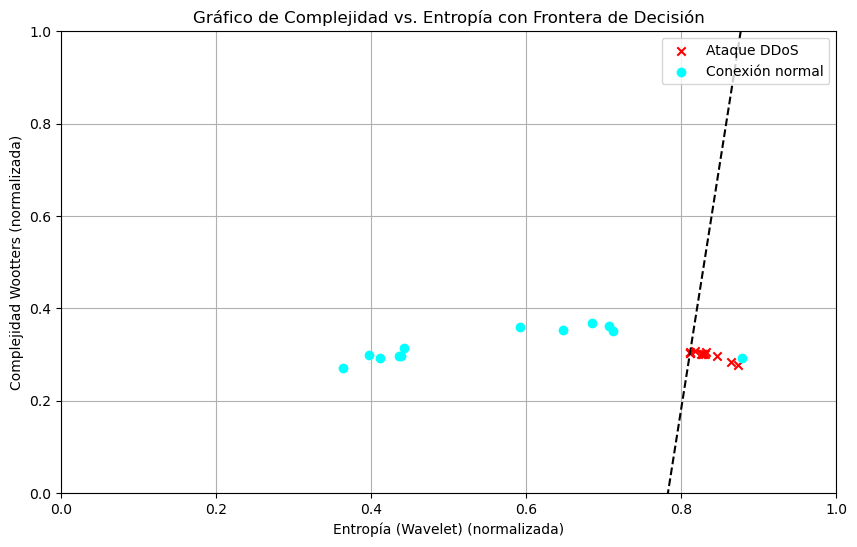

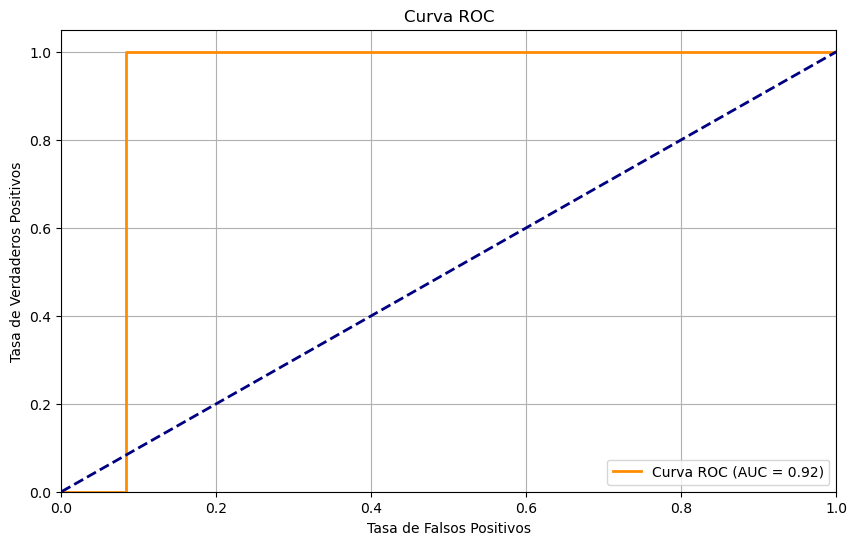

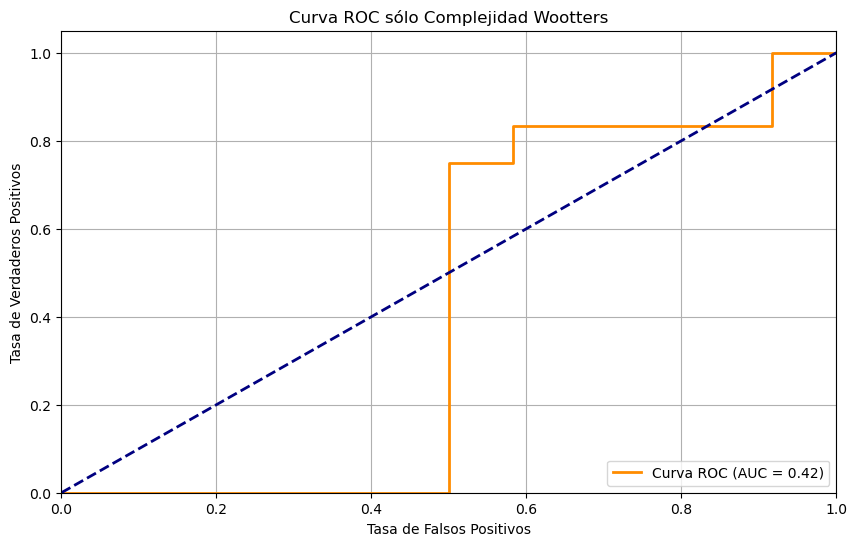

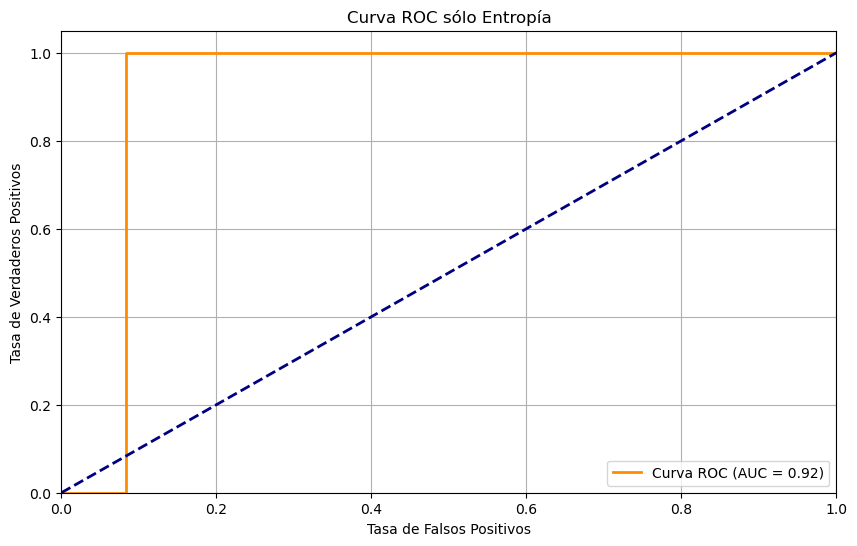

db1
Estadístico: 0.7865631580352783
Valor p: 0.006617142353206873
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.8637264370918274
Valor p: 0.05444742739200592
La muestra parece provenir de una distribución normal (no se rechaza la hipótesis nula)
Estadístico: 25.0
Valor p: 0.30126953125
No hay diferencias significativas entre las muestras (no se rechaza la hipótesis nula)
---------------------------------------------------------------------------


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


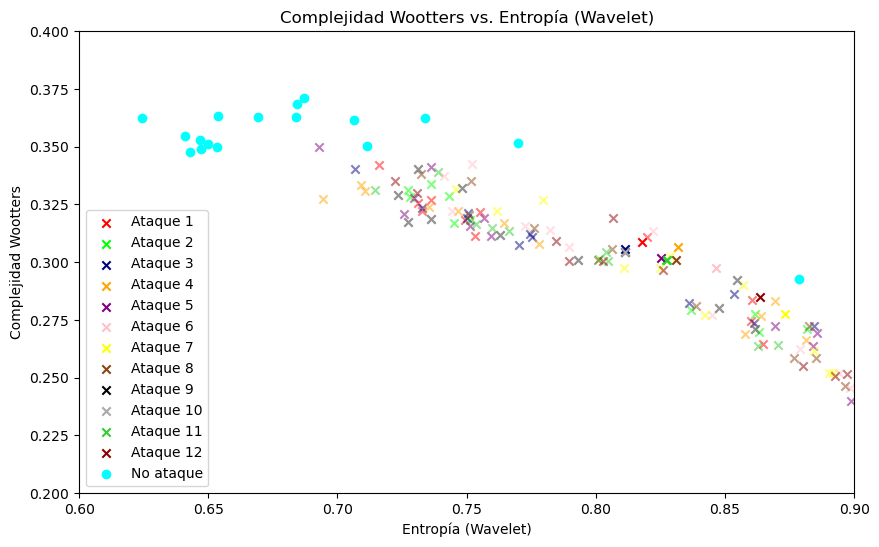

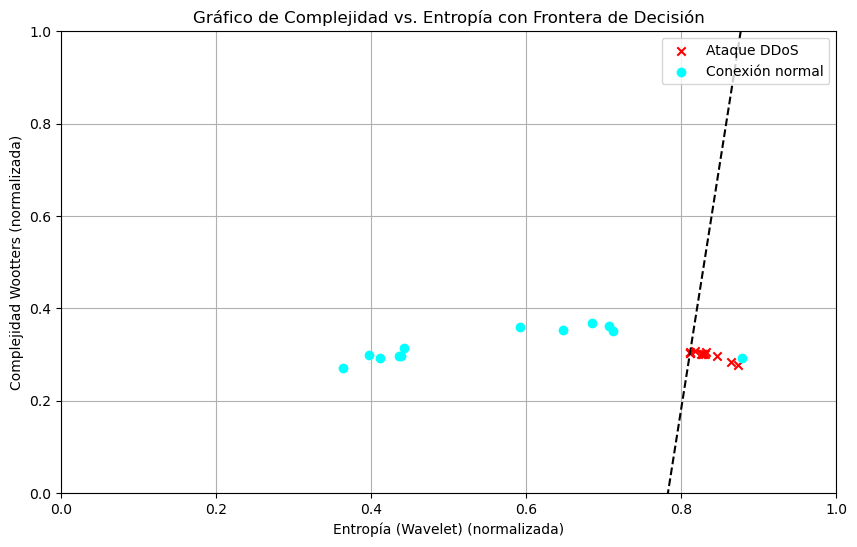

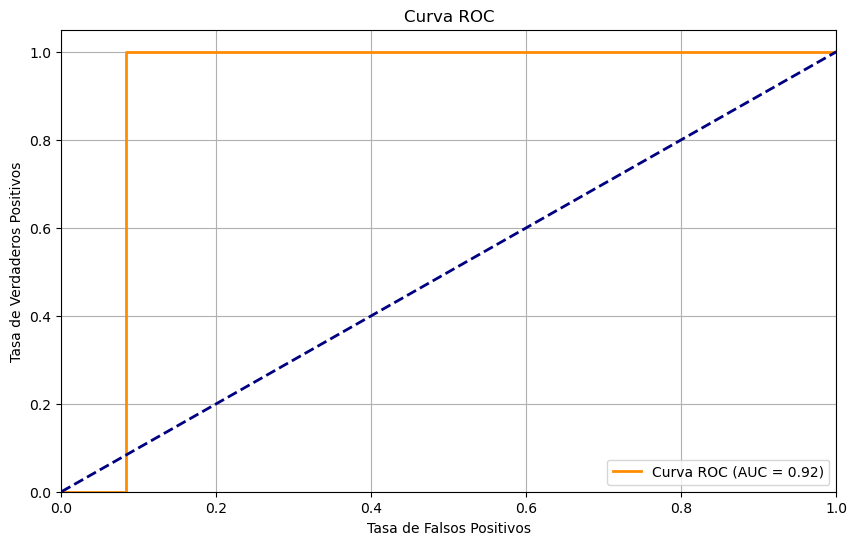

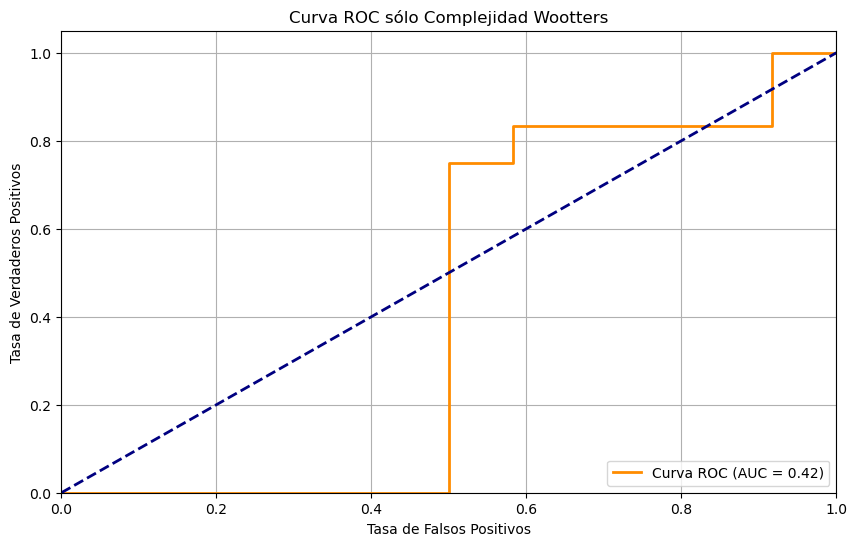

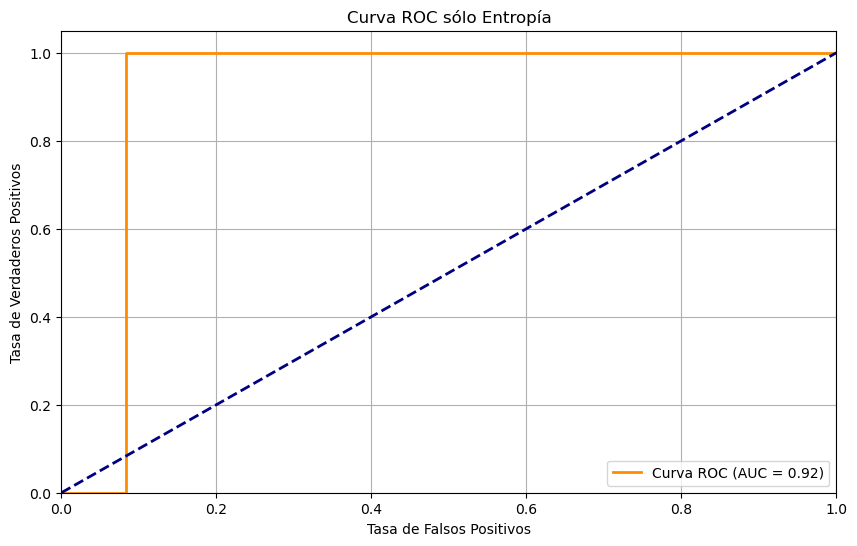

haar
Estadístico: 0.7865631580352783
Valor p: 0.006617142353206873
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.8637264370918274
Valor p: 0.05444742739200592
La muestra parece provenir de una distribución normal (no se rechaza la hipótesis nula)
Estadístico: 25.0
Valor p: 0.30126953125
No hay diferencias significativas entre las muestras (no se rechaza la hipótesis nula)
---------------------------------------------------------------------------


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


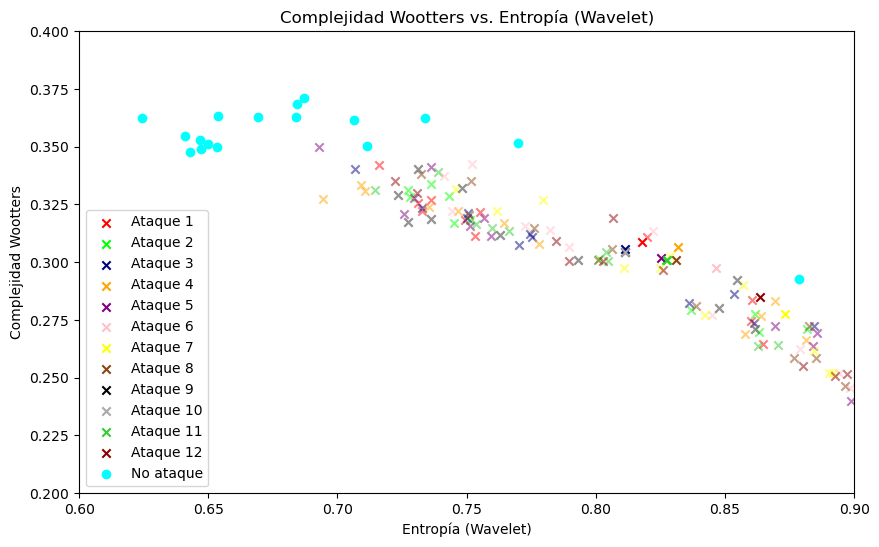

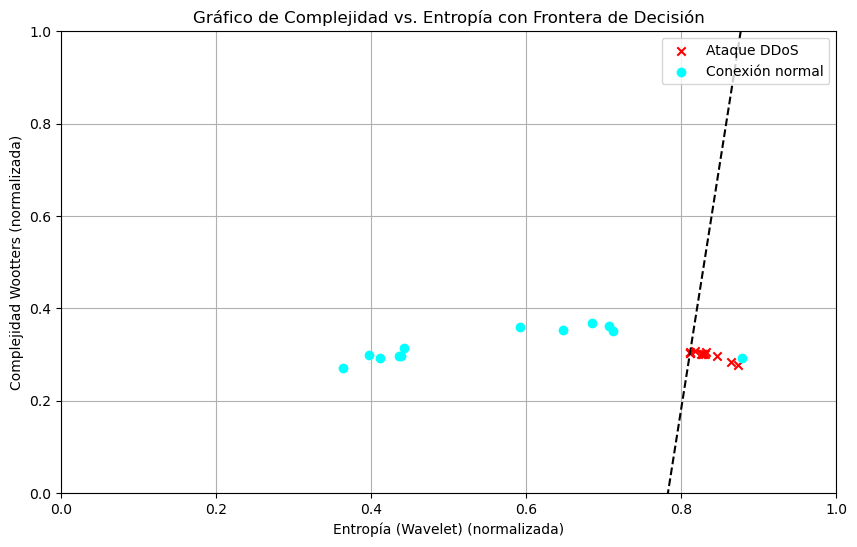

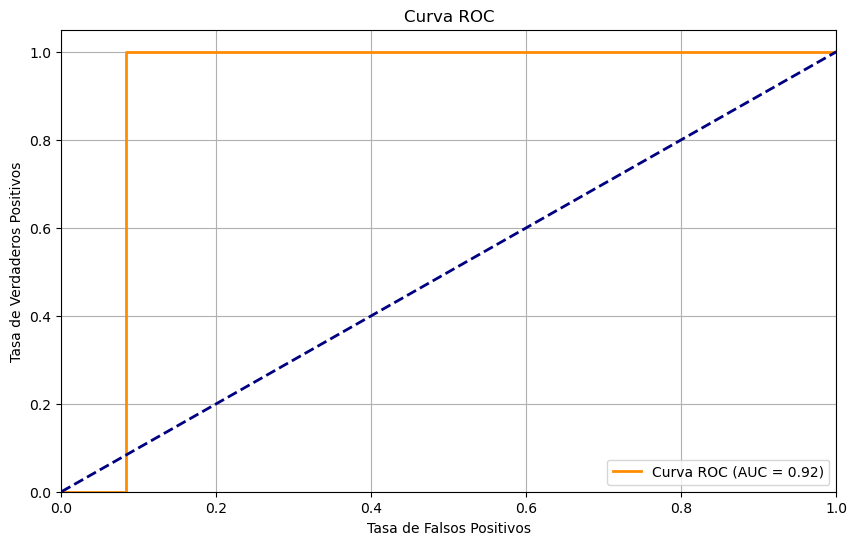

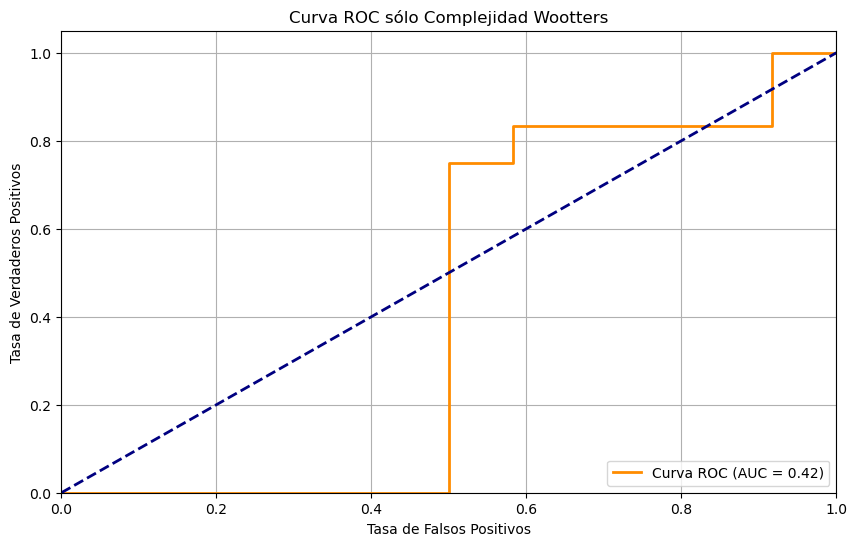

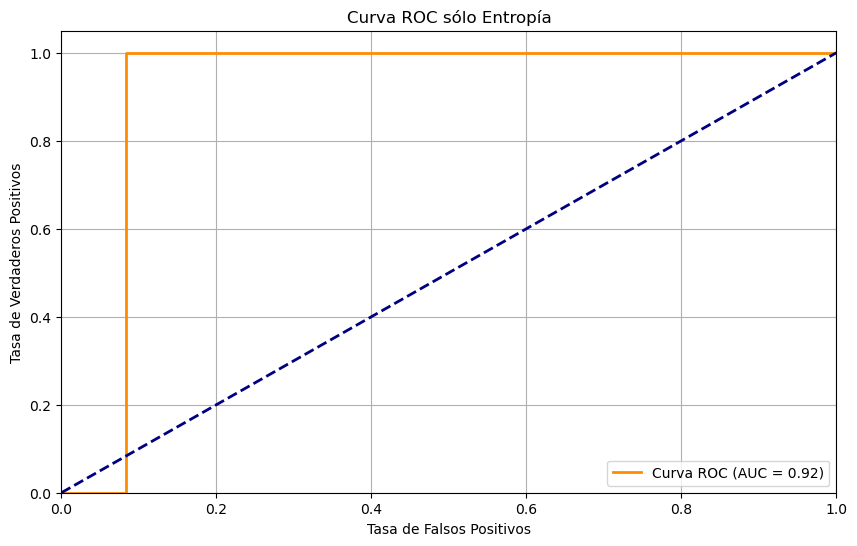

rbio1.1
Estadístico: 0.7865631580352783
Valor p: 0.006617142353206873
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.8637264370918274
Valor p: 0.05444742739200592
La muestra parece provenir de una distribución normal (no se rechaza la hipótesis nula)
Estadístico: 25.0
Valor p: 0.30126953125
No hay diferencias significativas entre las muestras (no se rechaza la hipótesis nula)
---------------------------------------------------------------------------


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


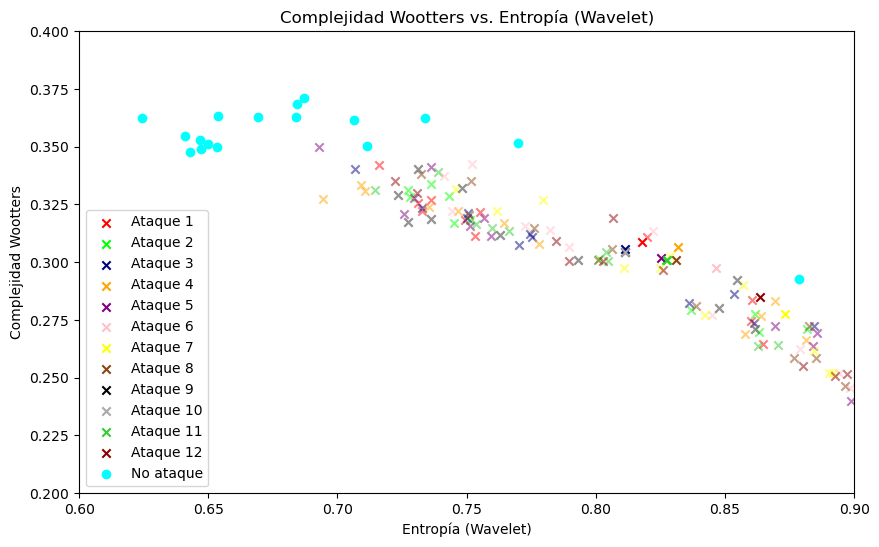

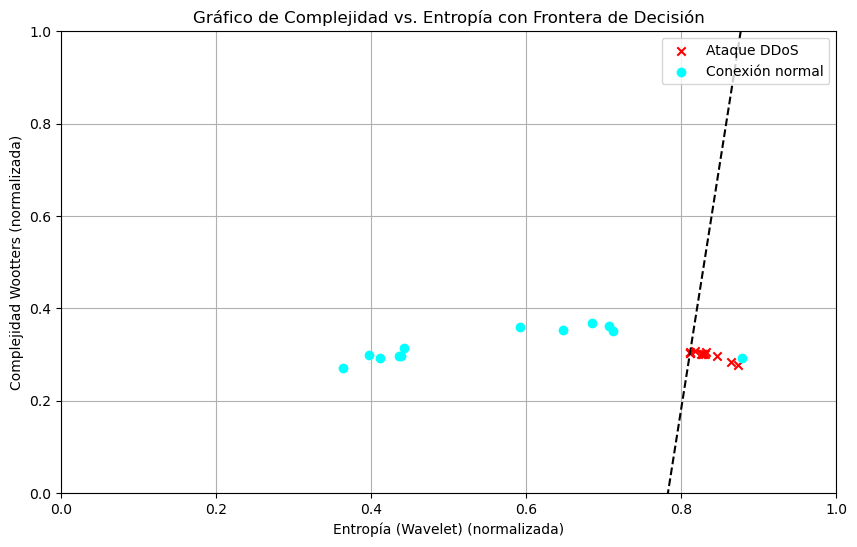

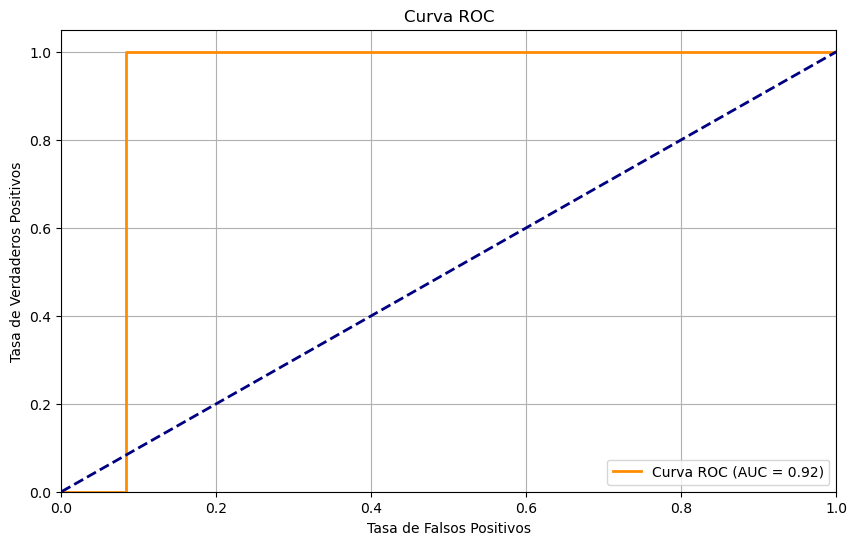

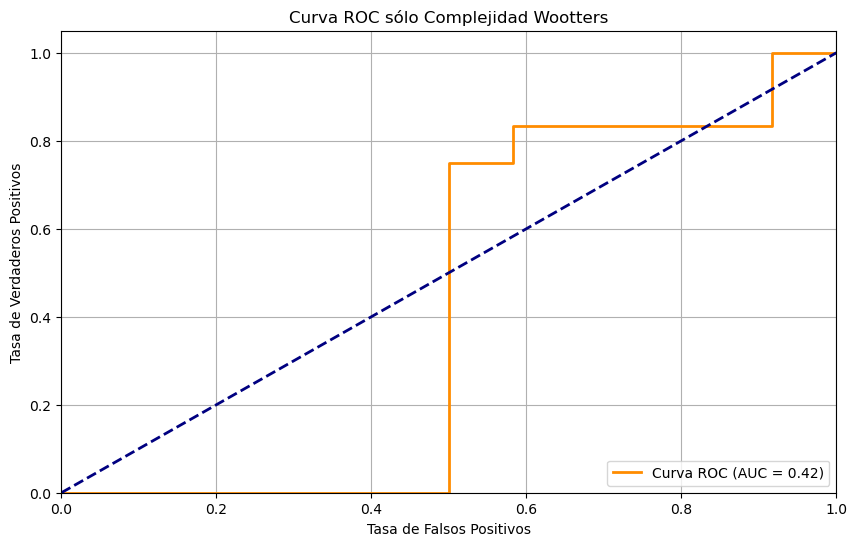

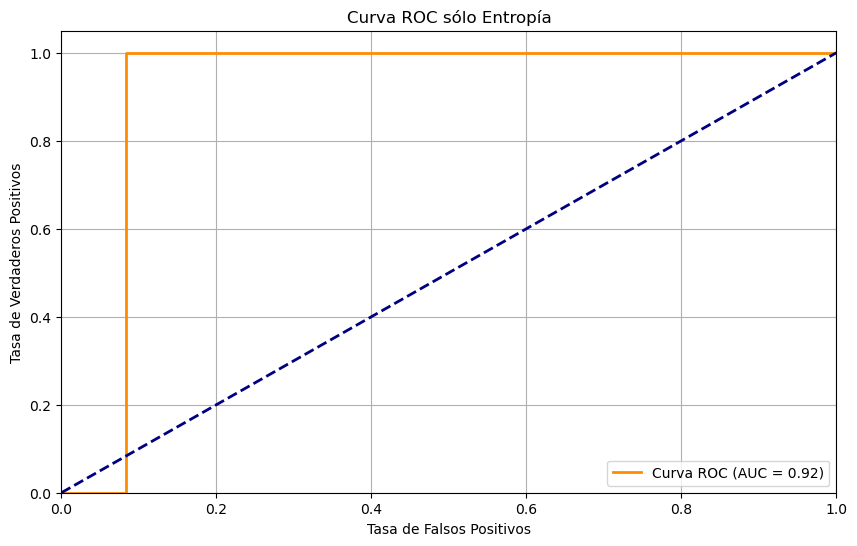

bior2.4
Estadístico: 0.8602786064147949
Valor p: 0.04928108677268028
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.8502585291862488
Valor p: 0.036983828991651535
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 5.0
Valor p: 0.0048828125
Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)
---------------------------------------------------------------------------


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


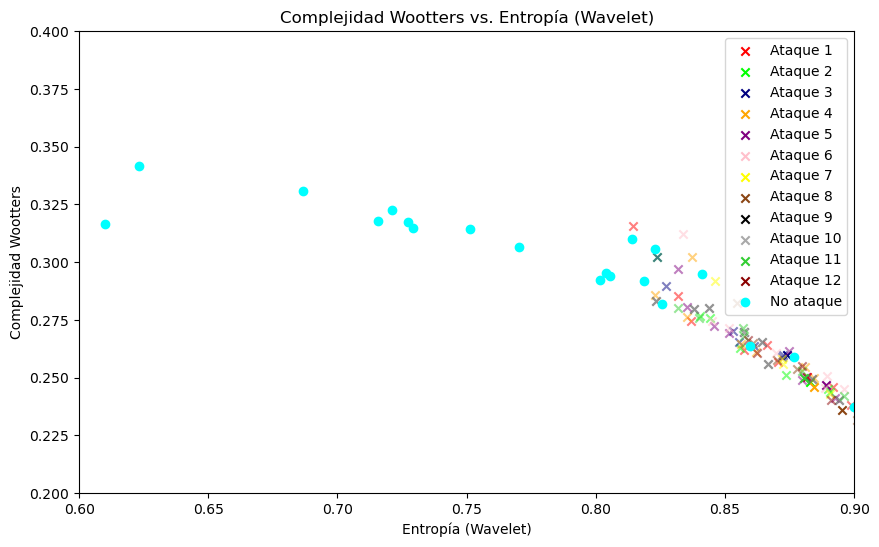

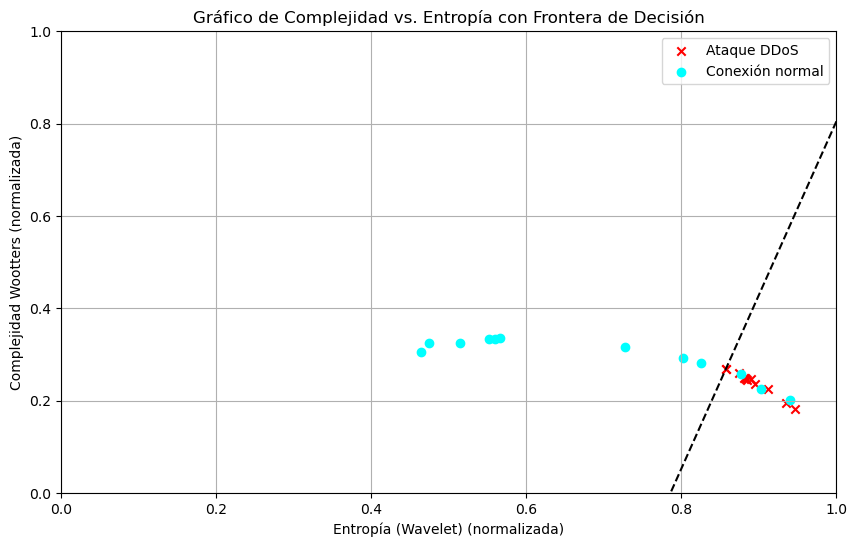

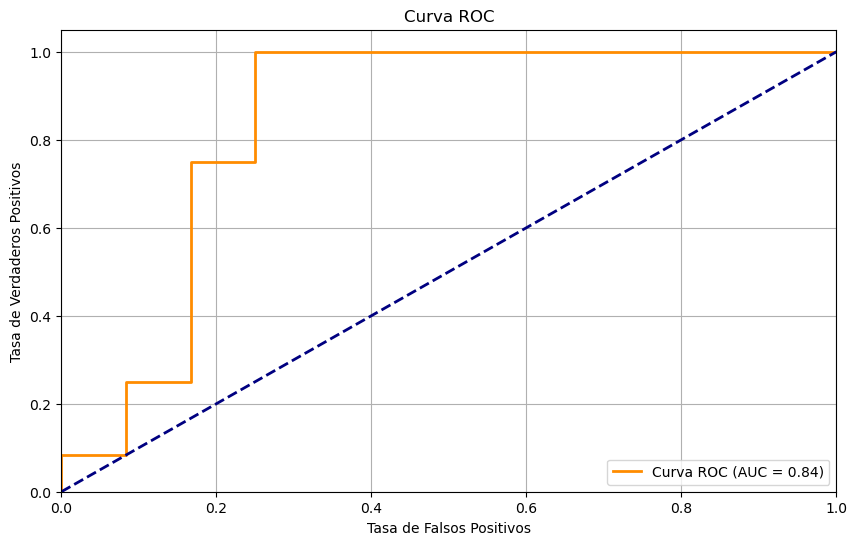

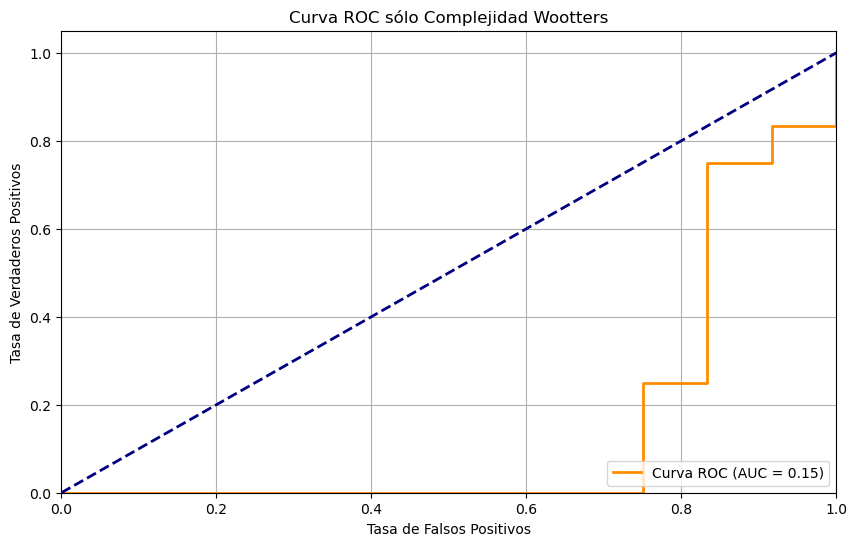

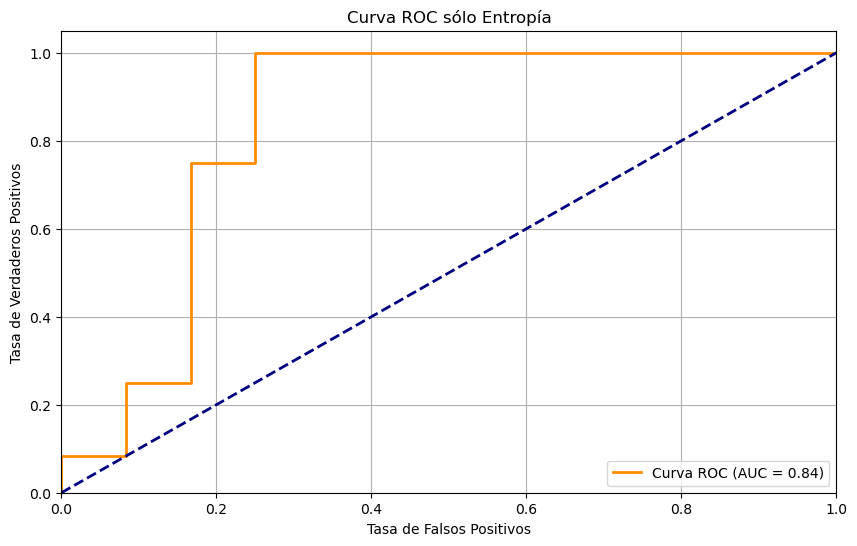

bior1.3
Estadístico: 0.8678178191184998
Valor p: 0.061320144683122635
La muestra parece provenir de una distribución normal (no se rechaza la hipótesis nula)
Estadístico: 0.8100767731666565
Valor p: 0.012225199490785599
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 12.0
Valor p: 0.0341796875
Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)
---------------------------------------------------------------------------


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


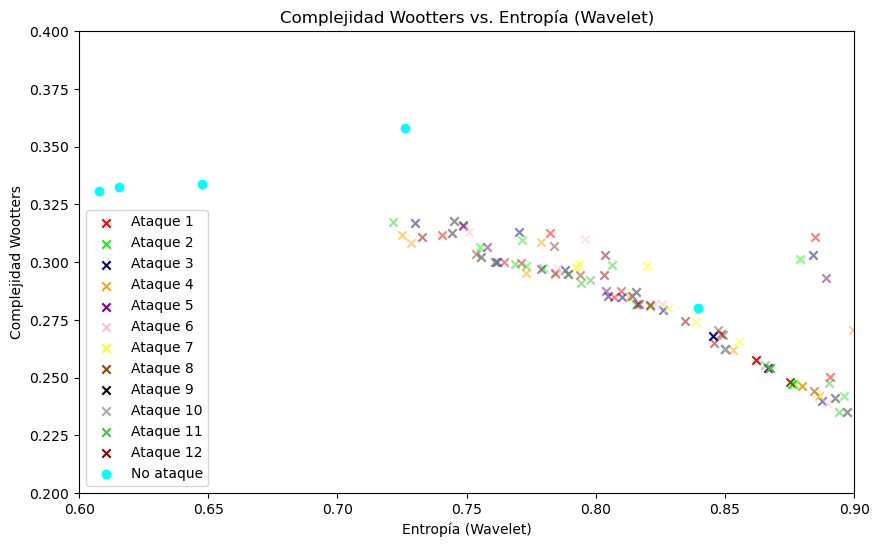

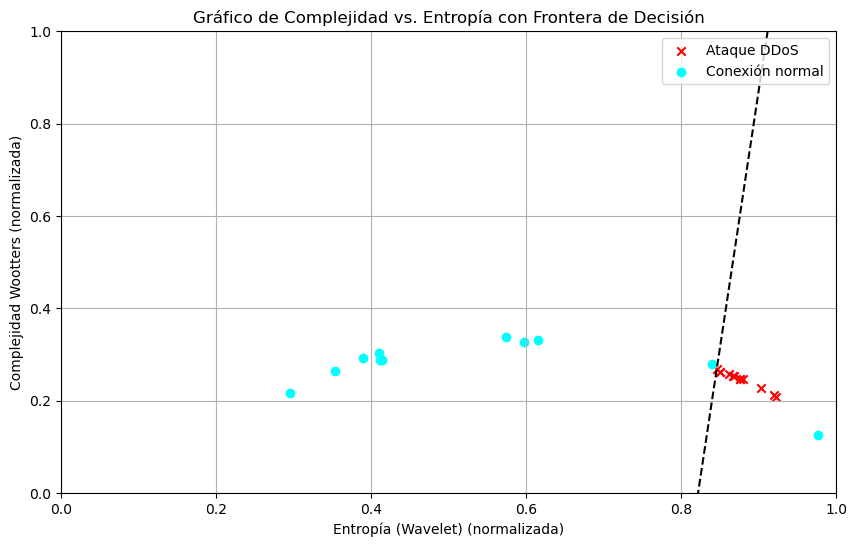

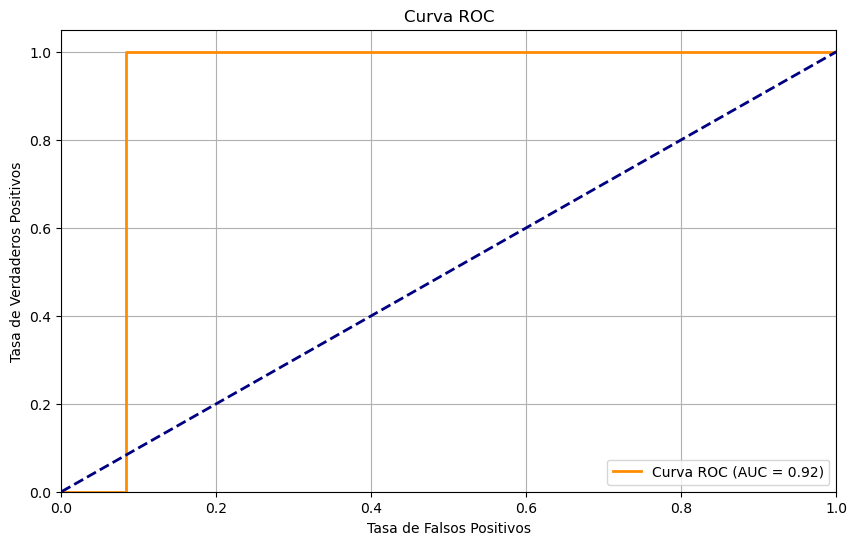

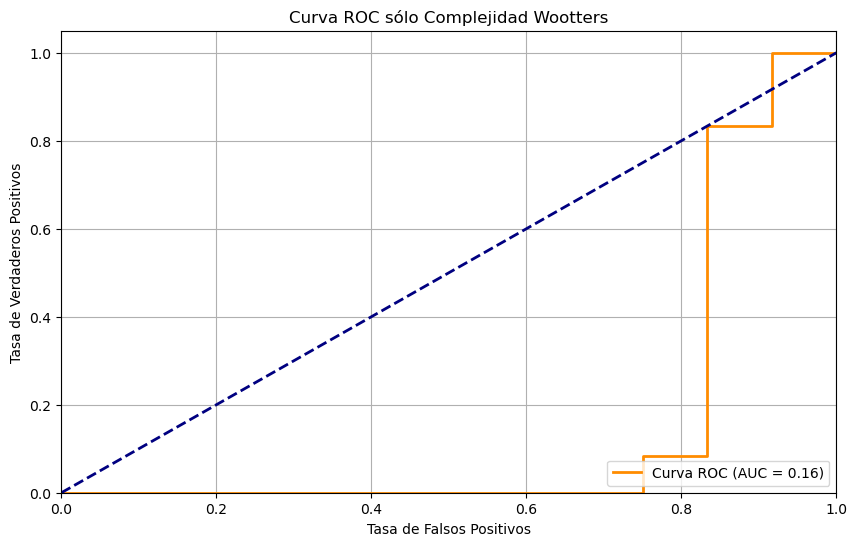

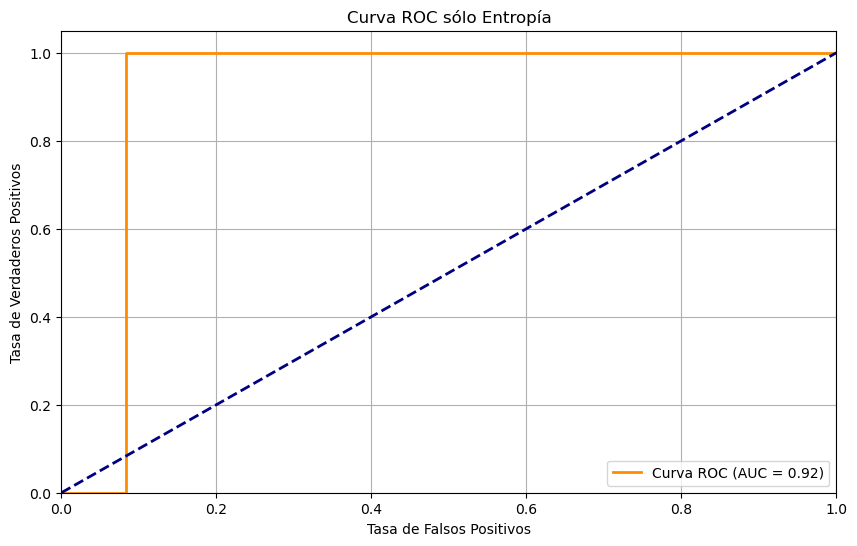

rbio1.3
Estadístico: 0.8802112340927124
Valor p: 0.08819429576396942
La muestra parece provenir de una distribución normal (no se rechaza la hipótesis nula)
Estadístico: 0.6427299380302429
Valor p: 0.00024963743635453284
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 24.0
Valor p: 0.26611328125
No hay diferencias significativas entre las muestras (no se rechaza la hipótesis nula)
---------------------------------------------------------------------------


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


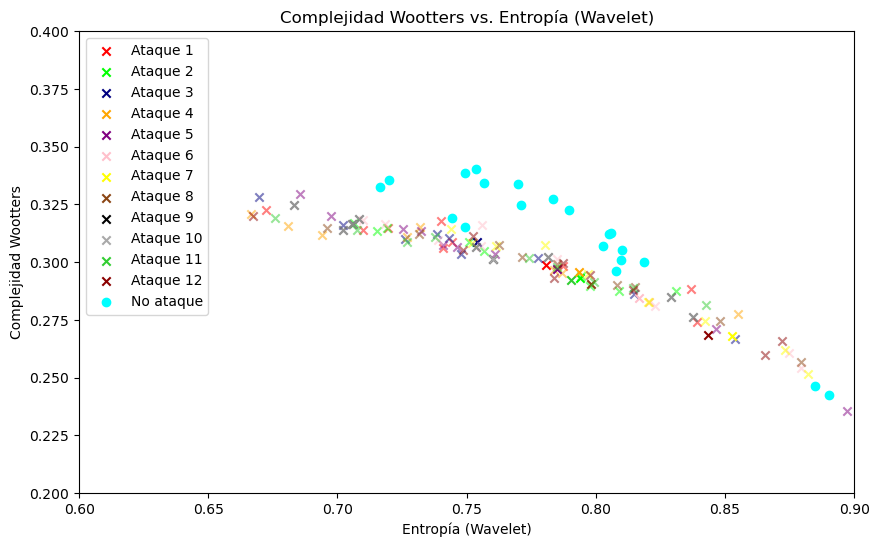

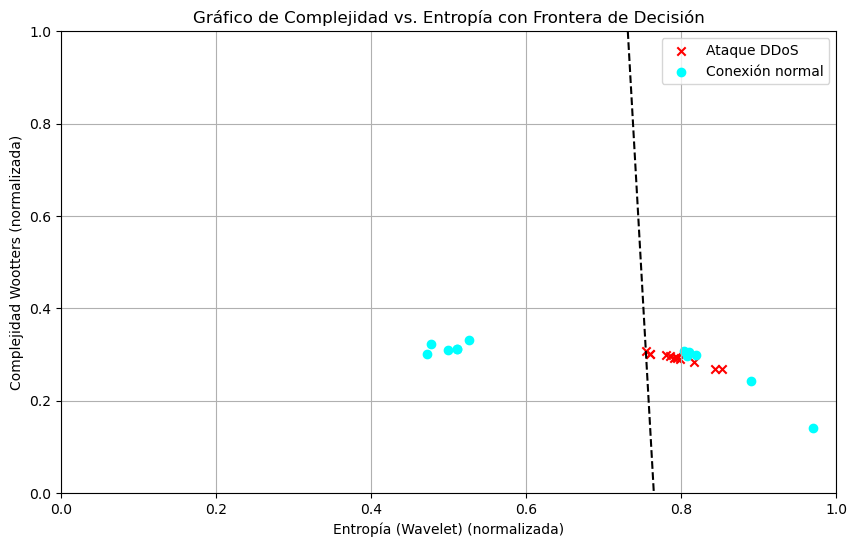

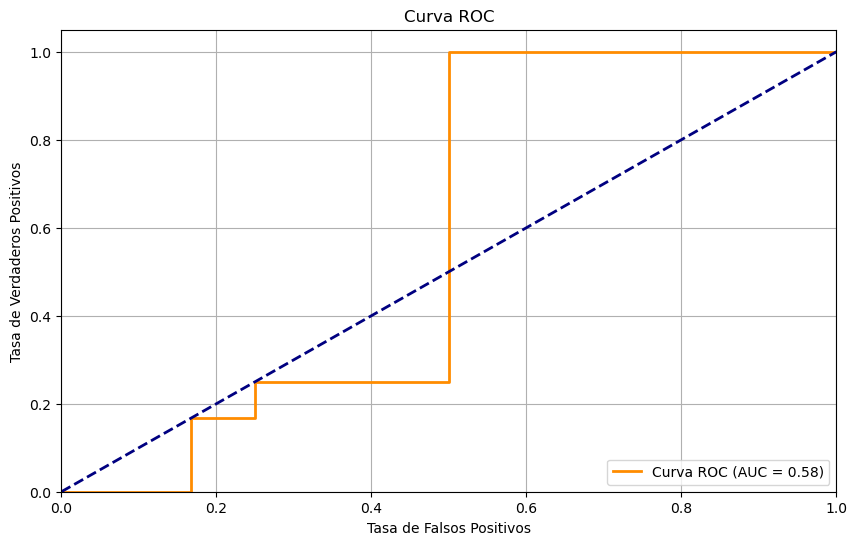

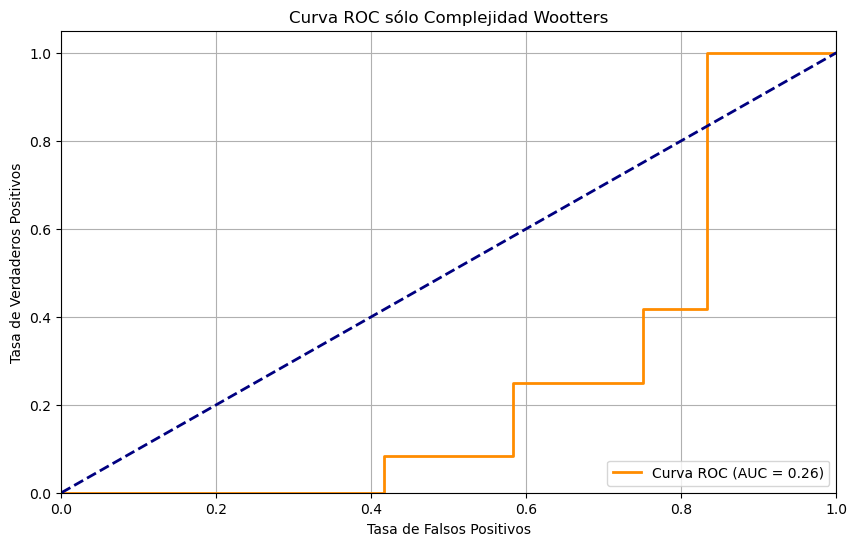

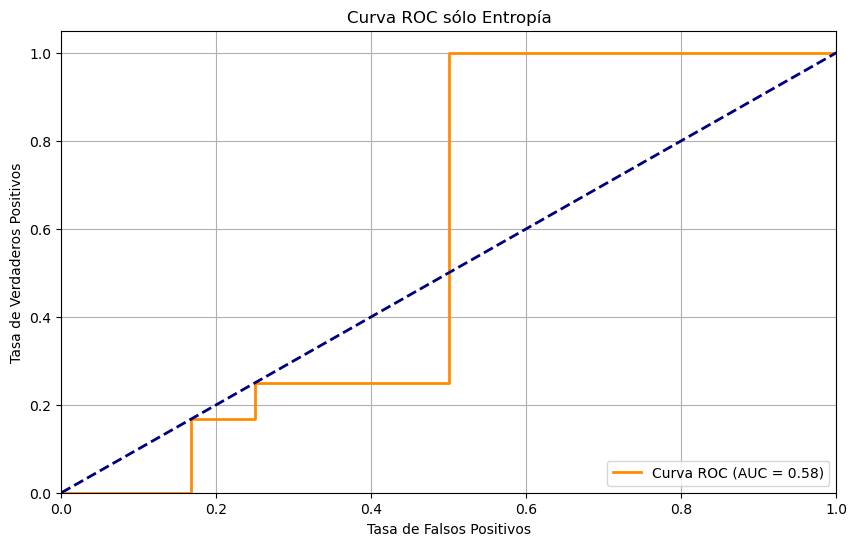

bior1.5
Estadístico: 0.8569383025169373
Valor p: 0.04476355016231537
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.8621773719787598
Valor p: 0.0520595908164978
La muestra parece provenir de una distribución normal (no se rechaza la hipótesis nula)
Estadístico: 19.0
Valor p: 0.12939453125
No hay diferencias significativas entre las muestras (no se rechaza la hipótesis nula)
---------------------------------------------------------------------------


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


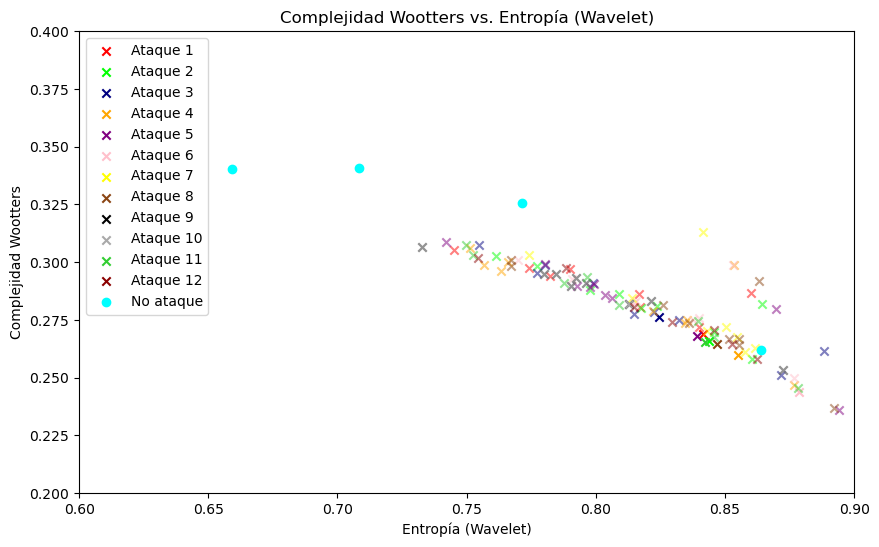

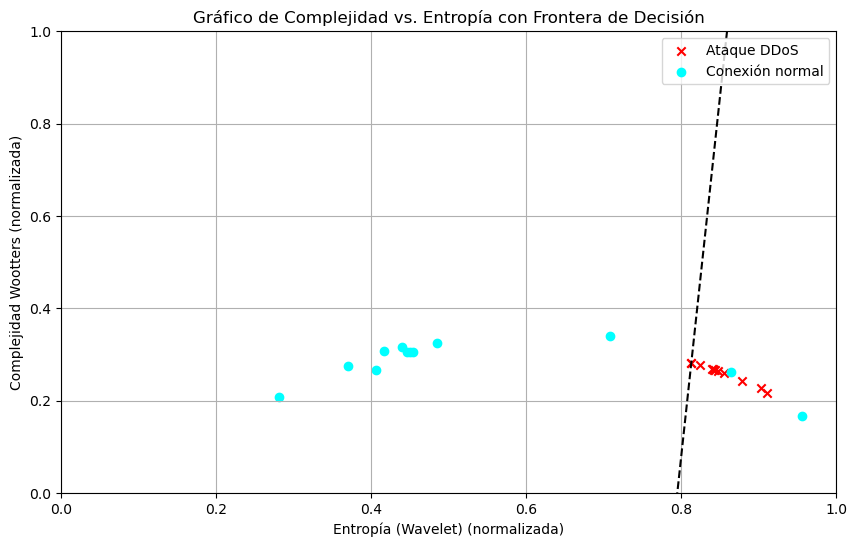

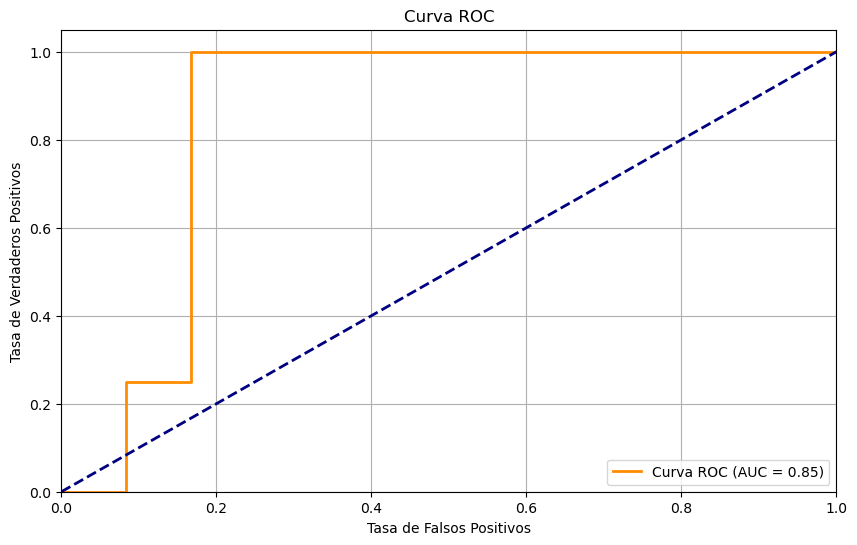

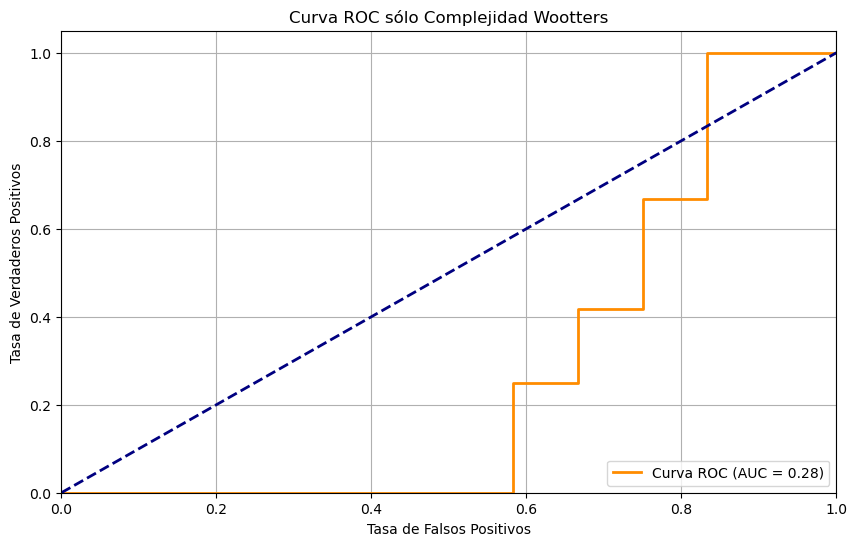

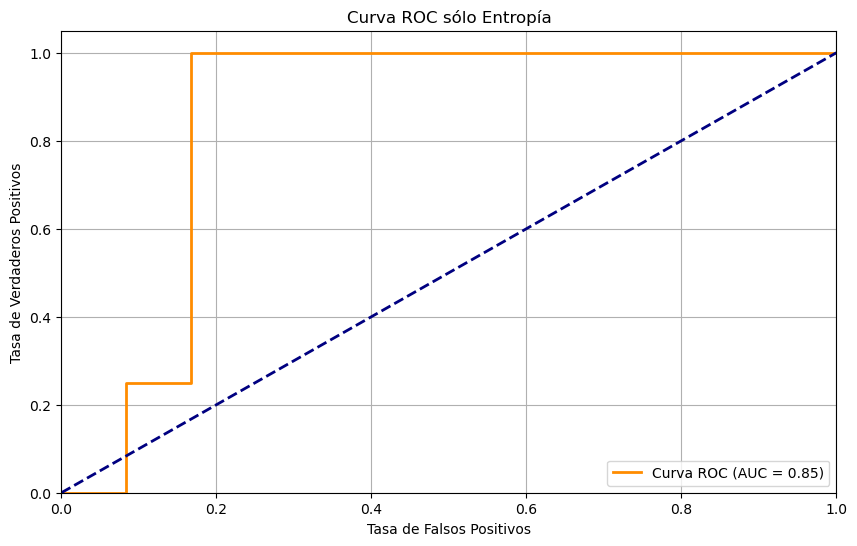

bior2.8
Estadístico: 0.7718780040740967
Valor p: 0.004566292278468609
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.7895829081535339
Valor p: 0.007149997167289257
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 3.0
Valor p: 0.00244140625
Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)
---------------------------------------------------------------------------


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


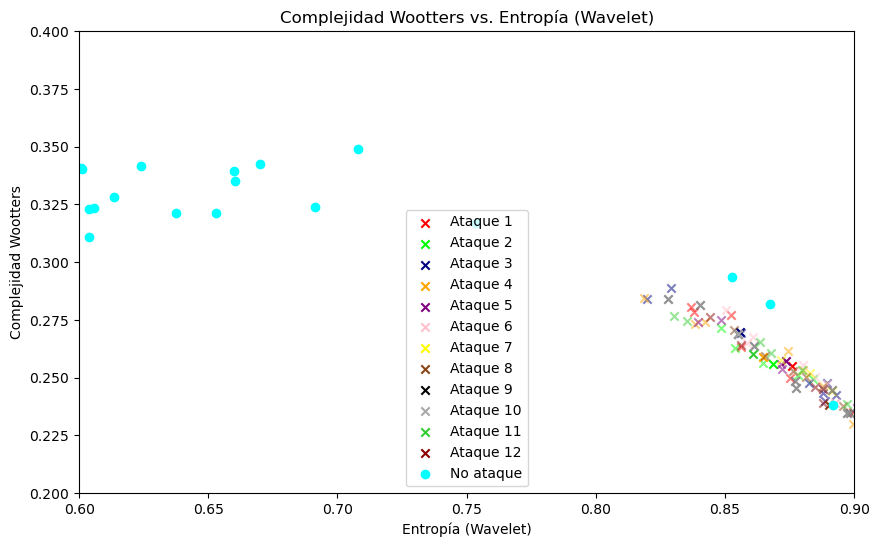

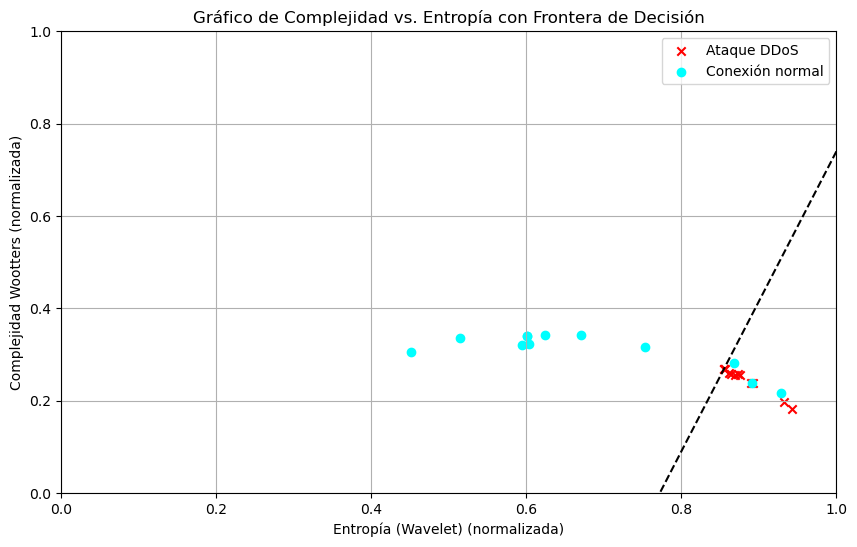

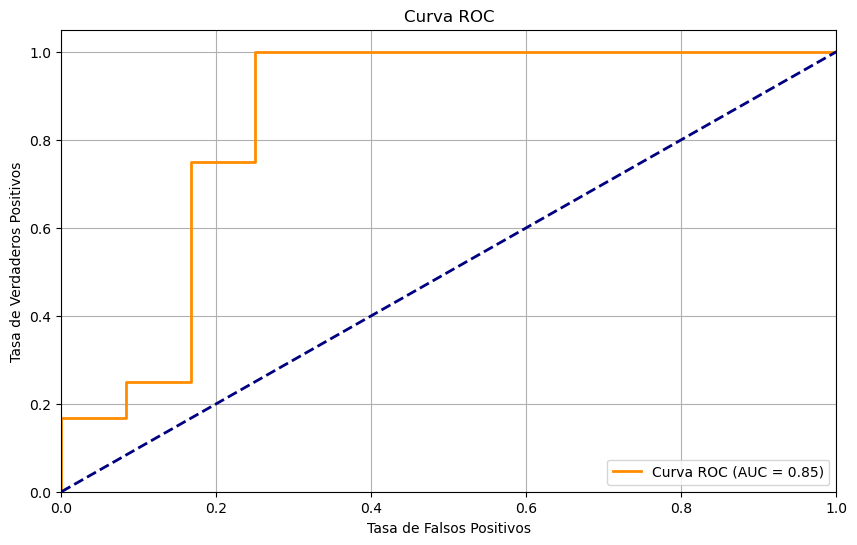

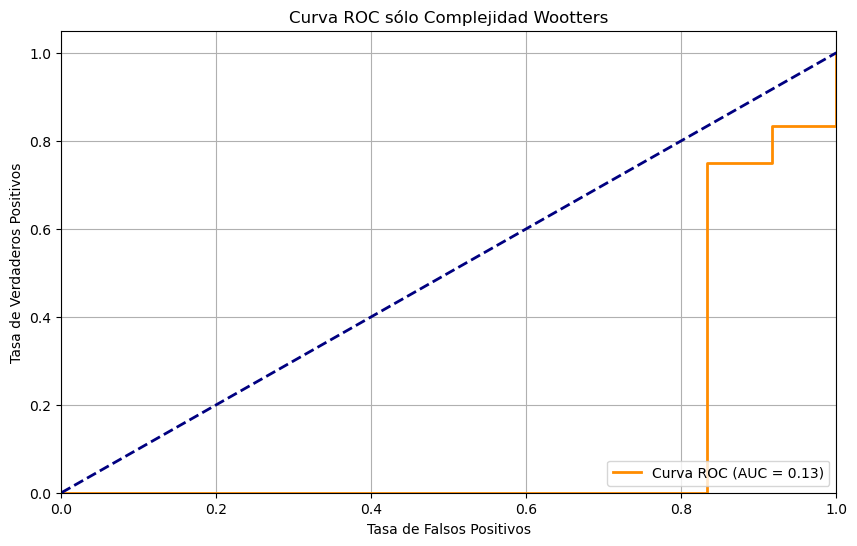

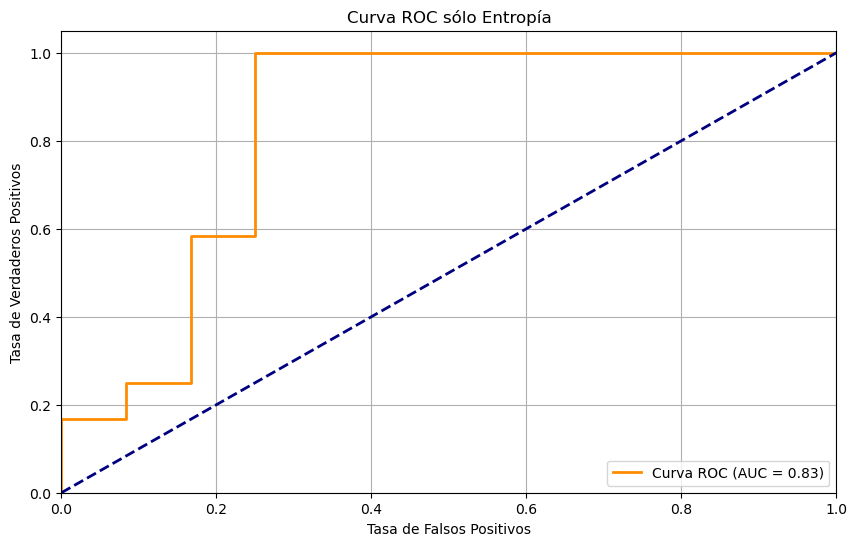

rbio1.5
Estadístico: 0.7868660092353821
Valor p: 0.006668617948889732
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.7144531011581421
Valor p: 0.0011652341345325112
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 29.0
Valor p: 0.4697265625
No hay diferencias significativas entre las muestras (no se rechaza la hipótesis nula)
---------------------------------------------------------------------------


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


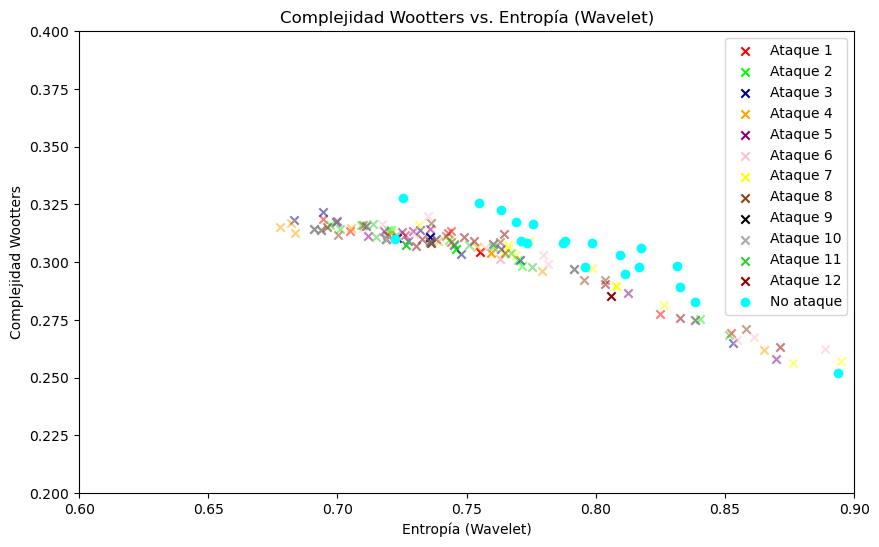

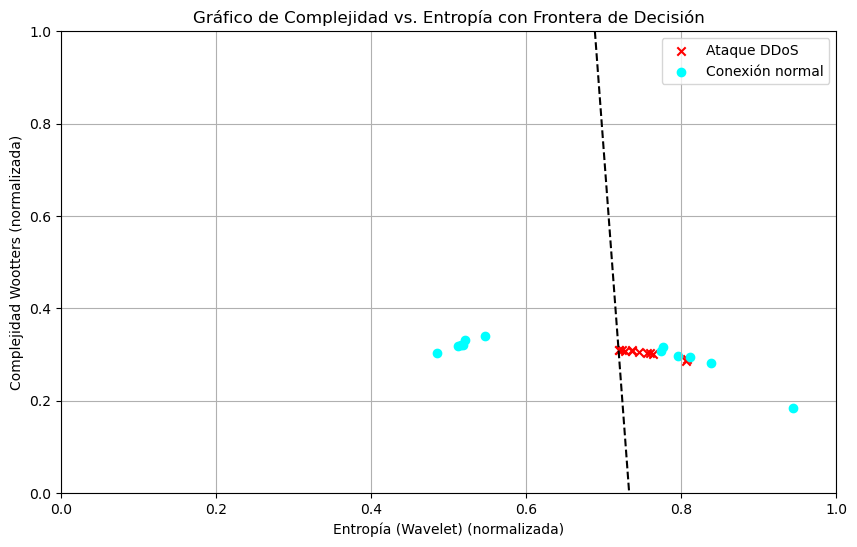

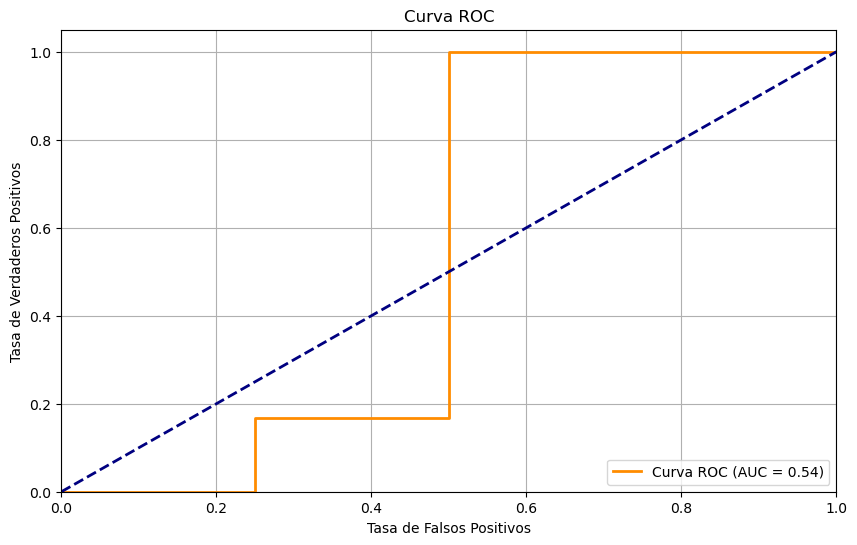

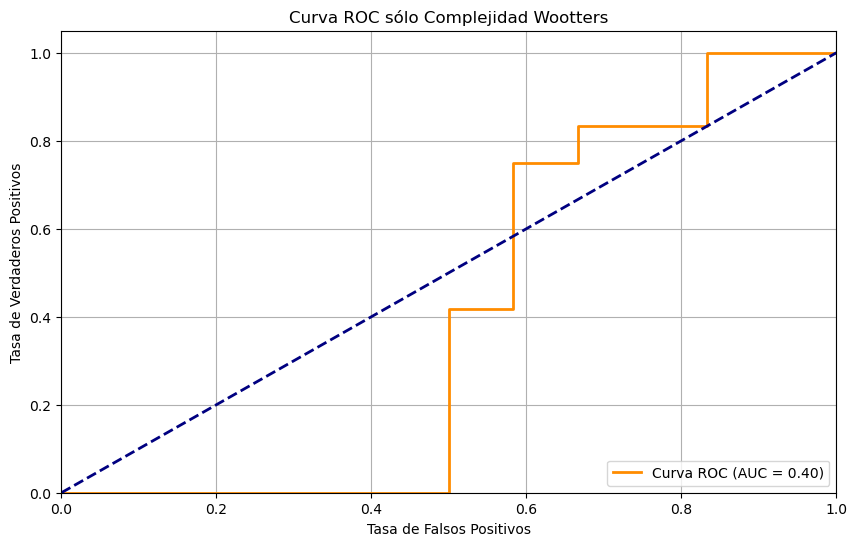

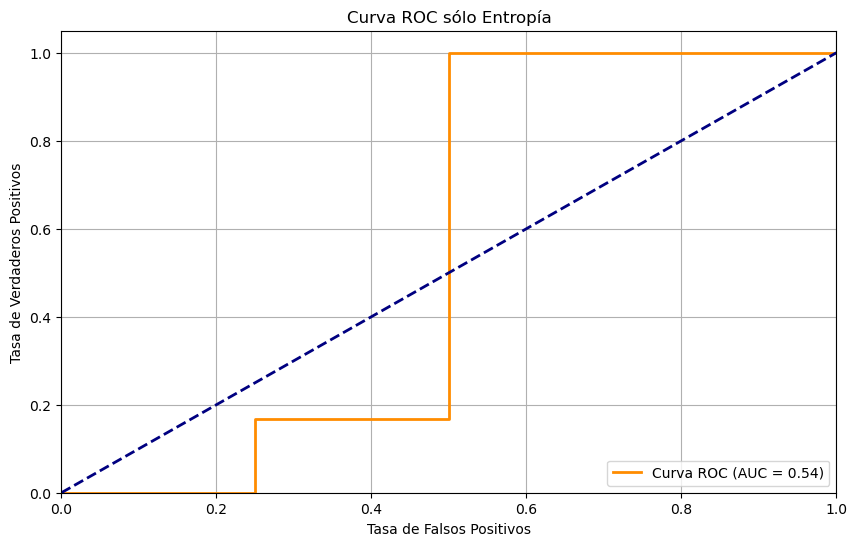

In [527]:
for i in range(10):
    print(ranked_wavelets[i][0])
    df = calculate_desequilibrium_and_complexity(file_paths,ranked_wavelets[i][0])

    plot_complexity_entropy(df,'Complejidad Wootters')
    
    # Realizar la prueba de Shapiro-Wilk
    stat, p_value = shapiro(df['Complejidad Wootters'].iloc[inicio_ataques])

    # Imprimir los resultados
    print('Estadístico:', stat)
    print('Valor p:', p_value)

    # Evaluar la normalidad
    alpha = 0.05
    if p_value > alpha:
        print('La muestra parece provenir de una distribución normal (no se rechaza la hipótesis nula)')
    else:
        print('La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)')

    # Realizar la prueba de Shapiro-Wilk
    stat, p_value = shapiro(df['Complejidad Wootters'][sum(reps):sum(reps)+12])

    print('Estadístico:', stat)
    print('Valor p:', p_value)

    # Evaluar la normalidad
    alpha = 0.05
    if p_value > alpha:
        print('La muestra parece provenir de una distribución normal (no se rechaza la hipótesis nula)')
    else:
        print('La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)')

    stat, p_value = wilcoxon(df['Complejidad Wootters'][sum(reps):sum(reps)+12], df['Complejidad Wootters'].iloc[inicio_ataques])

    # Imprimir los resultados
    print('Estadístico:', stat)
    print('Valor p:', p_value)

    # Evaluar la significancia
    alpha = 0.05
    if p_value > alpha:
        print('No hay diferencias significativas entre las muestras (no se rechaza la hipótesis nula)')
    else:
        print('Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)')
    print("---------------------------------------------------------------------------")
    df['Clasificación'] = [1]*sum(reps)+[0]*(len(df)-sum(reps))
    df2 = df.iloc[inicio_ataques]
    df3 = df.iloc[sum(reps):sum(reps)+12]
    # Separar características y etiquetas
    X = pd.concat([df2,df3])[['Entropía (Wavelet)', 'Complejidad Wootters']]  
    y = pd.concat([df2,df3])['Clasificación']

    # Entrenar el modelo de regresión logística
    model = LogisticRegression()
    model.fit(X, y)
    """
    # Generar una malla de puntos para graficar la frontera de decisión
    xx, yy = np.mgrid[0:1:.01, 0:1:.01]
    grid = np.c_[xx.ravel(), yy.ravel()]
    probs = model.predict_proba(grid)[:, 1].reshape(xx.shape)
    """
    # Definir x_min, x_max, y_min, y_max en base a los datos normalizados
    x_min, x_max = X['Entropía (Wavelet)'].min() - 0.1, X['Entropía (Wavelet)'].max() + 0.1
    y_min, y_max = X['Complejidad Wootters'].min() - 0.1, X['Complejidad Wootters'].max() + 0.1

    # Asegurarse de que los límites estén dentro del rango 0-1
    x_min, x_max = max(0, x_min), min(1, x_max)
    y_min, y_max = max(0, y_min), min(1, y_max)

    # Generar una malla de puntos para graficar la frontera de decisión
    xx, yy = np.meshgrid(np.linspace(0, 1, 100), np.linspace(0, 1, 100))
    y_pred_prob = model.predict_proba(X)[:, 1]
    #print(y_pred_prob)

    # Calcular la curva ROC y el AUC
    fpr, tpr, thresholds = roc_curve(y, y_pred_prob)
    roc_auc = roc_auc_score(y, y_pred_prob)

    f1_scores = [f1_score(y, (y_pred_prob >= thresh).astype(int)) for thresh in thresholds]

    # Encontrar el umbral que maximiza el F1-Score
    optimal_threshold = thresholds[np.argmax(f1_scores)]

    # Predecir con el modelo
    Z = model.predict_proba(np.c_[xx.ravel(), yy.ravel()])[:, 1]
    Z = Z.reshape(xx.shape)

    # Graficar los puntos y la frontera de decisión
    
    
    # Graficar los puntos y la frontera de decisión
    plt.figure(figsize=(10, 6))
    plt.scatter(X[y == 1]['Entropía (Wavelet)'], X[y == 1]['Complejidad Wootters'], marker='x', label='Ataque DDoS', c="Red")
    plt.scatter(X[y == 0]['Entropía (Wavelet)'], X[y == 0]['Complejidad Wootters'], marker='o', label='Conexión normal', c="Cyan")

    # Contorno de la frontera de decisión
    #plt.contour(xx, yy, probs, levels=[0.5], cmap="Greys", vmin=0, vmax=1)

    plt.contour(xx, yy, Z, levels=[optimal_threshold], colors='black', linestyles='--')
    plt.xlabel('Entropía (Wavelet) (normalizada)')
    plt.ylabel('Complejidad Wootters (normalizada)')
    plt.title('Gráfico de Complejidad vs. Entropía con Frontera de Decisión')
    plt.legend()
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.0])
    plt.grid(True)
    plt.show()
    
    # Predecir las probabilidades de la clase positiva
    y_pred_prob = model.predict_proba(X)[:, 1]
    #print(y_pred_prob)

    # Calcular la curva ROC y el AUC
    fpr, tpr, thresholds = roc_curve(y, y_pred_prob)
    roc_auc = roc_auc_score(y, y_pred_prob)


    # Graficar la curva ROC
    plt.figure(figsize=(10, 6))
    plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'Curva ROC (AUC = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('Tasa de Falsos Positivos')
    plt.ylabel('Tasa de Verdaderos Positivos')
    plt.title('Curva ROC')
    plt.legend(loc="lower right")
    plt.grid(True)
    plt.show()
    
    # Calcular la curva ROC y el AUC para sólo complejidad
    fpr, tpr, thresholds = roc_curve(y, X["Complejidad Wootters"])
    roc_auc = roc_auc_score(y, X["Complejidad Wootters"])


    # Graficar la curva ROC
    plt.figure(figsize=(10, 6))
    plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'Curva ROC (AUC = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('Tasa de Falsos Positivos')
    plt.ylabel('Tasa de Verdaderos Positivos')
    plt.title('Curva ROC sólo Complejidad Wootters')
    plt.legend(loc="lower right")
    plt.grid(True)
    plt.show()
    
    # Calcular la curva ROC y el AUC para sólo complejidad
    fpr, tpr, thresholds = roc_curve(y, X['Entropía (Wavelet)'])
    roc_auc = roc_auc_score(y, X['Entropía (Wavelet)'])


    # Graficar la curva ROC
    plt.figure(figsize=(10, 6))
    plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'Curva ROC (AUC = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('Tasa de Falsos Positivos')
    plt.ylabel('Tasa de Verdaderos Positivos')
    plt.title('Curva ROC sólo Entropía')
    plt.legend(loc="lower right")
    plt.grid(True)
    plt.show()

## Equilibrado Eucl.

bior1.1
Estadístico: 0.9085087776184082
Valor p: 0.20415277779102325
La muestra parece provenir de una distribución normal (no se rechaza la hipótesis nula)
Estadístico: 0.836125373840332
Valor p: 0.024849489331245422
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 23.0
Valor p: 0.2333984375
No hay diferencias significativas entre las muestras (no se rechaza la hipótesis nula)
---------------------------------------------------------------------------


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


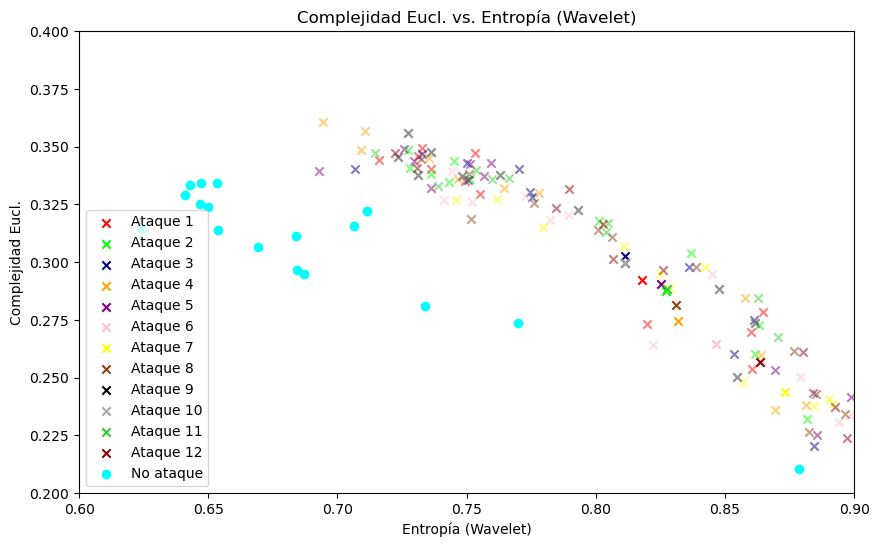

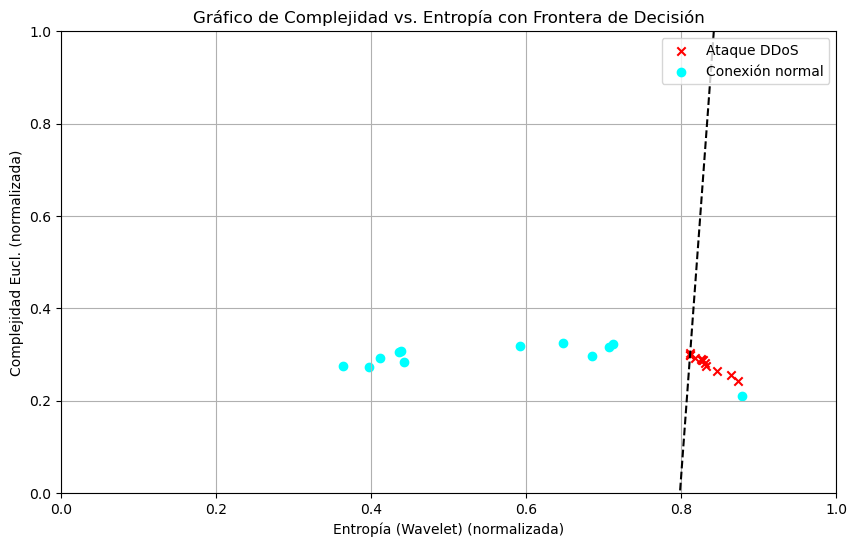

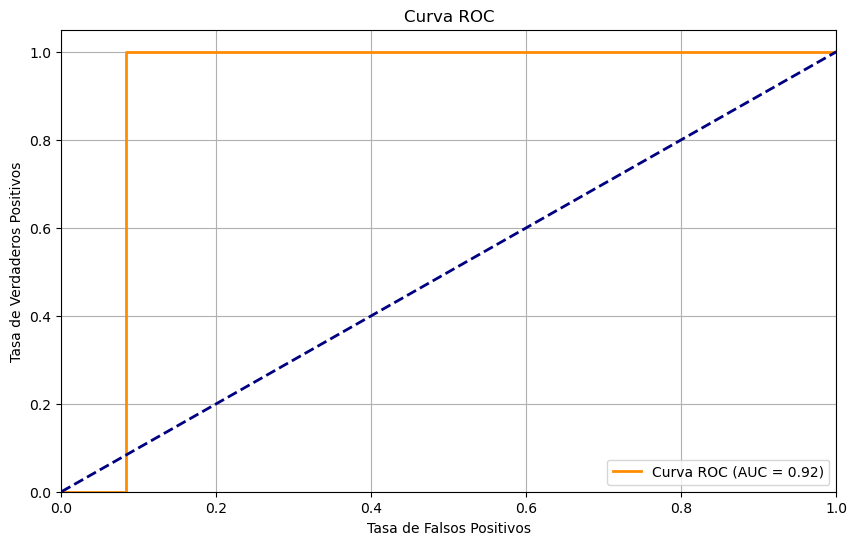

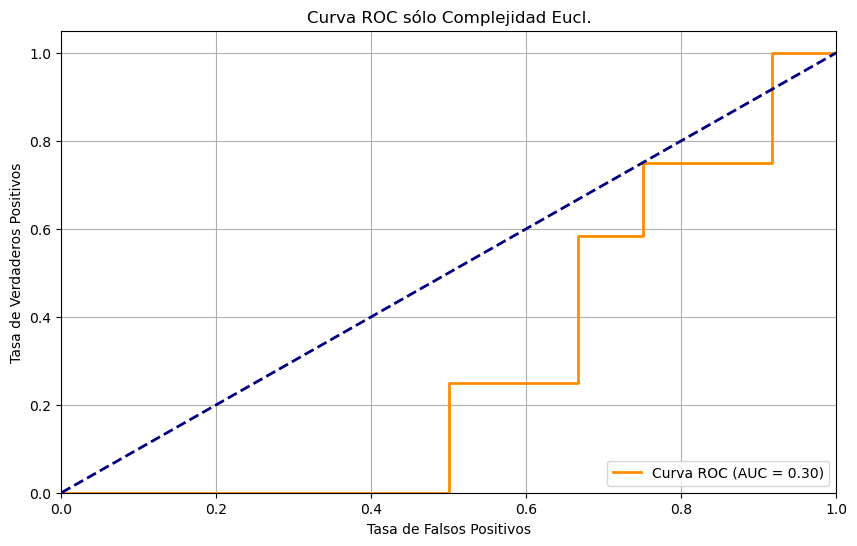

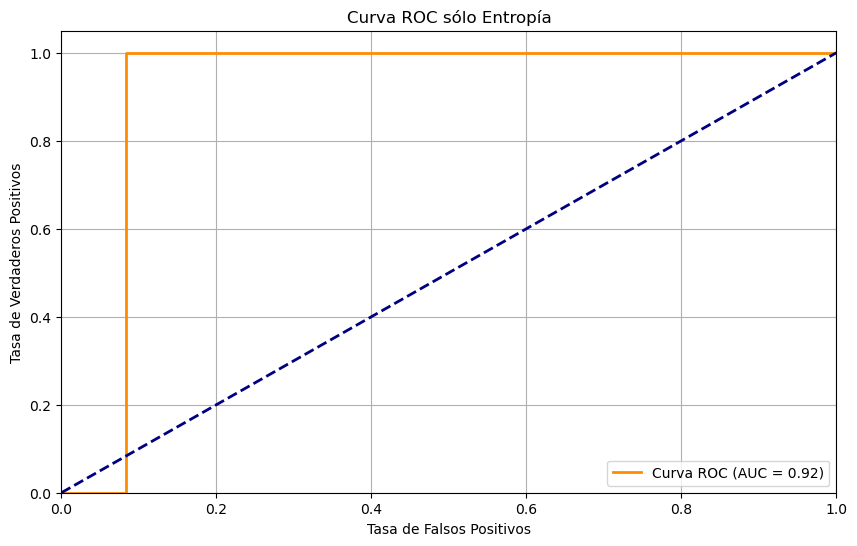

db1
Estadístico: 0.9085087776184082
Valor p: 0.20415277779102325
La muestra parece provenir de una distribución normal (no se rechaza la hipótesis nula)
Estadístico: 0.836125373840332
Valor p: 0.024849489331245422
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 23.0
Valor p: 0.2333984375
No hay diferencias significativas entre las muestras (no se rechaza la hipótesis nula)
---------------------------------------------------------------------------


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


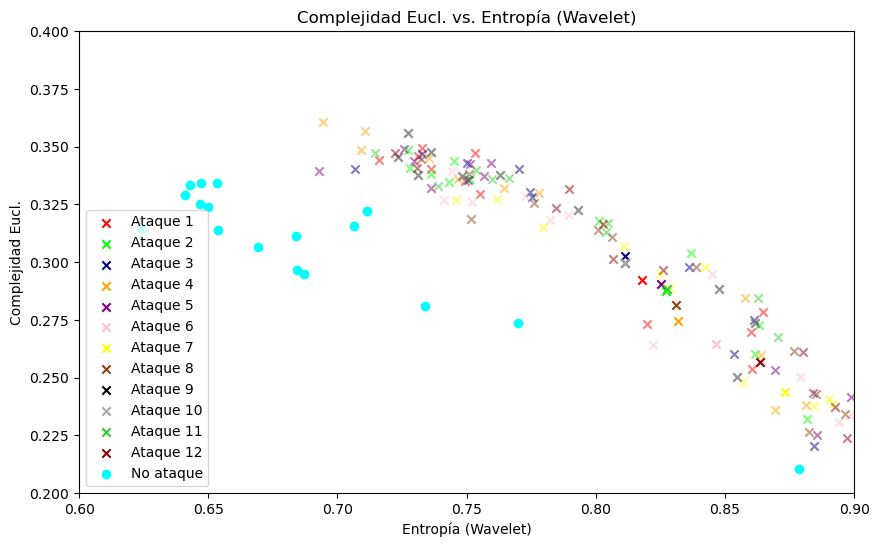

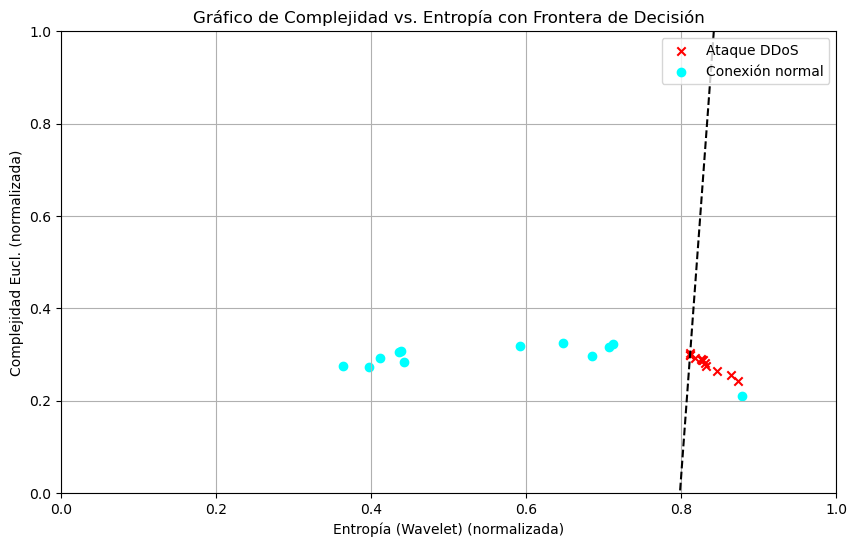

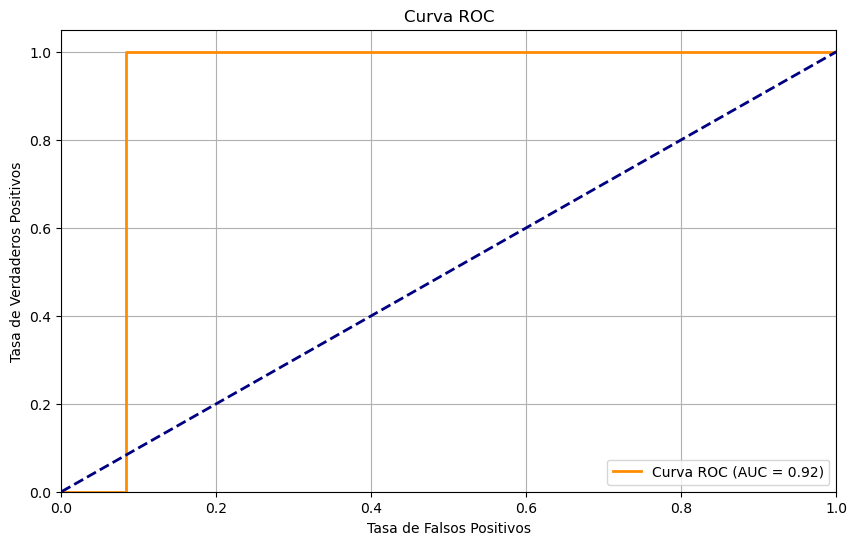

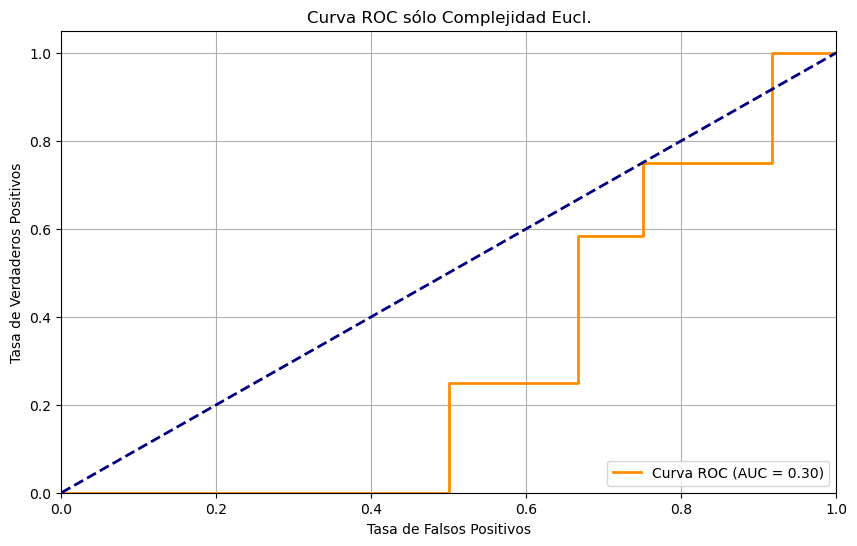

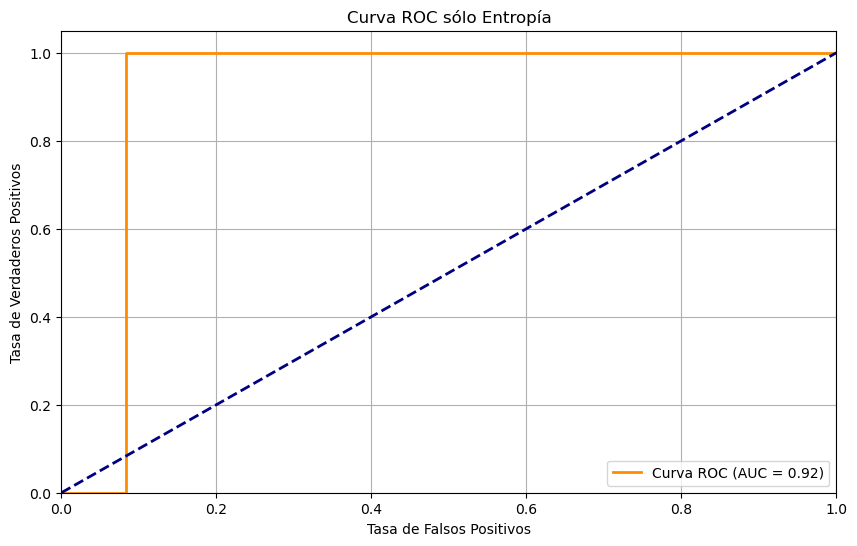

haar
Estadístico: 0.9085087776184082
Valor p: 0.20415277779102325
La muestra parece provenir de una distribución normal (no se rechaza la hipótesis nula)
Estadístico: 0.836125373840332
Valor p: 0.024849489331245422
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 23.0
Valor p: 0.2333984375
No hay diferencias significativas entre las muestras (no se rechaza la hipótesis nula)
---------------------------------------------------------------------------


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


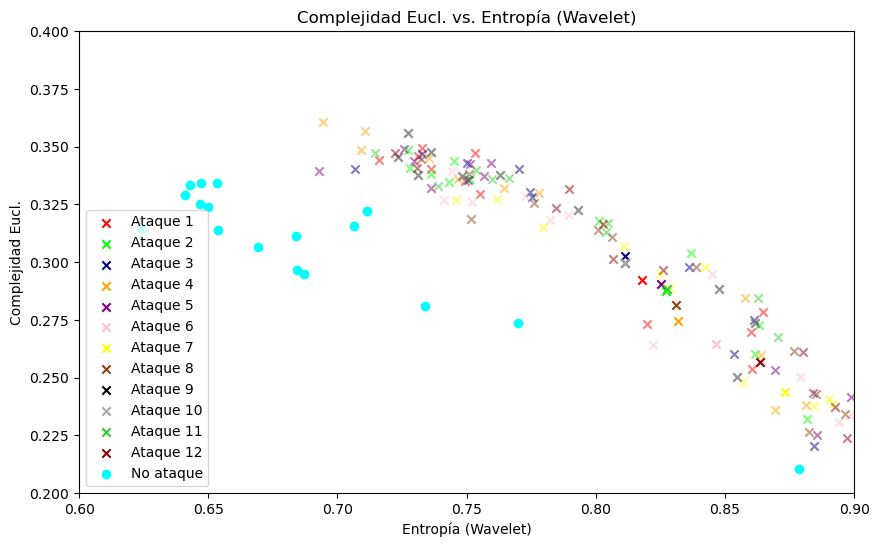

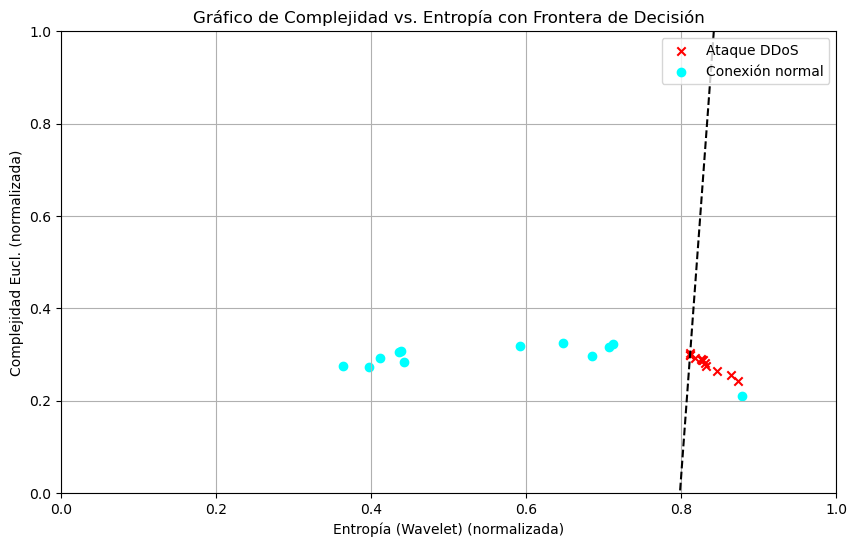

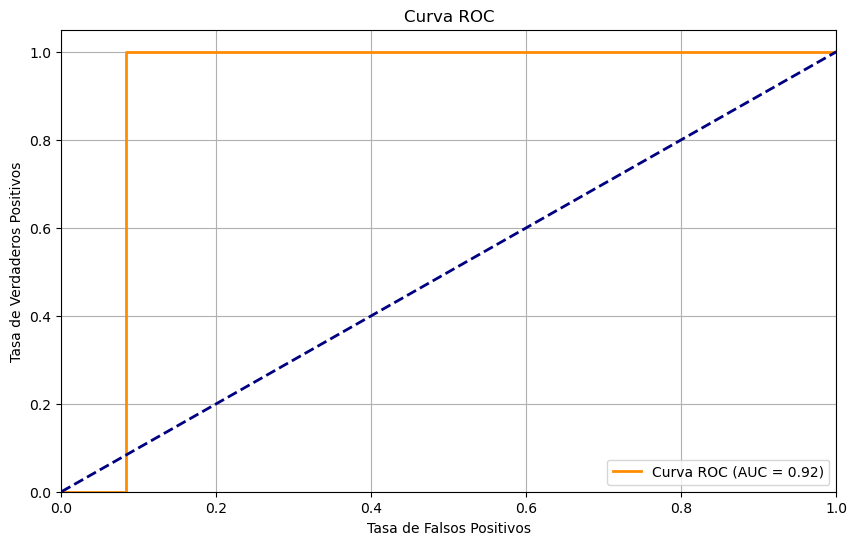

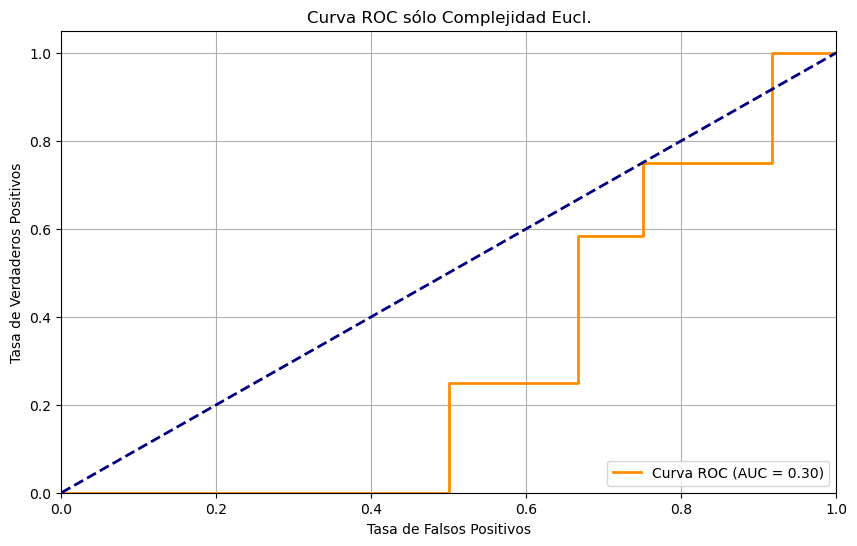

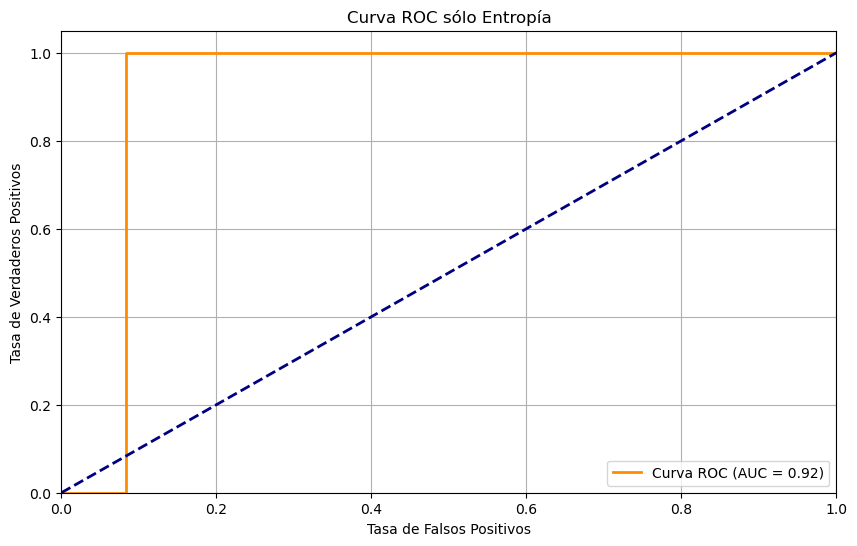

rbio1.1
Estadístico: 0.9085087776184082
Valor p: 0.20415277779102325
La muestra parece provenir de una distribución normal (no se rechaza la hipótesis nula)
Estadístico: 0.836125373840332
Valor p: 0.024849489331245422
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 23.0
Valor p: 0.2333984375
No hay diferencias significativas entre las muestras (no se rechaza la hipótesis nula)
---------------------------------------------------------------------------


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


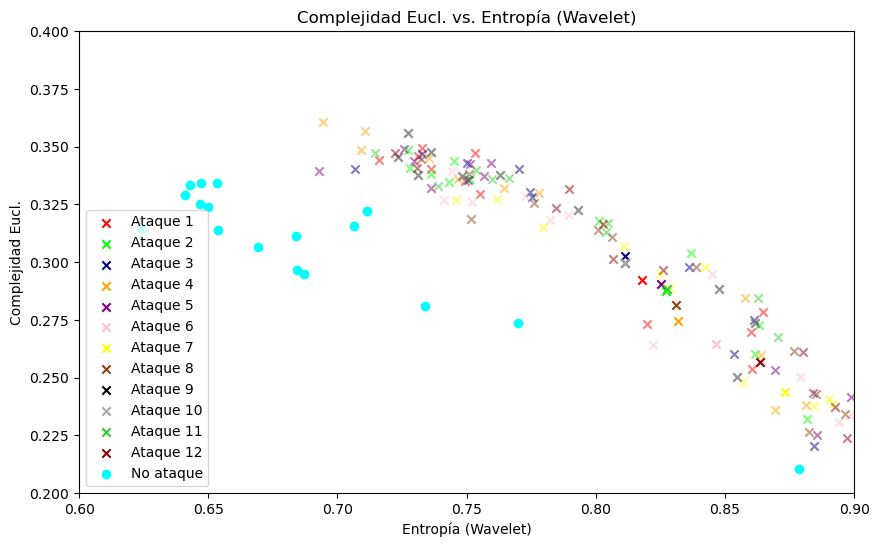

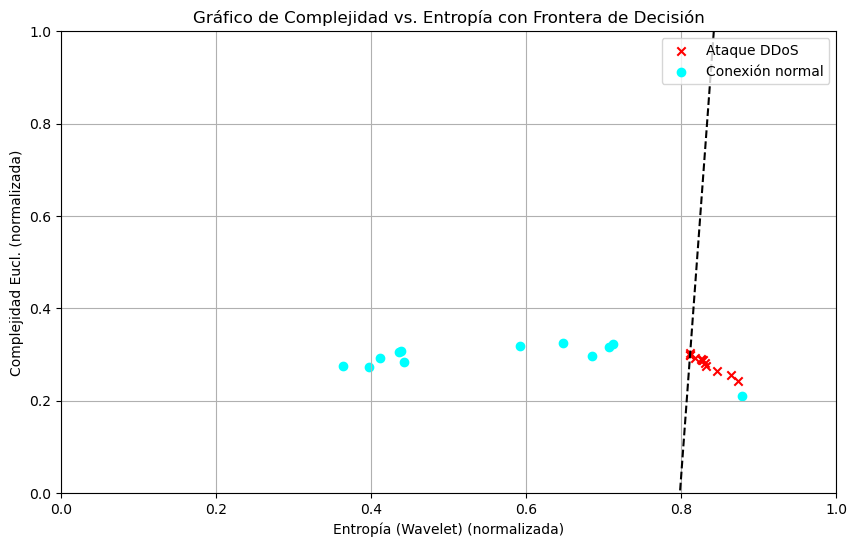

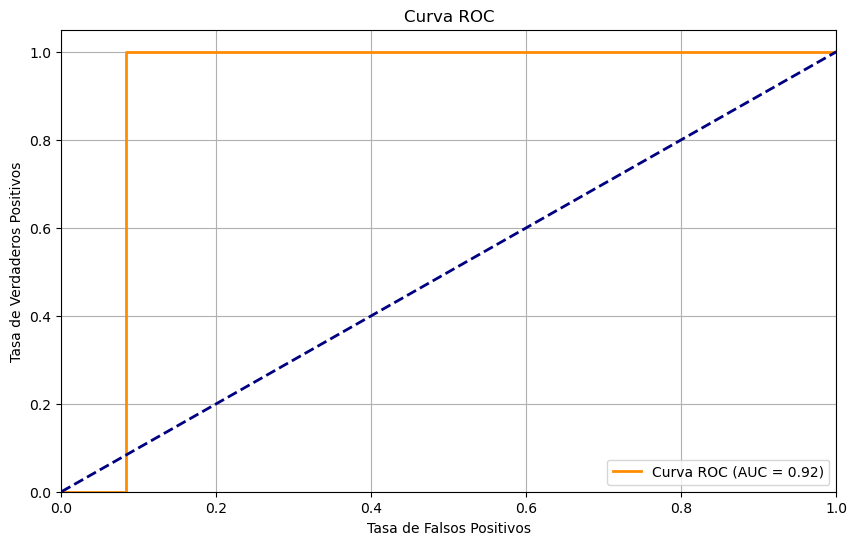

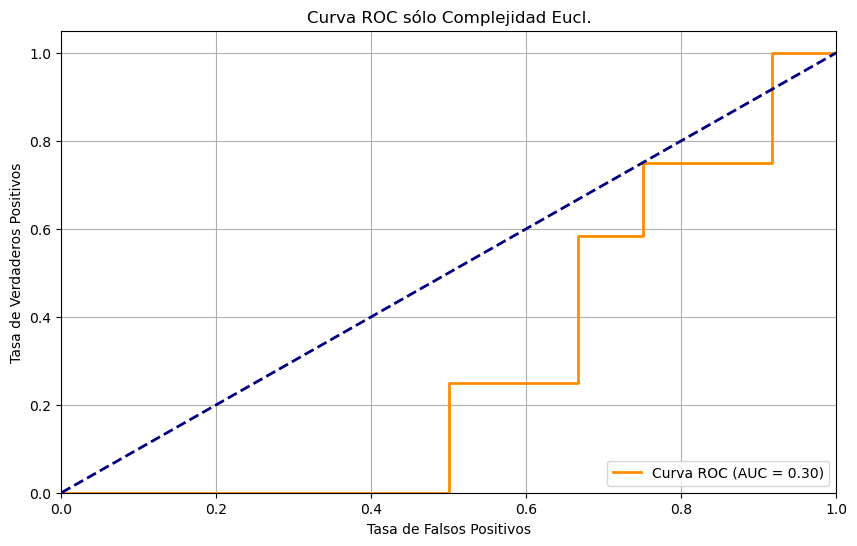

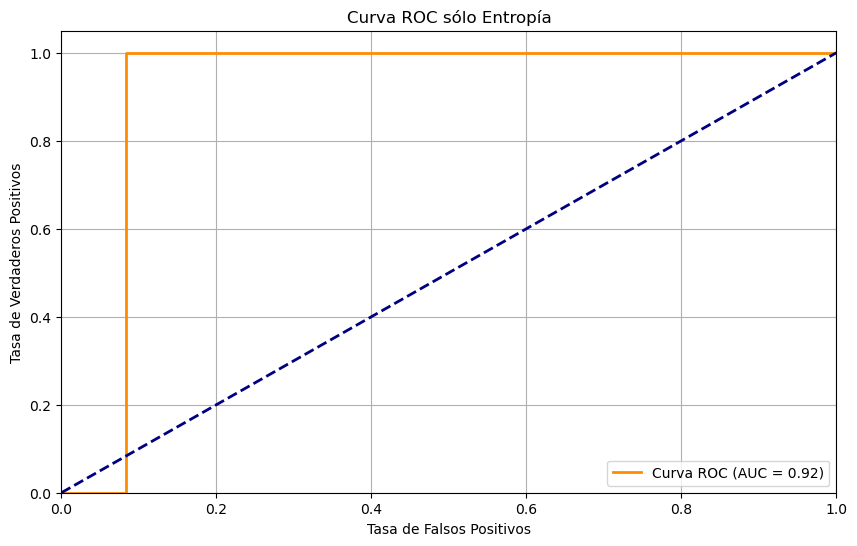

bior2.4
Estadístico: 0.8106884360313416
Valor p: 0.012426107190549374
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.8612203001976013
Valor p: 0.05063913017511368
La muestra parece provenir de una distribución normal (no se rechaza la hipótesis nula)
Estadístico: 11.0
Valor p: 0.02685546875
Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)
---------------------------------------------------------------------------


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


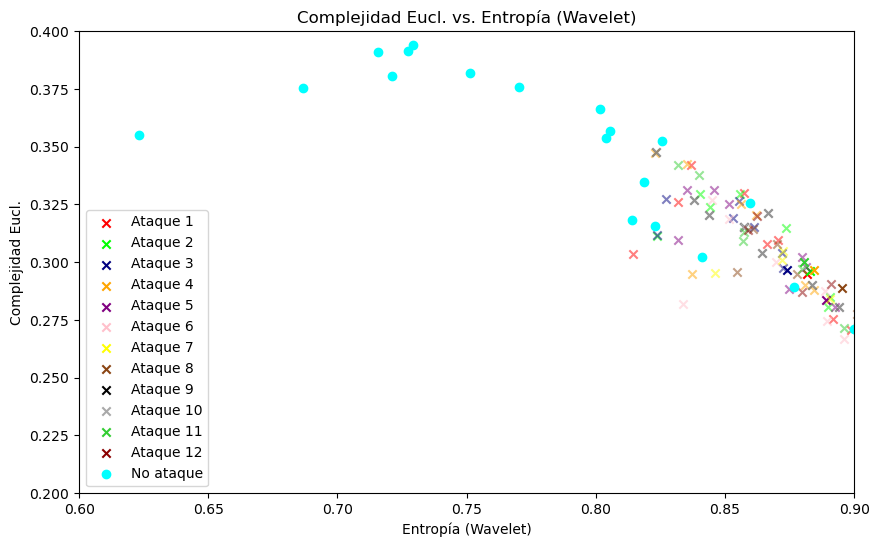

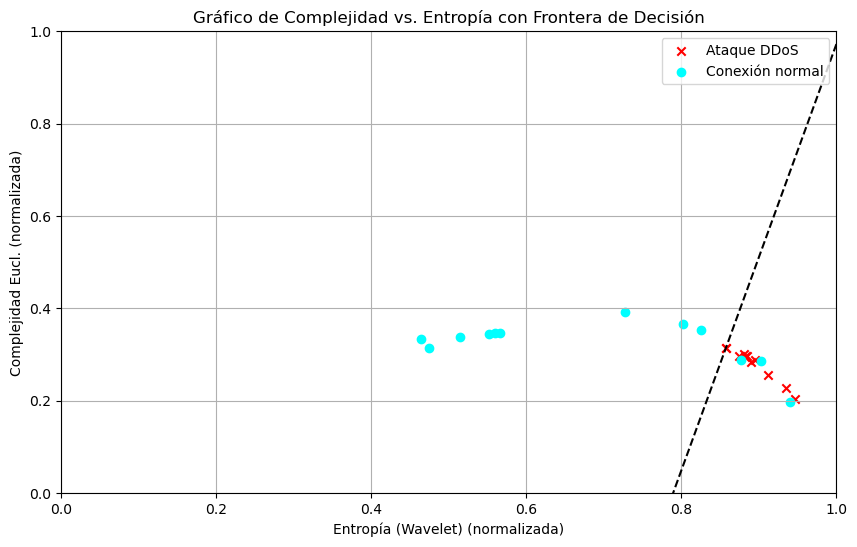

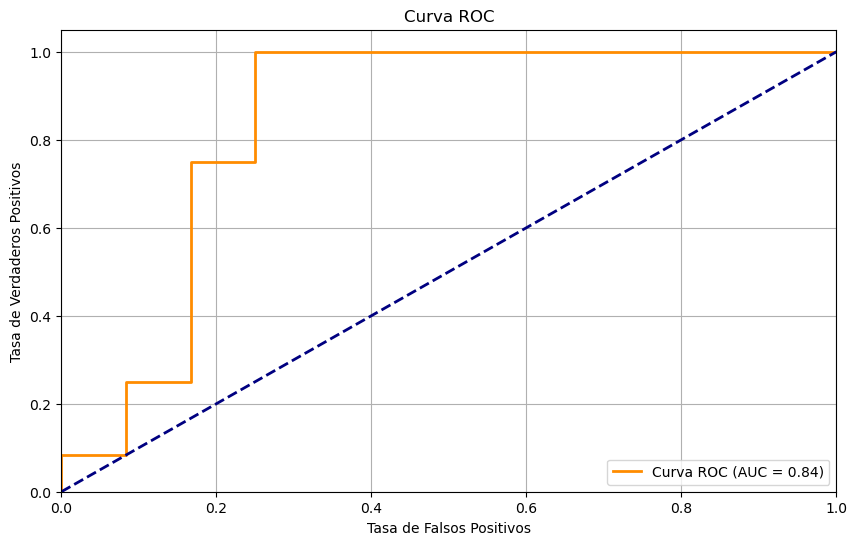

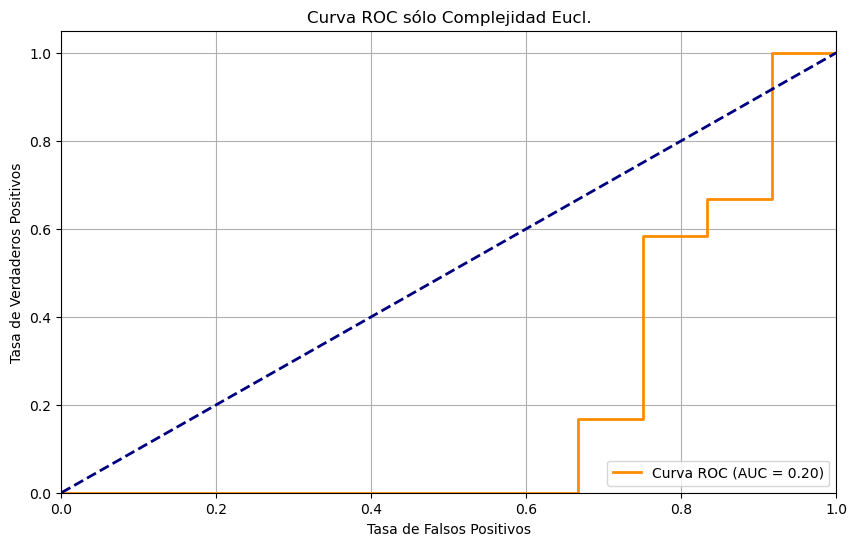

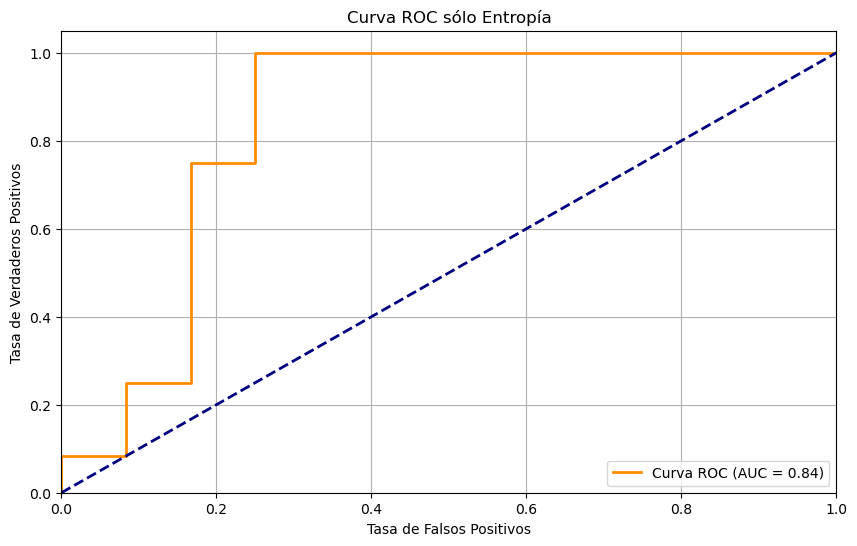

bior1.3
Estadístico: 0.8677985668182373
Valor p: 0.06128581613302231
La muestra parece provenir de una distribución normal (no se rechaza la hipótesis nula)
Estadístico: 0.8439965844154358
Valor p: 0.030976181849837303
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 37.0
Valor p: 0.90966796875
No hay diferencias significativas entre las muestras (no se rechaza la hipótesis nula)
---------------------------------------------------------------------------


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


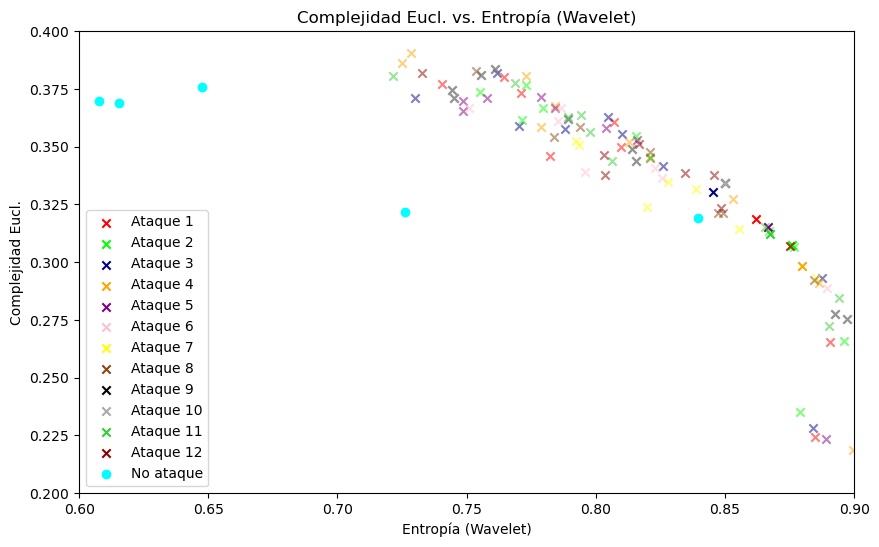

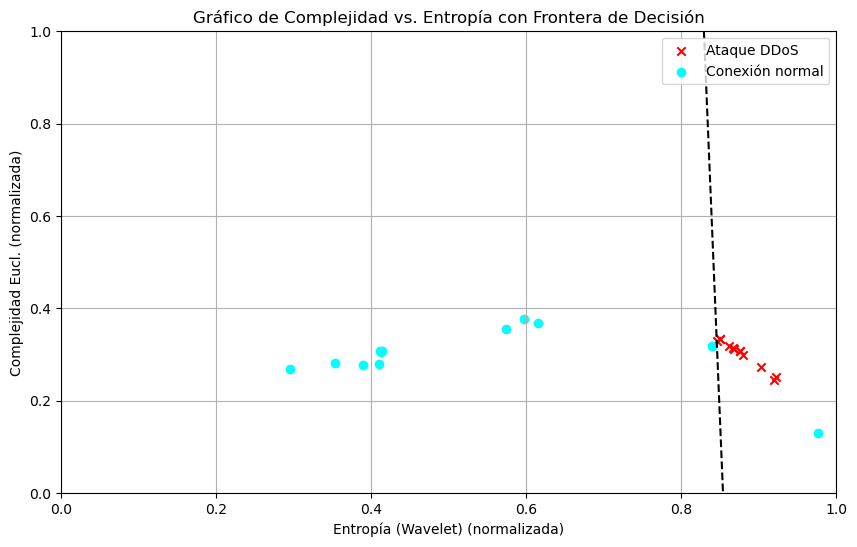

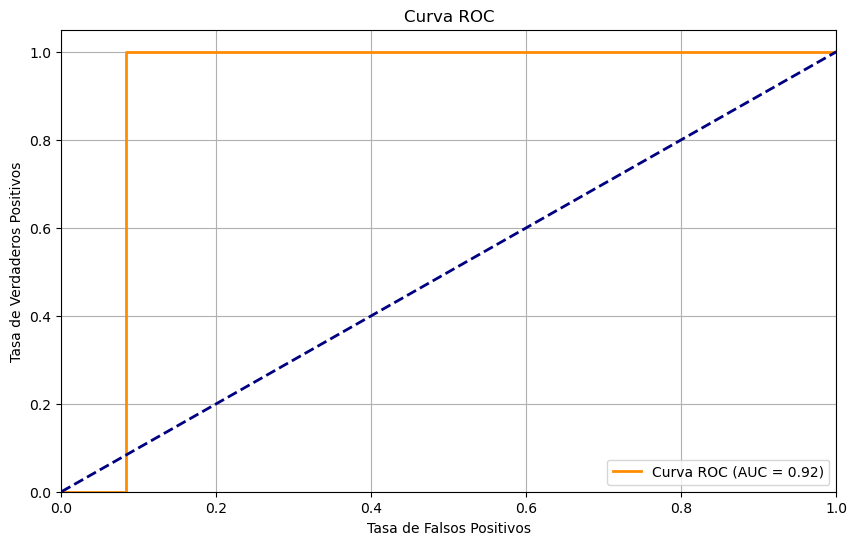

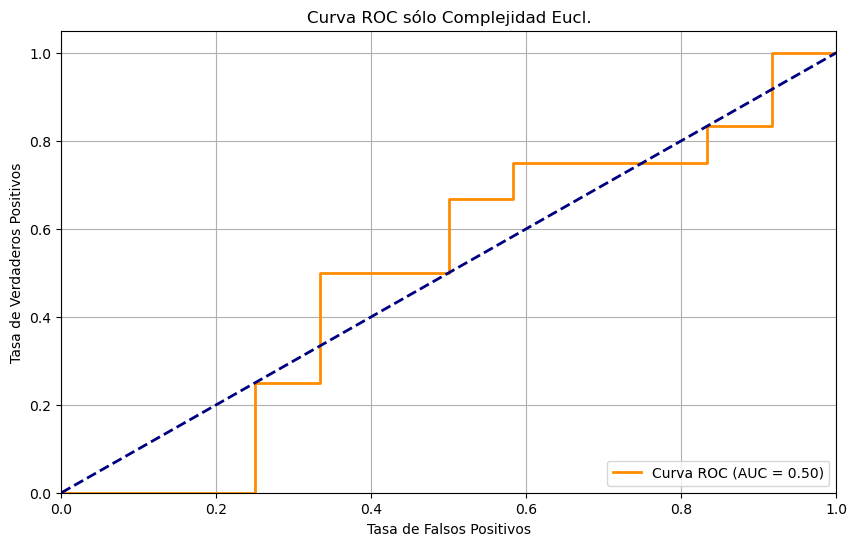

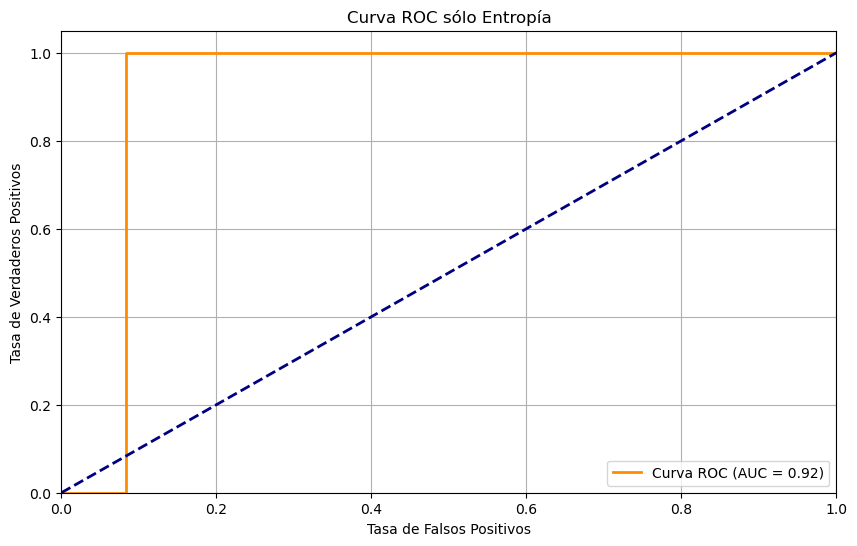

rbio1.3
Estadístico: 0.8990218043327332
Valor p: 0.15407408773899078
La muestra parece provenir de una distribución normal (no se rechaza la hipótesis nula)
Estadístico: 0.6675641536712646
Valor p: 0.00041773307020775974
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 5.0
Valor p: 0.0048828125
Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)
---------------------------------------------------------------------------


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


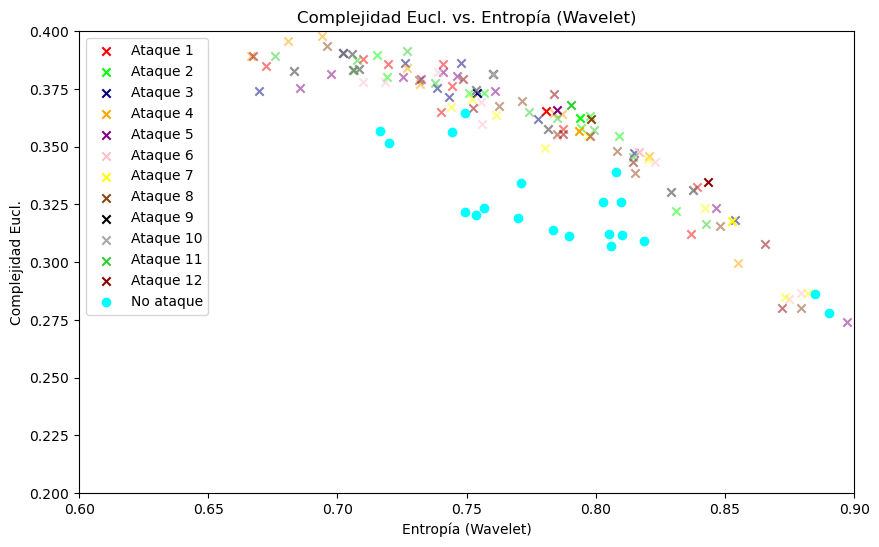

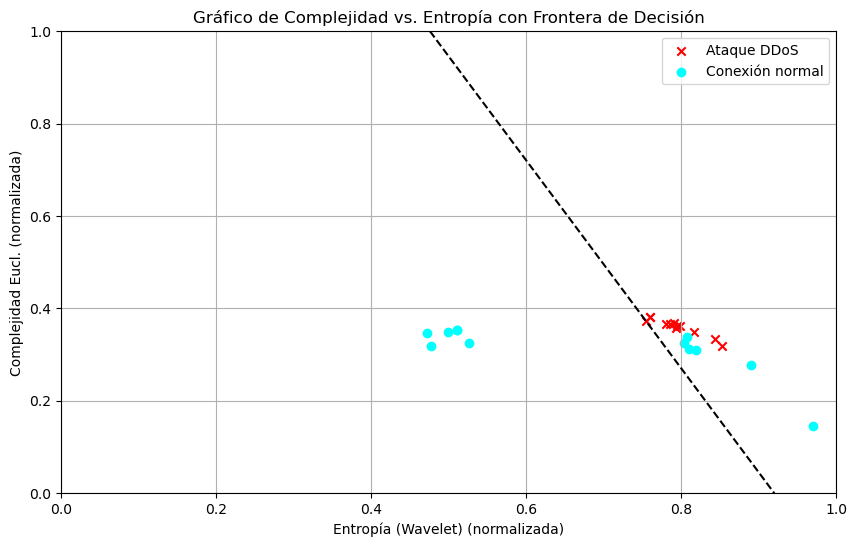

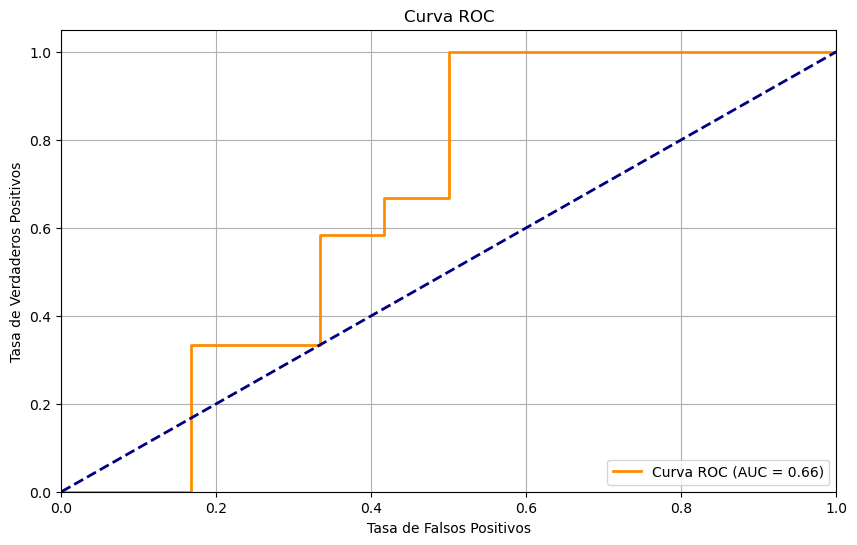

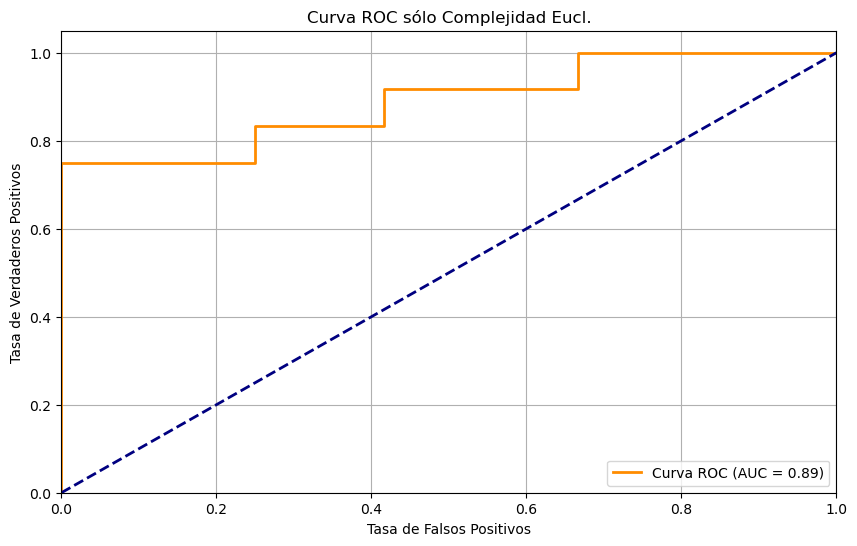

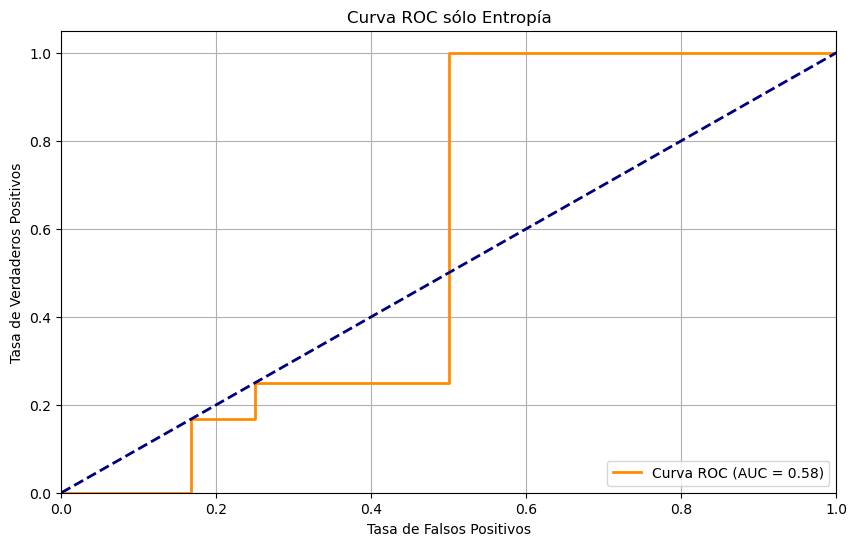

bior1.5
Estadístico: 0.8229656219482422
Valor p: 0.017298316583037376
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.8261590600013733
Valor p: 0.018873998895287514
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 16.0
Valor p: 0.0771484375
No hay diferencias significativas entre las muestras (no se rechaza la hipótesis nula)
---------------------------------------------------------------------------


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


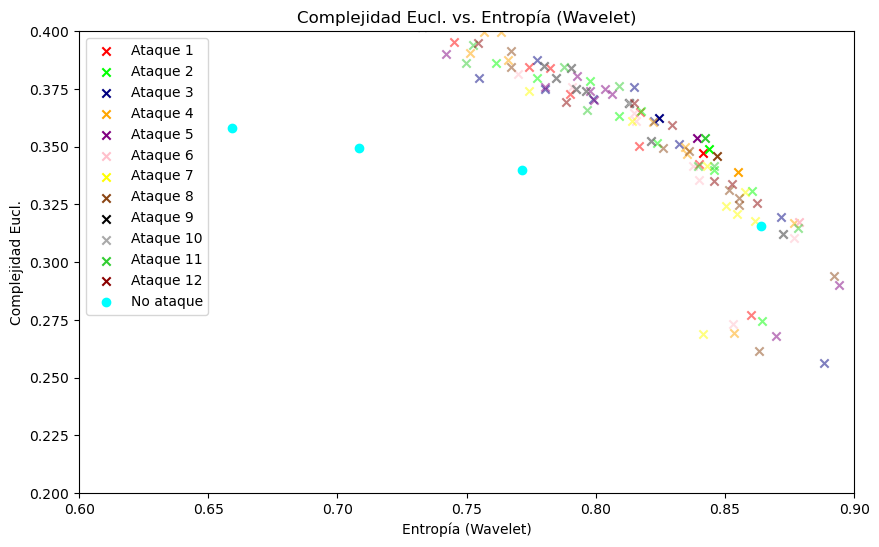

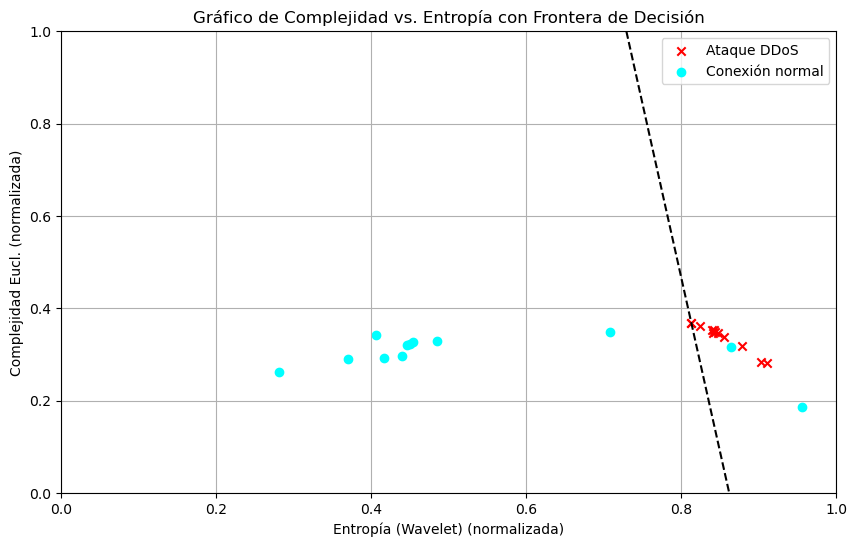

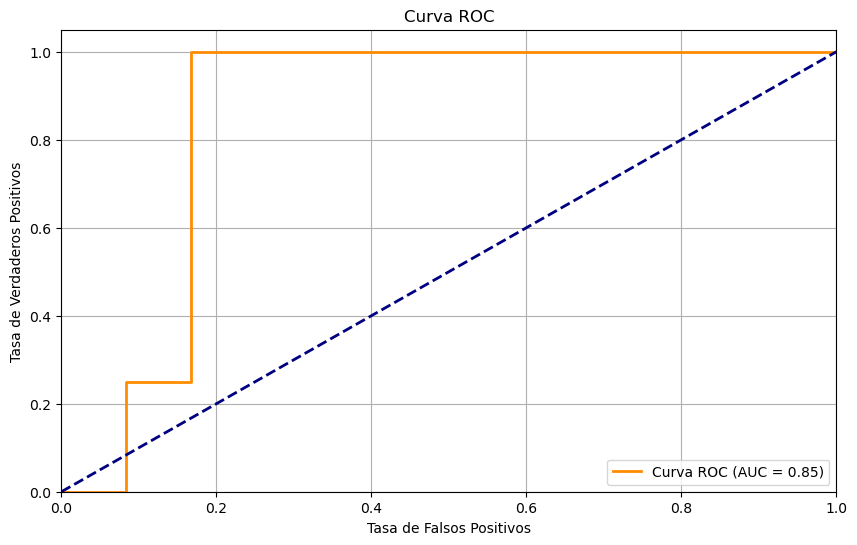

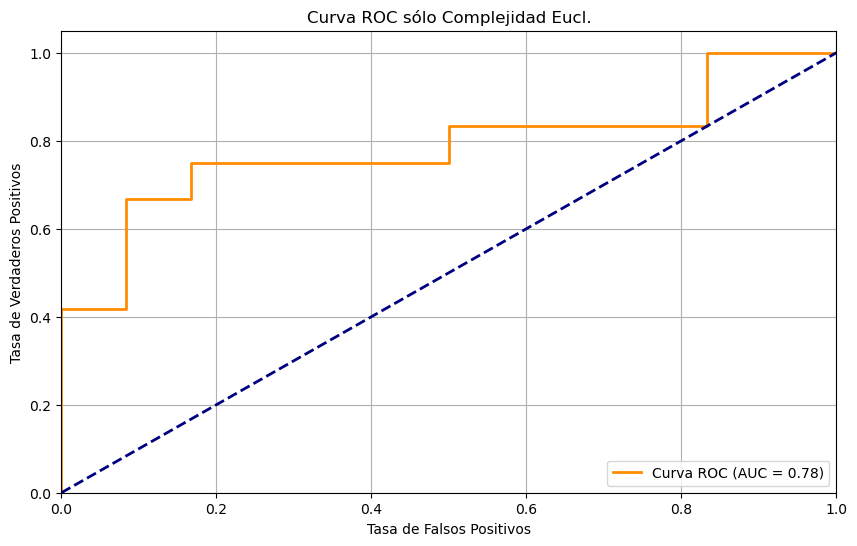

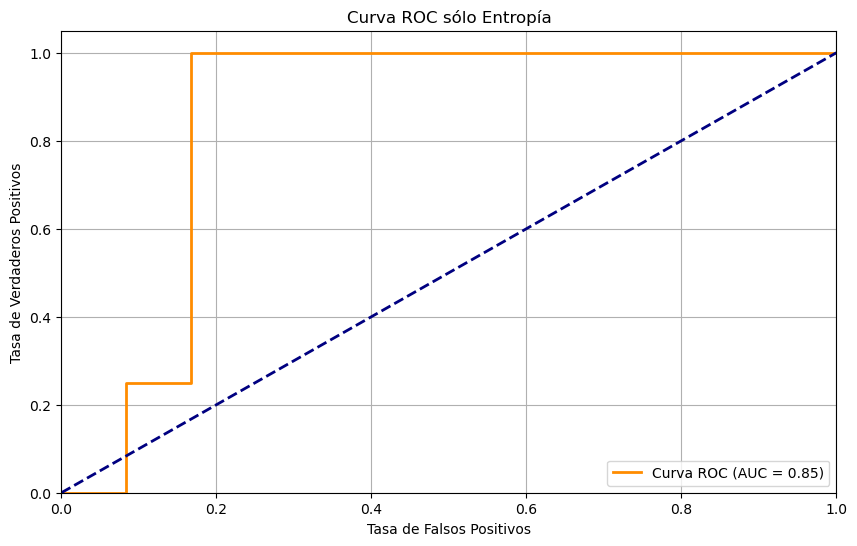

bior2.8
Estadístico: 0.7541038393974304
Valor p: 0.0029504322446882725
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.9026846885681152
Valor p: 0.1717880517244339
La muestra parece provenir de una distribución normal (no se rechaza la hipótesis nula)
Estadístico: 12.0
Valor p: 0.0341796875
Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)
---------------------------------------------------------------------------


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


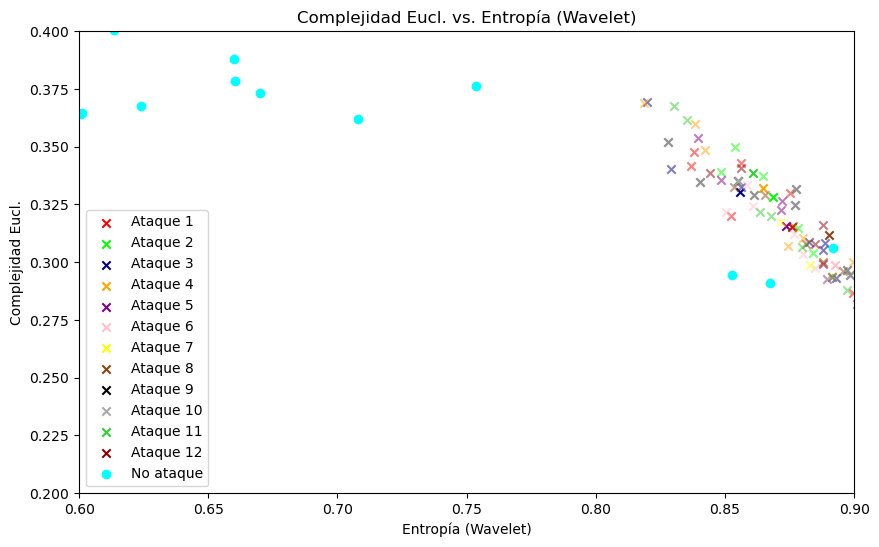

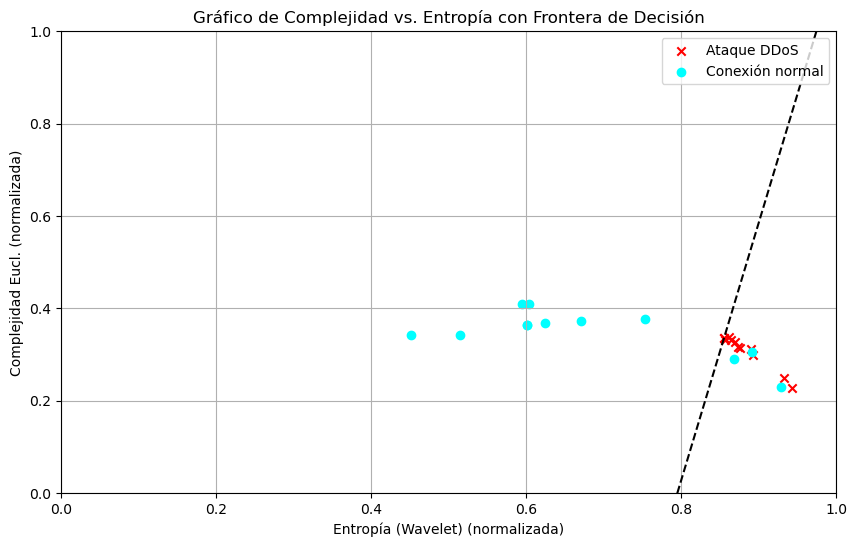

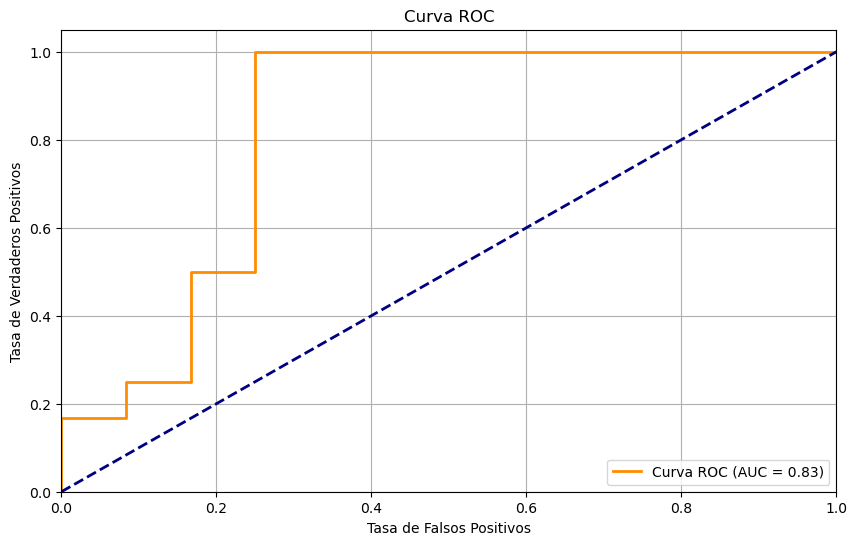

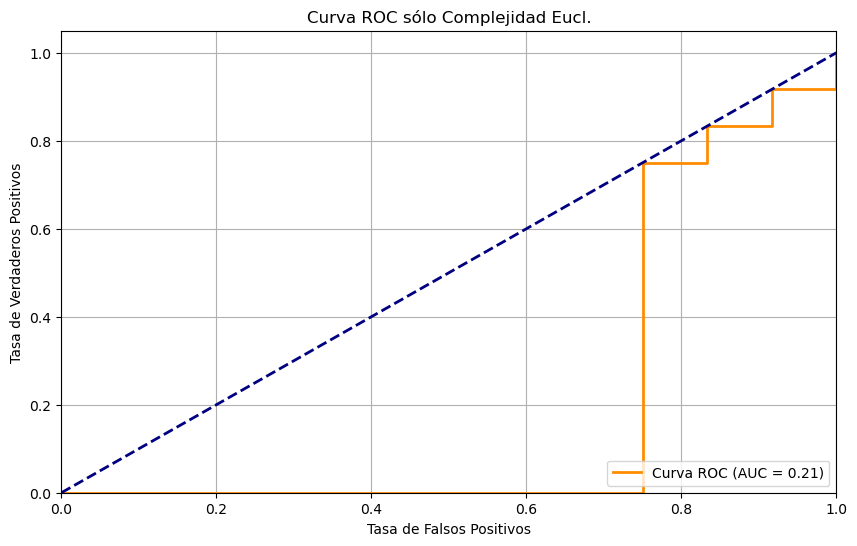

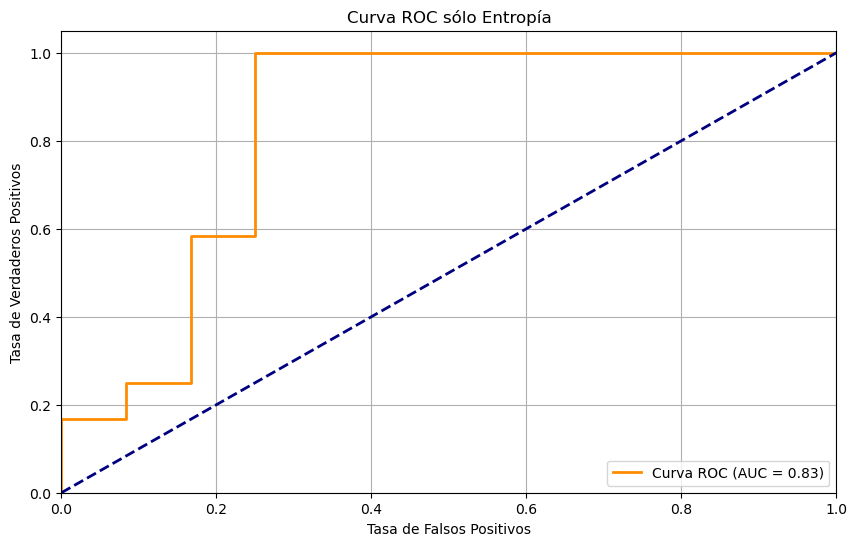

rbio1.5
Estadístico: 0.8686400651931763
Valor p: 0.06280724704265594
La muestra parece provenir de una distribución normal (no se rechaza la hipótesis nula)
Estadístico: 0.5692779421806335
Valor p: 6.01663050474599e-05
La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)
Estadístico: 0.0
Valor p: 0.00048828125
Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)
---------------------------------------------------------------------------


/Users/miguelsalinasgonzalez/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


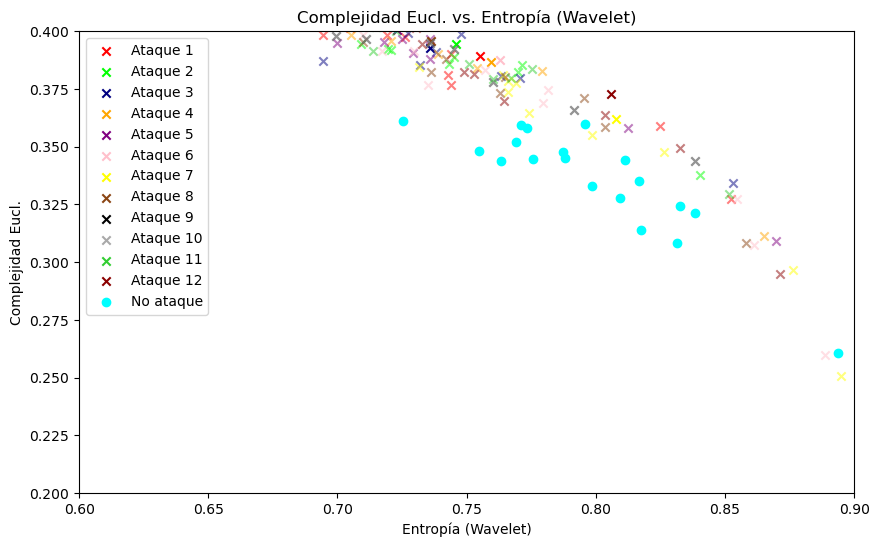

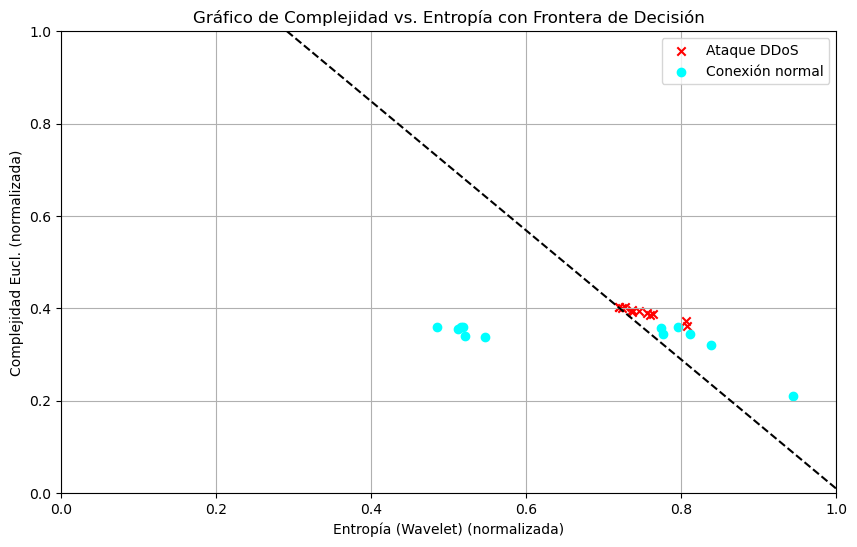

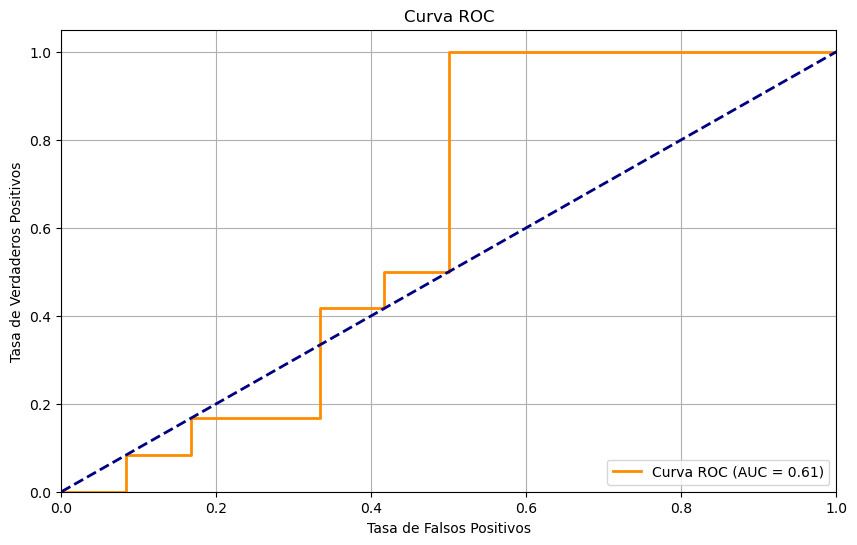

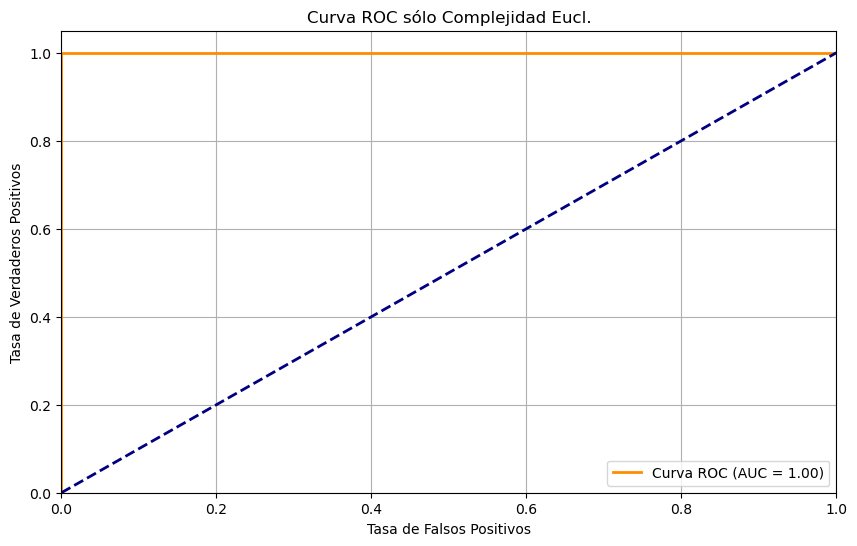

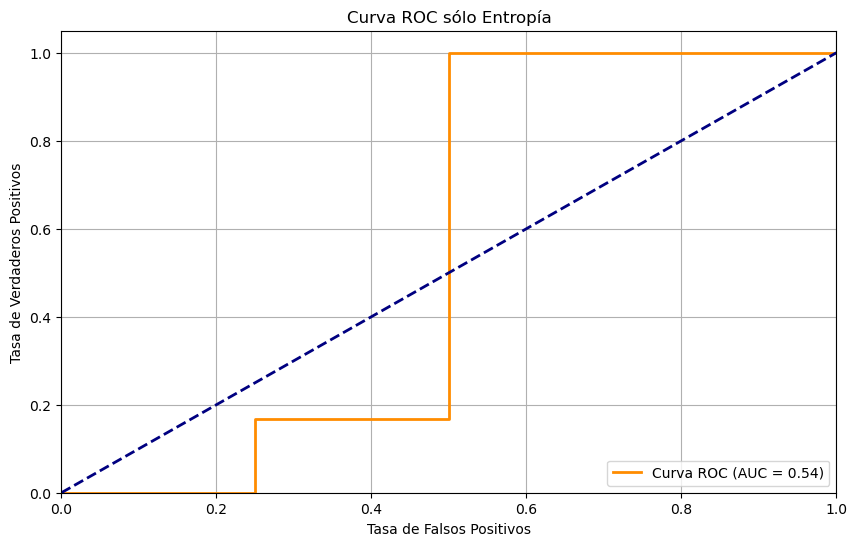

In [528]:
for i in range(10):
    print(ranked_wavelets[i][0])
    df = calculate_desequilibrium_and_complexity(file_paths,ranked_wavelets[i][0])

    plot_complexity_entropy(df,'Complejidad Eucl.')
    
    # Realizar la prueba de Shapiro-Wilk
    stat, p_value = shapiro(df['Complejidad Eucl.'].iloc[inicio_ataques])

    # Imprimir los resultados
    print('Estadístico:', stat)
    print('Valor p:', p_value)

    # Evaluar la normalidad
    alpha = 0.05
    if p_value > alpha:
        print('La muestra parece provenir de una distribución normal (no se rechaza la hipótesis nula)')
    else:
        print('La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)')

    # Realizar la prueba de Shapiro-Wilk
    stat, p_value = shapiro(df['Complejidad Eucl.'][sum(reps):sum(reps)+12])

    print('Estadístico:', stat)
    print('Valor p:', p_value)

    # Evaluar la normalidad
    alpha = 0.05
    if p_value > alpha:
        print('La muestra parece provenir de una distribución normal (no se rechaza la hipótesis nula)')
    else:
        print('La muestra no parece provenir de una distribución normal (se rechaza la hipótesis nula)')

    stat, p_value = wilcoxon(df['Complejidad Eucl.'][sum(reps):sum(reps)+12], df['Complejidad Eucl.'].iloc[inicio_ataques])

    # Imprimir los resultados
    print('Estadístico:', stat)
    print('Valor p:', p_value)

    # Evaluar la significancia
    alpha = 0.05
    if p_value > alpha:
        print('No hay diferencias significativas entre las muestras (no se rechaza la hipótesis nula)')
    else:
        print('Hay diferencias significativas entre las muestras (se rechaza la hipótesis nula)')
    print("---------------------------------------------------------------------------")
    df['Clasificación'] = [1]*sum(reps)+[0]*(len(df)-sum(reps))
    df2 = df.iloc[inicio_ataques]
    df3 = df.iloc[sum(reps):sum(reps)+12]
    # Separar características y etiquetas
    X = pd.concat([df2,df3])[['Entropía (Wavelet)', 'Complejidad Eucl.']]  
    y = pd.concat([df2,df3])['Clasificación']

    # Entrenar el modelo de regresión logística
    model = LogisticRegression()
    model.fit(X, y)
    """
    # Generar una malla de puntos para graficar la frontera de decisión
    xx, yy = np.mgrid[0:1:.01, 0:1:.01]
    grid = np.c_[xx.ravel(), yy.ravel()]
    probs = model.predict_proba(grid)[:, 1].reshape(xx.shape)
    """
    # Definir x_min, x_max, y_min, y_max en base a los datos normalizados
    x_min, x_max = X['Entropía (Wavelet)'].min() - 0.1, X['Entropía (Wavelet)'].max() + 0.1
    y_min, y_max = X['Complejidad Eucl.'].min() - 0.1, X['Complejidad Eucl.'].max() + 0.1

    # Asegurarse de que los límites estén dentro del rango 0-1
    x_min, x_max = max(0, x_min), min(1, x_max)
    y_min, y_max = max(0, y_min), min(1, y_max)

    xx, yy = np.meshgrid(np.linspace(0, 1, 100), np.linspace(0, 1, 100))
    y_pred_prob = model.predict_proba(X)[:, 1]
    #print(y_pred_prob)

    # Calcular la curva ROC y el AUC
    fpr, tpr, thresholds = roc_curve(y, y_pred_prob)
    roc_auc = roc_auc_score(y, y_pred_prob)

    f1_scores = [f1_score(y, (y_pred_prob >= thresh).astype(int)) for thresh in thresholds]

    # Encontrar el umbral que maximiza el F1-Score
    optimal_threshold = thresholds[np.argmax(f1_scores)]

    # Predecir con el modelo
    Z = model.predict_proba(np.c_[xx.ravel(), yy.ravel()])[:, 1]
    Z = Z.reshape(xx.shape)

    # Graficar los puntos y la frontera de decisión
    
    
    # Graficar los puntos y la frontera de decisión
    plt.figure(figsize=(10, 6))
    plt.scatter(X[y == 1]['Entropía (Wavelet)'], X[y == 1]['Complejidad Eucl.'], marker='x', label='Ataque DDoS', c="Red")
    plt.scatter(X[y == 0]['Entropía (Wavelet)'], X[y == 0]['Complejidad Eucl.'], marker='o', label='Conexión normal', c="Cyan")

    # Contorno de la frontera de decisión
    #plt.contour(xx, yy, probs, levels=[0.5], cmap="Greys", vmin=0, vmax=1)

    plt.contour(xx, yy, Z, levels=[optimal_threshold], colors='black', linestyles='--')
    plt.xlabel('Entropía (Wavelet) (normalizada)')
    plt.ylabel('Complejidad Eucl. (normalizada)')
    plt.title('Gráfico de Complejidad vs. Entropía con Frontera de Decisión')
    plt.legend()
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.0])
    plt.grid(True)
    plt.show()
    
    # Predecir las probabilidades de la clase positiva
    y_pred_prob = model.predict_proba(X)[:, 1]
    #print(y_pred_prob)

    # Calcular la curva ROC y el AUC
    fpr, tpr, thresholds = roc_curve(y, y_pred_prob)
    roc_auc = roc_auc_score(y, y_pred_prob)


    # Graficar la curva ROC
    plt.figure(figsize=(10, 6))
    plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'Curva ROC (AUC = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('Tasa de Falsos Positivos')
    plt.ylabel('Tasa de Verdaderos Positivos')
    plt.title('Curva ROC')
    plt.legend(loc="lower right")
    plt.grid(True)
    plt.show()
    
    # Calcular la curva ROC y el AUC para sólo complejidad
    fpr, tpr, thresholds = roc_curve(y, X["Complejidad Eucl."])
    roc_auc = roc_auc_score(y, X["Complejidad Eucl."])


    # Graficar la curva ROC
    plt.figure(figsize=(10, 6))
    plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'Curva ROC (AUC = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('Tasa de Falsos Positivos')
    plt.ylabel('Tasa de Verdaderos Positivos')
    plt.title('Curva ROC sólo Complejidad Eucl.')
    plt.legend(loc="lower right")
    plt.grid(True)
    plt.show()
    
    # Calcular la curva ROC y el AUC para sólo complejidad
    fpr, tpr, thresholds = roc_curve(y, X['Entropía (Wavelet)'])
    roc_auc = roc_auc_score(y, X['Entropía (Wavelet)'])


    # Graficar la curva ROC
    plt.figure(figsize=(10, 6))
    plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'Curva ROC (AUC = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('Tasa de Falsos Positivos')
    plt.ylabel('Tasa de Verdaderos Positivos')
    plt.title('Curva ROC sólo Entropía')
    plt.legend(loc="lower right")
    plt.grid(True)
    plt.show()